In [ ]:
import time
import numpy as np

# Data Class

In [ ]:
import os
import re
import json
import math
import cv2
import subprocess as sp
from osr2mp4.EEnum.EReplay import Replays
from osr2mp4.osr2mp4 import Osr2mp4
import torch
import torchvision.io as vision
import torchvision.transforms as transforms

In [ ]:
class OSR():
    def __init__(self, beatmap_dir, beatmap, sample_rate=44100, hop_size=441, skin=None,
                 tmp='./tmp', vtmp='./vid', atmp='./wav'):
        self.beatmap = beatmap
        self.beatmap_dir = beatmap_dir
        self.beatmap_path = os.path.join(self.beatmap_dir, self.beatmap)
        self.sample_rate = sample_rate
        self.hop_size = hop_size
        self.rate = int(sample_rate / hop_size)
        self.fps = self.rate
        self.tmp = tmp
        self.vtmp = vtmp
        self.atmp = atmp
        self.skin = skin
        self.data_json = os.path.join(self.tmp, self.beatmap + '.json')
        self.video_path = os.path.join(self.vtmp, self.beatmap + '.avi')
        
        self.replay_info = None
        self.osr2mp4 = None
        self.video = None
        self.hitobjects = None
        self.cursorstream = None
        self.timestamp = None
        
    def run_osr2mp4(self):
        d = json.load(open('data.json', 'r'))
        f = open(self.data_json, 'w')
        d['Beatmap path'] = self.beatmap_path
        if self.skin is not None:
            d['Skin path'] = self.skin
        d['FPS'] = self.fps
        d['Output path'] = self.video_path
        json.dump(d, f)
        f.close()
                 
        self.osr2mp4 = Osr2mp4(filedata=self.data_json, filesettings='settings.json', filepp='ppsettings.json', 
                               filestrain='strainsettings.json', logtofile=True)
        while True:
            if self.osr2mp4.replay_info.play_data[-1][Replays.CURSOR_X] == 0 and self.osr2mp4.replay_info.play_data[-1][Replays.CURSOR_Y] == 0:
                self.osr2mp4.replay_info.play_data = self.osr2mp4.replay_info.play_data[0:-1]
            else:
                break
        
    def create_vid(self):
        if self.osr2mp4 is None:
            self.run_osr2mp4()
        cmd = ['python', 'create_vid.py', self.data_json]
        proc = sp.Popen(cmd)
        proc.wait()
        
    def parse_timings(self):
        if self.video is None:
            self.get_video()
        self.beat_len = []
        self.timestamp = []
        f = open(self.beatmap_path)
        for l in f:
            if re.match(r'BeatDivisor.*', l):
                self.BeatDivisor = int(l.split(':')[1])
                break
        f.seek(0)
        for l in f:
            if re.match(r'\[TimingPoints\]', l):
                break
        for l in f:
            if l == "\n":
                break
            a = l.split(',')
            if float(a[1]) < 0:
                continue
            self.beat_len.append(float(a[1]))
            self.timestamp.append(float(a[0]))
        self.timestamp.append(int(self.video[1].shape[1] / self.video[2]['audio_fps'] * 1000))
        f.close()
    
    def parse_hitobjects(self):
        self.hitobjects = []
        f = open(self.beatmap_path)
        for l in f:
            if re.match(r'ApproachRate.*', l):
                AR = float(l.split(':')[1])
                if AR < 5.0:
                    preempt = 1200 + 600 * (5 - AR) / 5
                    fadein = 800 + 400 * (5 - AR) / 5
                else:
                    preempt = 1200 - 750 * (AR - 5) / 5
                    fadein = 800 - 500 * (AR - 5) / 5
                self.preempt = preempt - fadein*0.1
                break
        f.seek(0)
        for l in f:
            if re.match(r'SliderMultiplier.*', l):
                self.sliderMultiplier = float(l.split(':')[1])
                break
        f.seek(0)
        for l in f:
            if re.match(r'\[HitObjects\]', l):
                break
        for l in f:
            self.hitobjects.append(l.split(','))
        f.close()
    
    def parse_beatmap(self):
        self.parse_timings()
        self.parse_hitobjects()
    
    def process_beatobjects(self):
        pass
    
    def process_hitobjects(self):
        if self.hitobjects is None:
               self.parse_beatmap()
        self.hitobjStream = [None] * math.ceil(self.timestamp[-1] * 0.001 * self.rate)
    
    def process_clicks(self):
        pass
    
    def process_cursor(self):
        if self.osr2mp4 is None:
            self.run_osr2mp4()
        n = math.ceil((self.osr2mp4.replay_info.play_data[-1][Replays.TIMES] - self.get_offset()) * 0.001 * self.fps)
        self.cursorstream = [None] * n
        
        for j in range(len(self.osr2mp4.replay_info.play_data) - 1):
            a = self.osr2mp4.replay_info.play_data[j]
            b = self.osr2mp4.replay_info.play_data[j+1]
            delta = (b[Replays.TIMES] - a[Replays.TIMES]) * 0.001 * self.fps
            xdist = b[Replays.CURSOR_X] - a[Replays.CURSOR_X]
            ydist = b[Replays.CURSOR_Y] - a[Replays.CURSOR_Y]
            stime = (a[Replays.TIMES] - self.get_offset()) * 0.001 * self.fps
            x = a[Replays.CURSOR_X]
            y = a[Replays.CURSOR_Y]
            
            e = [0.0, 0.0, 0]            
            for t in range(math.ceil(delta)):
                e[Replays.CURSOR_X] = x + xdist/delta*t
                e[Replays.CURSOR_Y] = y + ydist/delta*t
                self.cursorstream[int(stime + t)] = torch.tensor(e)
            e[2] = 1
            e[Replays.CURSOR_X] = a[Replays.CURSOR_X]
            e[Replays.CURSOR_Y] = a[Replays.CURSOR_Y]
            self.cursorstream[int((a[Replays.TIMES] - self.get_offset()) * 0.001 * self.fps)] = torch.tensor(e)
            e[Replays.CURSOR_X] = b[Replays.CURSOR_X]
            e[Replays.CURSOR_Y] = b[Replays.CURSOR_Y]
            self.cursorstream[int((b[Replays.TIMES] - self.get_offset()) * 0.001 * self.fps)] = torch.tensor(e)
        
    def process_events(self):
        self.process_clicks()
        self.process_cursor()
        
    def read_video(self, scale=1):
        if not os.path.exists(self.video_path):
            self.create_vid()
        #self.video = vision.read_video(self.video_path)
        transform = transforms.ToTensor()
        frames = []
        vc = cv2.VideoCapture(self.video_path)
        while True:
            r, f = vc.read()
            f = cv2.resize(f, (0,0), fx=scale, fy=scale)
            frames.append(transform(f))
            if r is False:
                break
        return torch.stack(frames)
        
    def queue_vid(self):
        if not os.path.exists(self.video_path):
            self.create_vid()   
        return self.video_path
    
    def get_offset(self):
        if self.osr2mp4 is None:
            self.run_osr2mp4()
        return self.osr2mp4.replay_info.play_data[0][Replays.TIMES]
    
    def get_beatobjects(self):
        if self.beatobjStream is None:
            self.process_beatobjects()
        stream = [None] * len(self.beatobjStream)
        for i in range(len(self.beatobjStream)):
            if self.beatobjStream[i] == [] or self.beatobjStream == None:
                h = np.array([0], dtype=np.float32)
            else:
                h = np.array(self.beatobjStream[i], dtype=np.float32)
            stream[i] = torch.tensor(np.pad(h, (0, 64 - h.shape[0])))
        return torch.stack(stream)
        
    def get_hitobjects(self):
        if self.hitobjStream is None:
            self.process_hitobjects()
        stream = [None] * len(self.hitobjStream)
        for i in range(len(self.hitobjStream)):
            if self.hitobjStream[i] == [] or self.hitobjStream == None:
                h = np.array([0], dtype=np.float32)
            else:
                h = np.array(self.hitobjStream[i], dtype=np.float32)
            stream[i] = torch.tensor(np.pad(h, (0, 64 - h.shape[0])))
        return torch.stack(stream)
    
    def get_cursor(self):
        if self.cursorstream is None:
            self.process_events()
        return torch.stack(self.cursorstream)
        
    def get_video(self, scale=1):
        if self.video is None:
            self.read_video(scale=1)
        return self.video

# Dataset

In [ ]:
import glob
import copy
import traceback
import torch
import torchvision.transforms as transforms
from torch.utils.data import Dataset
import cv2
import matplotlib.pyplot as plt

In [ ]:
class OSR_Dataset(Dataset):
    def __init__(self, beatmap_dir, sample_rate=44100, hop_size=441, seq_dur=10, scale=1, hidden_mod=0, maximum=100):
        self.beatmap_dir = beatmap_dir
        self.sample_rate = sample_rate
        self.hop_size = hop_size
        self.seq_len = int(seq_dur * sample_rate / hop_size)
        self.hidden_mod = hidden_mod
        self.maximum = maximum
        
        self.osrs = []
        
        if beatmap_dir is None:
            self.v = []
            self.c = []
            return
        
        j = 0
        def parse_beatmaps(j):
            for r, dirs, _ in os.walk(beatmap_dir):
                for dir in dirs:
                    for root, _, files in os.walk(os.path.join(r, dir)):
                        for f in files:
                            if re.match(r'.*osu$', f):
                                if self.hidden_mod == 0 or j % self.hidden_mod != 0:
                                    self.osrs.append(OSR(root, f, sample_rate=sample_rate, hop_size=hop_size))
                                else:
                                    self.osrs.append(OSR(root, f, sample_rate=sample_rate, hop_size=hop_size, skin='./skin_hidden'))
                                if j == self.maximum:
                                    return j
                                j += 1
            return j
        j = parse_beatmaps(j)
        
        self.v = [None] * j
        self.c = [None] * j
        
        def process(i):
            m = self.osrs[i]
            self.osrs[i] = None;
            try:
                print(str(i) + '/' + str(j-1), m.beatmap)
                self.v[i] = copy.deepcopy(m.queue_vid())
                self.c[i] = copy.deepcopy(m.get_cursor())
            except Exception as e:
                traceback.print_exc()
                print("pruning:", m.beatmap)
                self.v[i] = None
                self.c[i] = None
            del m
        
        list(map(process, range(j)))
        
    def take(self, ds, i, j):
        self.v = ds.v[i:j]
        self.c = ds.c[i:j]

    def __len__(self):
        return len(self.v)

    def __getitem__(self, i):
        if self.seq_len == 0:
            return None
        
        transform = transforms.ToTensor()
        j = np.random.randint(0, self.c[i].shape[0] - self.seq_len)
        vc = cv2.VideoCapture(self.v[i])
        vc.set(cv2.CAP_PROP_POS_FRAMES, j)
        #for k in range(j):
        #    _, _ = vc.read()
        
        f = [None] * self.seq_len
        for k in range(self.seq_len):
            frame = vc.read()[1]
            frame = cv2.resize(frame, (0,0), fx=scale, fy=scale)
            f[k] = transform(frame)
        
        c = self.c[i][j: j+self.seq_len]
        cy = torch.div(c[:,Replays.CURSOR_Y], 384)
        c[:,1] = torch.div(c[:,Replays.CURSOR_X], 512)
        c[:,0] = cy
        
        return (torch.stack(f), c) #self.c[i][j: j+self.seq_len])

# Testing

In [ ]:
s = OSR_Dataset('../ex/beatmaps', sample_rate=44100, hop_size=441*2, hidden_mod=0, maximum=1)

0/0 sasakure.UK - Spider Thread Monopoly feat. Hatsune Miku (Mishima Yurara) [Milan-'s Hard].osu


(300, 512, 3)
tensor(0.9660) tensor(0.1710)
(395, 74)


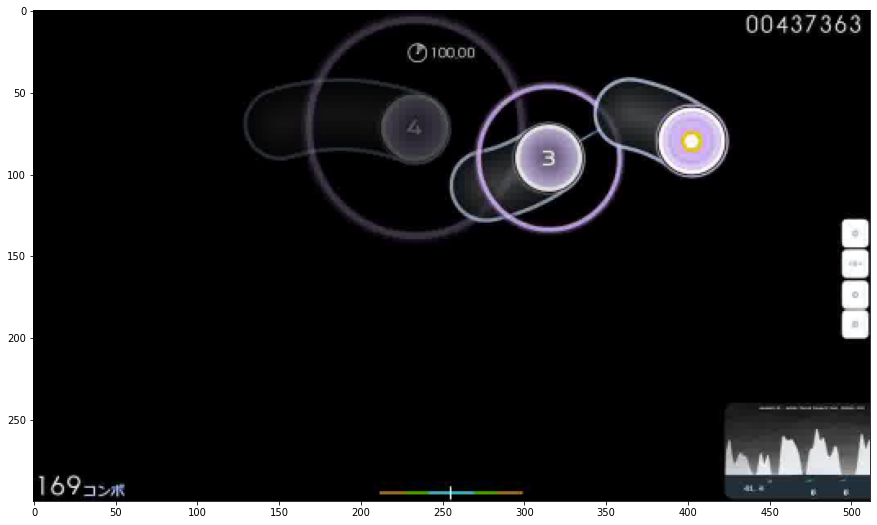

In [ ]:
import matplotlib.pyplot as plt

import op

op.h = 600 / 2
op.w = 1024 / 2
op.calratio()

e = s[0]
print(e[0][0].permute(1, 2, 0).numpy().shape)

plt.rcParams["figure.figsize"] = (15, 15)

plt.xticks(np.arange(0, e[0][0].permute(1, 2, 0).numpy().shape[1], 50))
plt.yticks(np.arange(0, e[0][0].permute(1, 2, 0).numpy().shape[0], 50))

plt.imshow(cv2.cvtColor(e[0][0].permute(1, 2, 0).numpy(), cv2.COLOR_BGR2RGB))
print(e[1][0][1], e[1][0][0])
print(op.cor(e[1][0][1] * 512, e[1][0][0] * 384))
#print(op.cor(e[1][0][1], e[1][0][0]))
#for x in e[1][0:10]:
    #print(op.cor(x[0], x[1]))

# Constants

In [ ]:
sample_rate = 44100
hop_size = 441*2
hidden_mod = 3
maximum = 32
ds_path = './datasets/VN/ds.pkl'
model_path = './models/VN/model01_'

# Process Data

In [ ]:
import time

In [ ]:
ds = OSR_Dataset('../beatmaps', sample_rate=sample_rate, hop_size=hop_size, hidden_mod=hidden_mod, maximum=maximum)

0/31 Chata - Engage (Lasse) [Insane].osu
1/31 Mimi - Surrealism (feat. ZAT) (-Tatsuo) [no mania].osu
2/31 sana - kanojo wa tabi ni deru (Firika) [Insane].osu
3/31 Ishida Youko - To the Promised Sky ~The place that I was~ (caren) [Collabo].osu
4/31 StylipS - Prism Sympathy(Asterisk Remix) (iMage--) [Kaleid Liner].osu
5/31 Cranky - Chandelier - King (Mao) [Gero's Insane].osu
6/31 senya - Akatsuki no Suiheisen ni (Satellite) [Zweib's Insane].osu
7/31 Tadokoro Azusa - 1HOPE SNIPER (Sotarks) [NiNo's Insane].osu
8/31 fripSide - future gazer (TV Size) (alacat) [Insane].osu
9/31 cYsmix - bells! (Gero) [normal!].osu
10/31 Yazawa Nico (CV.Tokui Sora) - Nicopuri Joshidou (yf_bmp) [z1085684963's Insane].osu
11/31 Hamburgaga - Watame Internet Connection Race (CE6A) [Insane].osu
12/31 xi - Parousia -LAST JUDGMENT- (Zapy) [Retribution].osu
13/31 Shiena Nishizawa - Meaning (Taeyang) [xChippy's Insane].osu
14/31 namirin - Hitokoto no Kyori (sahuang) [Linadeft's Insane].osu
15/31 Narushima - Gothic and 

In [ ]:
start = time.time()

torch.save(ds, ds_path)

end = time.time()
print(end - start, 'secs')

0.005749940872192383 secs


# Load Daaset

In [ ]:
ds = torch.load(ds_path)

# Model

In [ ]:
import math
import torch
import torch.nn as nn
import torch.nn.functional as nnF

In [ ]:
class VN(nn.Module):
    def __init__(self, dim_in, device):
        super(VN, self).__init__()
        
        self.device = device
        self.lstmA_size = 64
        self.lstmA_layers = 2
        self.dim_out = 2

        cA = [0,0]
        W = dim_in[0]
        K = cAK = 4
        P = cAP = 1
        S = cAS = 2
        w = int(((W - K + 2*P)/S) + 1)
        k = mAk = 2
        p = mAp = 0
        s = mAs = 2
        m = int(((w - k + 2*p)/s) + 1)
        cA[0] = w
        
        W = dim_in[1]
        K = cAK
        P = cAP
        S = cAS
        w = int(((W - K + 2*P)/S) + 1)
        k = mAk
        p = mAp
        s = mAs
        m = int(((w - k + 2*p)/s) + 1)
        cA[1] = w
        
        cB = [0,0]
        W = cA[0]
        K = cBK = 4
        P = cBP = 1
        S = cBS = 2
        w = int(((W - K + 2*P)/S) + 1)
        k = mBk = 2
        p = mBp = 0
        s = mBs = 2
        m = int(((w - k + 2*p)/s) + 1)
        cB[0] = w
        
        W = cA[1]
        K = cBK
        P = cBP
        S = cBS
        w = int(((W - K + 2*P)/S) + 1)
        k = mBk
        p = mBp
        s = mBs
        m = int(((w - k + 2*p)/s) + 1)
        cB[1] = w
        
        
        self.convA = nn.Conv2d(3, 1, cAK, stride=cAS, padding=cAP)
        #self.maxPA = nn.MaxPool2d(mAk, stride=mAs, padding=mAp)
        self.convB = nn.Conv2d(1, 1, cBK, stride=cBS, padding=cBP) 
        #self.maxPB = nn.MaxPool2d(mBk, stride=mBs, padding=mBp)
        self.linear1 = nn.Linear(math.prod(cB),  int(math.prod(cB)/4))
        
        self.lstmA = nn.LSTM(int(math.prod(cB)/4), hidden_size=self.lstmA_size, num_layers=self.lstmA_layers,
                             batch_first=True, bidirectional=False)
        self.linearA = nn.Linear(self.lstmA_size, 32)
        self.linearB = nn.Linear(32, self.dim_out)
        
        self.hiddenA = None
        
    def init_hidden(self, batch_size):
        h = torch.zeros(self.lstmA_layers, batch_size, self.lstmA_size).to(self.device)
        c = torch.zeros(self.lstmA_layers, batch_size, self.lstmA_size).to(self.device)
        self.hiddenA = (h, c)
 
    def forward(self, x):
        s = x.shape
        x = torch.reshape(x, (s[0] * s[1], s[2], s[3], s[4]))
        x = self.convA(x)
        x = nnF.relu(x)
        #x = self.maxPA(x)
        x = self.convB(x)
        x = nnF.relu(x)
        #x = self.maxPB(x)
        x = torch.flatten(x, start_dim=1)
        x = torch.reshape(x, (s[0], s[1], x.shape[-1]))
                          
        x = self.linear1(x)
        x = nnF.relu(x)

        
        x, self.hiddenA = self.lstmA(x, self.hiddenA)
        x = self.linearA(x)
        x = nnF.relu(x)
        x = self.linearB(x)
        
        return x

# Training

In [ ]:
import torch
from torch.utils.data import DataLoader
from torchinfo import summary
from qqdm.notebook import qqdm
import matplotlib.pyplot as plt
import op

In [ ]:
batch_size = 2
scale = 1/4
dim_in = (int(600 * scale), int(1024 * scale))
seq_dur = 4

In [ ]:
device = torch.device('cuda')

In [ ]:
epoch_cum = 0
val_hist = []
train_hist = []
vn = VN(dim_in=dim_in, device=device)
vn.to(device)

VN(
  (convA): Conv2d(3, 1, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (convB): Conv2d(1, 1, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (linear1): Linear(in_features=2368, out_features=592, bias=True)
  (lstmA): LSTM(592, 64, num_layers=2, batch_first=True)
  (linearA): Linear(in_features=64, out_features=32, bias=True)
  (linearB): Linear(in_features=32, out_features=2, bias=True)
)

In [ ]:
vn.init_hidden(1)
summary(vn, input_size=(1, 1, 3, dim_in[0], dim_in[1]), col_width=16,
           col_names=["input_size",
                "output_size",
                "num_params",
                "kernel_size",
                "mult_adds",])

Layer (type:depth-idx)                   Input Shape      Output Shape     Param #          Kernel Shape     Mult-Adds
VN                                       --               --               --               --               --
├─Conv2d: 1-1                            [1, 3, 150, 256] [1, 1, 75, 128]  49               [3, 1, 4, 4]     470,400
├─Conv2d: 1-2                            [1, 1, 75, 128]  [1, 1, 37, 64]   17               [1, 1, 4, 4]     40,256
├─Linear: 1-3                            [1, 1, 2368]     [1, 1, 592]      1,402,448        [2368, 592]      1,402,448
├─LSTM: 1-4                              [1, 1, 592]      [1, 1, 64]       201,728          --               201,728
├─Linear: 1-5                            [1, 1, 64]       [1, 1, 32]       2,080            [64, 32]         2,080
├─Linear: 1-6                            [1, 1, 32]       [1, 1, 2]        66               [32, 2]          66
Total params: 1,606,388
Trainable params: 1,606,388
Non-trainable params:

In [ ]:
train_ds = OSR_Dataset(None, sample_rate=sample_rate, hop_size=hop_size, seq_dur=seq_dur, scale=scale, hidden_mod=hidden_mod, maximum=maximum)
val_ds = OSR_Dataset(None, sample_rate=sample_rate, hop_size=hop_size, seq_dur=seq_dur, scale=scale, hidden_mod=hidden_mod, maximum=maximum)

train_ds.take(ds, 0, int(len(ds) * 0.8))
val_ds.take(ds, int(len(ds) * 0.8), len(ds))

train_ldr = DataLoader(train_ds, batch_size=batch_size, shuffle=True, num_workers=1, prefetch_factor=2)
val_ldr = DataLoader(val_ds, batch_size=batch_size, shuffle=True, num_workers=1, prefetch_factor=2)

In [ ]:
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(vn.parameters(), lr=0.001)

In [ ]:
op.h = dim_in[0]
op.w = dim_in[1]
op.calratio()

def trainVN():
    global epoch_cum, lamb
    global v, c, PV, pv, g, gt, MP, MC

    for epoch in range(epochs):
        vn.train()
        train_loss = 0
        info = qqdm(train_ldr)
        for v, c in info:
        #for v, c in train_ldr:
            V, C = v.to(device), c.to(device)
            
            optimizer.zero_grad()
            vn.init_hidden(v.shape[0])
            PV = vn(V)
            
            mp = PV.cpu()
            mc = c
            for i in range(c.shape[0]):
                for j in range(c.shape[1]):
                    if c[i][j][2] != 1:
                        mc[i][j] = torch.tensor([0, 0, 0])
                        mp[i][j] = torch.tensor([0, 0])
            loss1 = criterion(PV, C[:,:,:2])
            loss2 = criterion(mp, mc[:,:,:2])
            
            loss = loss1 + loss2 * lamb
            loss.backward()
            optimizer.step()
            
            train_loss += loss.item()
            info.set_infos({'loss': f'{loss.item():.4f}'})

        vn.eval()
        torch.no_grad()
        val_loss = 0
        for v, c in val_ldr:
            V, C = v.to(device), c.to(device)

            vn.init_hidden(v.shape[0])
            PV = vn(V)
            
            loss = criterion(PV, C[:,:,:2])
            val_loss += loss.item()

        print(epoch+epoch_cum, 'of', epochs+epoch_cum)

        plt.rcParams["figure.figsize"] = (15, 5)
        plt.figure()
        _, p = plt.subplots(1, 3)
        
        e = v[0][10].permute(1, 2, 0).numpy()
        g = c[0][10][:2]
        print('pred:', float(PV[0][0][1]), float(PV[0][0][0]))
        print('gt:', float(g[1]), float(g[0]))
        print(op.cor(g[1] * 512, g[0] * 384))
        p[0].imshow(cv2.cvtColor(e, cv2.COLOR_BGR2RGB))
        
        pv = PV[0].cpu().detach().numpy().transpose(1, 0)
        p[1].plot(pv[0], pv[1])
        gt = c[0].permute(1, 0).numpy()
        p[1].plot(gt[0], gt[1])
        
        train_loss = train_loss/len(train_ldr)
        val_loss = val_loss/len(val_ldr)
        train_hist.append(float(train_loss))
        val_hist.append(float(val_loss))
        
        p[2].plot(train_hist)
        p[2].plot(val_hist)
        
        plt.show()

    epoch_cum += epochs

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:18<00:00:00  0.71it/s  0.0441                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

0 of 64
pred: 0.1670236736536026 0.23408940434455872
gt: 0.11856142431497574 0.5122952461242676
(66, 77)


<Figure size 1080x360 with 0 Axes>

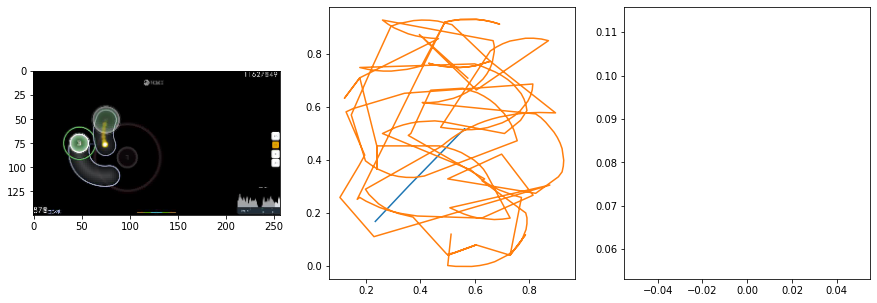

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:18<00:00:00  0.70it/s  0.0589                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

1 of 64
pred: 0.18724389374256134 0.2356615662574768
gt: 0.6234681606292725 0.5
(144, 76)


<Figure size 1080x360 with 0 Axes>

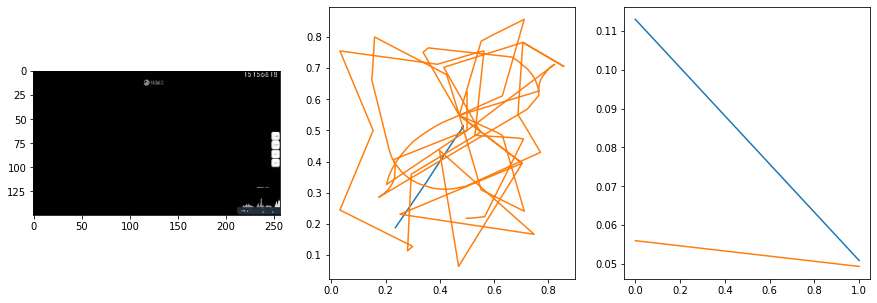

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:18<00:00:00  0.71it/s  0.0500                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

2 of 64
pred: 0.19073382019996643 0.24708175659179688
gt: 0.328125 0.12950000166893005
(98, 33)


<Figure size 1080x360 with 0 Axes>

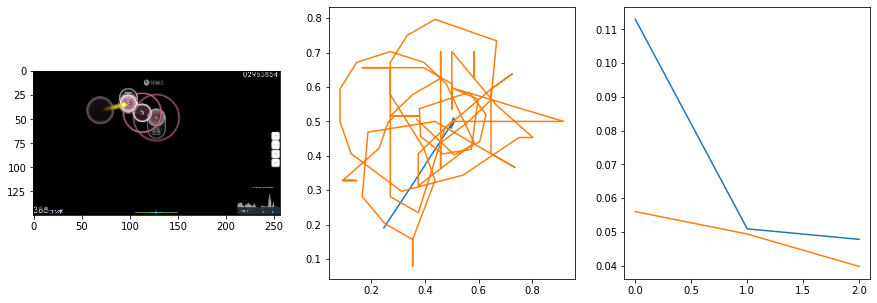

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:19<00:00:00  0.65it/s  0.0123                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

3 of 64
pred: 0.20244699716567993 0.25378552079200745
gt: 0.419348806142807 0.7423902153968811
(113, 104)


<Figure size 1080x360 with 0 Axes>

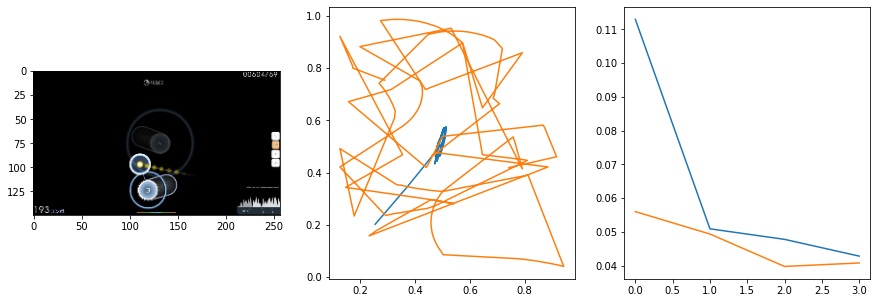

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:19<00:00:00  0.68it/s  0.0281                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

4 of 64
pred: 0.1088458001613617 0.21775487065315247
gt: 0.184815913438797 0.4848403036594391
(76, 74)


<Figure size 1080x360 with 0 Axes>

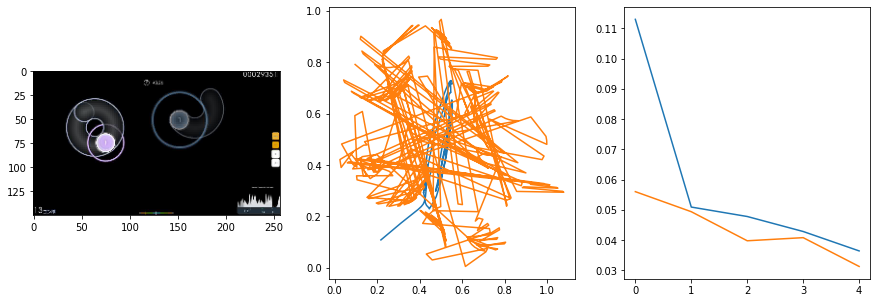

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:19<00:00:00  0.67it/s  0.0196                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

5 of 64
pred: 0.17376726865768433 0.22208160161972046
gt: 0.5245254039764404 0.2515867352485657
(129, 47)


<Figure size 1080x360 with 0 Axes>

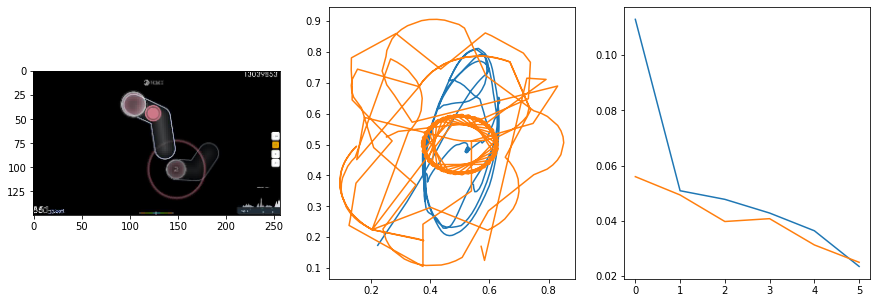

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:18<00:00:00  0.70it/s  0.0090                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

6 of 64
pred: 0.1564527451992035 0.2766638994216919
gt: 0.3125 0.7708333134651184
(96, 107)


<Figure size 1080x360 with 0 Axes>

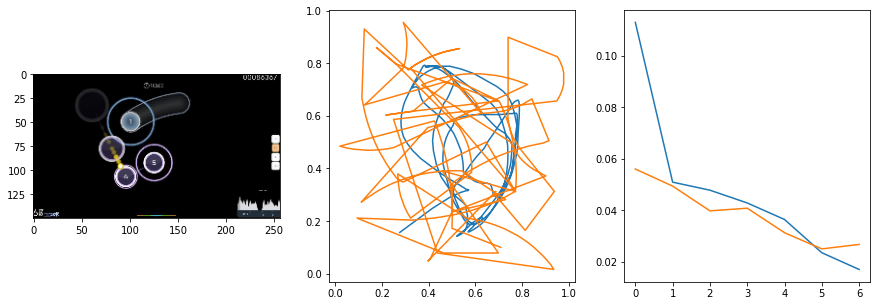

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:18<00:00:00  0.70it/s  0.0189                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

7 of 64
pred: 0.22073526680469513 0.21394288539886475
gt: 0.732421875 0.6927083134651184
(161, 98)


<Figure size 1080x360 with 0 Axes>

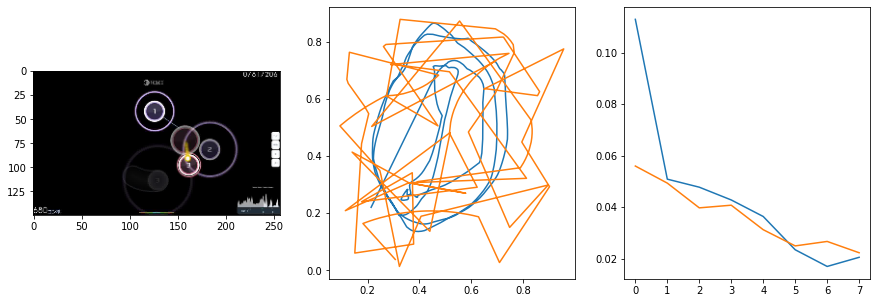

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:17<00:00:00  0.75it/s  0.0248                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

8 of 64
pred: 0.207676500082016 0.20708131790161133
gt: 0.8515625 0.1354166716337204
(180, 33)


<Figure size 1080x360 with 0 Axes>

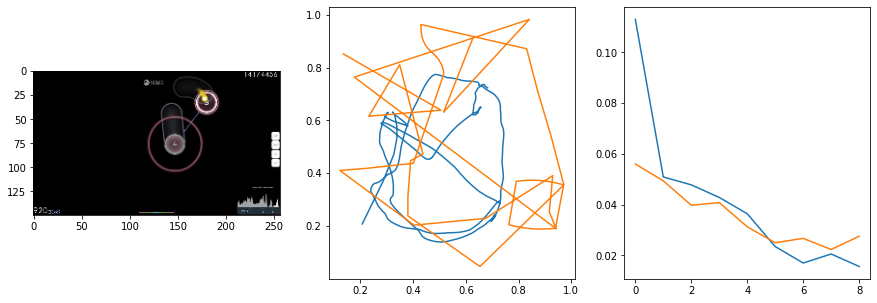

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:17<00:00:00  0.75it/s  0.0052                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

9 of 64
pred: 0.1994331032037735 0.2448495477437973
gt: 0.464829683303833 0.4676953852176666
(120, 72)


<Figure size 1080x360 with 0 Axes>

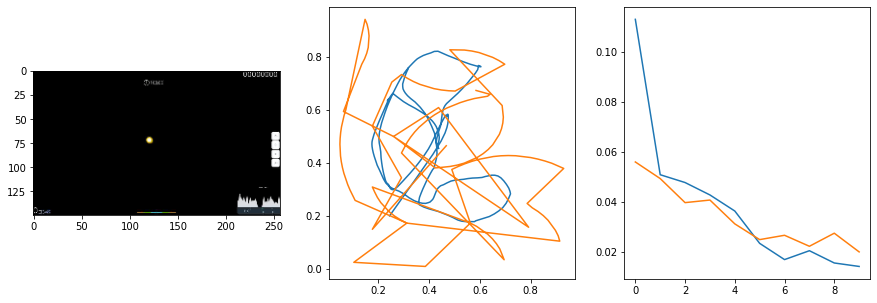

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:17<00:00:00  0.74it/s  0.0132                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

10 of 64
pred: 0.284785658121109 0.3145998418331146
gt: 0.648297131061554 0.6415918469429016
(148, 92)


<Figure size 1080x360 with 0 Axes>

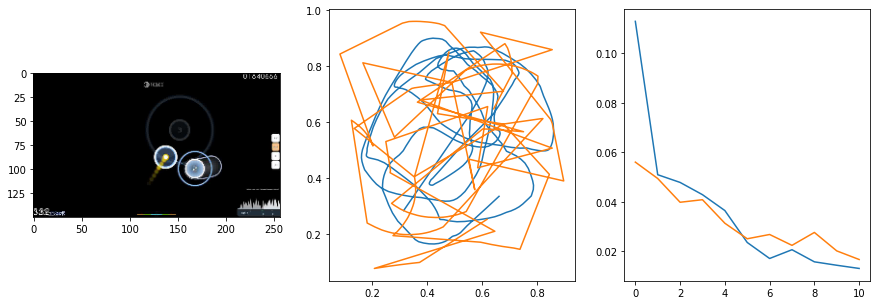

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:17<00:00:00  0.74it/s  0.0116                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

11 of 64
pred: 0.12970927357673645 0.24770215153694153
gt: 0.029296875 0.6197916865348816
(52, 90)


<Figure size 1080x360 with 0 Axes>

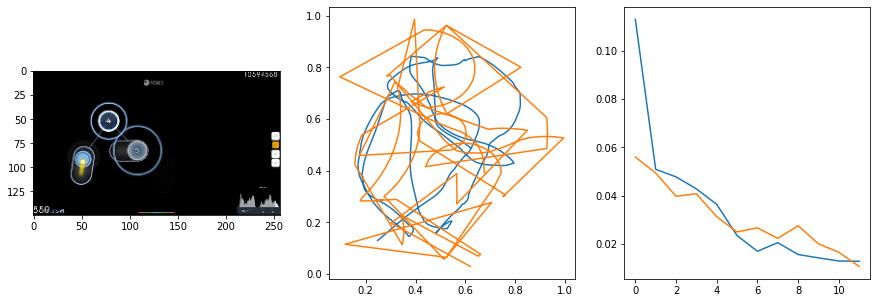

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:17<00:00:00  0.73it/s  0.0139                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

12 of 64
pred: 0.13237400352954865 0.2957477569580078
gt: 0.15715144574642181 0.6430288553237915
(72, 92)


<Figure size 1080x360 with 0 Axes>

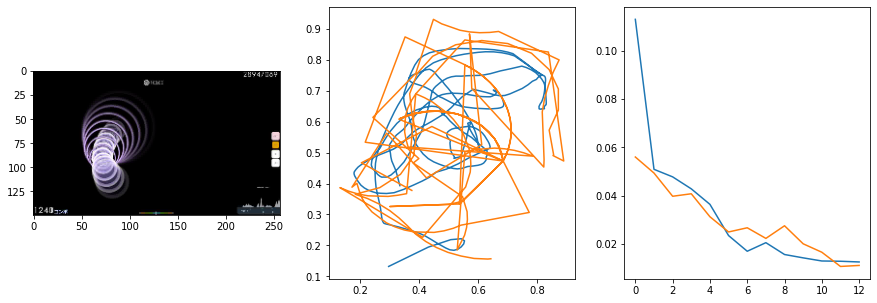

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:19<00:00:00  0.67it/s  0.0235                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

13 of 64
pred: 0.22849862277507782 0.27697286009788513
gt: 0.337890625 0.5703125
(100, 84)


<Figure size 1080x360 with 0 Axes>

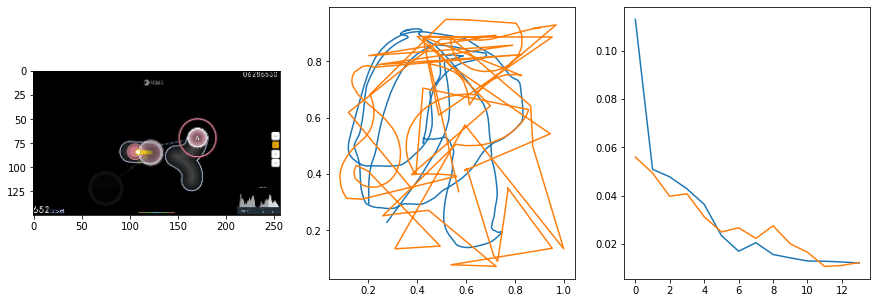

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:19<00:00:00  0.67it/s  0.0086                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

14 of 64
pred: 0.22753332555294037 0.2766439616680145
gt: 0.5 0.5625
(125, 83)


<Figure size 1080x360 with 0 Axes>

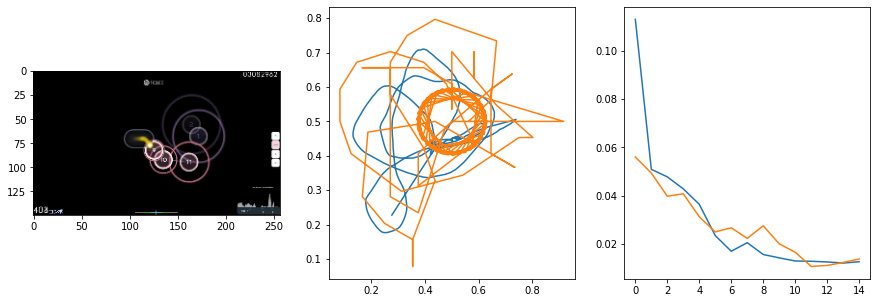

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:18<00:00:00  0.69it/s  0.0164                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

15 of 64
pred: 0.12060348689556122 0.2697174847126007
gt: 0.03719687461853027 0.35736000537872314
(53, 59)


<Figure size 1080x360 with 0 Axes>

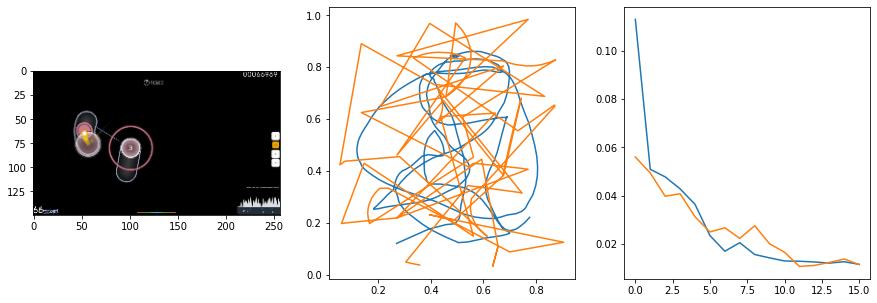

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:19<00:00:00  0.67it/s  0.0103                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

16 of 64
pred: 0.1941845715045929 0.24841195344924927
gt: 0.23454158008098602 0.3185822665691376
(84, 55)


<Figure size 1080x360 with 0 Axes>

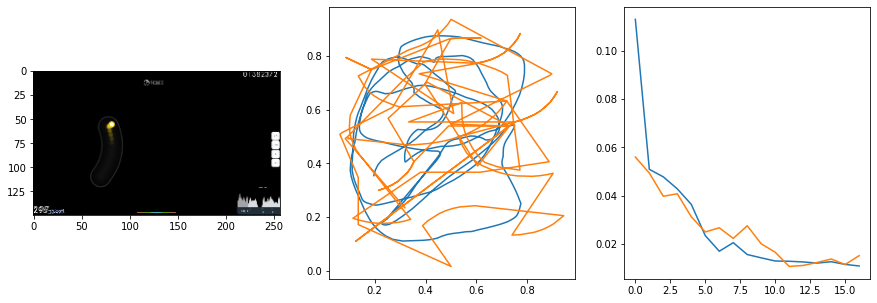

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:19<00:00:00  0.66it/s  0.0040                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

17 of 64
pred: 0.3046363592147827 0.3577873408794403
gt: 0.8172470331192017 0.6794444918632507
(174, 97)


<Figure size 1080x360 with 0 Axes>

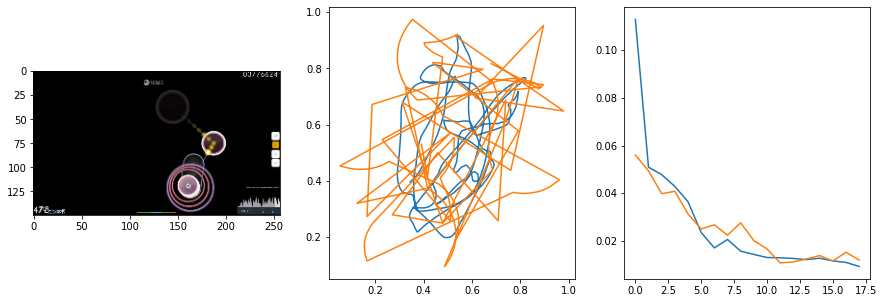

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:19<00:00:00  0.67it/s  0.0032                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

18 of 64
pred: 0.22224591672420502 0.2772892713546753
gt: 0.5899395942687988 0.568661630153656
(139, 84)


<Figure size 1080x360 with 0 Axes>

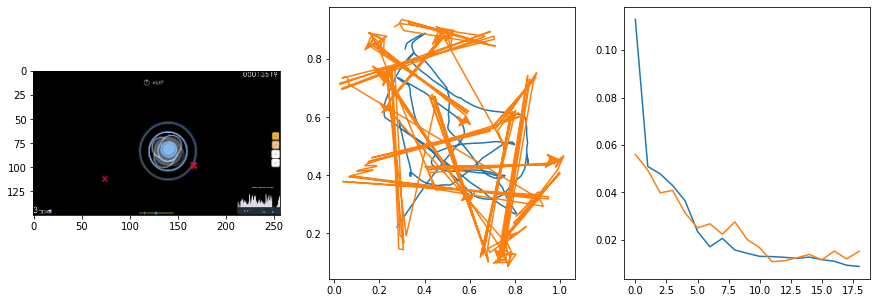

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:19<00:00:00  0.66it/s  0.0083                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

19 of 64
pred: 0.19030117988586426 0.26490676403045654
gt: 0.44118303060531616 0.41495534777641296
(116, 66)


<Figure size 1080x360 with 0 Axes>

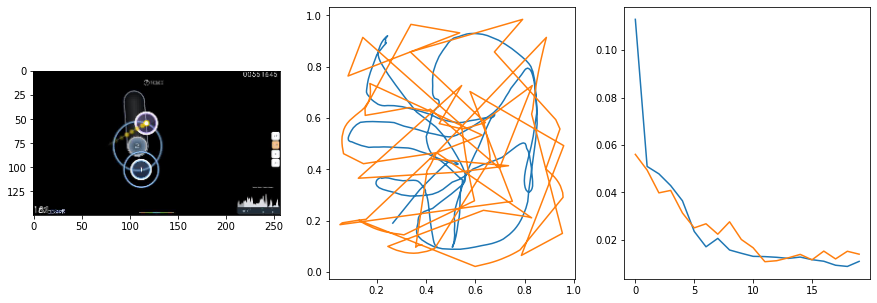

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:19<00:00:00  0.66it/s  0.0143                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

20 of 64
pred: 0.19639520347118378 0.22438238561153412
gt: 0.5207270383834839 0.2997449040412903
(128, 52)


<Figure size 1080x360 with 0 Axes>

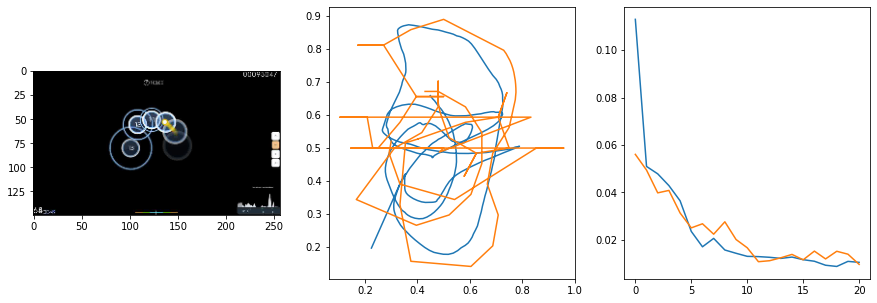

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:19<00:00:00  0.67it/s  0.0069                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

21 of 64
pred: 0.2601131796836853 0.2551681399345398
gt: 0.6422784924507141 0.36266613006591797
(147, 60)


<Figure size 1080x360 with 0 Axes>

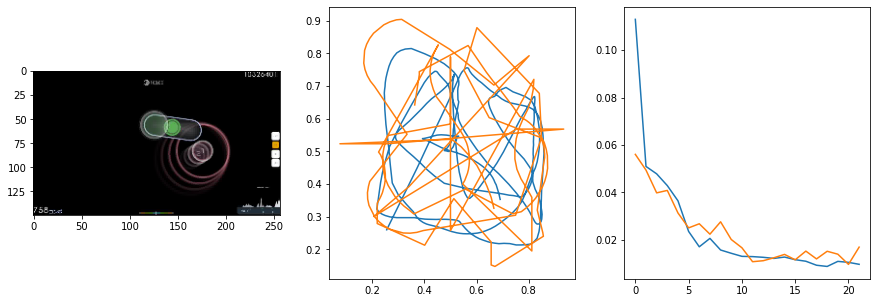

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:19<00:00:00  0.67it/s  0.0035                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

22 of 64
pred: 0.1761496365070343 0.20167002081871033
gt: 0.3156282603740692 0.36687496304512024
(96, 60)


<Figure size 1080x360 with 0 Axes>

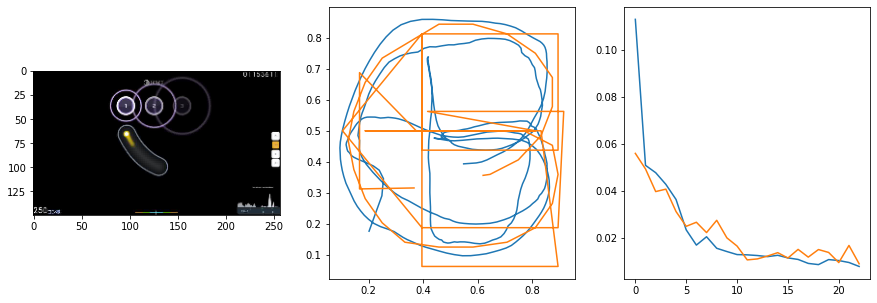

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:18<00:00:00  0.69it/s  0.0075                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

23 of 64
pred: 0.1656402051448822 0.30729690194129944
gt: 0.20398761332035065 0.6027126312255859
(79, 88)


<Figure size 1080x360 with 0 Axes>

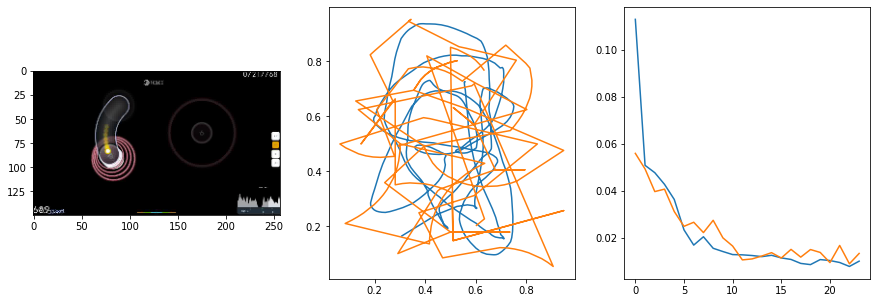

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:18<00:00:00  0.70it/s  0.0128                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

24 of 64
pred: 0.18768326938152313 0.2446858286857605
gt: 0.2789735198020935 0.4601269066333771
(91, 71)


<Figure size 1080x360 with 0 Axes>

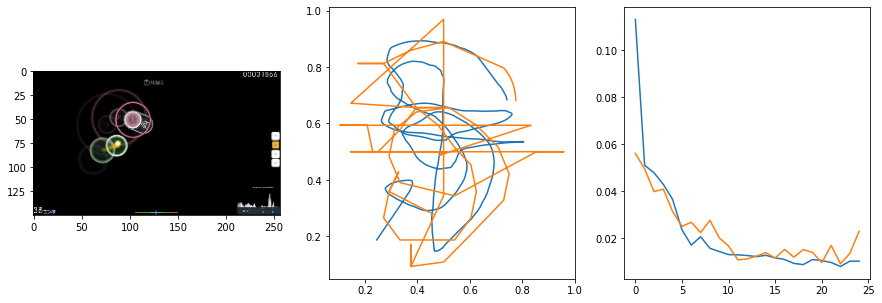

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:18<00:00:00  0.68it/s  0.0062                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

25 of 64
pred: 0.1360706239938736 0.2118760049343109
gt: 0.13277067244052887 0.21961991488933563
(68, 43)


<Figure size 1080x360 with 0 Axes>

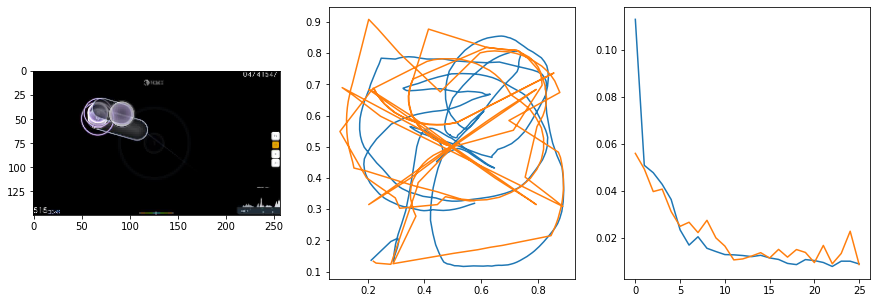

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:18<00:00:00  0.70it/s  0.0069                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

26 of 64
pred: 0.20288053154945374 0.346410870552063
gt: 0.3954866826534271 0.8361017107963562
(109, 115)


<Figure size 1080x360 with 0 Axes>

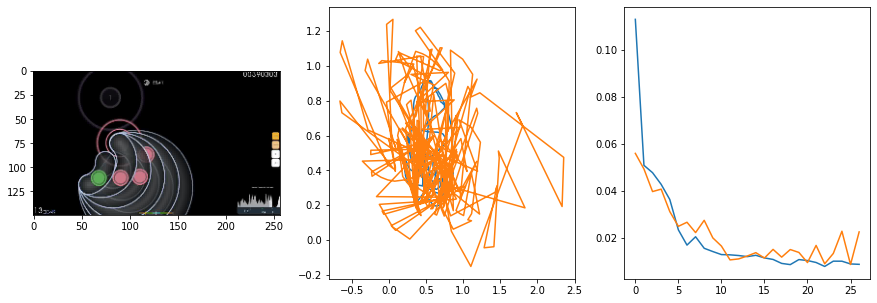

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:17<00:00:00  0.74it/s  0.0101                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

27 of 64
pred: 0.17086419463157654 0.23098577558994293
gt: 0.221730038523674 0.3157326579093933
(82, 54)


<Figure size 1080x360 with 0 Axes>

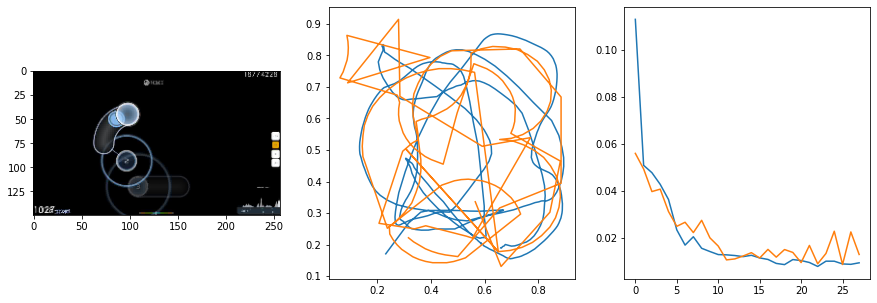

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:17<00:00:00  0.74it/s  0.0131                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

28 of 64
pred: 0.29130247235298157 0.2401845008134842
gt: 0.6995618939399719 0.43045222759246826
(156, 68)


<Figure size 1080x360 with 0 Axes>

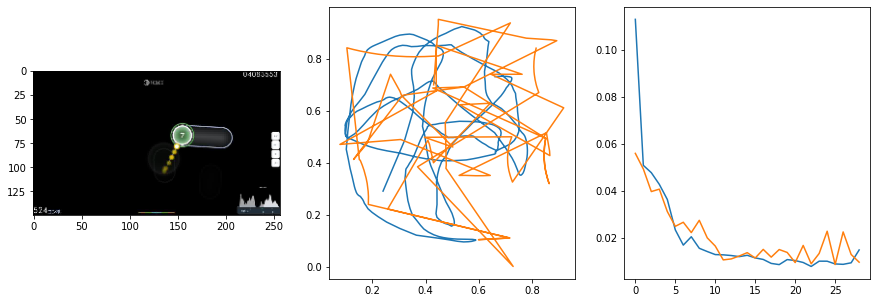

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:18<00:00:00  0.69it/s  0.0100                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

29 of 64
pred: 0.208577498793602 0.20405714213848114
gt: 0.36217889189720154 0.32734689116477966
(104, 56)


<Figure size 1080x360 with 0 Axes>

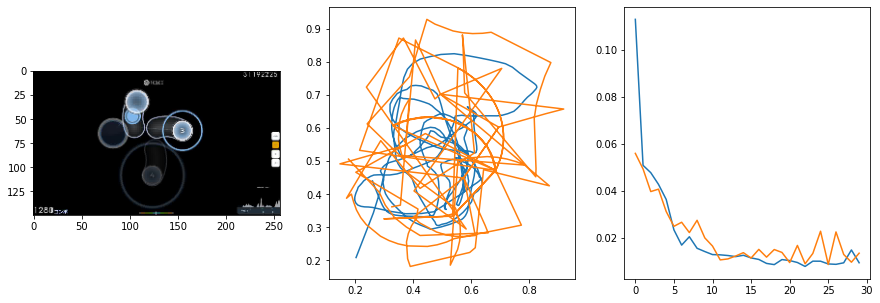

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:18<00:00:00  0.70it/s  0.0077                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

30 of 64
pred: 0.1984339952468872 0.2894974946975708
gt: 0.4957795739173889 0.49324730038642883
(124, 75)


<Figure size 1080x360 with 0 Axes>

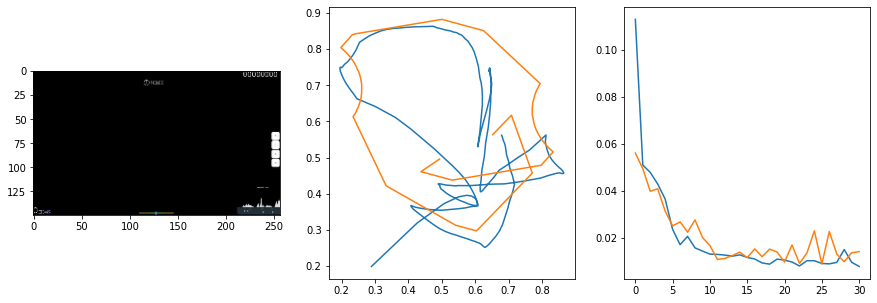

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:18<00:00:00  0.70it/s  0.0036                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

31 of 64
pred: 0.28530043363571167 0.243466317653656
gt: 0.7272499799728394 0.28216665983200073
(160, 50)


<Figure size 1080x360 with 0 Axes>

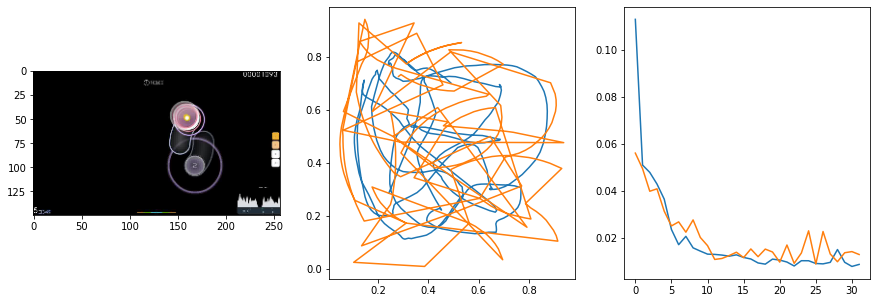

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:17<00:00:00  0.74it/s  0.0059                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

32 of 64
pred: 0.14048784971237183 0.23198306560516357
gt: 0.027982041239738464 0.04224219545722008
(52, 22)


<Figure size 1080x360 with 0 Axes>

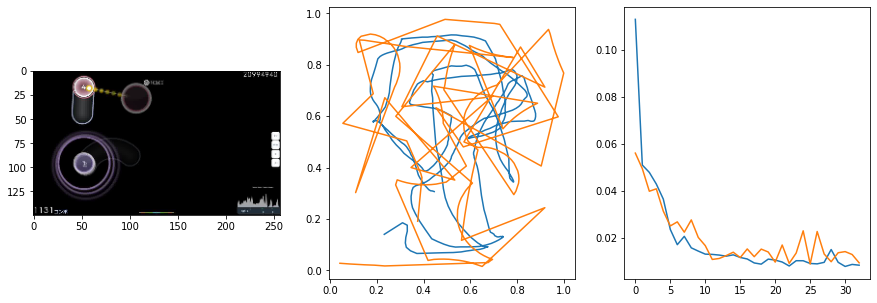

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:18<00:00:00  0.70it/s  0.0078                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

33 of 64
pred: 0.30564555525779724 0.3530954122543335
gt: 0.982421875 0.8411458134651184
(200, 115)


<Figure size 1080x360 with 0 Axes>

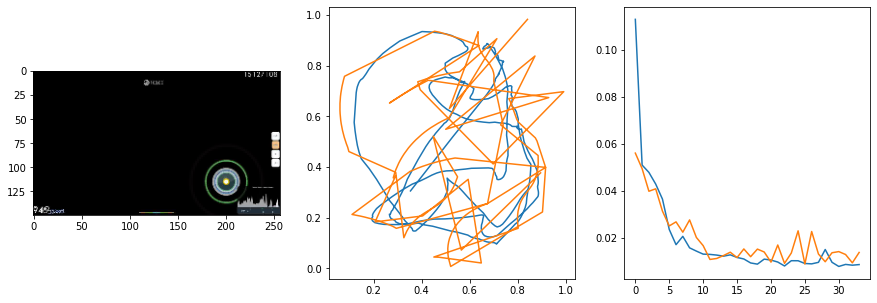

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:18<00:00:00  0.70it/s  0.0055                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

34 of 64
pred: 0.3406193256378174 0.39298170804977417
gt: 0.9378979802131653 0.8367611765861511
(193, 115)


<Figure size 1080x360 with 0 Axes>

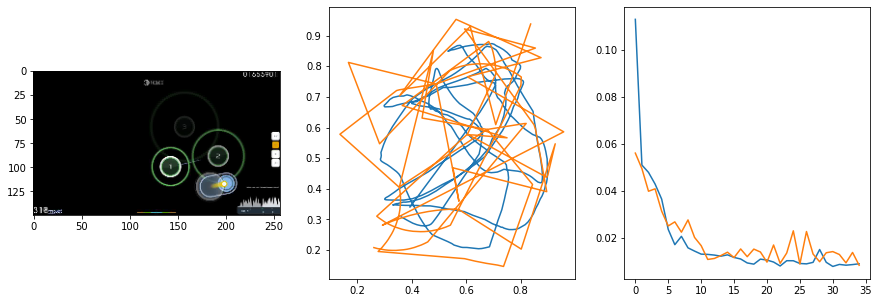

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:18<00:00:00  0.71it/s  0.0085                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

35 of 64
pred: 0.310803085565567 0.30455049872398376
gt: 0.7181655764579773 0.6139306426048279
(159, 89)


<Figure size 1080x360 with 0 Axes>

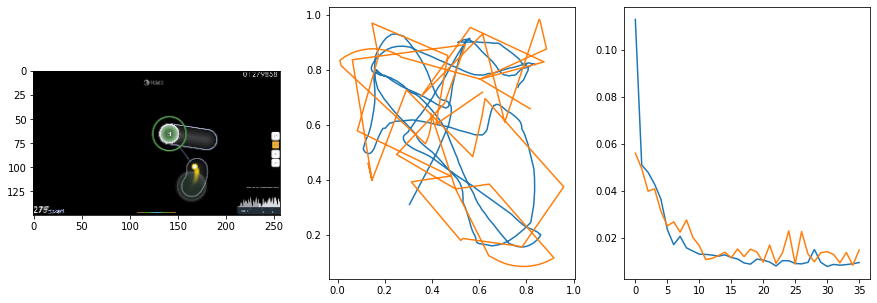

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:18<00:00:00  0.70it/s  0.0111                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

36 of 64
pred: 0.300843209028244 0.27852892875671387
gt: 0.779600203037262 0.34375
(168, 57)


<Figure size 1080x360 with 0 Axes>

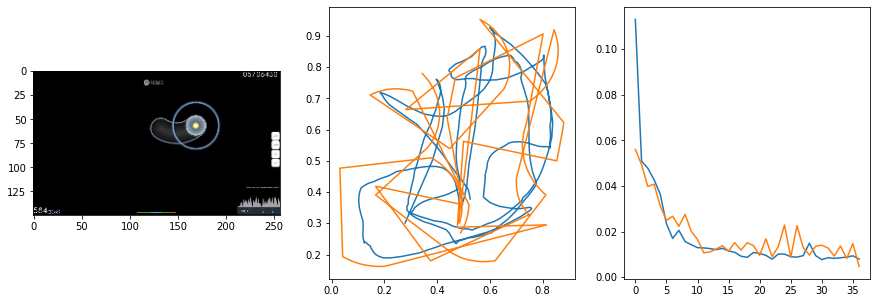

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:18<00:00:00  0.71it/s  0.0036                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

37 of 64
pred: 0.20541831851005554 0.24145078659057617
gt: 0.37919744849205017 0.24496932327747345
(106, 46)


<Figure size 1080x360 with 0 Axes>

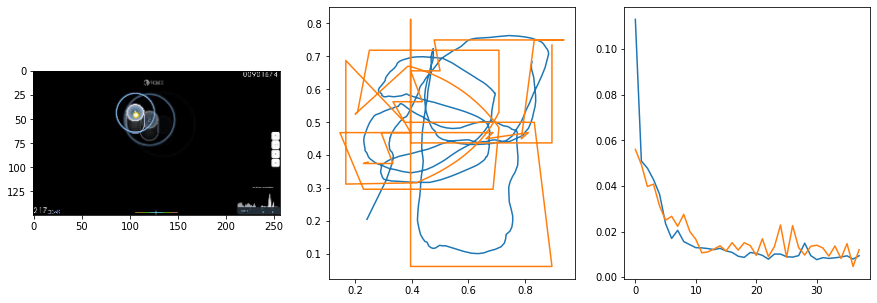

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:18<00:00:00  0.71it/s  0.0068                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

38 of 64
pred: 0.14753669500350952 0.20772330462932587
gt: 0.10688304901123047 0.1795511692762375
(64, 38)


<Figure size 1080x360 with 0 Axes>

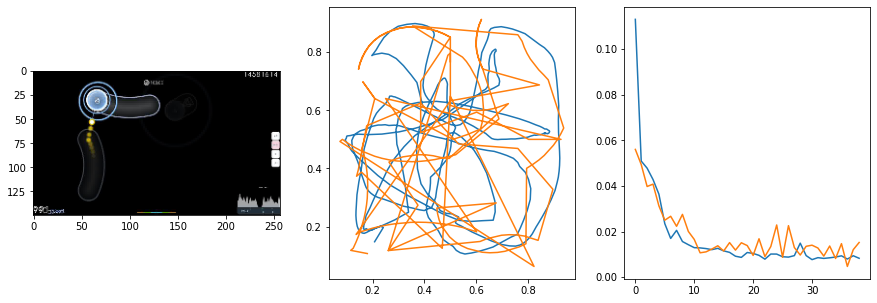

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:18<00:00:00  0.71it/s  0.0095                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

39 of 64
pred: 0.22985318303108215 0.29005366563796997
gt: 0.5 0.5400159955024719
(125, 80)


<Figure size 1080x360 with 0 Axes>

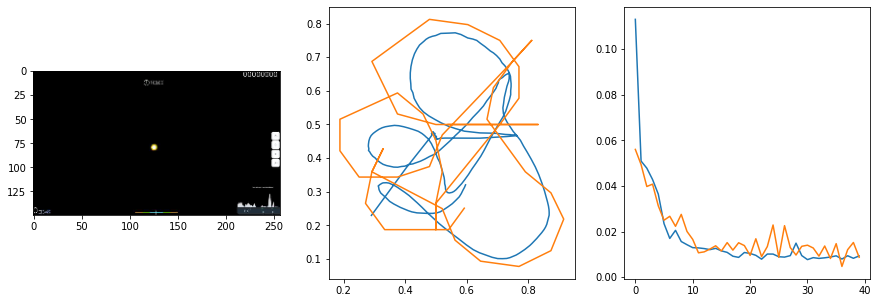

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:18<00:00:00  0.70it/s  0.0088                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

40 of 64
pred: 0.28371483087539673 0.2727278769016266
gt: 0.546875 0.36666667461395264
(132, 60)


<Figure size 1080x360 with 0 Axes>

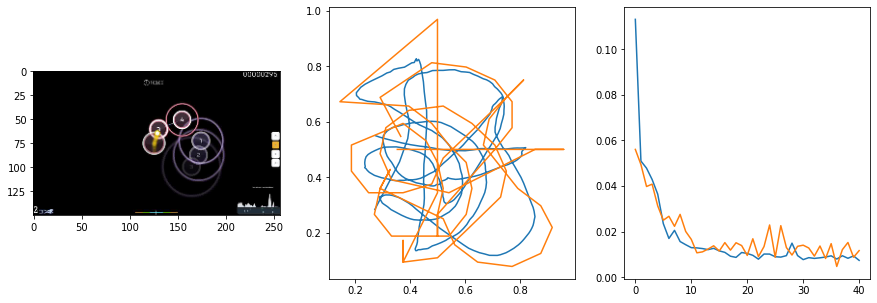

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:17<00:00:00  0.74it/s  0.0088                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

41 of 64
pred: 0.28871652483940125 0.3962332010269165
gt: 0.5181361436843872 0.6716623902320862
(128, 96)


<Figure size 1080x360 with 0 Axes>

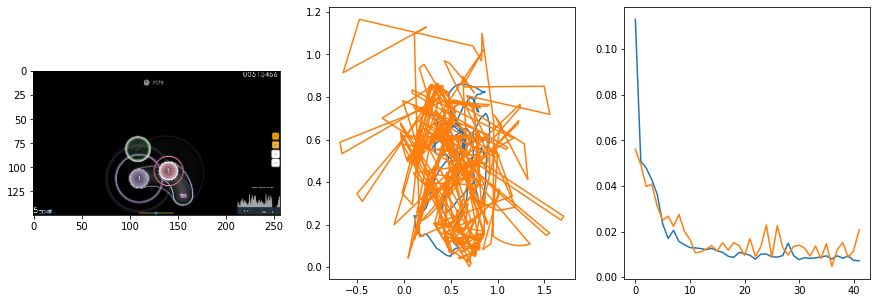

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:18<00:00:00  0.71it/s  0.0045                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

42 of 64
pred: 0.20074889063835144 0.23329493403434753
gt: 0.3639999032020569 0.30188310146331787
(104, 53)


<Figure size 1080x360 with 0 Axes>

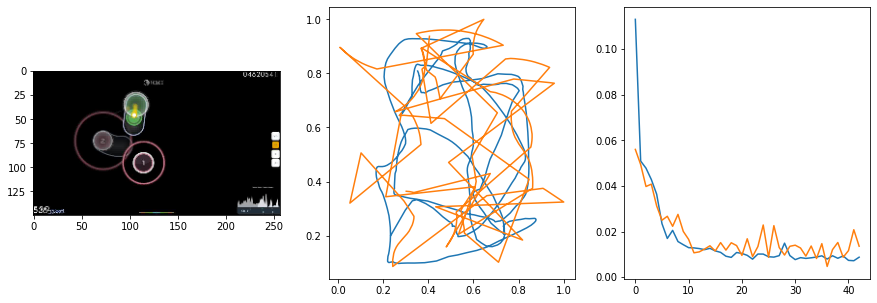

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:18<00:00:00  0.70it/s  0.0111                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

43 of 64
pred: 0.1752707064151764 0.3248085081577301
gt: 0.12960635125637054 0.6878778338432312
(68, 98)


<Figure size 1080x360 with 0 Axes>

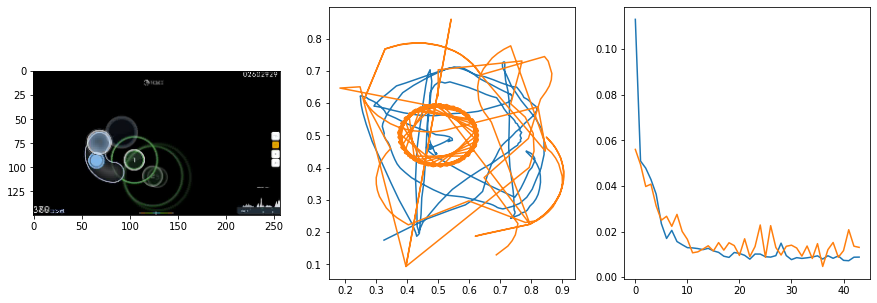

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:18<00:00:00  0.70it/s  0.0019                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

44 of 64
pred: 0.2995930314064026 0.3331656754016876
gt: 0.6010441184043884 0.6282342076301575
(141, 91)


<Figure size 1080x360 with 0 Axes>

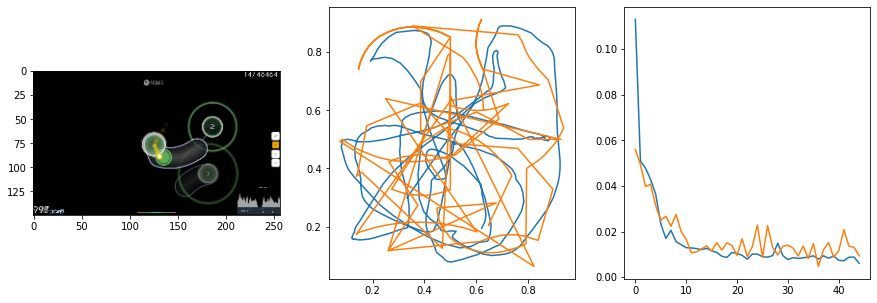

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:18<00:00:00  0.70it/s  0.0092                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

45 of 64
pred: 0.15466898679733276 0.3647841811180115
gt: 0.26361772418022156 0.4037180244922638
(88, 64)


<Figure size 1080x360 with 0 Axes>

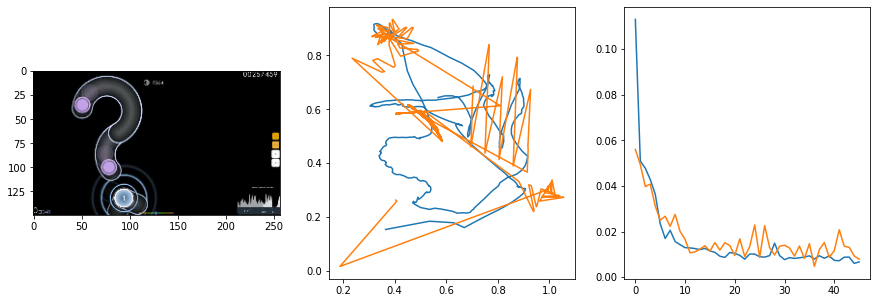

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:18<00:00:00  0.71it/s  0.0072                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

46 of 64
pred: 0.2015089988708496 0.32521992921829224
gt: 0.24686357378959656 0.5919588804244995
(86, 86)


<Figure size 1080x360 with 0 Axes>

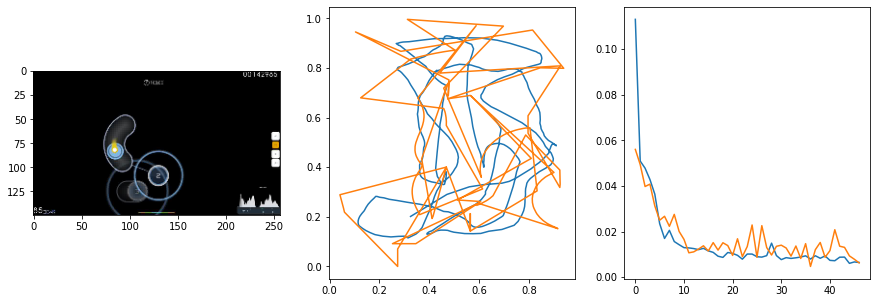

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:17<00:00:00  0.74it/s  0.0059                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

47 of 64
pred: 0.24890407919883728 0.2982080578804016
gt: 0.4024246335029602 0.5052986145019531
(110, 76)


<Figure size 1080x360 with 0 Axes>

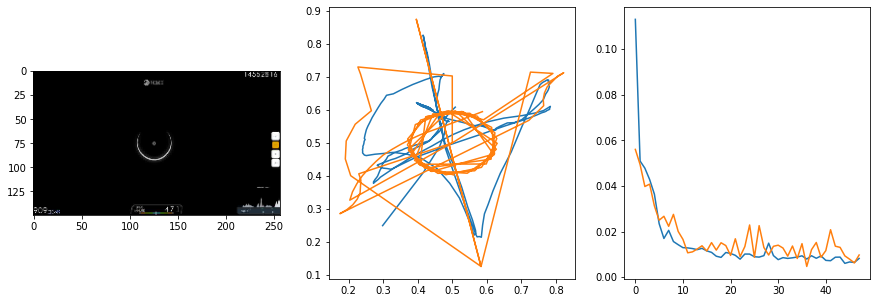

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:18<00:00:00  0.69it/s  0.0057                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

48 of 64
pred: 0.26941025257110596 0.3049026429653168
gt: 0.45915842056274414 0.511344850063324
(119, 77)


<Figure size 1080x360 with 0 Axes>

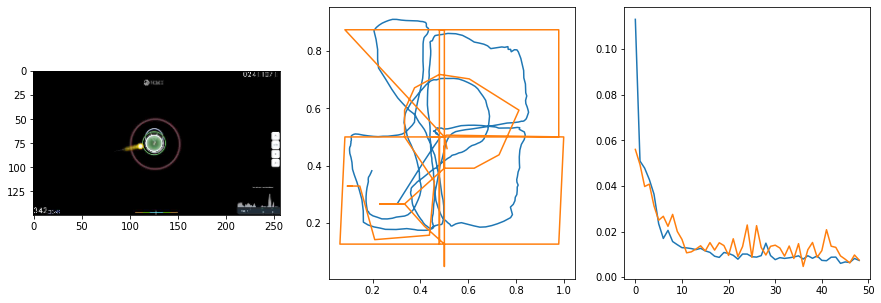

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:18<00:00:00  0.69it/s  0.0107                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

49 of 64
pred: 0.26437002420425415 0.24324128031730652
gt: 0.54204922914505 0.30057960748672485
(132, 52)


<Figure size 1080x360 with 0 Axes>

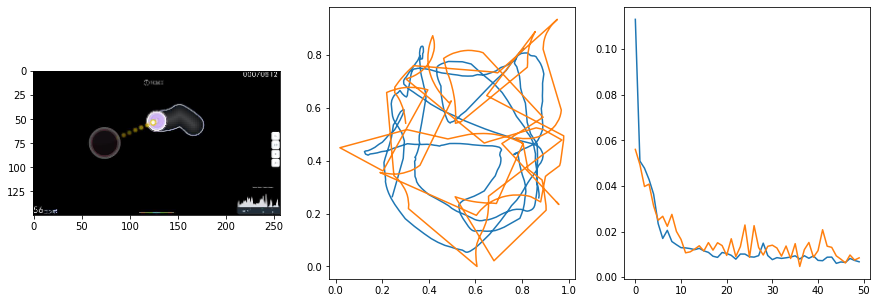

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:18<00:00:00  0.70it/s  0.0037                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

50 of 64
pred: 0.2981237769126892 0.2895142436027527
gt: 0.9591959714889526 0.3500634729862213
(196, 58)


<Figure size 1080x360 with 0 Axes>

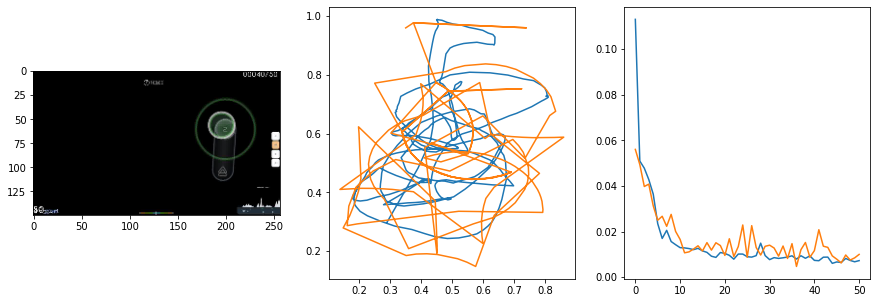

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:18<00:00:00  0.70it/s  0.0068                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

51 of 64
pred: 0.31667017936706543 0.3050517737865448
gt: 0.9714264869689941 0.48532935976982117
(198, 74)


<Figure size 1080x360 with 0 Axes>

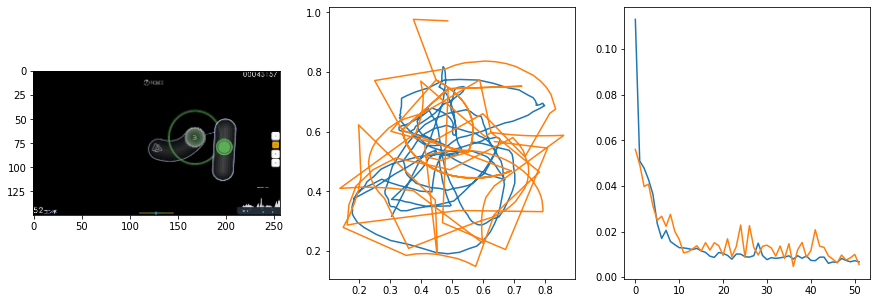

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:18<00:00:00  0.70it/s  0.0069                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

52 of 64
pred: 0.20070111751556396 0.27040672302246094
gt: 0.2491714060306549 0.3534564673900604
(86, 59)


<Figure size 1080x360 with 0 Axes>

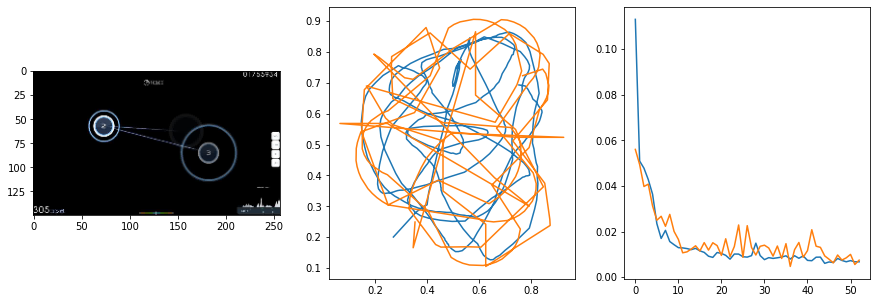

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:18<00:00:00  0.70it/s  0.0096                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

53 of 64
pred: 0.30366650223731995 0.231020987033844
gt: 0.537109375 0.2942708432674408
(131, 52)


<Figure size 1080x360 with 0 Axes>

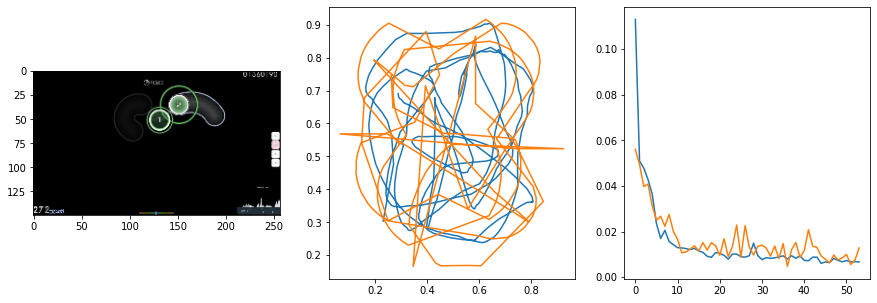

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:18<00:00:00  0.69it/s  0.0043                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

54 of 64
pred: 0.25211101770401 0.24623623490333557
gt: 0.4242314100265503 0.19806139171123505
(113, 41)


<Figure size 1080x360 with 0 Axes>

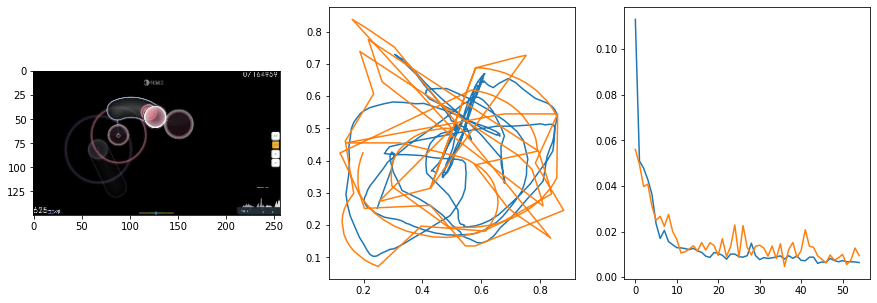

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:18<00:00:00  0.69it/s  0.0029                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

55 of 64
pred: 0.2405501753091812 0.32695966958999634
gt: 0.3671875 0.59375
(104, 87)


<Figure size 1080x360 with 0 Axes>

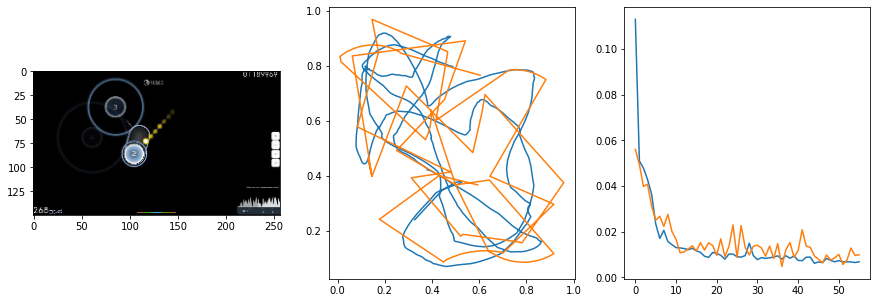

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:17<00:00:00  0.73it/s  0.0080                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

56 of 64
pred: 0.277986079454422 0.3732330799102783
gt: 0.46875 0.6666666865348816
(120, 95)


<Figure size 1080x360 with 0 Axes>

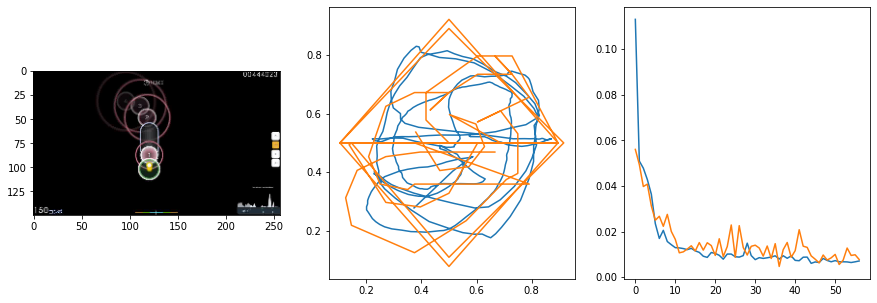

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:18<00:00:00  0.71it/s  0.0045                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

57 of 64
pred: 0.3256767690181732 0.45930880308151245
gt: 0.5669001340866089 0.9416307806968689
(135, 127)


<Figure size 1080x360 with 0 Axes>

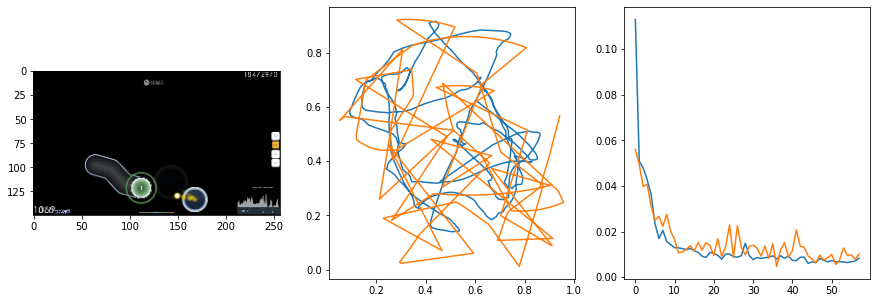

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:18<00:00:00  0.69it/s  0.0083                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

58 of 64
pred: 0.2901992201805115 0.2767888307571411
gt: 0.5184659361839294 0.35353532433509827
(128, 59)


<Figure size 1080x360 with 0 Axes>

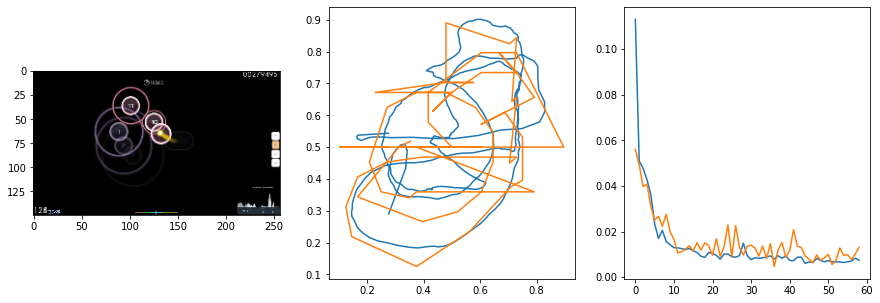

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:18<00:00:00  0.69it/s  0.0036                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

59 of 64
pred: 0.2771299183368683 0.3213585913181305
gt: 0.45842087268829346 0.4722805917263031
(119, 72)


<Figure size 1080x360 with 0 Axes>

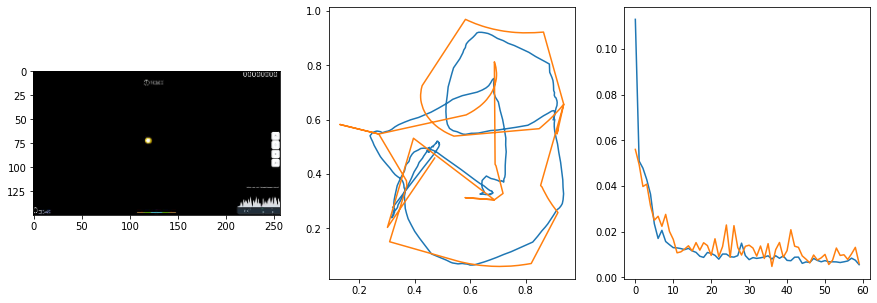

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:18<00:00:00  0.70it/s  0.0039                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

60 of 64
pred: 0.2680445909500122 0.3494075536727905
gt: 0.5789449214935303 0.6134019494056702
(137, 89)


<Figure size 1080x360 with 0 Axes>

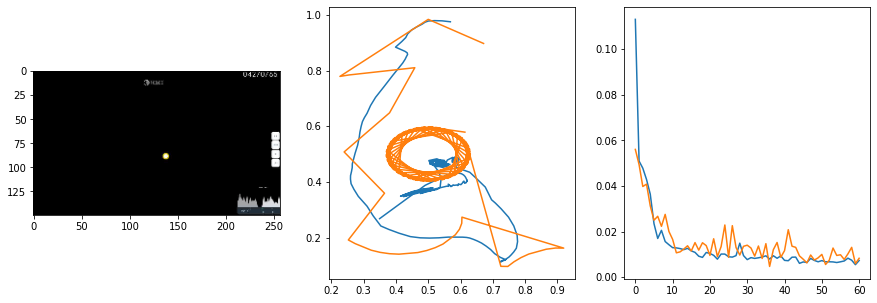

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:18<00:00:00  0.70it/s  0.0061                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

61 of 64
pred: 0.1953681856393814 0.20804576575756073
gt: 0.109375 0.2291666716337204
(64, 44)


<Figure size 1080x360 with 0 Axes>

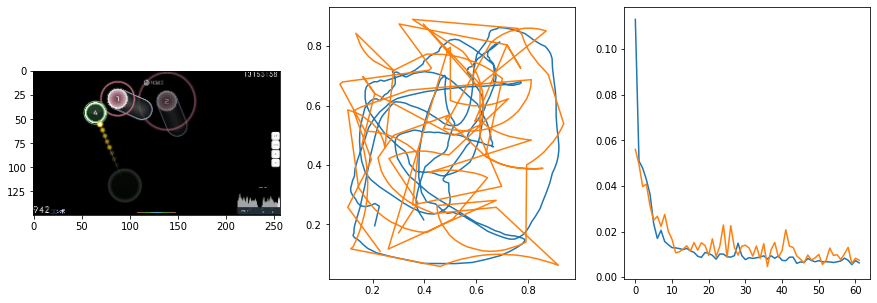

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:18<00:00:00  0.70it/s  0.0059                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

62 of 64
pred: 0.16529580950737 0.43209731578826904
gt: 0.226606085896492 0.7610117793083191
(83, 106)


<Figure size 1080x360 with 0 Axes>

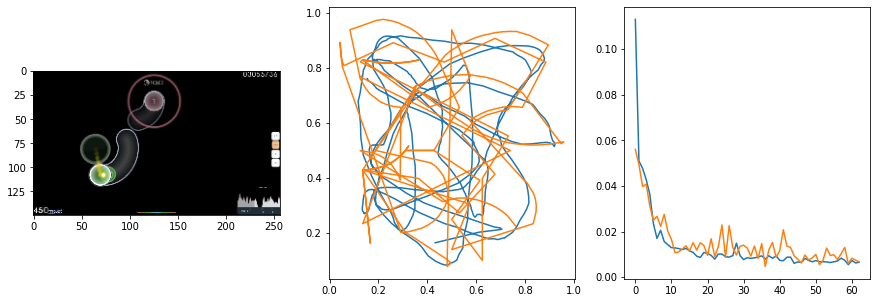

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:18<00:00:00  0.70it/s  0.0054                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

63 of 64
pred: 0.23245814442634583 0.31654852628707886
gt: 0.35499998927116394 0.36916664242744446
(103, 60)


<Figure size 1080x360 with 0 Axes>

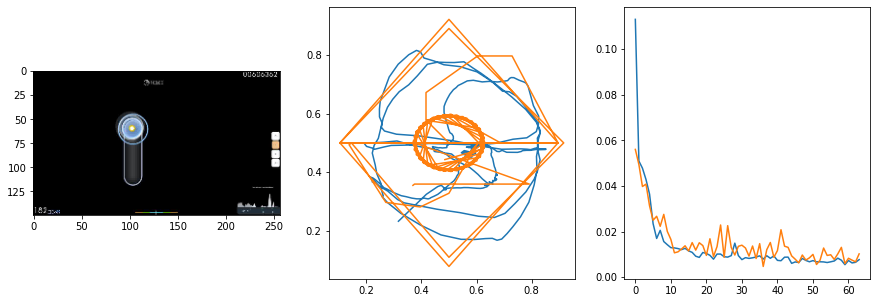

1549.1537792682648 secs


In [ ]:
start = time.time()

epochs = 64
trainVN()

end = time.time()
print(end - start, 'secs')

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.67it/s  0.0041                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

64 of 128
pred: 0.3088185489177704 0.2995181679725647
gt: -0.5151781439781189 -0.4966548979282379
(-31, -39)


<Figure size 1080x360 with 0 Axes>

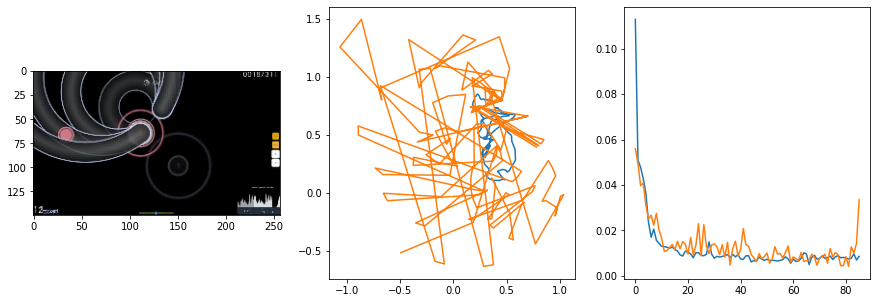

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.70it/s  0.0194                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

65 of 128
pred: 0.2999785840511322 0.29284435510635376
gt: 0.3662327826023102 0.26078128814697266
(104, 48)


<Figure size 1080x360 with 0 Axes>

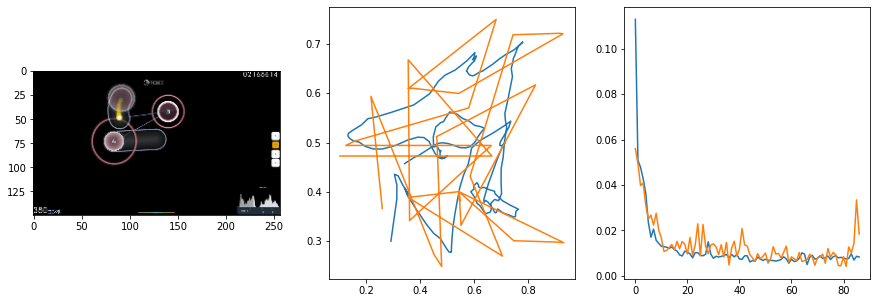

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.73it/s  0.0073                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

66 of 128
pred: 0.29048895835876465 0.33460819721221924
gt: 0.8011220693588257 0.22529220581054688
(172, 44)


<Figure size 1080x360 with 0 Axes>

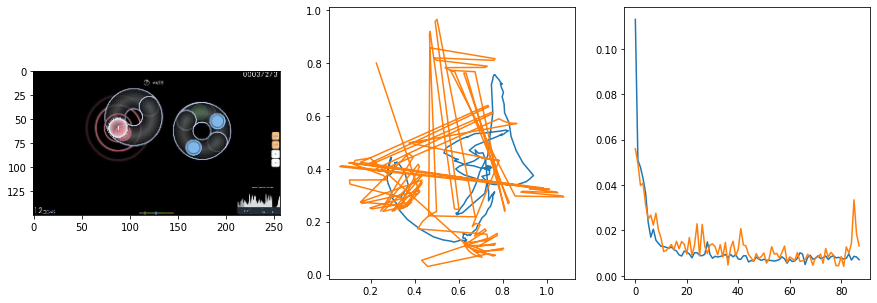

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.74it/s  0.0054                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

67 of 128
pred: 0.39961832761764526 0.38673675060272217
gt: 0.8102021813392639 0.41924893856048584
(173, 66)


<Figure size 1080x360 with 0 Axes>

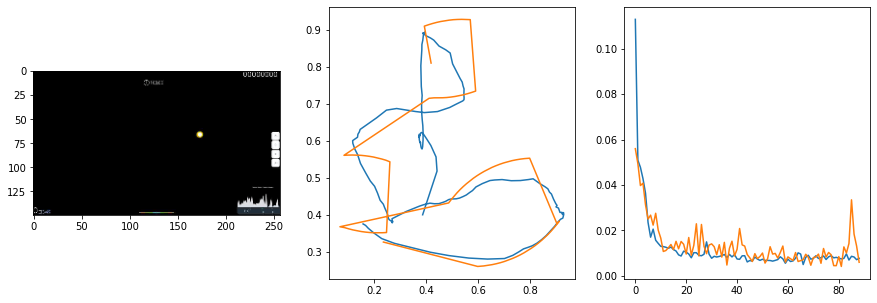

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.74it/s  0.0105                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

68 of 128
pred: 0.4892868995666504 0.482524037361145
gt: 0.5807291865348816 0.7135416865348816
(138, 100)


<Figure size 1080x360 with 0 Axes>

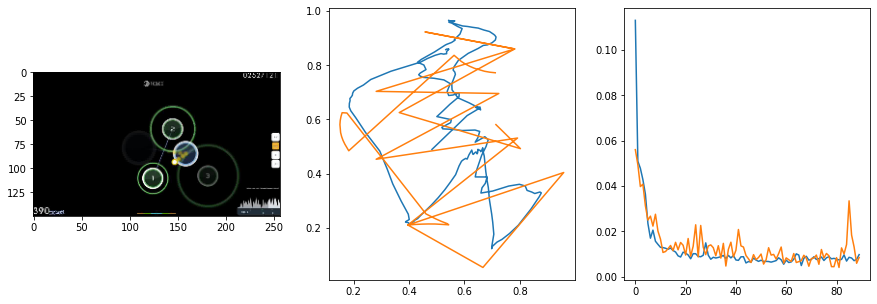

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.72it/s  0.0089                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

69 of 128
pred: 0.3935817778110504 0.41840022802352905
gt: 0.5726581811904907 0.6515035629272461
(136, 93)


<Figure size 1080x360 with 0 Axes>

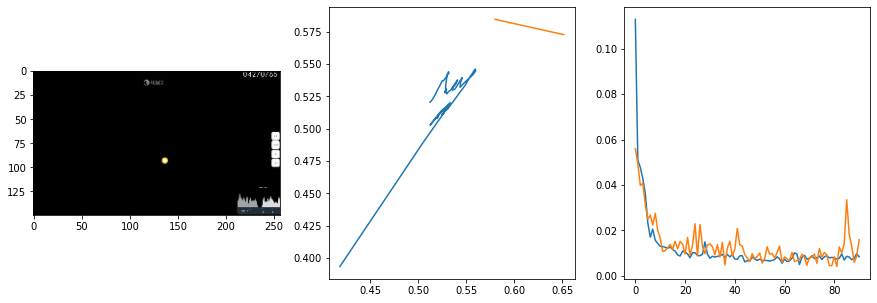

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.67it/s  0.0046                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

70 of 128
pred: 0.5555711984634399 0.3478422164916992
gt: 0.755859375 0.4036458432674408
(165, 64)


<Figure size 1080x360 with 0 Axes>

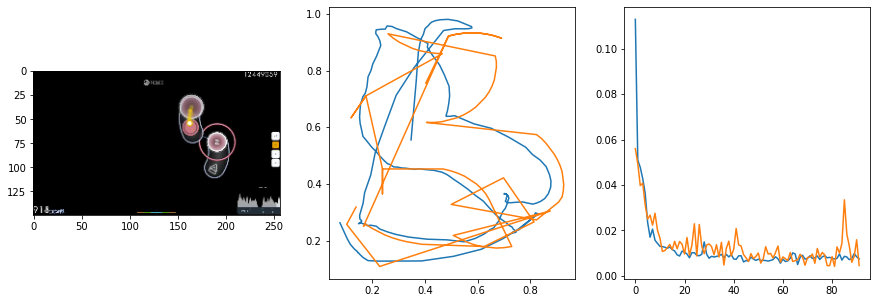

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.66it/s  0.0109                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

71 of 128
pred: 0.400679349899292 0.33791613578796387
gt: 0.37771740555763245 0.39598652720451355
(106, 64)


<Figure size 1080x360 with 0 Axes>

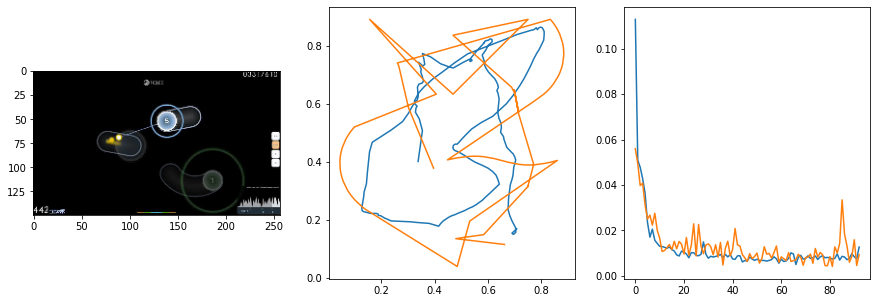

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.71it/s  0.0060                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

72 of 128
pred: 0.33146703243255615 0.2593434453010559
gt: 0.7328763604164124 0.40033718943595886
(161, 64)


<Figure size 1080x360 with 0 Axes>

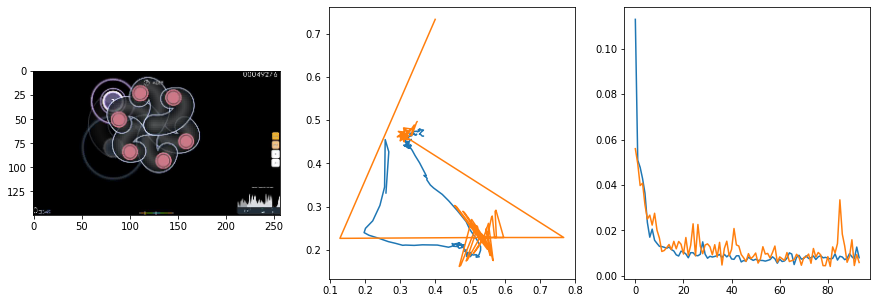

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.71it/s  0.0077                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

73 of 128
pred: 0.5537045001983643 0.33747148513793945
gt: 0.749602735042572 0.3792742192745209
(164, 62)


<Figure size 1080x360 with 0 Axes>

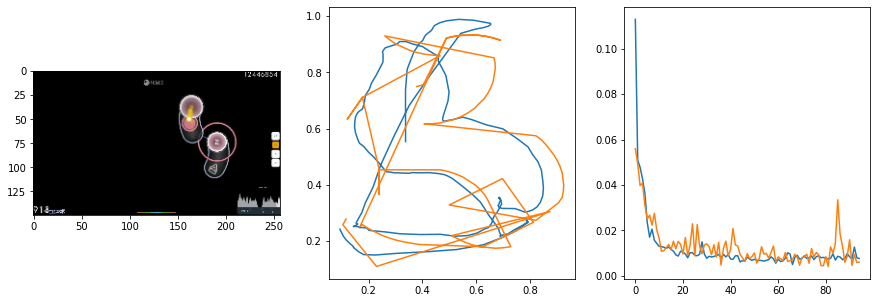

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.73it/s  0.0054                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

74 of 128
pred: 0.29141533374786377 0.6080482006072998
gt: 0.15346534550189972 0.882838249206543
(71, 120)


<Figure size 1080x360 with 0 Axes>

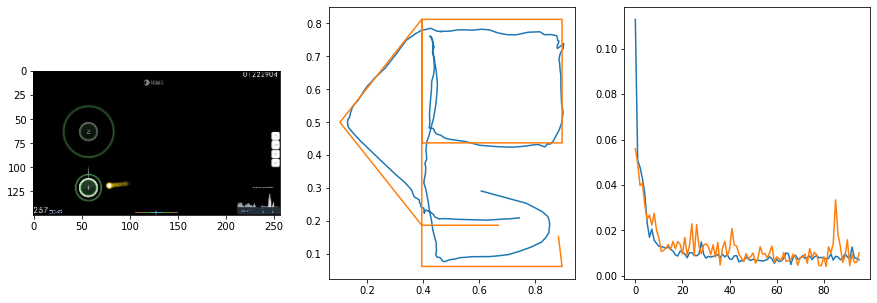

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.65it/s  0.0176                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

75 of 128
pred: 0.6416997909545898 0.5229389071464539
gt: 0.6654974222183228 0.7211415767669678
(151, 101)


<Figure size 1080x360 with 0 Axes>

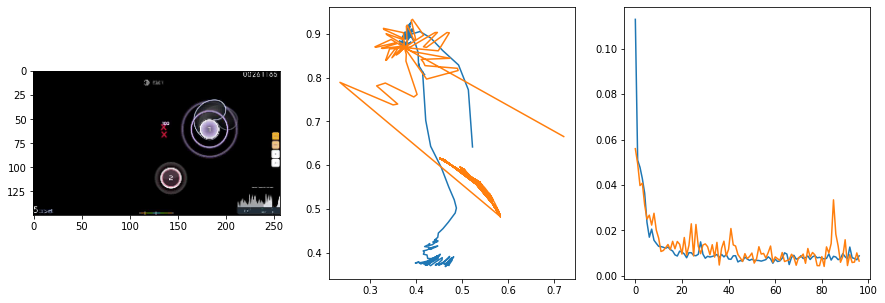

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.70it/s  0.0148                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

76 of 128
pred: 0.2950674295425415 0.5117974877357483
gt: 0.2666778266429901 0.5698282718658447
(89, 84)


<Figure size 1080x360 with 0 Axes>

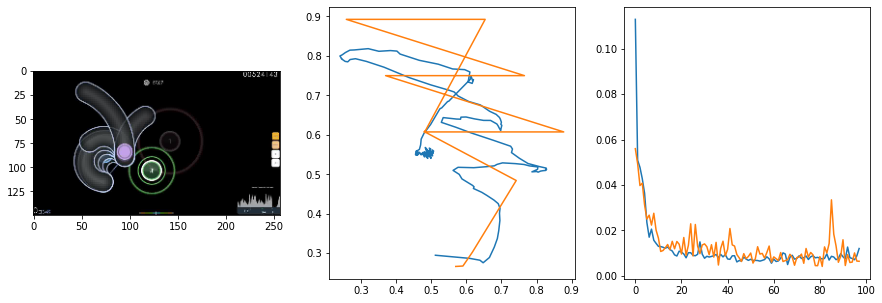

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.64it/s  0.0120                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

77 of 128
pred: 0.37662678956985474 0.3362846076488495
gt: 0.4935624897480011 0.3645833432674408
(124, 60)


<Figure size 1080x360 with 0 Axes>

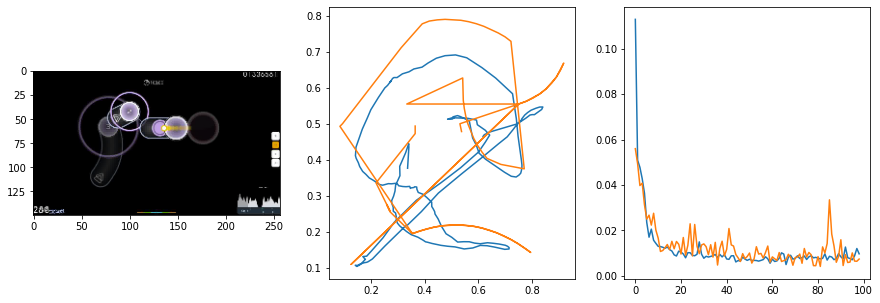

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.66it/s  0.0077                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

78 of 128
pred: 0.553575873374939 0.3341295123100281
gt: 0.87890625 0.2786458432674408
(184, 50)


<Figure size 1080x360 with 0 Axes>

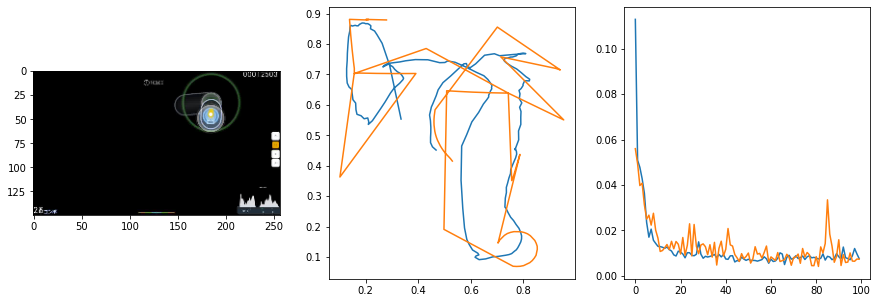

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.70it/s  0.0042                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

79 of 128
pred: 0.5668043494224548 0.5495009422302246
gt: 0.7947472333908081 0.6768504977226257
(171, 96)


<Figure size 1080x360 with 0 Axes>

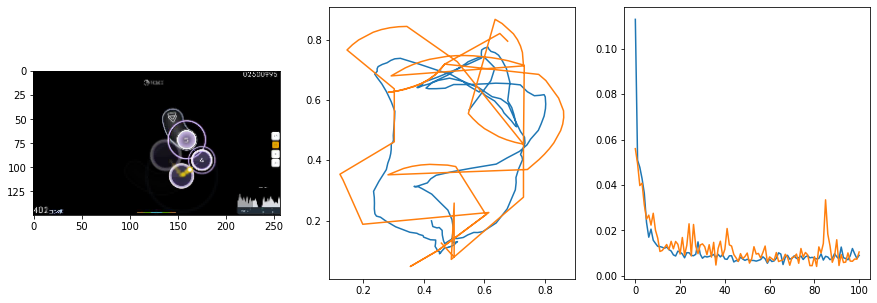

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.73it/s  0.0079                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

80 of 128
pred: 0.4704394042491913 0.4156833291053772
gt: 0.7937101125717163 0.5663608908653259
(171, 83)


<Figure size 1080x360 with 0 Axes>

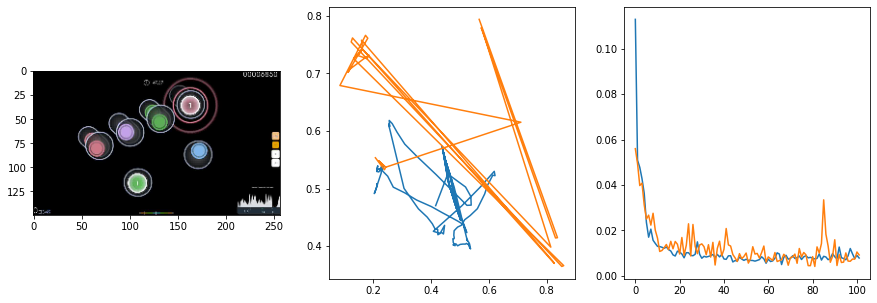

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.72it/s  0.0112                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

81 of 128
pred: 0.4215642511844635 0.40035390853881836
gt: 0.46875 0.41726765036582947
(120, 66)


<Figure size 1080x360 with 0 Axes>

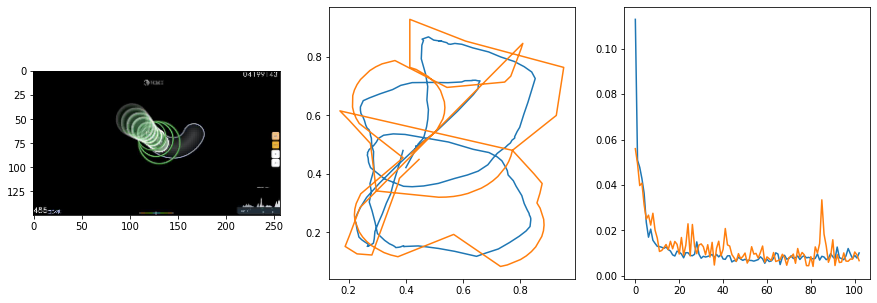

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.71it/s  0.0084                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

82 of 128
pred: 0.4847647547721863 0.630481481552124
gt: 0.691804826259613 0.8107993006706238
(155, 112)


<Figure size 1080x360 with 0 Axes>

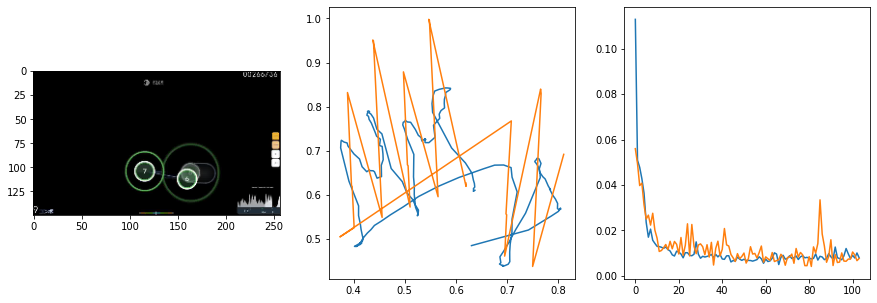

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.72it/s  0.0052                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

83 of 128
pred: 0.5337754487991333 0.4620088040828705
gt: 0.7612393498420715 1.2460300922393799
(166, 162)


<Figure size 1080x360 with 0 Axes>

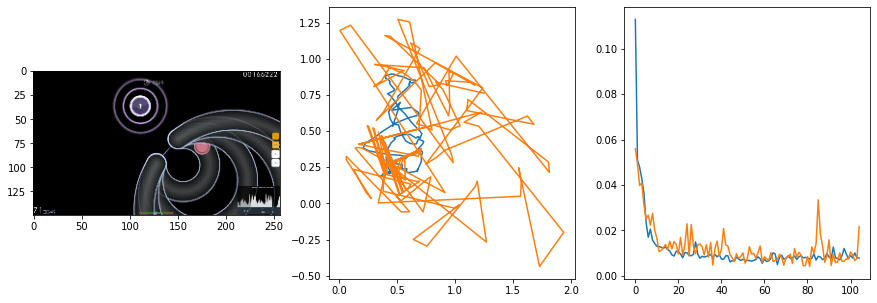

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.73it/s  0.0143                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

84 of 128
pred: 0.37253767251968384 0.4096629321575165
gt: 0.441101610660553 0.33178040385246277
(116, 56)


<Figure size 1080x360 with 0 Axes>

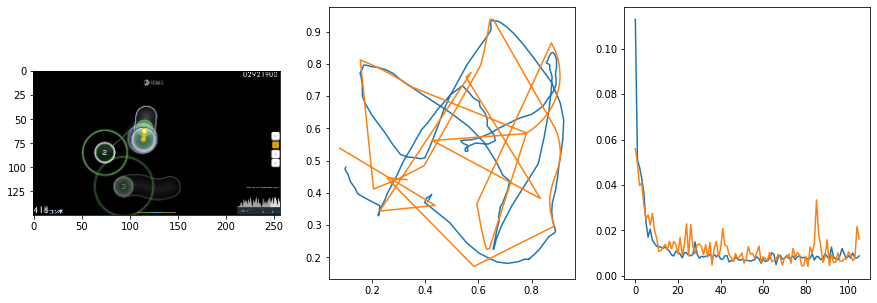

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.75it/s  0.0081                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

85 of 128
pred: 0.604136049747467 0.5170837044715881
gt: 0.899756133556366 0.7642216086387634
(187, 106)


<Figure size 1080x360 with 0 Axes>

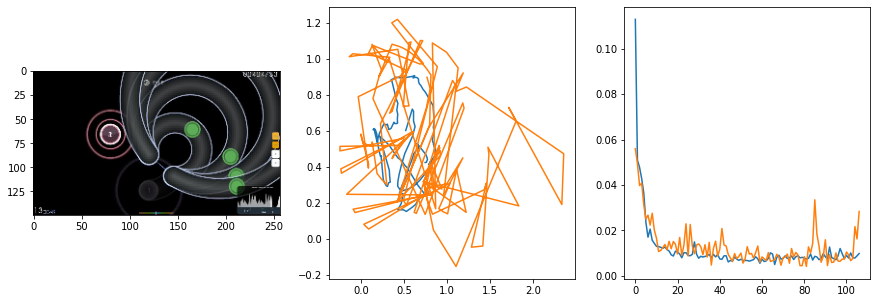

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.74it/s  0.0037                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

86 of 128
pred: 0.5299389958381653 0.4445250630378723
gt: 0.6293332576751709 0.3107118606567383
(145, 54)


<Figure size 1080x360 with 0 Axes>

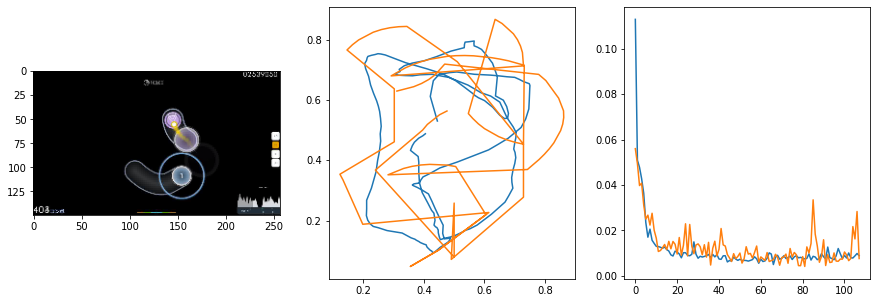

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.75it/s  0.0050                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

87 of 128
pred: 0.34577545523643494 0.5745339393615723
gt: 0.3272031843662262 0.75
(98, 105)


<Figure size 1080x360 with 0 Axes>

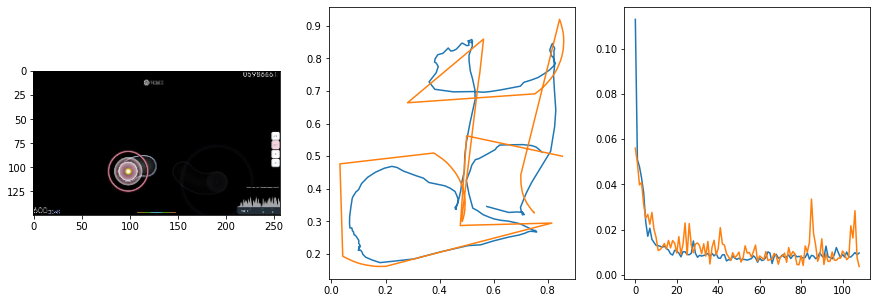

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.76it/s  0.0039                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

88 of 128
pred: 0.3325642943382263 0.3462279438972473
gt: 0.6061691045761108 0.17500048875808716
(142, 38)


<Figure size 1080x360 with 0 Axes>

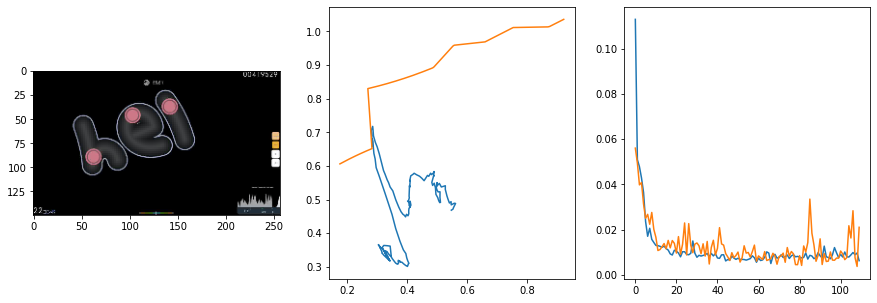

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.74it/s  0.0066                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

89 of 128
pred: 0.21998485922813416 0.29827621579170227
gt: 0.16085714101791382 0.23530952632427216
(72, 45)


<Figure size 1080x360 with 0 Axes>

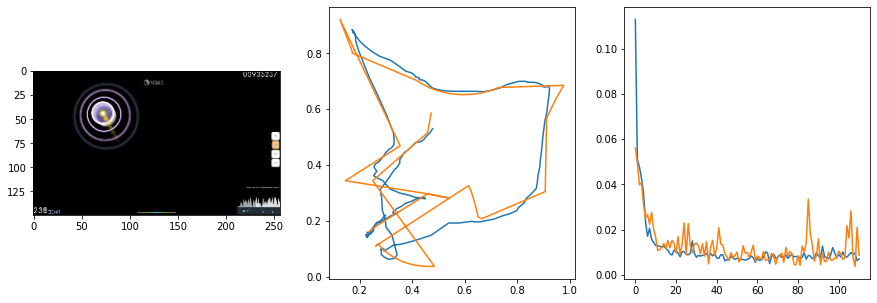

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.77it/s  0.0047                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

90 of 128
pred: 0.4687812030315399 0.5393009781837463
gt: 0.4329525828361511 0.663520097732544
(115, 95)


<Figure size 1080x360 with 0 Axes>

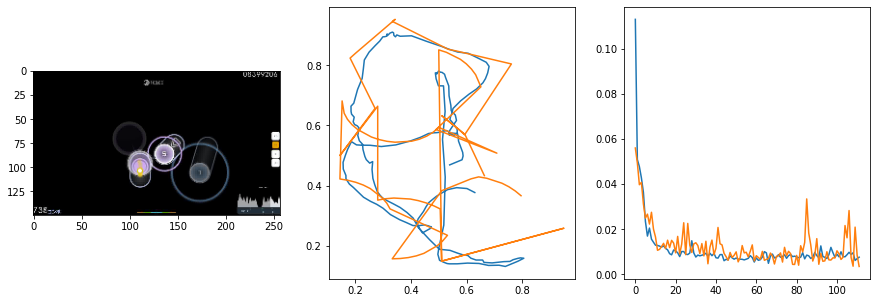

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.75it/s  0.0142                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

91 of 128
pred: 0.5223985314369202 0.33810824155807495
gt: 0.699999988079071 0.24583333730697632
(156, 46)


<Figure size 1080x360 with 0 Axes>

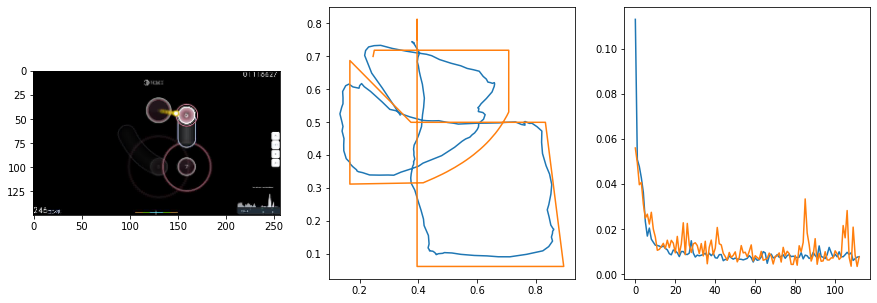

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.74it/s  0.0059                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

92 of 128
pred: 0.7548606991767883 0.6518042087554932
gt: 0.925218403339386 0.7223991751670837
(191, 102)


<Figure size 1080x360 with 0 Axes>

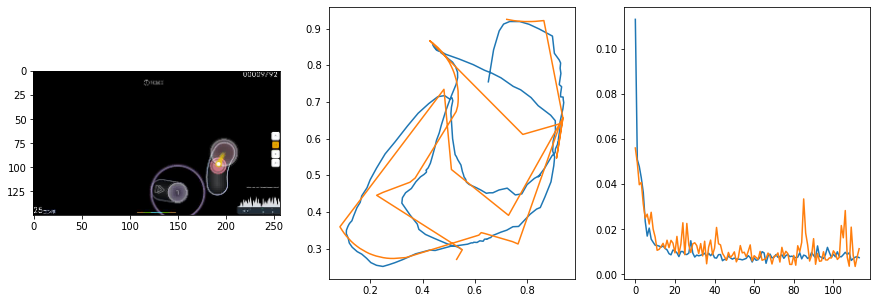

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.66it/s  0.0047                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

93 of 128
pred: 0.5490288734436035 0.45296597480773926
gt: 0.61998051404953 0.3969794809818268
(144, 64)


<Figure size 1080x360 with 0 Axes>

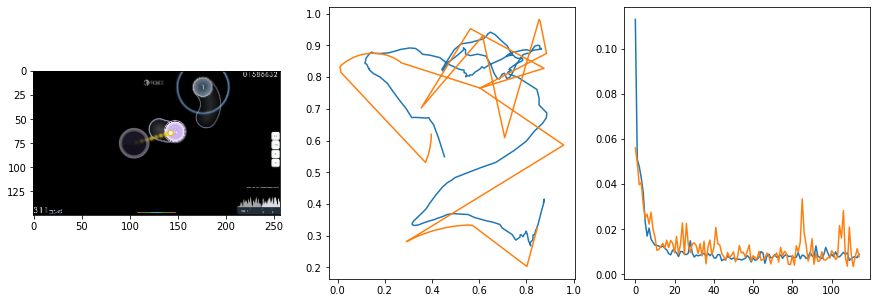

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.71it/s  0.0127                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

94 of 128
pred: 0.3214337229728699 0.6540124416351318
gt: 0.27027904987335205 0.7949067950248718
(89, 110)


<Figure size 1080x360 with 0 Axes>

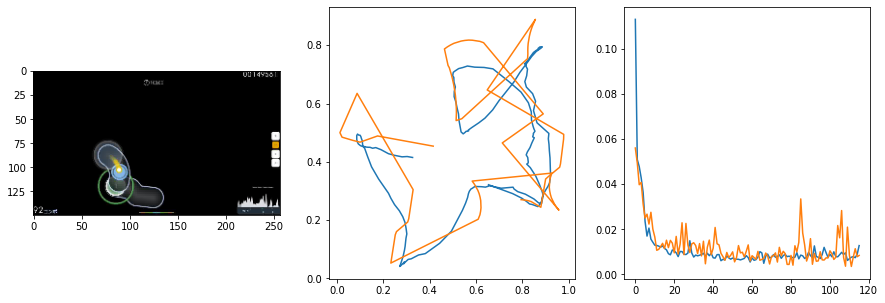

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.67it/s  0.0135                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

95 of 128
pred: 0.3544684648513794 0.4187653660774231
gt: 0.40236714482307434 0.4296407401561737
(110, 67)


<Figure size 1080x360 with 0 Axes>

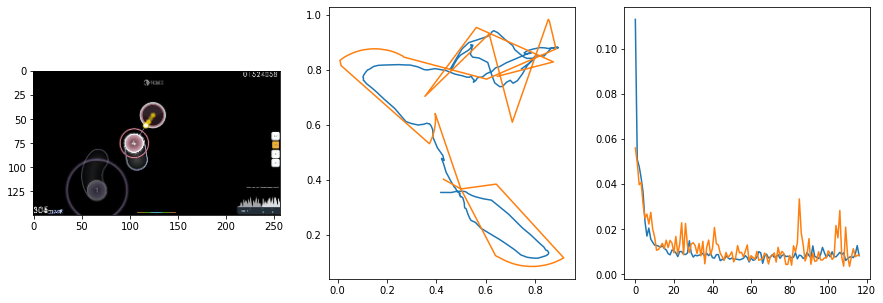

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.71it/s  0.0162                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

96 of 128
pred: 0.6455230712890625 0.7878626585006714
gt: 0.5350638031959534 0.9462161660194397
(130, 128)


<Figure size 1080x360 with 0 Axes>

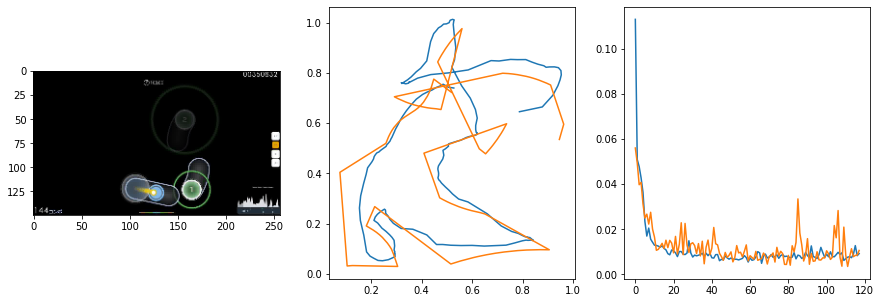

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.71it/s  0.0070                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

97 of 128
pred: 0.4523168206214905 0.4926234483718872
gt: 0.6939338445663452 0.5
(155, 76)


<Figure size 1080x360 with 0 Axes>

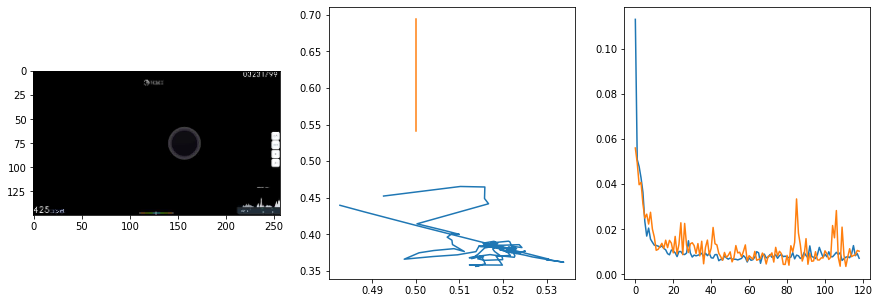

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.71it/s  0.0066                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

98 of 128
pred: 0.4691118597984314 0.46814846992492676
gt: 0.4636884331703186 0.6208724975585938
(119, 90)


<Figure size 1080x360 with 0 Axes>

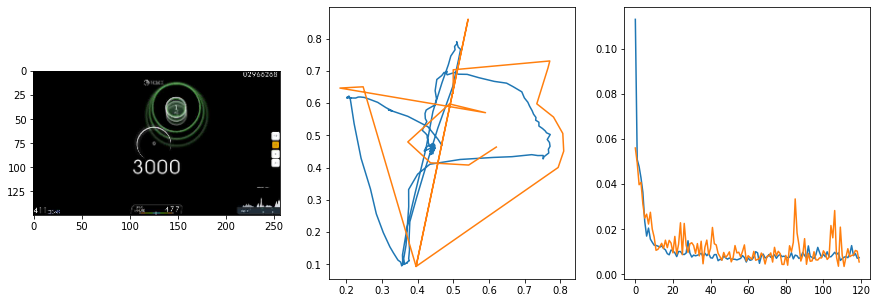

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.70it/s  0.0185                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

99 of 128
pred: 0.40026605129241943 0.3779125213623047
gt: 0.48750001192092896 0.3375000059604645
(123, 57)


<Figure size 1080x360 with 0 Axes>

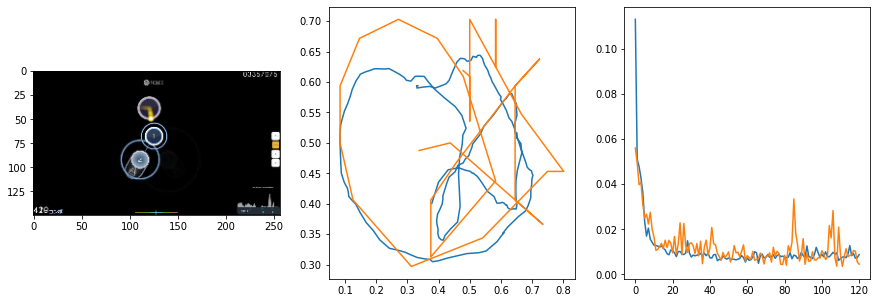

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.71it/s  0.0089                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

100 of 128
pred: 0.34905052185058594 0.4935001730918884
gt: 0.32976973056793213 0.5087719559669495
(99, 77)


<Figure size 1080x360 with 0 Axes>

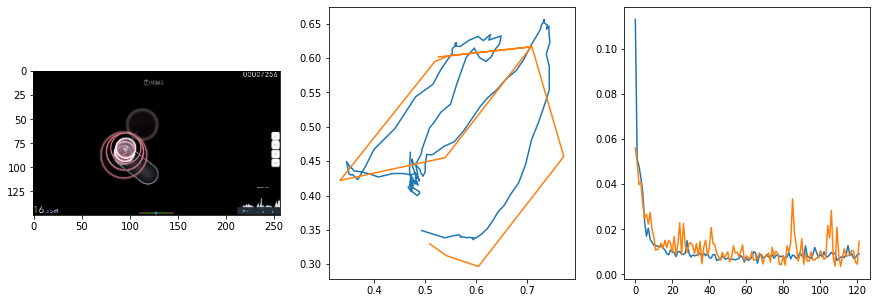

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.67it/s  0.0077                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

101 of 128
pred: 0.6053230166435242 0.46250492334365845
gt: 0.623046875 0.375
(144, 61)


<Figure size 1080x360 with 0 Axes>

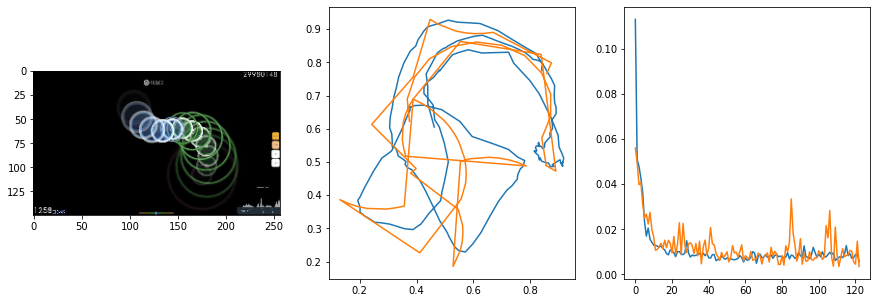

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.72it/s  0.0033                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

102 of 128
pred: 0.38877370953559875 0.328022837638855
gt: 0.4060329794883728 0.39265045523643494
(110, 63)


<Figure size 1080x360 with 0 Axes>

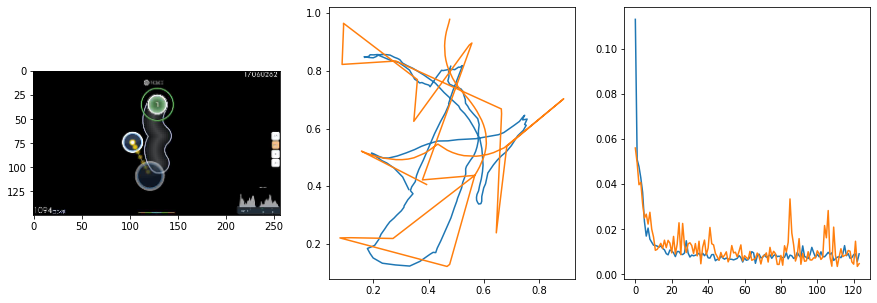

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.71it/s  0.0066                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

103 of 128
pred: 0.688096284866333 0.6913229823112488
gt: 0.6439828872680664 0.8571816086769104
(147, 117)


<Figure size 1080x360 with 0 Axes>

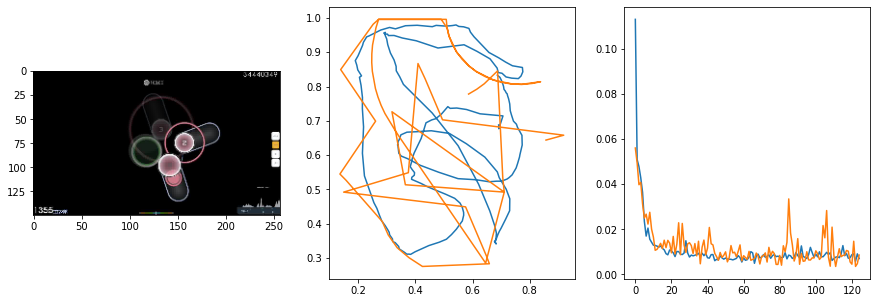

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.69it/s  0.0033                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

104 of 128
pred: 0.34049317240715027 0.5802761912345886
gt: 0.2578125 0.7265625
(87, 102)


<Figure size 1080x360 with 0 Axes>

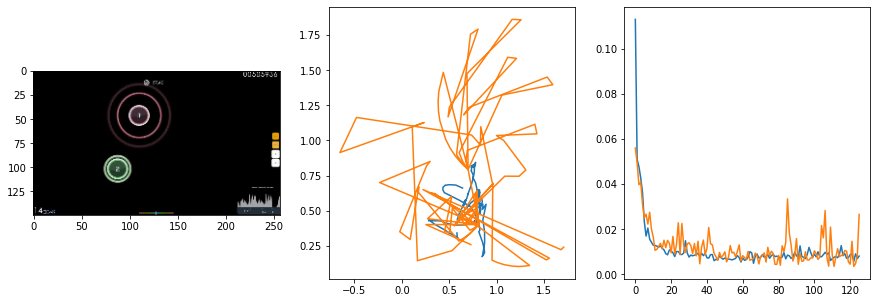

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.68it/s  0.0036                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

105 of 128
pred: 0.5886253118515015 0.5331018567085266
gt: 0.529739260673523 0.5871595740318298
(130, 86)


<Figure size 1080x360 with 0 Axes>

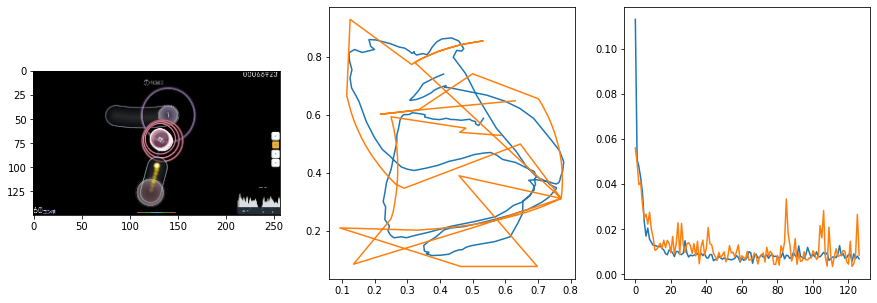

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.68it/s  0.0092                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

106 of 128
pred: 0.577949047088623 0.5575728416442871
gt: 0.5625 0.5989583134651184
(135, 87)


<Figure size 1080x360 with 0 Axes>

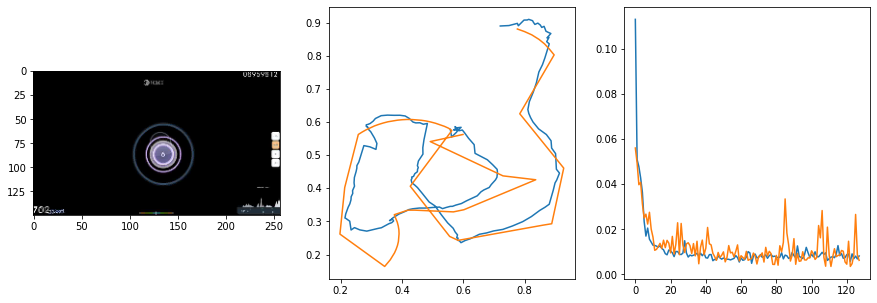

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.69it/s  0.0080                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

107 of 128
pred: 0.7130699753761292 0.5338837504386902
gt: 0.8803048133850098 0.5918056964874268
(184, 86)


<Figure size 1080x360 with 0 Axes>

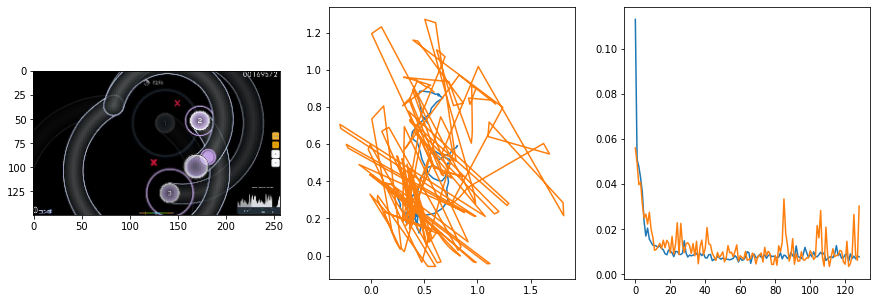

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.68it/s  0.0054                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

108 of 128
pred: 0.6841344833374023 0.4118776321411133
gt: 0.8828125 0.1458333283662796
(184, 34)


<Figure size 1080x360 with 0 Axes>

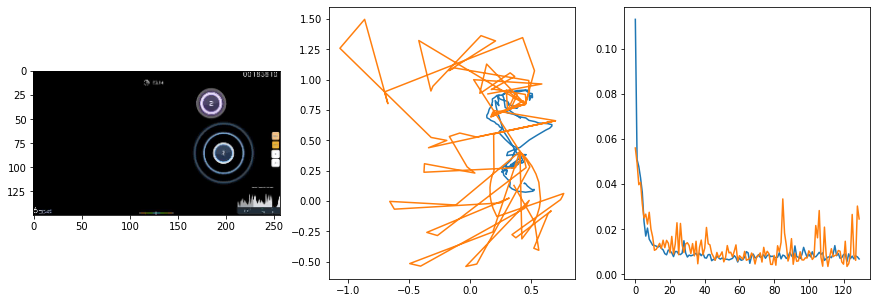

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.69it/s  0.0086                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

109 of 128
pred: 0.4833008646965027 0.5302743911743164
gt: 0.5783362984657288 0.68875652551651
(137, 98)


<Figure size 1080x360 with 0 Axes>

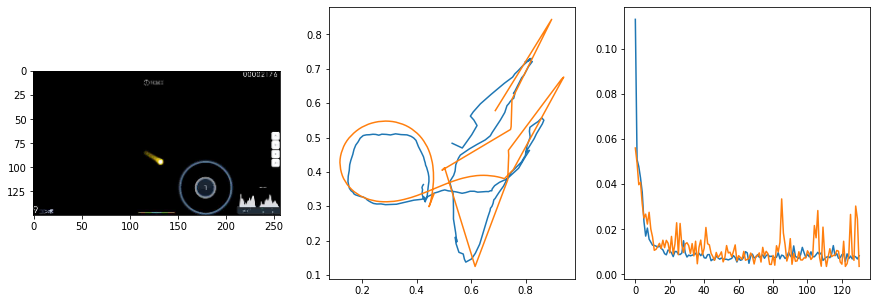

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.70it/s  0.0424                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

110 of 128
pred: 0.3288938105106354 0.6527484059333801
gt: 0.2527613043785095 0.8497664928436279
(87, 116)


<Figure size 1080x360 with 0 Axes>

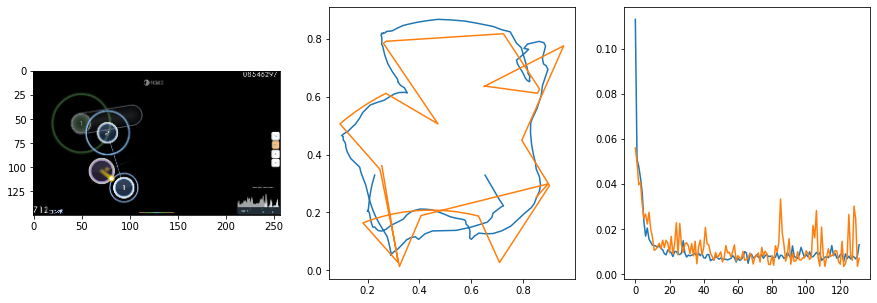

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.78it/s  0.0142                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

111 of 128
pred: 0.3542901873588562 0.39603471755981445
gt: 0.4139769375324249 0.7298269867897034
(112, 102)


<Figure size 1080x360 with 0 Axes>

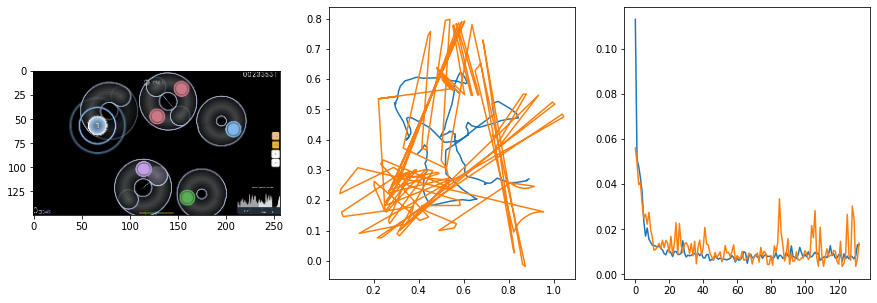

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.76it/s  0.0040                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

112 of 128
pred: 0.3701316714286804 0.30147022008895874
gt: 0.4859693944454193 0.2708333432674408
(123, 49)


<Figure size 1080x360 with 0 Axes>

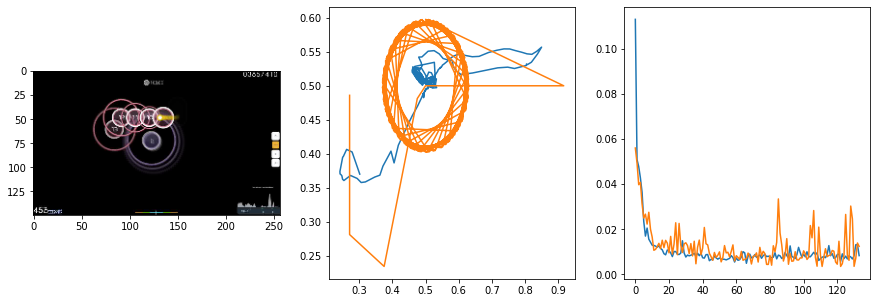

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.70it/s  0.0102                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

113 of 128
pred: 0.5210919976234436 0.45265835523605347
gt: 0.7252683639526367 0.35985442996025085
(160, 59)


<Figure size 1080x360 with 0 Axes>

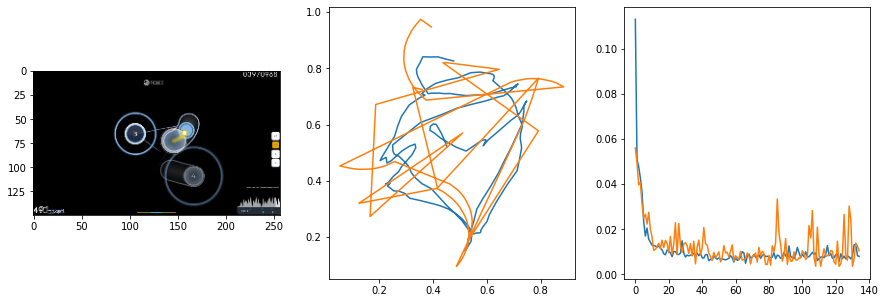

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.67it/s  0.0033                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

114 of 128
pred: 0.570686936378479 0.3073195219039917
gt: 0.7708724737167358 0.13199667632579803
(167, 33)


<Figure size 1080x360 with 0 Axes>

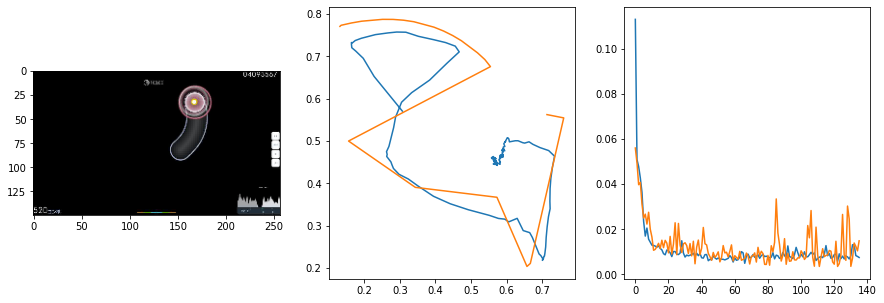

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.77it/s  0.0161                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

115 of 128
pred: 0.389772891998291 0.2967548370361328
gt: 0.41796875 0.1901041716337204
(112, 40)


<Figure size 1080x360 with 0 Axes>

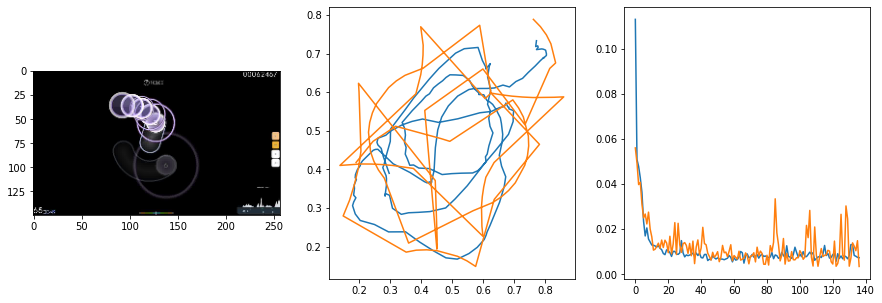

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.77it/s  0.0042                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

116 of 128
pred: 0.6605386734008789 0.371565580368042
gt: 0.9453125 0.1041666641831398
(194, 30)


<Figure size 1080x360 with 0 Axes>

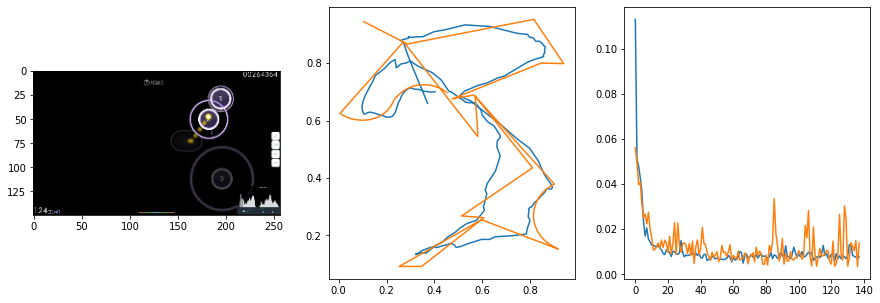

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.76it/s  0.0053                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

117 of 128
pred: 0.4273012578487396 0.418795108795166
gt: 0.30515390634536743 0.2545303702354431
(95, 47)


<Figure size 1080x360 with 0 Axes>

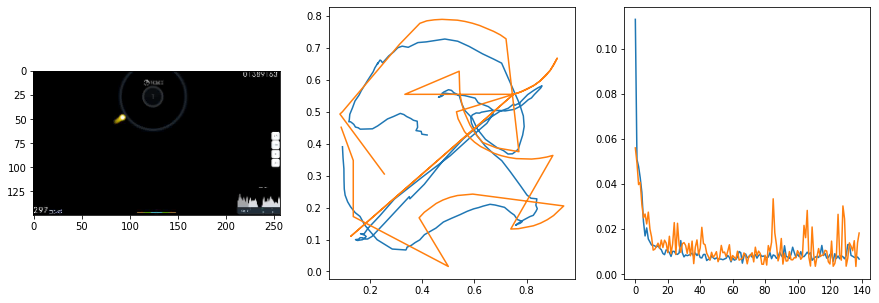

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.75it/s  0.0085                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

118 of 128
pred: 0.5334835648536682 0.4461708664894104
gt: 0.583078920841217 0.39462611079216003
(138, 63)


<Figure size 1080x360 with 0 Axes>

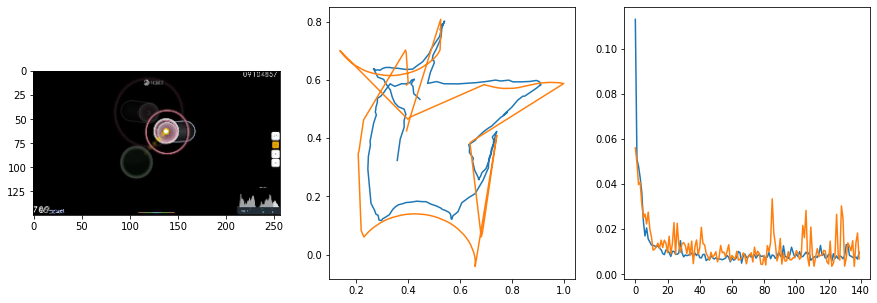

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.75it/s  0.0073                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

119 of 128
pred: 0.6186971068382263 0.5174803137779236
gt: 0.709148645401001 0.4495229721069336
(157, 70)


<Figure size 1080x360 with 0 Axes>

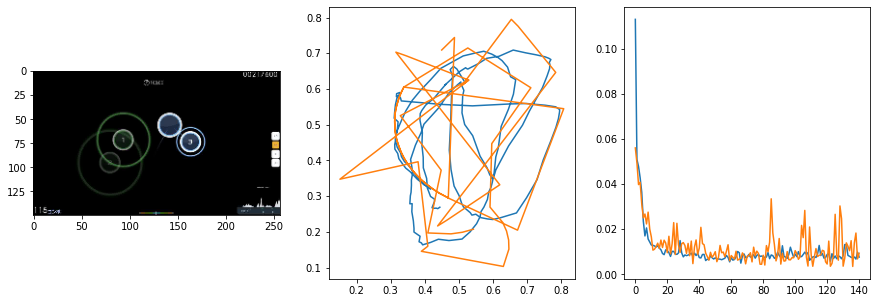

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.74it/s  0.0043                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

120 of 128
pred: 0.41746872663497925 0.46294450759887695
gt: 0.5672925710678101 0.48248258233070374
(135, 74)


<Figure size 1080x360 with 0 Axes>

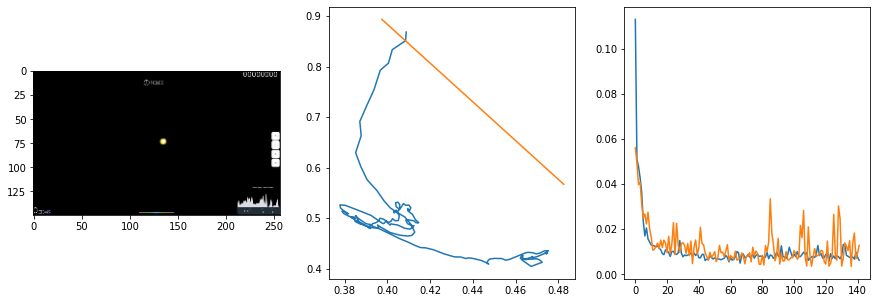

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.69it/s  0.0037                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

121 of 128
pred: 0.516802966594696 0.4290008544921875
gt: 0.6402449607849121 0.37576690316200256
(147, 61)


<Figure size 1080x360 with 0 Axes>

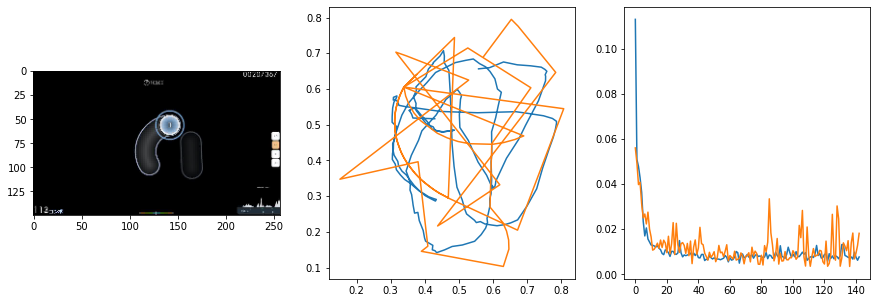

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.76it/s  0.0074                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

122 of 128
pred: 0.28041526675224304 0.5623731017112732
gt: 0.2078993022441864 0.6189236044883728
(80, 89)


<Figure size 1080x360 with 0 Axes>

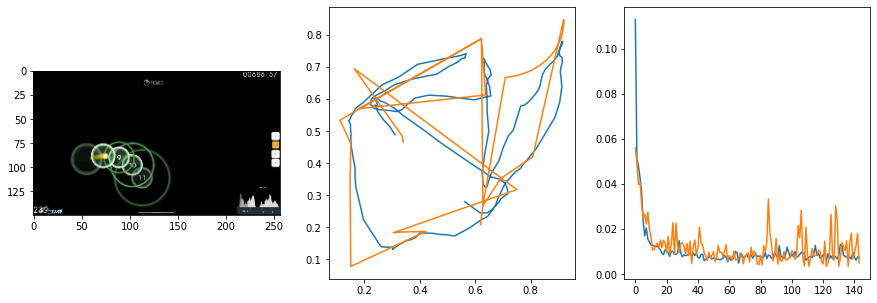

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.74it/s  0.0044                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

123 of 128
pred: 0.3101905882358551 0.5021792054176331
gt: 0.23904050886631012 0.8469637036323547
(85, 116)


<Figure size 1080x360 with 0 Axes>

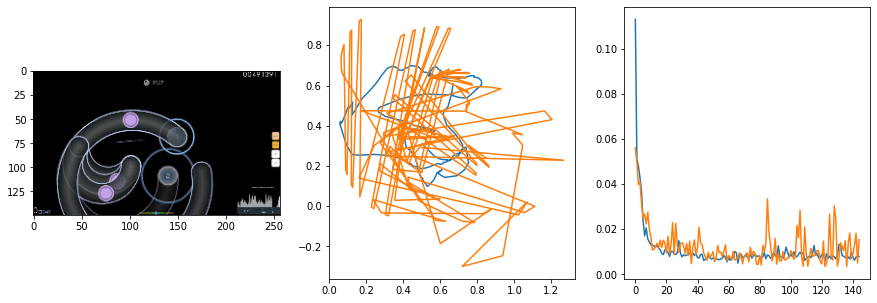

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.74it/s  0.0027                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

124 of 128
pred: 0.227397620677948 0.438423752784729
gt: 0.1013760194182396 0.49204471707344055
(63, 75)


<Figure size 1080x360 with 0 Axes>

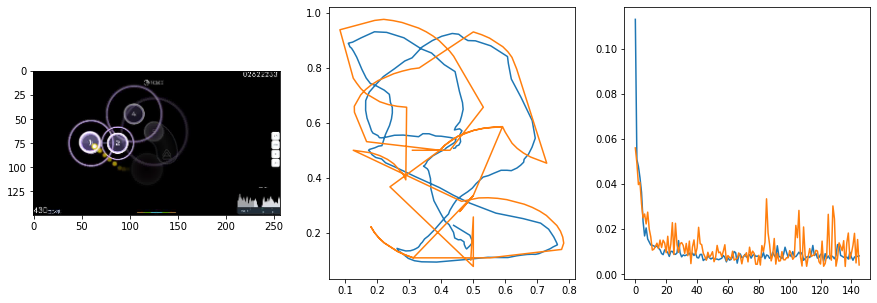

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.75it/s  0.0093                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

125 of 128
pred: 0.7146873474121094 0.7290093898773193
gt: 0.5950294733047485 0.6257792711257935
(140, 90)


<Figure size 1080x360 with 0 Axes>

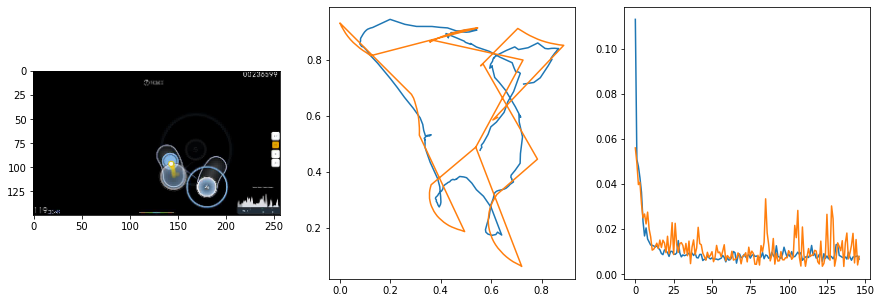

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.73it/s  0.0081                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

126 of 128
pred: 0.5450035333633423 0.5372530817985535
gt: 0.5131739974021912 0.5
(127, 76)


<Figure size 1080x360 with 0 Axes>

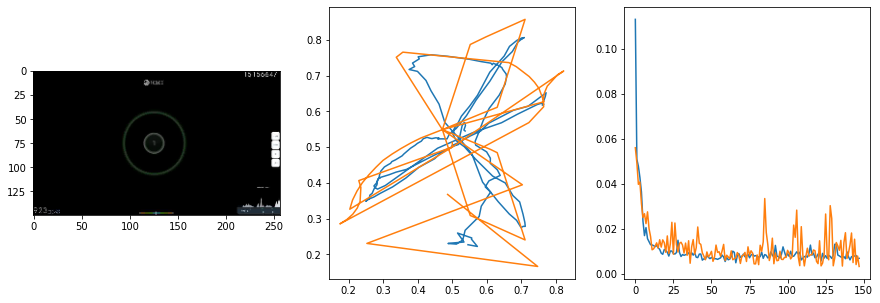

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.75it/s  0.0060                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

127 of 128
pred: 0.7318520545959473 0.8144773244857788
gt: 0.6068160533905029 0.7892434597015381
(142, 109)


<Figure size 1080x360 with 0 Axes>

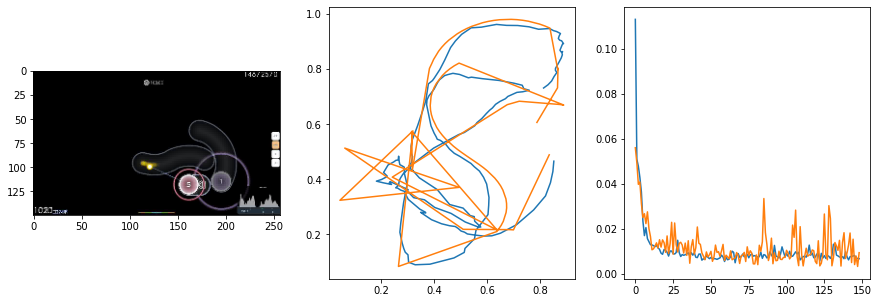

647.3966066837311 secs


In [ ]:
start = time.time()

lamb = 1
epochs = 64
trainVN()

end = time.time()
print(end - start, 'secs')

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.73it/s  0.0116                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

0 of 64
pred: 0.7858656644821167 0.5746828317642212
gt: 0.875 0.23866666853427887
(183, 45)


<Figure size 1080x360 with 0 Axes>

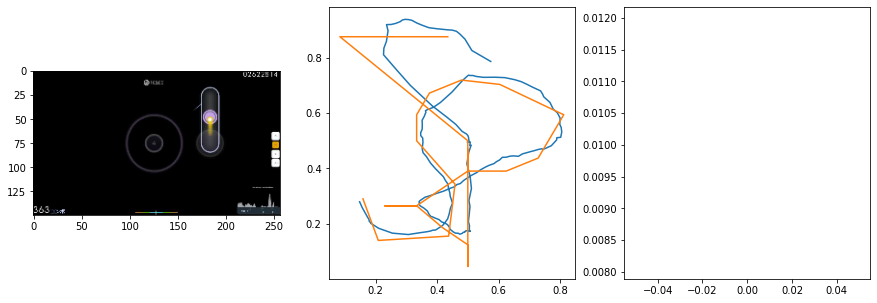

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.71it/s  0.0130                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

1 of 64
pred: 0.418514609336853 0.3419286012649536
gt: 0.515625 0.32600000500679016
(127, 55)


<Figure size 1080x360 with 0 Axes>

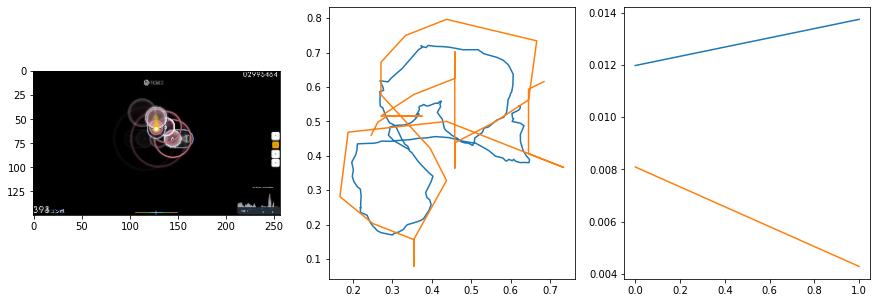

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.73it/s  0.0161                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

2 of 64
pred: 0.6792581081390381 0.6397849917411804
gt: 0.5053117871284485 0.576932430267334
(126, 85)


<Figure size 1080x360 with 0 Axes>

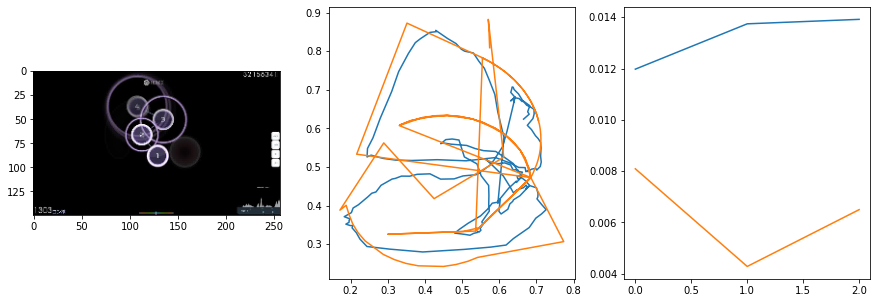

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.74it/s  0.0097                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

3 of 64
pred: 0.25537171959877014 0.4659011960029602
gt: 0.33282068371772766 0.7133352756500244
(99, 100)


<Figure size 1080x360 with 0 Axes>

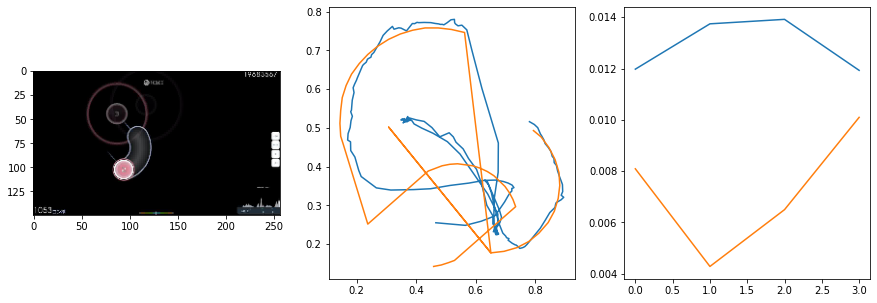

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.76it/s  0.0049                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

4 of 64
pred: 0.45496368408203125 0.45685914158821106
gt: 0.66015625 0.4609375
(150, 71)


<Figure size 1080x360 with 0 Axes>

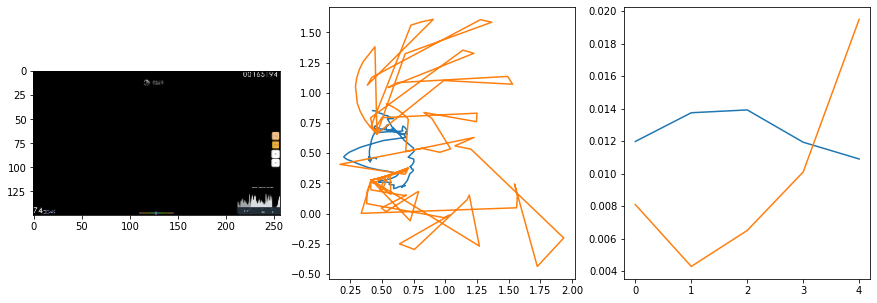

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.70it/s  0.0139                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

5 of 64
pred: 0.6553051471710205 0.7395967245101929
gt: 0.5528242588043213 0.6107361912727356
(133, 89)


<Figure size 1080x360 with 0 Axes>

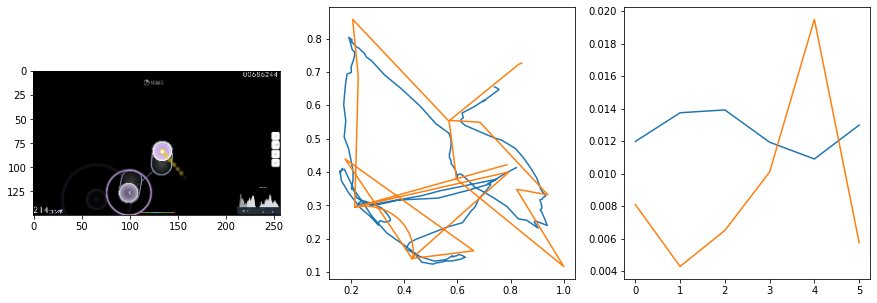

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.80it/s  0.0041                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

6 of 64
pred: 0.4409373104572296 0.44009333848953247
gt: 0.7005208134651184 0.7291666865348816
(156, 102)


<Figure size 1080x360 with 0 Axes>

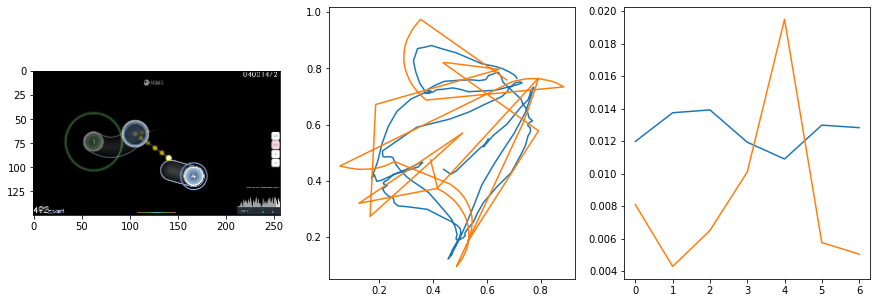

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.78it/s  0.0040                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

7 of 64
pred: 0.6524638533592224 0.5628281831741333
gt: 0.5150168538093567 0.8340818285942078
(127, 115)


<Figure size 1080x360 with 0 Axes>

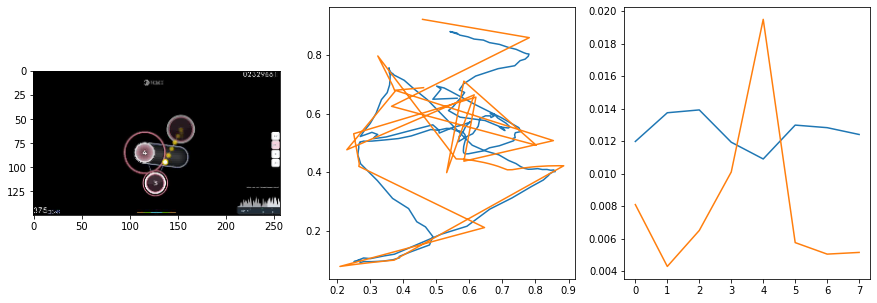

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.76it/s  0.0100                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

8 of 64
pred: 0.6936568021774292 0.29471147060394287
gt: 0.8076030611991882 0.4280634820461273
(173, 67)


<Figure size 1080x360 with 0 Axes>

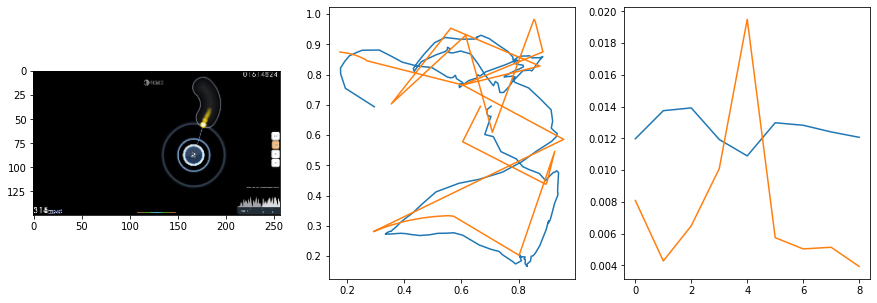

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.73it/s  0.0107                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

9 of 64
pred: 0.6179993152618408 0.5101401805877686
gt: 0.6096088886260986 0.303143709897995
(142, 53)


<Figure size 1080x360 with 0 Axes>

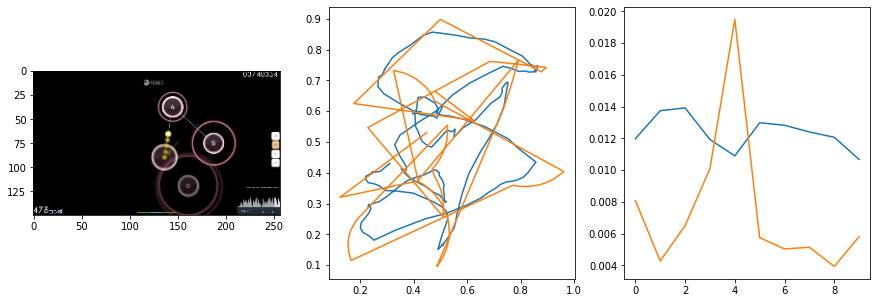

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.75it/s  0.0232                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

10 of 64
pred: 0.5101990103721619 0.2972411513328552
gt: 0.793628454208374 0.20967429876327515
(171, 42)


<Figure size 1080x360 with 0 Axes>

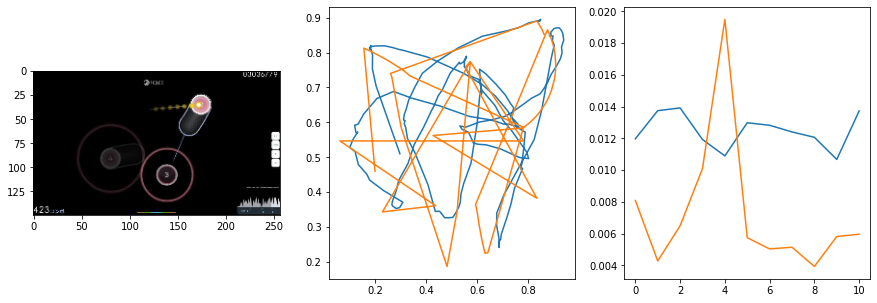

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.70it/s  0.0101                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

11 of 64
pred: 0.25520825386047363 0.25382256507873535
gt: 0.14778228104114532 0.2896956503391266
(70, 51)


<Figure size 1080x360 with 0 Axes>

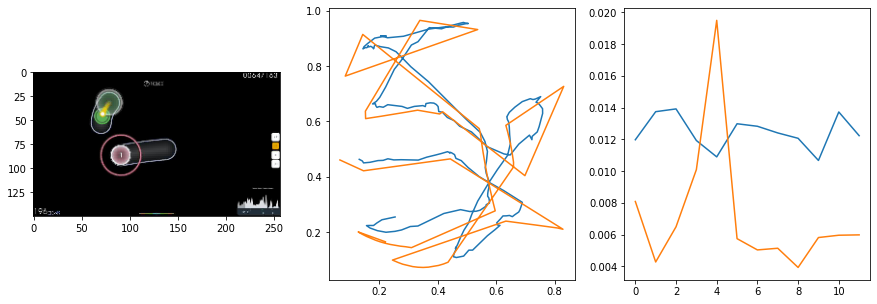

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.74it/s  0.0107                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

12 of 64
pred: 0.7264918684959412 0.5825929641723633
gt: 0.6219785213470459 0.4948361814022064
(144, 75)


<Figure size 1080x360 with 0 Axes>

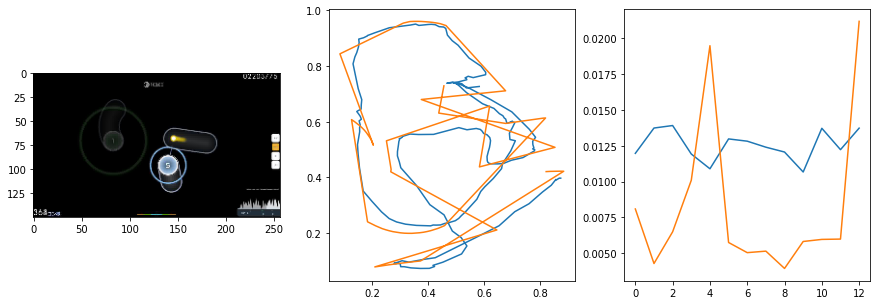

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.74it/s  0.0185                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

13 of 64
pred: 0.44640499353408813 0.5090669989585876
gt: 0.8068886399269104 0.6276074051856995
(173, 90)


<Figure size 1080x360 with 0 Axes>

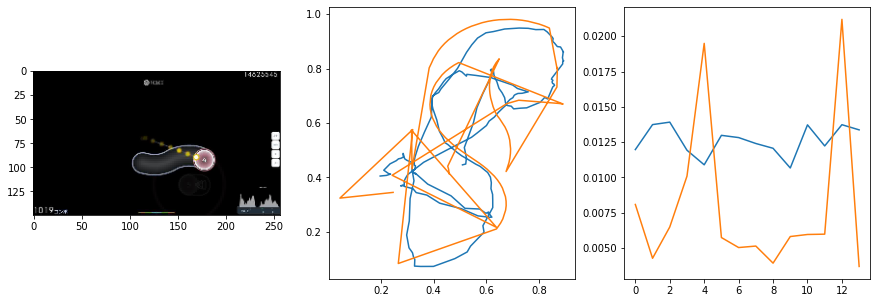

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.73it/s  0.0082                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

14 of 64
pred: 0.29341819882392883 0.6147027611732483
gt: 0.21227961778640747 0.46913233399391174
(80, 72)


<Figure size 1080x360 with 0 Axes>

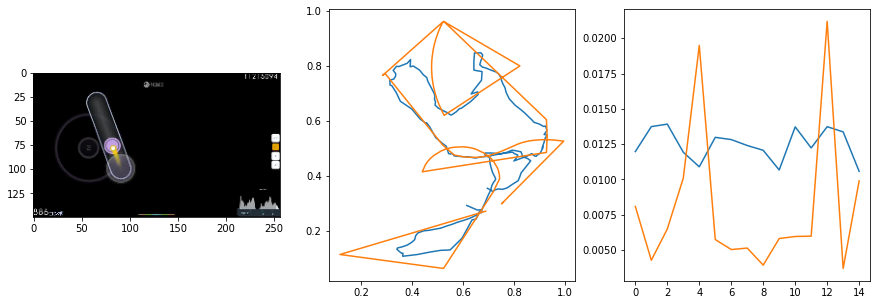

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.80it/s  0.0201                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

15 of 64
pred: 0.7008026242256165 0.4300870895385742
gt: 0.760732889175415 0.3631947338581085
(165, 60)


<Figure size 1080x360 with 0 Axes>

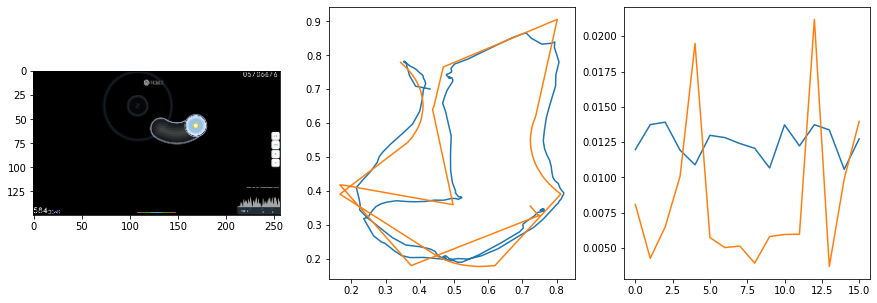

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.74it/s  0.0061                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

16 of 64
pred: 0.4534875750541687 0.5654898881912231
gt: 0.42753350734710693 0.4516890048980713
(114, 70)


<Figure size 1080x360 with 0 Axes>

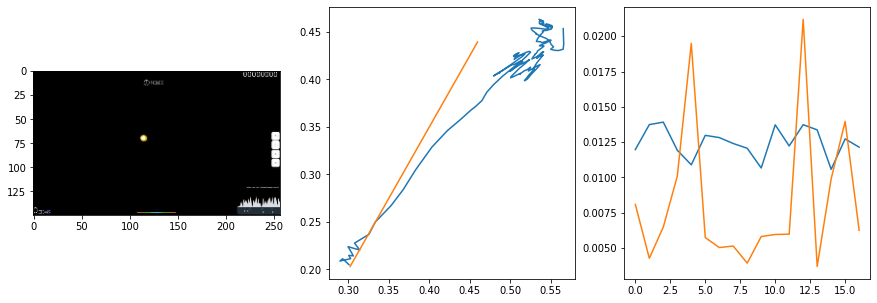

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.73it/s  0.0107                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

17 of 64
pred: 0.39696669578552246 0.4142304062843323
gt: 0.5340051054954529 0.5595927834510803
(130, 83)


<Figure size 1080x360 with 0 Axes>

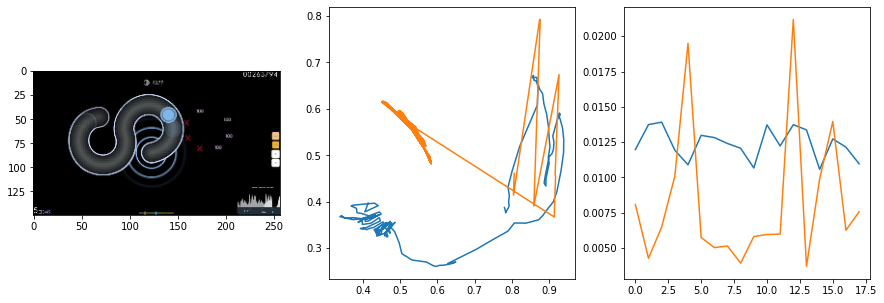

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.74it/s  0.0159                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

18 of 64
pred: 0.7091608643531799 0.662878692150116
gt: 0.6965082883834839 0.7909226417541504
(156, 109)


<Figure size 1080x360 with 0 Axes>

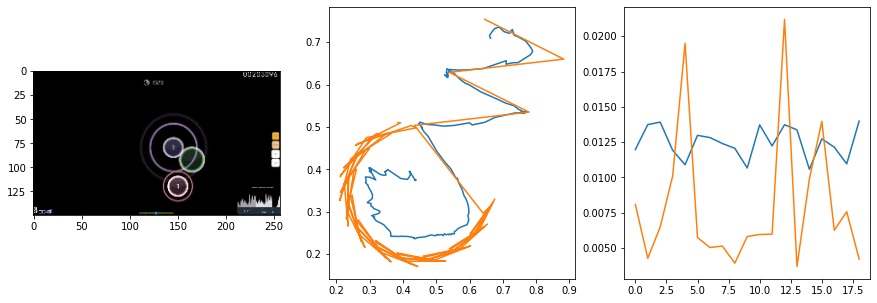

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.74it/s  0.0072                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

19 of 64
pred: 0.41419467329978943 0.7775933742523193
gt: 0.30181244015693665 0.7574915289878845
(94, 106)


<Figure size 1080x360 with 0 Axes>

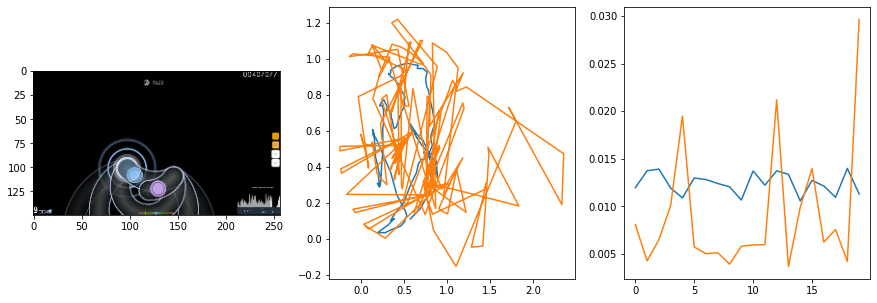

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.74it/s  0.0162                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

20 of 64
pred: 0.6150287985801697 0.5106251239776611
gt: 0.841463029384613 0.5018696188926697
(178, 76)


<Figure size 1080x360 with 0 Axes>

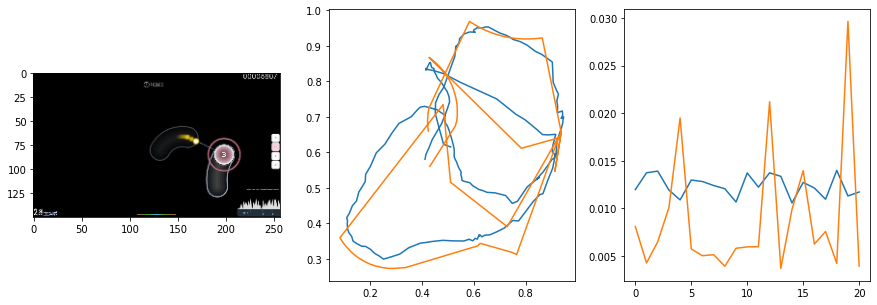

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.74it/s  0.0222                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

21 of 64
pred: 0.5382916331291199 0.4597327709197998
gt: 1.0519939661026 1.0066391229629517
(211, 135)


<Figure size 1080x360 with 0 Axes>

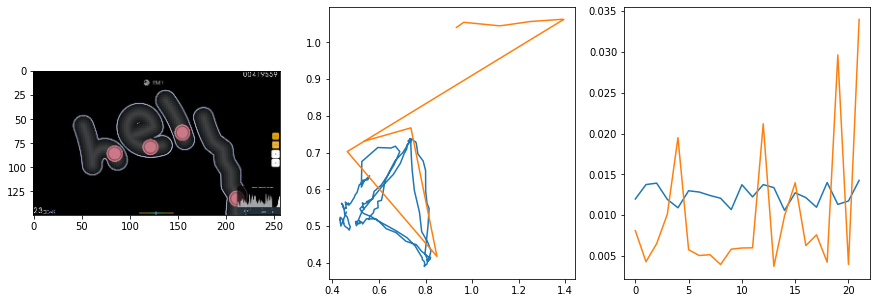

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.74it/s  0.0373                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

22 of 64
pred: 0.6029874086380005 0.6867774724960327
gt: 0.8569155335426331 0.7509644627571106
(180, 105)


<Figure size 1080x360 with 0 Axes>

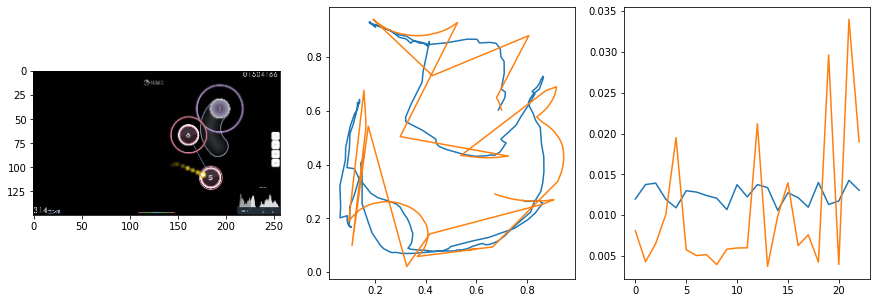

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.72it/s  0.0191                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

23 of 64
pred: 0.6937936544418335 0.4768754839897156
gt: 0.7752190232276917 0.6044138669967651
(168, 88)


<Figure size 1080x360 with 0 Axes>

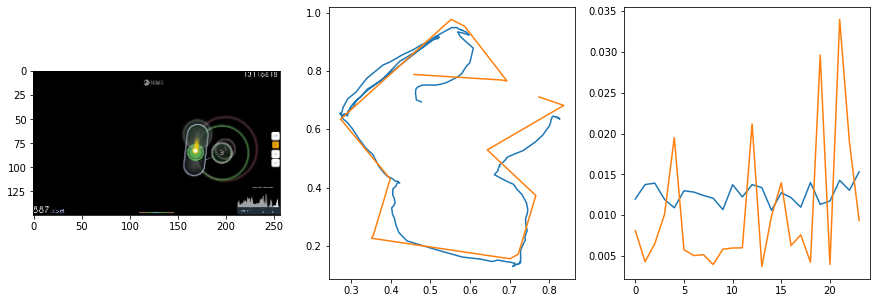

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.78it/s  0.0058                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

24 of 64
pred: 0.2891293168067932 0.6067258715629578
gt: 0.5360804200172424 0.7553420066833496
(131, 105)


<Figure size 1080x360 with 0 Axes>

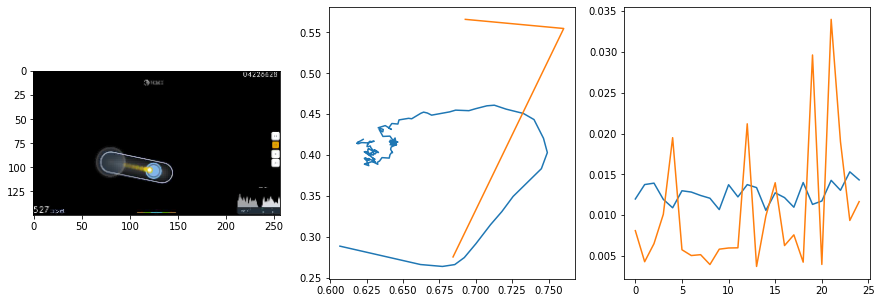

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.77it/s  0.0050                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

25 of 64
pred: 0.22299546003341675 0.6623783707618713
gt: 0.2300889790058136 0.5109230279922485
(83, 77)


<Figure size 1080x360 with 0 Axes>

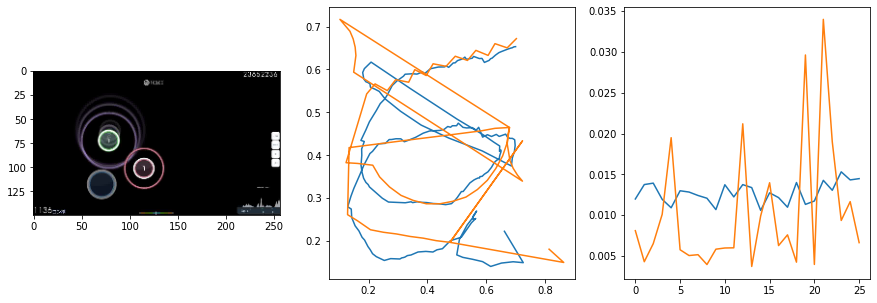

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.72it/s  0.0054                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

26 of 64
pred: 0.3719758093357086 0.27435290813446045
gt: 0.46484375 0.4427083432674408
(120, 69)


<Figure size 1080x360 with 0 Axes>

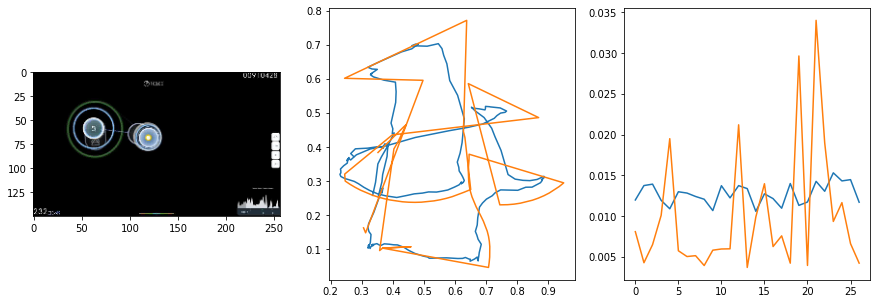

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.69it/s  0.0131                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

27 of 64
pred: 0.21833834052085876 0.34907931089401245
gt: 0.17539860308170319 0.3116142153739929
(75, 54)


<Figure size 1080x360 with 0 Axes>

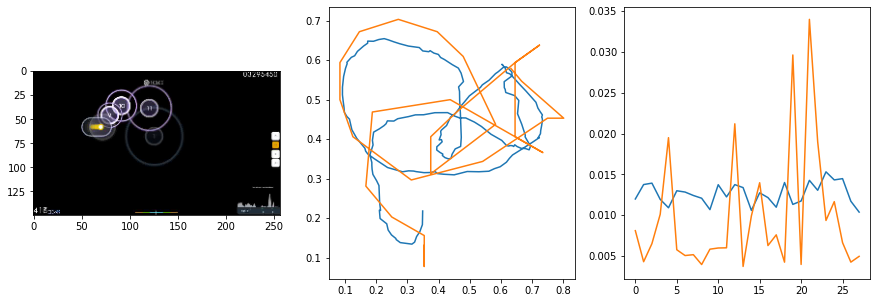

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.80it/s  0.0131                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

28 of 64
pred: 0.6494077444076538 0.6913268566131592
gt: 0.692187488079071 0.625
(155, 90)


<Figure size 1080x360 with 0 Axes>

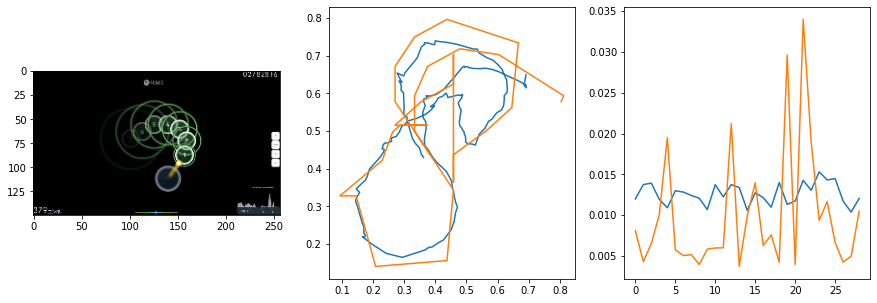

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.79it/s  0.0447                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

29 of 64
pred: 0.45706963539123535 0.26830005645751953
gt: 0.42331966757774353 0.3365860879421234
(113, 57)


<Figure size 1080x360 with 0 Axes>

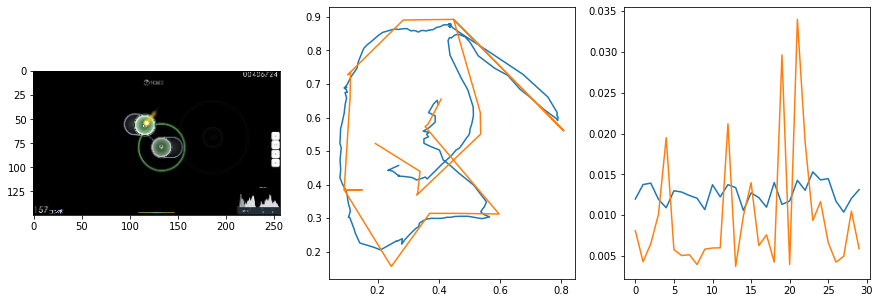

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.74it/s  0.0088                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

30 of 64
pred: 0.8422309160232544 0.5133215188980103
gt: 0.8548309803009033 0.5914646983146667
(180, 86)


<Figure size 1080x360 with 0 Axes>

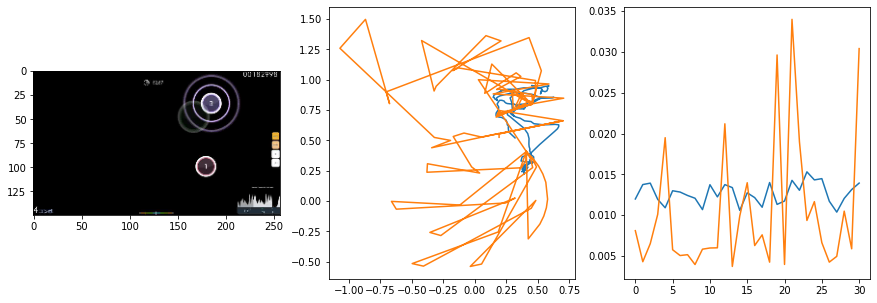

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.81it/s  0.0093                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

31 of 64
pred: 0.5420480370521545 0.2017243206501007
gt: 0.515625 0.203125
(127, 41)


<Figure size 1080x360 with 0 Axes>

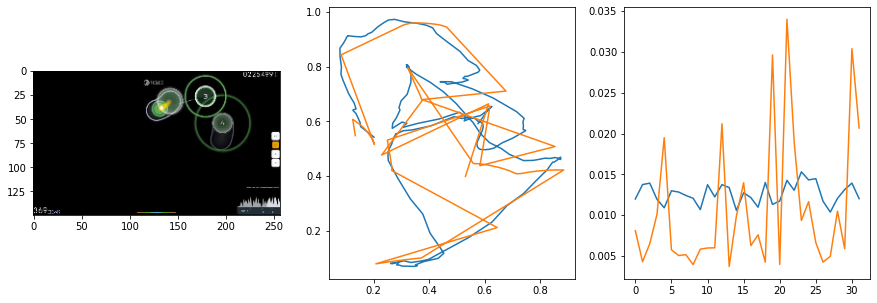

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.70it/s  0.0109                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

32 of 64
pred: 0.5704692006111145 0.6474412679672241
gt: 0.5625 0.4711221158504486
(135, 72)


<Figure size 1080x360 with 0 Axes>

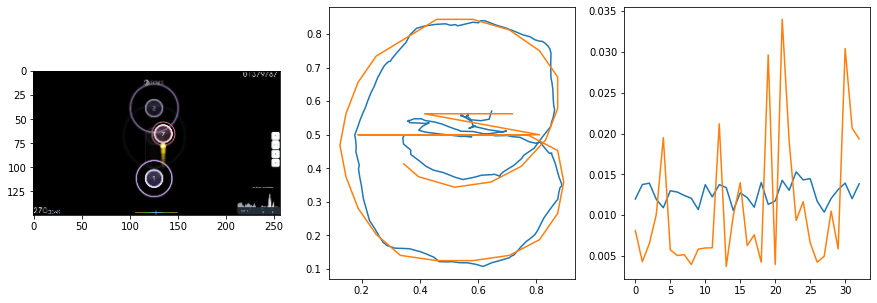

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.73it/s  0.0055                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

33 of 64
pred: 0.5952980518341064 0.6755094528198242
gt: 0.4565354585647583 0.7031917572021484
(118, 99)


<Figure size 1080x360 with 0 Axes>

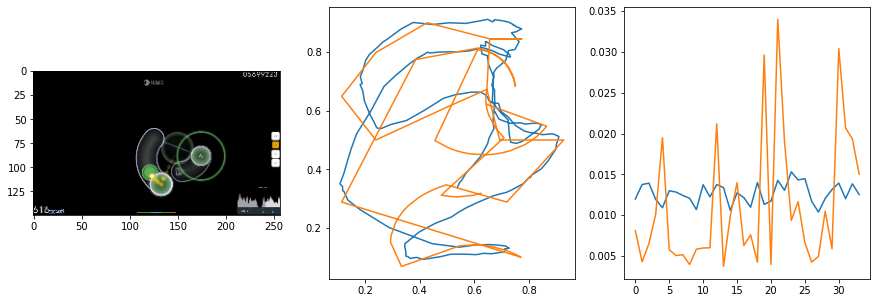

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.74it/s  0.0111                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

34 of 64
pred: 0.4372290074825287 0.5184914469718933
gt: 0.4016069173812866 0.6684431433677673
(110, 95)


<Figure size 1080x360 with 0 Axes>

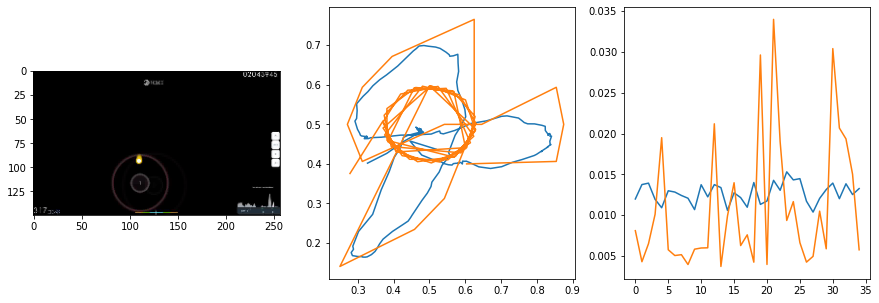

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.73it/s  0.0296                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

35 of 64
pred: 0.4948985278606415 0.786787748336792
gt: 0.58203125 0.765625
(138, 107)


<Figure size 1080x360 with 0 Axes>

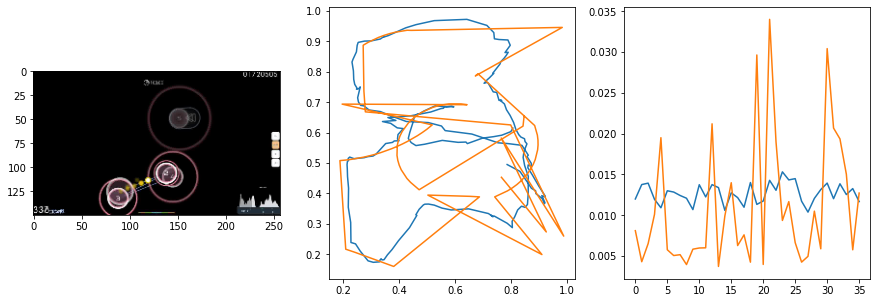

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.71it/s  0.0122                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

36 of 64
pred: 0.4804583787918091 0.46901795268058777
gt: 0.5609742403030396 0.7223150730133057
(134, 102)


<Figure size 1080x360 with 0 Axes>

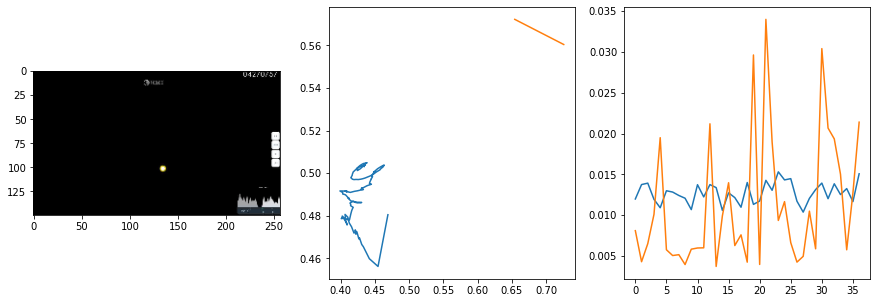

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.73it/s  0.0114                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

37 of 64
pred: 0.32051315903663635 0.6500382423400879
gt: 0.27236127853393555 0.6781993508338928
(90, 96)


<Figure size 1080x360 with 0 Axes>

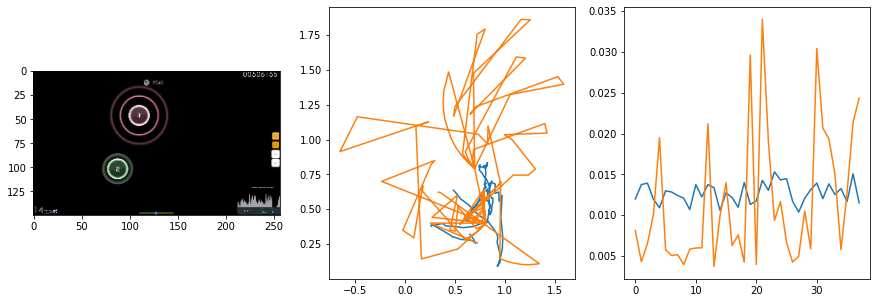

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.74it/s  0.0067                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

38 of 64
pred: 0.6499230861663818 0.49873489141464233
gt: 0.5017321705818176 0.39368000626564026
(125, 63)


<Figure size 1080x360 with 0 Axes>

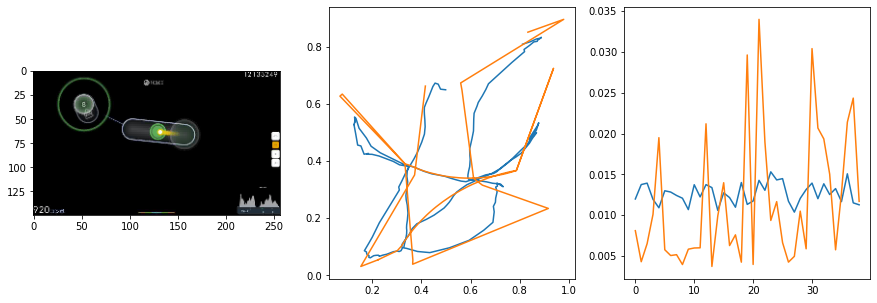

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.79it/s  0.0079                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

39 of 64
pred: 0.2179456204175949 0.36722850799560547
gt: 0.1038752943277359 0.375340074300766
(64, 61)


<Figure size 1080x360 with 0 Axes>

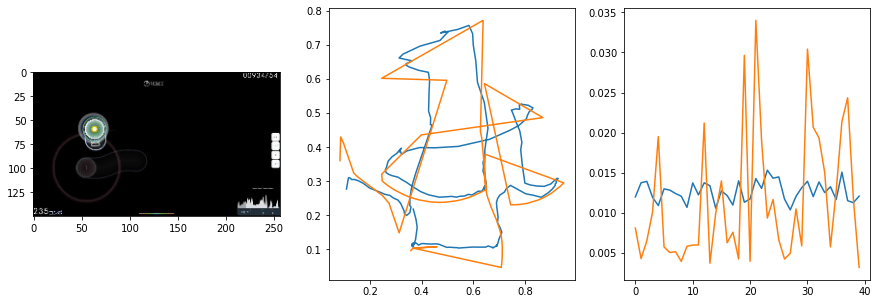

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.79it/s  0.0072                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

40 of 64
pred: 0.527450680732727 0.5828492045402527
gt: 0.5885955095291138 0.7820441722869873
(139, 108)


<Figure size 1080x360 with 0 Axes>

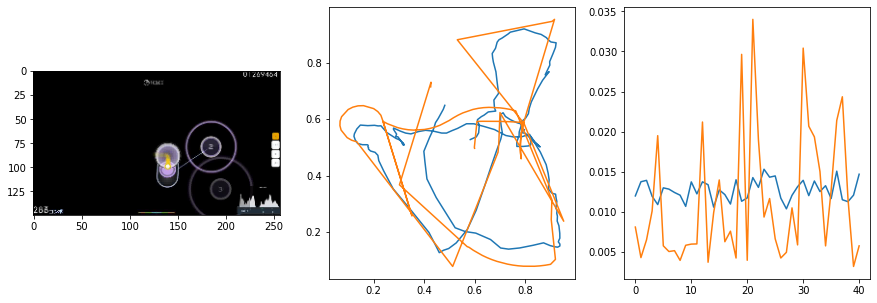

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.74it/s  0.0047                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

41 of 64
pred: 0.5900622606277466 0.5118553042411804
gt: 0.73046875 0.4791666567325592
(161, 73)


<Figure size 1080x360 with 0 Axes>

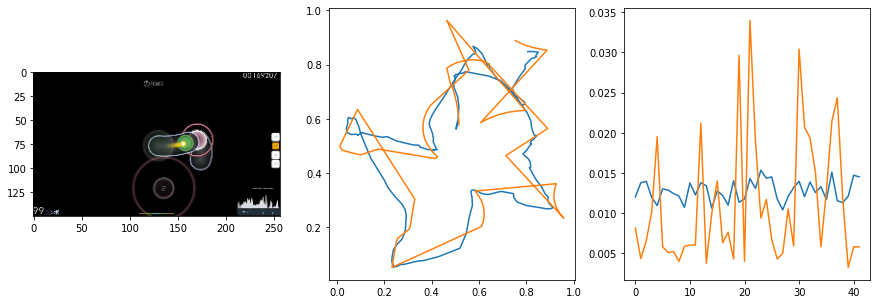

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.72it/s  0.0058                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

42 of 64
pred: 0.5136182308197021 0.6572681665420532
gt: 0.3643818795681 0.6835810542106628
(104, 97)


<Figure size 1080x360 with 0 Axes>

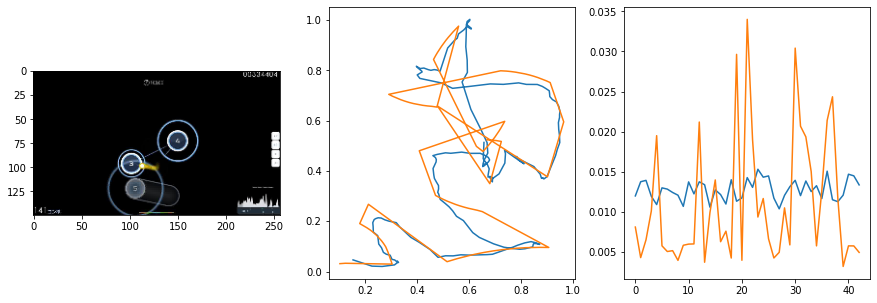

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.69it/s  0.0131                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

43 of 64
pred: 0.17441463470458984 0.6198161244392395
gt: 0.08756732940673828 0.29210570454597473
(61, 51)


<Figure size 1080x360 with 0 Axes>

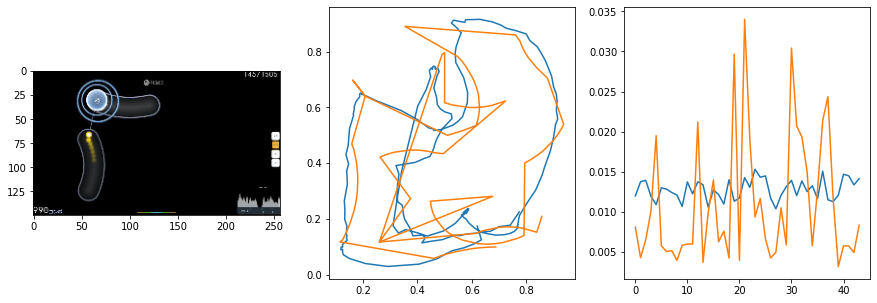

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.69it/s  0.0173                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

44 of 64
pred: 0.7533209919929504 0.3606121838092804
gt: 0.8786430954933167 0.4529878795146942
(184, 70)


<Figure size 1080x360 with 0 Axes>

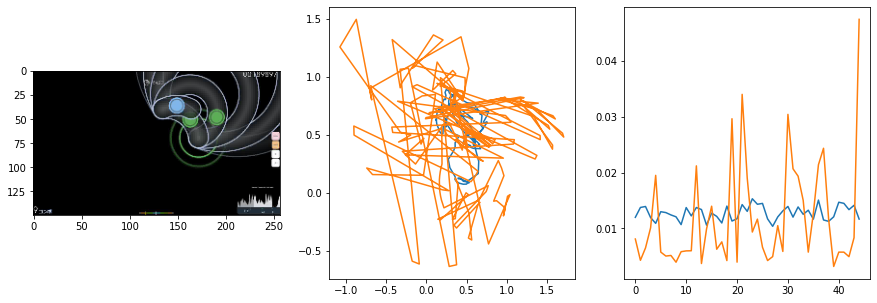

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.70it/s  0.0041                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

45 of 64
pred: 0.42781180143356323 0.5198431015014648
gt: 0.42784029245376587 0.5600370764732361
(114, 83)


<Figure size 1080x360 with 0 Axes>

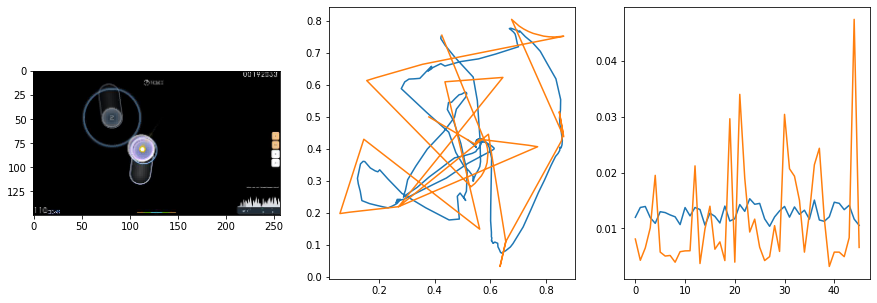

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.74it/s  0.0057                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

46 of 64
pred: 0.7934852838516235 0.5265990495681763
gt: 0.3865581750869751 0.23276685178279877
(107, 45)


<Figure size 1080x360 with 0 Axes>

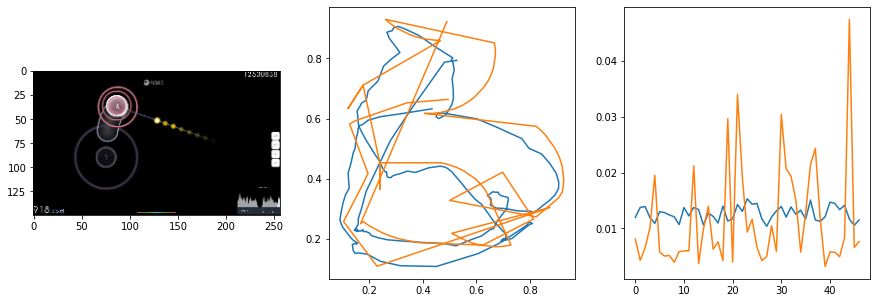

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.72it/s  0.0066                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

47 of 64
pred: 0.7877473831176758 0.5020902752876282
gt: 0.8659244775772095 0.3720439374446869
(182, 61)


<Figure size 1080x360 with 0 Axes>

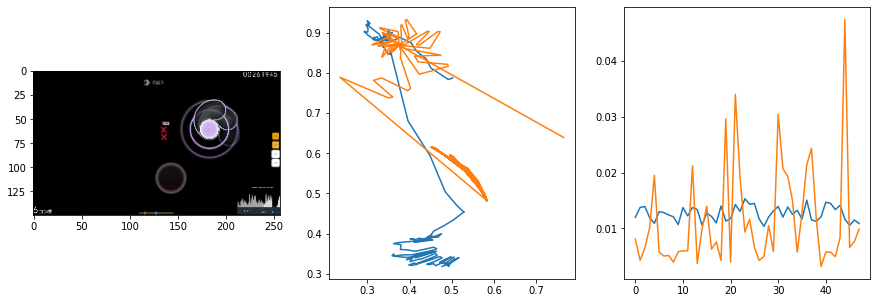

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.73it/s  0.0123                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

48 of 64
pred: 0.49270889163017273 0.284259557723999
gt: 0.5940688848495483 0.3460884392261505
(140, 58)


<Figure size 1080x360 with 0 Axes>

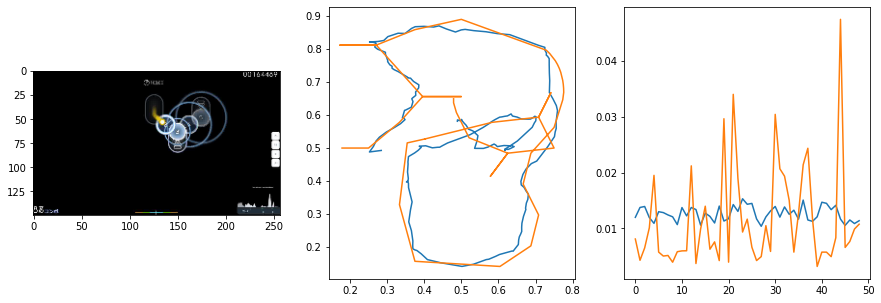

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.74it/s  0.0219                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

49 of 64
pred: 0.5285220146179199 0.6273118853569031
gt: 0.32018786668777466 0.25141727924346924
(97, 47)


<Figure size 1080x360 with 0 Axes>

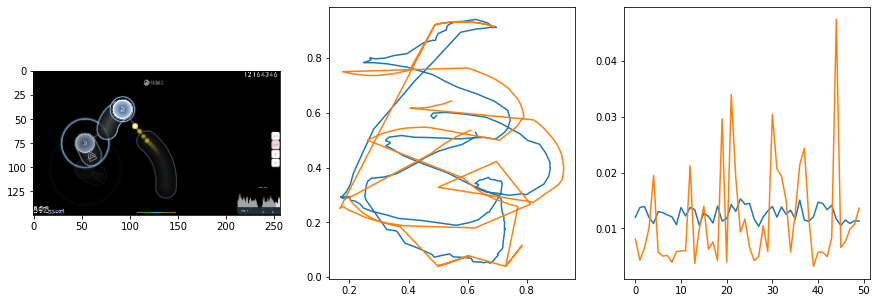

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.74it/s  0.0311                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

50 of 64
pred: 0.24559229612350464 0.7665376663208008
gt: 0.373046875 0.6666666865348816
(105, 95)


<Figure size 1080x360 with 0 Axes>

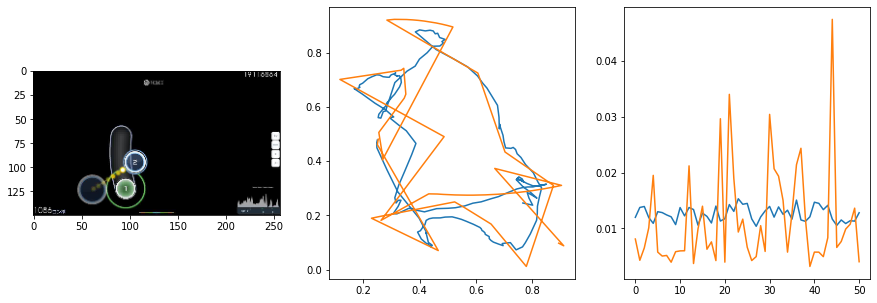

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.73it/s  0.0062                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

51 of 64
pred: 0.5342057943344116 0.5939587354660034
gt: 0.46249234676361084 0.44998130202293396
(119, 70)


<Figure size 1080x360 with 0 Axes>

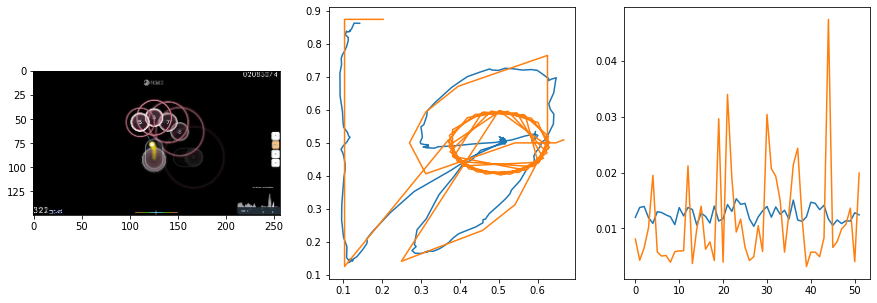

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.74it/s  0.0197                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

52 of 64
pred: 0.43681180477142334 0.7792885303497314
gt: 0.4576602280139923 0.9560381770133972
(118, 129)


<Figure size 1080x360 with 0 Axes>

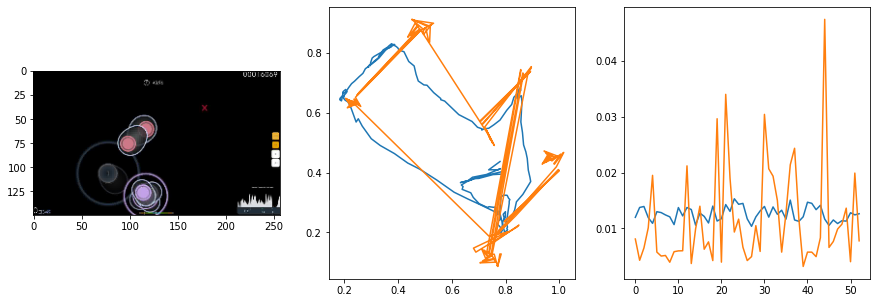

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.72it/s  0.0136                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

53 of 64
pred: 0.6888565421104431 0.6975066065788269
gt: 0.783203125 0.7057291865348816
(169, 100)


<Figure size 1080x360 with 0 Axes>

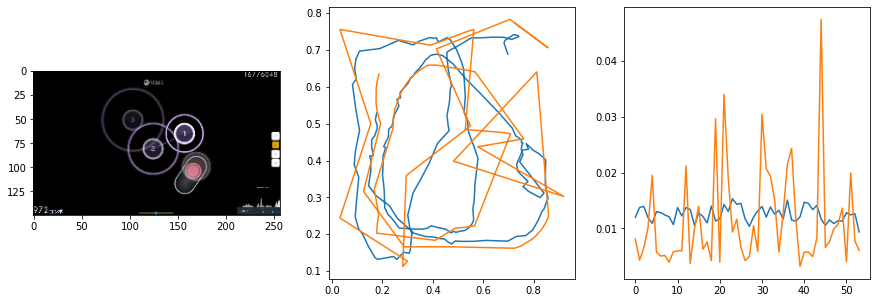

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.72it/s  0.0154                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

54 of 64
pred: 0.719258189201355 0.5718047618865967
gt: 0.662109375 0.5520833134651184
(150, 82)


<Figure size 1080x360 with 0 Axes>

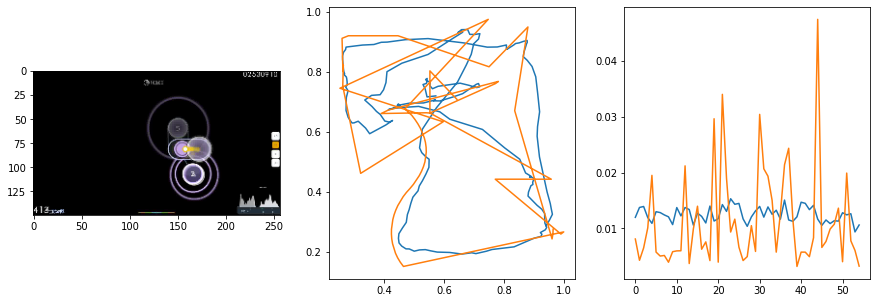

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.72it/s  0.0059                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

55 of 64
pred: 0.826295793056488 0.5374429225921631
gt: 0.8420758843421936 0.6121917366981506
(178, 89)


<Figure size 1080x360 with 0 Axes>

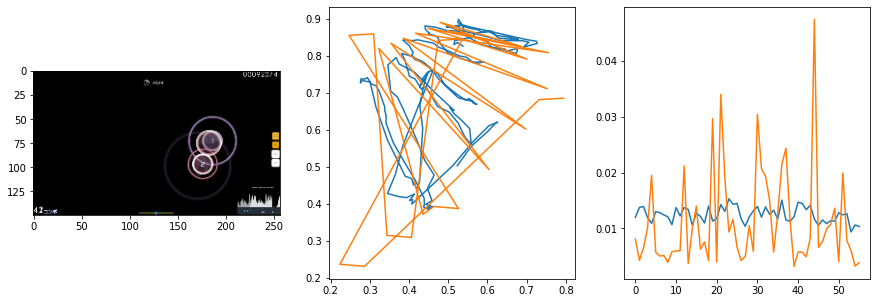

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.71it/s  0.0114                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

56 of 64
pred: 0.4793463945388794 0.47131988406181335
gt: 0.3953767716884613 0.3058813810348511
(109, 53)


<Figure size 1080x360 with 0 Axes>

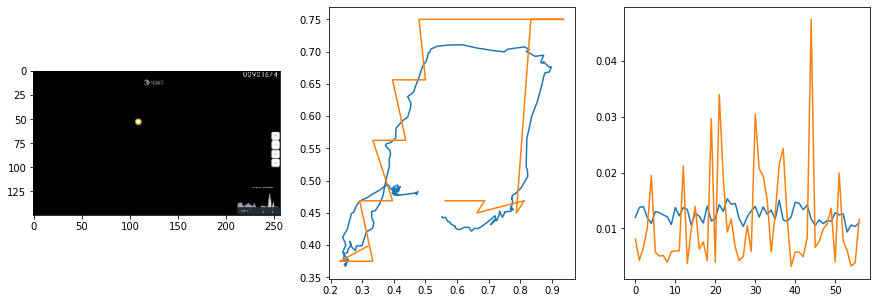

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.71it/s  0.0038                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

57 of 64
pred: 0.37228962779045105 0.6147527098655701
gt: 0.296875 0.9322916865348816
(94, 126)


<Figure size 1080x360 with 0 Axes>

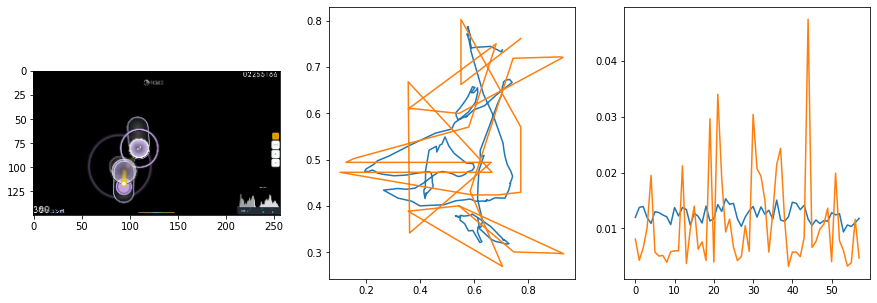

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.74it/s  0.0049                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

58 of 64
pred: 0.2534048855304718 0.6369115710258484
gt: 0.5573863983154297 0.8696280121803284
(134, 119)


<Figure size 1080x360 with 0 Axes>

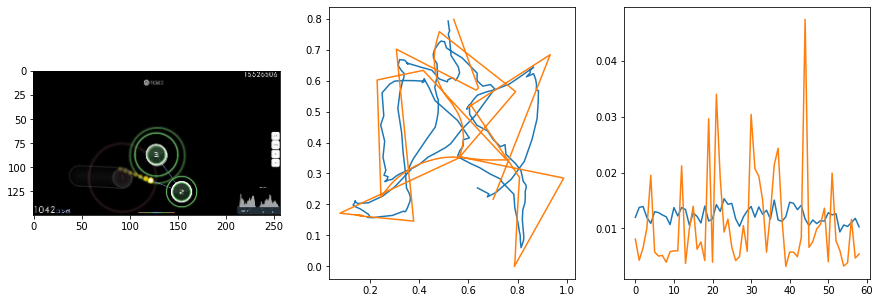

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.74it/s  0.0036                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

59 of 64
pred: 0.6542839407920837 0.506130576133728
gt: 0.7500989437103271 0.31987234950065613
(164, 55)


<Figure size 1080x360 with 0 Axes>

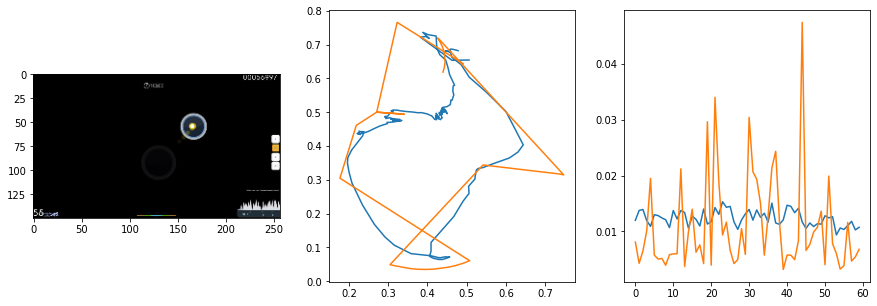

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.73it/s  0.0112                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

60 of 64
pred: 0.9216159582138062 0.3309316039085388
gt: 0.7214796543121338 0.2930499315261841
(159, 52)


<Figure size 1080x360 with 0 Axes>

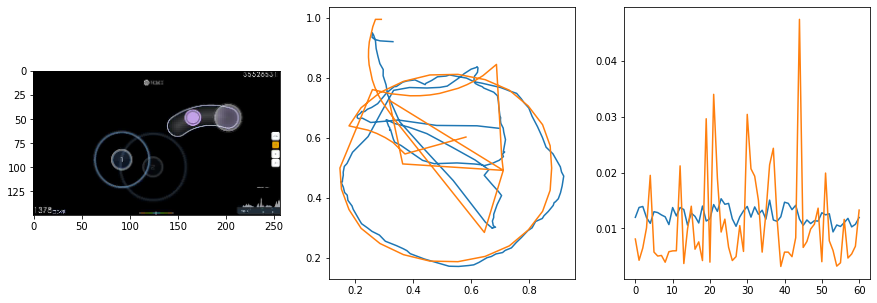

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.73it/s  0.0093                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

61 of 64
pred: 0.4234778583049774 0.5178879499435425
gt: 0.6755514740943909 0.5
(152, 76)


<Figure size 1080x360 with 0 Axes>

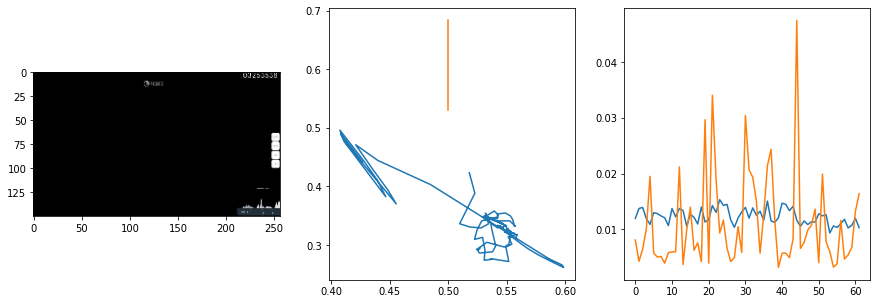

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.75it/s  0.0044                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

62 of 64
pred: 0.583215594291687 0.4097803235054016
gt: 0.755859375 0.3932291567325592
(165, 63)


<Figure size 1080x360 with 0 Axes>

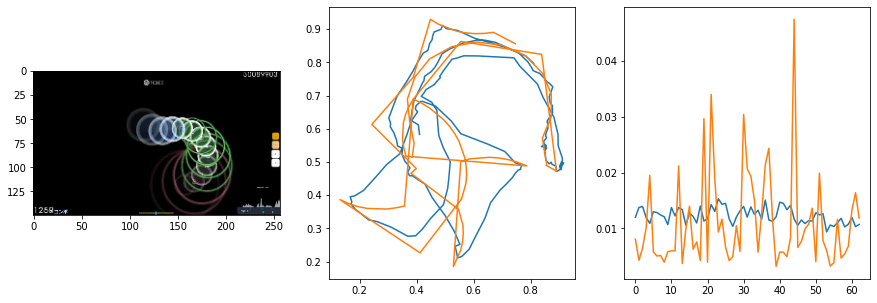

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.79it/s  0.0086                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

63 of 64
pred: 0.6923715472221375 0.6855506896972656
gt: 0.6471151113510132 0.7181524634361267
(148, 101)


<Figure size 1080x360 with 0 Axes>

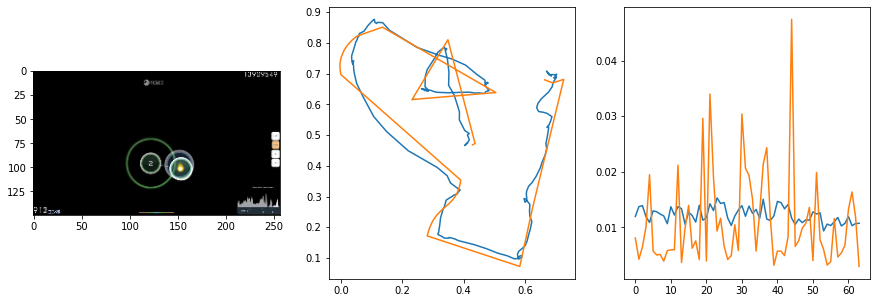

633.4024229049683 secs


In [ ]:
start = time.time()

lamb = 4
epochs = 64
trainVN()

end = time.time()
print(end - start, 'secs')

In [ ]:
torch.save(vn.state_dict(), model_path + str(epoch_cum) + '.pt')

# Test Model

In [ ]:
import os
import cv2
import torch
import torchvision.transforms as transforms

In [ ]:
vn.load_state_dict(torch.load(model_path + str(128) + '.pt'))

<All keys matched successfully>

In [ ]:
#osud = '../ex/beatmaps/567301 LamazeP - Spam Jack'
#osuf = 'LamazeP - Spam Jack (OsuToothbrush) [SPAM].osu'
#osud = '../ex/beatmaps/252981 DJ Okawari - Flower Dance (Short Ver)'
#osuf = 'DJ Okawari - Flower Dance (Short Ver.) (-Hanayuki-) [Relax].osu'
#osud = '../ex/beatmaps/348381 sasakureUK - Spider Thread Monopoly feat Hatsune Miku'
#osuf = 'sasakure.UK - Spider Thread Monopoly feat. Hatsune Miku (Mishima Yurara) [Milan-\'s Hard].osu'
#osud = '../demo/beatmaps/835194 Mili - Vulnerability'
#osuf = 'Mili_-_Vulnerability_IceKalt_Saturnalizes_Insane.osu'
#osud = '../demo/beatmaps/653534 Panda Eyes - ILY'
#osuf = 'Panda Eyes - ILY (M a r v o l l o) [Light Insane].osu'
osud = '../demo/beatmaps/388036 Akiyama Uni - Kanpan Tasogare Shinbun'
osuf = 'Akiyama Uni - Kanpan Tasogare Shinbun (09kami) [Insane].osu'

In [ ]:
osr = OSR(osud, osuf, sample_rate=sample_rate, hop_size=hop_size, skin='./skin_hidden', vtmp='../demo/vids/')

In [ ]:
osr.create_vid()

***********************************************************
['ffmpeg', '-y', '-loglevel', 'info', '-thread_queue_size', '24', '-f', 'rawvideo', '-vcodec', 'rawvideo', '-s', '1024x600', '-pix_fmt', 'yuv420p', '-r', '50.00', '-an', '-i', '-', '-i', '/tmp/06243aac-b4d3-11ec-b0b0-a85e4554c351temp/audio.mp3', '-acodec', 'aac', '-vcodec', 'mjpeg', '-preset', 'fast', '-crf', '18', '-ab', '320k', '-threads', '0', '../demo/vids/Akiyama Uni - Kanpan Tasogare Shinbun (09kami) [Insane].osu.avi']
***********************************************************


In [ ]:
video_path = os.path.join('../demo/vids/', osuf + '.avi')

In [ ]:
vn.to(device)
vn.init_hidden(1)
vn.eval()

VN(
  (convA): Conv2d(3, 1, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (convB): Conv2d(1, 1, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (linear1): Linear(in_features=2368, out_features=592, bias=True)
  (lstmA): LSTM(592, 64, num_layers=2, batch_first=True)
  (linearA): Linear(in_features=64, out_features=32, bias=True)
  (linearB): Linear(in_features=32, out_features=2, bias=True)
)

In [ ]:
transform = transforms.ToTensor()
frames = []
vc = cv2.VideoCapture(video_path)
p = []
while True:
    r, f = vc.read()
    if r is False:
        break
    f = cv2.resize(f, (0,0), fx=scale, fy=scale)
    F = transform(f).to(device)
    with torch.no_grad():
        P = vn(F.unsqueeze(0).unsqueeze(0))
    p.append(P.squeeze(0).squeeze(0).cpu().detach().numpy())

# Create Replay Video

In [ ]:
from IPython.display import Video

In [ ]:
np.save('predVN.npy', p)

In [ ]:
eosud = osud.replace('/', '\/')

In [ ]:
!sed -i "s/Beatmap path.*/Beatmap path\": \"$eosud\/$osuf\",/" data.json
!sed -i "s/Output path.*/Output path\": \"videoVN.mp4\",/" data.json

In [ ]:
!python create_replayVN.py predVN.npy 50

2022-04-05 07:25:26,872:INFO:osr2mp4.Osr2mp4:__init__:test
2022-04-05 07:25:26,873:TRACE:osr2mp4.Utils.Setup:setupglobals:CALL *({'osu! path': '', 'Skin path': 'skin/', 'Beatmap path': '../demo/beatmaps/388036 Akiyama Uni - Kanpan Tasogare Shinbun/Akiyama Uni - Kanpan Tasogare Shinbun (09kami) [Insane].osu', '.osr path': 'auto', 'Default skin path': 'skin/', 'Output path': 'videoVN.mp4', 'Width': 1024, 'Height': 600, 'FPS': 30, 'Start time': 0, 'End time': -1, 'Video codec': 'mjpeg', 'Process': 0, 'ffmpeg path': 'ffmpeg'}, {'Show score meter': True, 'Always show key overlay': True, 'Song volume': 100, 'Effect volume': 100, 'Enable PP counter': True, 'Enable Strain Graph': True, 'FFmpeg codec': 'libx264', 'FFmpeg custom commands': '', 'Audio bitrate': 320, 'api key': None, 'Use FFmpeg video writer': True, 'Custom mods': ''}, [], <osr2mp4.global_var.Settings object at 0x7f3404db3550>) **{'ppsettings': {'x': 1220, 'y': 690, 'text_x': 1140, 'text_y': 748, 'Font Size': 20, 'Size': 10, 'Rgb'

In [ ]:
Video("videoVN.mp4")

In [ ]:
!sed -i "s/Output path.*/Output path\": \"video.mp4\",/" data.json

In [ ]:
!python create_replay.py predHN.npy predVN.npy 50 0.5

2022-04-05 01:28:27,439:INFO:osr2mp4.Osr2mp4:__init__:test
2022-04-05 01:28:27,439:TRACE:osr2mp4.Utils.Setup:setupglobals:CALL *({'osu! path': '', 'Skin path': 'skin/', 'Beatmap path': "../ex/beatmaps/348381 sasakureUK - Spider Thread Monopoly feat Hatsune Miku/sasakure.UK - Spider Thread Monopoly feat. Hatsune Miku (Mishima Yurara) [Milan-'s Hard].osu", '.osr path': 'auto', 'Default skin path': 'skin/', 'Output path': 'video.mp4', 'Width': 1024, 'Height': 600, 'FPS': 30, 'Start time': 0, 'End time': -1, 'Video codec': 'mjpeg', 'Process': 0, 'ffmpeg path': 'ffmpeg'}, {'Show score meter': True, 'Always show key overlay': True, 'Song volume': 100, 'Effect volume': 100, 'Enable PP counter': True, 'Enable Strain Graph': True, 'FFmpeg codec': 'libx264', 'FFmpeg custom commands': '', 'Audio bitrate': 320, 'api key': None, 'Use FFmpeg video writer': True, 'Custom mods': ''}, [], <osr2mp4.global_var.Settings object at 0x7f5a2cedf580>) **{'ppsettings': {'x': 1220, 'y': 690, 'text_x': 1140, 'tex

In [ ]:
Video("video.mp4")

In [ ]:
import time
import numpy as np

# Data Class

In [ ]:
import os
import re
import json
import math
import cv2
import subprocess as sp
from osr2mp4.EEnum.EReplay import Replays
from osr2mp4.osr2mp4 import Osr2mp4
import torch
import torchvision.io as vision
import torchvision.transforms as transforms

In [ ]:
class OSR():
    def __init__(self, beatmap_dir, beatmap, sample_rate=44100, hop_size=441, skin=None,
                 tmp='./tmp', vtmp='./vid', atmp='./wav'):
        self.beatmap = beatmap
        self.beatmap_dir = beatmap_dir
        self.beatmap_path = os.path.join(self.beatmap_dir, self.beatmap)
        self.sample_rate = sample_rate
        self.hop_size = hop_size
        self.rate = int(sample_rate / hop_size)
        self.fps = self.rate
        self.tmp = tmp
        self.vtmp = vtmp
        self.atmp = atmp
        self.skin = skin
        self.data_json = os.path.join(self.tmp, self.beatmap + '.json')
        self.video_path = os.path.join(self.vtmp, self.beatmap + '.avi')
        
        self.replay_info = None
        self.osr2mp4 = None
        self.video = None
        self.hitobjects = None
        self.cursorstream = None
        self.timestamp = None
        
    def run_osr2mp4(self):
        d = json.load(open('data.json', 'r'))
        f = open(self.data_json, 'w')
        d['Beatmap path'] = self.beatmap_path
        if self.skin is not None:
            d['Skin path'] = self.skin
        d['FPS'] = self.fps
        d['Output path'] = self.video_path
        json.dump(d, f)
        f.close()
                 
        self.osr2mp4 = Osr2mp4(filedata=self.data_json, filesettings='settings.json', filepp='ppsettings.json', 
                               filestrain='strainsettings.json', logtofile=True)
        while True:
            if self.osr2mp4.replay_info.play_data[-1][Replays.CURSOR_X] == 0 and self.osr2mp4.replay_info.play_data[-1][Replays.CURSOR_Y] == 0:
                self.osr2mp4.replay_info.play_data = self.osr2mp4.replay_info.play_data[0:-1]
            else:
                break
        
    def create_vid(self):
        if self.osr2mp4 is None:
            self.run_osr2mp4()
        cmd = ['python', 'create_vid.py', self.data_json]
        proc = sp.Popen(cmd)
        proc.wait()
        
    def parse_timings(self):
        if self.video is None:
            self.get_video()
        self.beat_len = []
        self.timestamp = []
        f = open(self.beatmap_path)
        for l in f:
            if re.match(r'BeatDivisor.*', l):
                self.BeatDivisor = int(l.split(':')[1])
                break
        f.seek(0)
        for l in f:
            if re.match(r'\[TimingPoints\]', l):
                break
        for l in f:
            if l == "\n":
                break
            a = l.split(',')
            if float(a[1]) < 0:
                continue
            self.beat_len.append(float(a[1]))
            self.timestamp.append(float(a[0]))
        self.timestamp.append(int(self.video[1].shape[1] / self.video[2]['audio_fps'] * 1000))
        f.close()
    
    def parse_hitobjects(self):
        self.hitobjects = []
        f = open(self.beatmap_path)
        for l in f:
            if re.match(r'ApproachRate.*', l):
                AR = float(l.split(':')[1])
                if AR < 5.0:
                    preempt = 1200 + 600 * (5 - AR) / 5
                    fadein = 800 + 400 * (5 - AR) / 5
                else:
                    preempt = 1200 - 750 * (AR - 5) / 5
                    fadein = 800 - 500 * (AR - 5) / 5
                self.preempt = preempt - fadein*0.1
                break
        f.seek(0)
        for l in f:
            if re.match(r'SliderMultiplier.*', l):
                self.sliderMultiplier = float(l.split(':')[1])
                break
        f.seek(0)
        for l in f:
            if re.match(r'\[HitObjects\]', l):
                break
        for l in f:
            self.hitobjects.append(l.split(','))
        f.close()
    
    def parse_beatmap(self):
        self.parse_timings()
        self.parse_hitobjects()
    
    def process_beatobjects(self):
        pass
    
    def process_hitobjects(self):
        if self.hitobjects is None:
               self.parse_beatmap()
        self.hitobjStream = [None] * math.ceil(self.timestamp[-1] * 0.001 * self.rate)
    
    def process_clicks(self):
        pass
    
    def process_cursor(self):
        if self.osr2mp4 is None:
            self.run_osr2mp4()
        n = math.ceil((self.osr2mp4.replay_info.play_data[-1][Replays.TIMES] - self.get_offset()) * 0.001 * self.fps)
        self.cursorstream = [None] * n
        
        for j in range(len(self.osr2mp4.replay_info.play_data) - 1):
            a = self.osr2mp4.replay_info.play_data[j]
            b = self.osr2mp4.replay_info.play_data[j+1]
            delta = (b[Replays.TIMES] - a[Replays.TIMES]) * 0.001 * self.fps
            xdist = b[Replays.CURSOR_X] - a[Replays.CURSOR_X]
            ydist = b[Replays.CURSOR_Y] - a[Replays.CURSOR_Y]
            stime = (a[Replays.TIMES] - self.get_offset()) * 0.001 * self.fps
            x = a[Replays.CURSOR_X]
            y = a[Replays.CURSOR_Y]
            
            e = [0.0, 0.0, 0]            
            for t in range(math.ceil(delta)):
                e[Replays.CURSOR_X] = x + xdist/delta*t
                e[Replays.CURSOR_Y] = y + ydist/delta*t
                self.cursorstream[int(stime + t)] = torch.tensor(e)
            e[2] = 1
            e[Replays.CURSOR_X] = a[Replays.CURSOR_X]
            e[Replays.CURSOR_Y] = a[Replays.CURSOR_Y]
            self.cursorstream[int((a[Replays.TIMES] - self.get_offset()) * 0.001 * self.fps)] = torch.tensor(e)
            e[Replays.CURSOR_X] = b[Replays.CURSOR_X]
            e[Replays.CURSOR_Y] = b[Replays.CURSOR_Y]
            self.cursorstream[int((b[Replays.TIMES] - self.get_offset()) * 0.001 * self.fps)] = torch.tensor(e)
        
    def process_events(self):
        self.process_clicks()
        self.process_cursor()
        
    def read_video(self, scale=1):
        if not os.path.exists(self.video_path):
            self.create_vid()
        #self.video = vision.read_video(self.video_path)
        transform = transforms.ToTensor()
        frames = []
        vc = cv2.VideoCapture(self.video_path)
        while True:
            r, f = vc.read()
            f = cv2.resize(f, (0,0), fx=scale, fy=scale)
            frames.append(transform(f))
            if r is False:
                break
        return torch.stack(frames)
        
    def queue_vid(self):
        if not os.path.exists(self.video_path):
            self.create_vid()   
        return self.video_path
    
    def get_offset(self):
        if self.osr2mp4 is None:
            self.run_osr2mp4()
        return self.osr2mp4.replay_info.play_data[0][Replays.TIMES]
    
    def get_beatobjects(self):
        if self.beatobjStream is None:
            self.process_beatobjects()
        stream = [None] * len(self.beatobjStream)
        for i in range(len(self.beatobjStream)):
            if self.beatobjStream[i] == [] or self.beatobjStream == None:
                h = np.array([0], dtype=np.float32)
            else:
                h = np.array(self.beatobjStream[i], dtype=np.float32)
            stream[i] = torch.tensor(np.pad(h, (0, 64 - h.shape[0])))
        return torch.stack(stream)
        
    def get_hitobjects(self):
        if self.hitobjStream is None:
            self.process_hitobjects()
        stream = [None] * len(self.hitobjStream)
        for i in range(len(self.hitobjStream)):
            if self.hitobjStream[i] == [] or self.hitobjStream == None:
                h = np.array([0], dtype=np.float32)
            else:
                h = np.array(self.hitobjStream[i], dtype=np.float32)
            stream[i] = torch.tensor(np.pad(h, (0, 64 - h.shape[0])))
        return torch.stack(stream)
    
    def get_cursor(self):
        if self.cursorstream is None:
            self.process_events()
        return torch.stack(self.cursorstream)
        
    def get_video(self, scale=1):
        if self.video is None:
            self.read_video(scale=1)
        return self.video

# Dataset

In [ ]:
import glob
import copy
import traceback
import torch
import torchvision.transforms as transforms
from torch.utils.data import Dataset
import cv2
import matplotlib.pyplot as plt

In [ ]:
class OSR_Dataset(Dataset):
    def __init__(self, beatmap_dir, sample_rate=44100, hop_size=441, seq_dur=10, scale=1, hidden_mod=0, maximum=100):
        self.beatmap_dir = beatmap_dir
        self.sample_rate = sample_rate
        self.hop_size = hop_size
        self.seq_len = int(seq_dur * sample_rate / hop_size)
        self.hidden_mod = hidden_mod
        self.maximum = maximum
        
        self.osrs = []
        
        if beatmap_dir is None:
            self.v = []
            self.c = []
            return
        
        j = 0
        def parse_beatmaps(j):
            for r, dirs, _ in os.walk(beatmap_dir):
                for dir in dirs:
                    for root, _, files in os.walk(os.path.join(r, dir)):
                        for f in files:
                            if re.match(r'.*osu$', f):
                                if self.hidden_mod == 0 or j % self.hidden_mod != 0:
                                    self.osrs.append(OSR(root, f, sample_rate=sample_rate, hop_size=hop_size))
                                else:
                                    self.osrs.append(OSR(root, f, sample_rate=sample_rate, hop_size=hop_size, skin='./skin_hidden'))
                                if j == self.maximum:
                                    return j
                                j += 1
            return j
        j = parse_beatmaps(j)
        
        self.v = [None] * j
        self.c = [None] * j
        
        def process(i):
            m = self.osrs[i]
            self.osrs[i] = None;
            try:
                print(str(i) + '/' + str(j-1), m.beatmap)
                self.v[i] = copy.deepcopy(m.queue_vid())
                self.c[i] = copy.deepcopy(m.get_cursor())
            except Exception as e:
                traceback.print_exc()
                print("pruning:", m.beatmap)
                self.v[i] = None
                self.c[i] = None
            del m
        
        list(map(process, range(j)))
        
    def take(self, ds, i, j):
        self.v = ds.v[i:j]
        self.c = ds.c[i:j]

    def __len__(self):
        return len(self.v)

    def __getitem__(self, i):
        if self.seq_len == 0:
            return None
        
        transform = transforms.ToTensor()
        j = np.random.randint(0, self.c[i].shape[0] - self.seq_len)
        vc = cv2.VideoCapture(self.v[i])
        vc.set(cv2.CAP_PROP_POS_FRAMES, j)
        #for k in range(j):
        #    _, _ = vc.read()
        
        f = [None] * self.seq_len
        for k in range(self.seq_len):
            frame = vc.read()[1]
            frame = cv2.resize(frame, (0,0), fx=scale, fy=scale)
            f[k] = transform(frame)
        
        c = self.c[i][j: j+self.seq_len]
        cy = torch.div(c[:,Replays.CURSOR_Y], 384)
        c[:,1] = torch.div(c[:,Replays.CURSOR_X], 512)
        c[:,0] = cy
        
        return (torch.stack(f), c) #self.c[i][j: j+self.seq_len])

# Testing

In [ ]:
s = OSR_Dataset('../ex/beatmaps', sample_rate=44100, hop_size=441*2, hidden_mod=0, maximum=1)

0/0 sasakure.UK - Spider Thread Monopoly feat. Hatsune Miku (Mishima Yurara) [Milan-'s Hard].osu


(300, 512, 3)
tensor(0.9660) tensor(0.1710)
(395, 74)


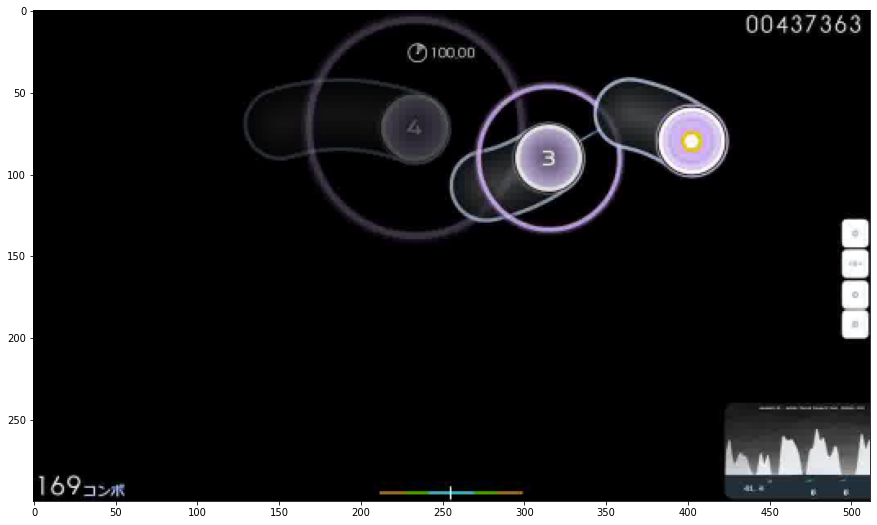

In [ ]:
import matplotlib.pyplot as plt

import op

op.h = 600 / 2
op.w = 1024 / 2
op.calratio()

e = s[0]
print(e[0][0].permute(1, 2, 0).numpy().shape)

plt.rcParams["figure.figsize"] = (15, 15)

plt.xticks(np.arange(0, e[0][0].permute(1, 2, 0).numpy().shape[1], 50))
plt.yticks(np.arange(0, e[0][0].permute(1, 2, 0).numpy().shape[0], 50))

plt.imshow(cv2.cvtColor(e[0][0].permute(1, 2, 0).numpy(), cv2.COLOR_BGR2RGB))
print(e[1][0][1], e[1][0][0])
print(op.cor(e[1][0][1] * 512, e[1][0][0] * 384))
#print(op.cor(e[1][0][1], e[1][0][0]))
#for x in e[1][0:10]:
    #print(op.cor(x[0], x[1]))

# Constants

In [ ]:
sample_rate = 44100
hop_size = 441*2
hidden_mod = 3
maximum = 32
ds_path = './datasets/VN/ds.pkl'
model_path = './models/VN/model01_'

# Process Data

In [ ]:
import time

In [ ]:
ds = OSR_Dataset('../beatmaps', sample_rate=sample_rate, hop_size=hop_size, hidden_mod=hidden_mod, maximum=maximum)

0/31 Chata - Engage (Lasse) [Insane].osu
1/31 Mimi - Surrealism (feat. ZAT) (-Tatsuo) [no mania].osu
2/31 sana - kanojo wa tabi ni deru (Firika) [Insane].osu
3/31 Ishida Youko - To the Promised Sky ~The place that I was~ (caren) [Collabo].osu
4/31 StylipS - Prism Sympathy(Asterisk Remix) (iMage--) [Kaleid Liner].osu
5/31 Cranky - Chandelier - King (Mao) [Gero's Insane].osu
6/31 senya - Akatsuki no Suiheisen ni (Satellite) [Zweib's Insane].osu
7/31 Tadokoro Azusa - 1HOPE SNIPER (Sotarks) [NiNo's Insane].osu
8/31 fripSide - future gazer (TV Size) (alacat) [Insane].osu
9/31 cYsmix - bells! (Gero) [normal!].osu
10/31 Yazawa Nico (CV.Tokui Sora) - Nicopuri Joshidou (yf_bmp) [z1085684963's Insane].osu
11/31 Hamburgaga - Watame Internet Connection Race (CE6A) [Insane].osu
12/31 xi - Parousia -LAST JUDGMENT- (Zapy) [Retribution].osu
13/31 Shiena Nishizawa - Meaning (Taeyang) [xChippy's Insane].osu
14/31 namirin - Hitokoto no Kyori (sahuang) [Linadeft's Insane].osu
15/31 Narushima - Gothic and 

In [ ]:
start = time.time()

torch.save(ds, ds_path)

end = time.time()
print(end - start, 'secs')

0.005749940872192383 secs


# Load Daaset

In [ ]:
ds = torch.load(ds_path)

# Model

In [ ]:
import math
import torch
import torch.nn as nn
import torch.nn.functional as nnF

In [ ]:
class VN(nn.Module):
    def __init__(self, dim_in, device):
        super(VN, self).__init__()
        
        self.device = device
        self.lstmA_size = 64
        self.lstmA_layers = 2
        self.dim_out = 2

        cA = [0,0]
        W = dim_in[0]
        K = cAK = 4
        P = cAP = 1
        S = cAS = 2
        w = int(((W - K + 2*P)/S) + 1)
        k = mAk = 2
        p = mAp = 0
        s = mAs = 2
        m = int(((w - k + 2*p)/s) + 1)
        cA[0] = w
        
        W = dim_in[1]
        K = cAK
        P = cAP
        S = cAS
        w = int(((W - K + 2*P)/S) + 1)
        k = mAk
        p = mAp
        s = mAs
        m = int(((w - k + 2*p)/s) + 1)
        cA[1] = w
        
        cB = [0,0]
        W = cA[0]
        K = cBK = 4
        P = cBP = 1
        S = cBS = 2
        w = int(((W - K + 2*P)/S) + 1)
        k = mBk = 2
        p = mBp = 0
        s = mBs = 2
        m = int(((w - k + 2*p)/s) + 1)
        cB[0] = w
        
        W = cA[1]
        K = cBK
        P = cBP
        S = cBS
        w = int(((W - K + 2*P)/S) + 1)
        k = mBk
        p = mBp
        s = mBs
        m = int(((w - k + 2*p)/s) + 1)
        cB[1] = w
        
        
        self.convA = nn.Conv2d(3, 1, cAK, stride=cAS, padding=cAP)
        #self.maxPA = nn.MaxPool2d(mAk, stride=mAs, padding=mAp)
        self.convB = nn.Conv2d(1, 1, cBK, stride=cBS, padding=cBP) 
        #self.maxPB = nn.MaxPool2d(mBk, stride=mBs, padding=mBp)
        self.linear1 = nn.Linear(math.prod(cB),  int(math.prod(cB)/4))
        
        self.lstmA = nn.LSTM(int(math.prod(cB)/4), hidden_size=self.lstmA_size, num_layers=self.lstmA_layers,
                             batch_first=True, bidirectional=False)
        self.linearA = nn.Linear(self.lstmA_size, 32)
        self.linearB = nn.Linear(32, self.dim_out)
        
        self.hiddenA = None
        
    def init_hidden(self, batch_size):
        h = torch.zeros(self.lstmA_layers, batch_size, self.lstmA_size).to(self.device)
        c = torch.zeros(self.lstmA_layers, batch_size, self.lstmA_size).to(self.device)
        self.hiddenA = (h, c)
 
    def forward(self, x):
        s = x.shape
        x = torch.reshape(x, (s[0] * s[1], s[2], s[3], s[4]))
        x = self.convA(x)
        x = nnF.relu(x)
        #x = self.maxPA(x)
        x = self.convB(x)
        x = nnF.relu(x)
        #x = self.maxPB(x)
        x = torch.flatten(x, start_dim=1)
        x = torch.reshape(x, (s[0], s[1], x.shape[-1]))
                          
        x = self.linear1(x)
        x = nnF.relu(x)

        
        x, self.hiddenA = self.lstmA(x, self.hiddenA)
        x = self.linearA(x)
        x = nnF.relu(x)
        x = self.linearB(x)
        
        return x

# Training

In [ ]:
import torch
from torch.utils.data import DataLoader
from torchinfo import summary
from qqdm.notebook import qqdm
import matplotlib.pyplot as plt
import op

In [ ]:
batch_size = 2
scale = 1/4
dim_in = (int(600 * scale), int(1024 * scale))
seq_dur = 4

In [ ]:
device = torch.device('cuda')

In [ ]:
epoch_cum = 0
val_hist = []
train_hist = []
vn = VN(dim_in=dim_in, device=device)
vn.to(device)

VN(
  (convA): Conv2d(3, 1, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (convB): Conv2d(1, 1, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (linear1): Linear(in_features=2368, out_features=592, bias=True)
  (lstmA): LSTM(592, 64, num_layers=2, batch_first=True)
  (linearA): Linear(in_features=64, out_features=32, bias=True)
  (linearB): Linear(in_features=32, out_features=2, bias=True)
)

In [ ]:
vn.init_hidden(1)
summary(vn, input_size=(1, 1, 3, dim_in[0], dim_in[1]), col_width=16,
           col_names=["input_size",
                "output_size",
                "num_params",
                "kernel_size",
                "mult_adds",])

Layer (type:depth-idx)                   Input Shape      Output Shape     Param #          Kernel Shape     Mult-Adds
VN                                       --               --               --               --               --
├─Conv2d: 1-1                            [1, 3, 150, 256] [1, 1, 75, 128]  49               [3, 1, 4, 4]     470,400
├─Conv2d: 1-2                            [1, 1, 75, 128]  [1, 1, 37, 64]   17               [1, 1, 4, 4]     40,256
├─Linear: 1-3                            [1, 1, 2368]     [1, 1, 592]      1,402,448        [2368, 592]      1,402,448
├─LSTM: 1-4                              [1, 1, 592]      [1, 1, 64]       201,728          --               201,728
├─Linear: 1-5                            [1, 1, 64]       [1, 1, 32]       2,080            [64, 32]         2,080
├─Linear: 1-6                            [1, 1, 32]       [1, 1, 2]        66               [32, 2]          66
Total params: 1,606,388
Trainable params: 1,606,388
Non-trainable params:

In [ ]:
train_ds = OSR_Dataset(None, sample_rate=sample_rate, hop_size=hop_size, seq_dur=seq_dur, scale=scale, hidden_mod=hidden_mod, maximum=maximum)
val_ds = OSR_Dataset(None, sample_rate=sample_rate, hop_size=hop_size, seq_dur=seq_dur, scale=scale, hidden_mod=hidden_mod, maximum=maximum)

train_ds.take(ds, 0, int(len(ds) * 0.8))
val_ds.take(ds, int(len(ds) * 0.8), len(ds))

train_ldr = DataLoader(train_ds, batch_size=batch_size, shuffle=True, num_workers=1, prefetch_factor=2)
val_ldr = DataLoader(val_ds, batch_size=batch_size, shuffle=True, num_workers=1, prefetch_factor=2)

In [ ]:
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(vn.parameters(), lr=0.001)

In [ ]:
op.h = dim_in[0]
op.w = dim_in[1]
op.calratio()

def trainVN():
    global epoch_cum, lamb
    global v, c, PV, pv, g, gt, MP, MC

    for epoch in range(epochs):
        vn.train()
        train_loss = 0
        info = qqdm(train_ldr)
        for v, c in info:
        #for v, c in train_ldr:
            V, C = v.to(device), c.to(device)
            
            optimizer.zero_grad()
            vn.init_hidden(v.shape[0])
            PV = vn(V)
            
            mp = PV.cpu()
            mc = c
            for i in range(c.shape[0]):
                for j in range(c.shape[1]):
                    if c[i][j][2] != 1:
                        mc[i][j] = torch.tensor([0, 0, 0])
                        mp[i][j] = torch.tensor([0, 0])
            loss1 = criterion(PV, C[:,:,:2])
            loss2 = criterion(mp, mc[:,:,:2])
            
            loss = loss1 + loss2 * lamb
            loss.backward()
            optimizer.step()
            
            train_loss += loss.item()
            info.set_infos({'loss': f'{loss.item():.4f}'})

        vn.eval()
        torch.no_grad()
        val_loss = 0
        for v, c in val_ldr:
            V, C = v.to(device), c.to(device)

            vn.init_hidden(v.shape[0])
            PV = vn(V)
            
            loss = criterion(PV, C[:,:,:2])
            val_loss += loss.item()

        print(epoch+epoch_cum, 'of', epochs+epoch_cum)

        plt.rcParams["figure.figsize"] = (15, 5)
        plt.figure()
        _, p = plt.subplots(1, 3)
        
        e = v[0][10].permute(1, 2, 0).numpy()
        g = c[0][10][:2]
        print('pred:', float(PV[0][0][1]), float(PV[0][0][0]))
        print('gt:', float(g[1]), float(g[0]))
        print(op.cor(g[1] * 512, g[0] * 384))
        p[0].imshow(cv2.cvtColor(e, cv2.COLOR_BGR2RGB))
        
        pv = PV[0].cpu().detach().numpy().transpose(1, 0)
        p[1].plot(pv[0], pv[1])
        gt = c[0].permute(1, 0).numpy()
        p[1].plot(gt[0], gt[1])
        
        train_loss = train_loss/len(train_ldr)
        val_loss = val_loss/len(val_ldr)
        train_hist.append(float(train_loss))
        val_hist.append(float(val_loss))
        
        p[2].plot(train_hist)
        p[2].plot(val_hist)
        
        plt.show()

    epoch_cum += epochs

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:18<00:00:00  0.71it/s  0.0441                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

0 of 64
pred: 0.1670236736536026 0.23408940434455872
gt: 0.11856142431497574 0.5122952461242676
(66, 77)


<Figure size 1080x360 with 0 Axes>

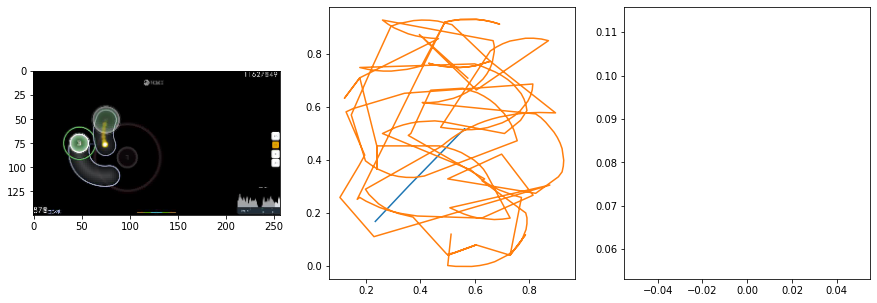

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:18<00:00:00  0.70it/s  0.0589                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

1 of 64
pred: 0.18724389374256134 0.2356615662574768
gt: 0.6234681606292725 0.5
(144, 76)


<Figure size 1080x360 with 0 Axes>

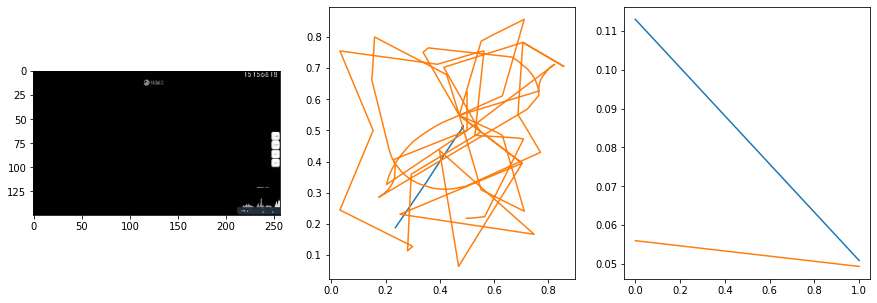

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:18<00:00:00  0.71it/s  0.0500                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

2 of 64
pred: 0.19073382019996643 0.24708175659179688
gt: 0.328125 0.12950000166893005
(98, 33)


<Figure size 1080x360 with 0 Axes>

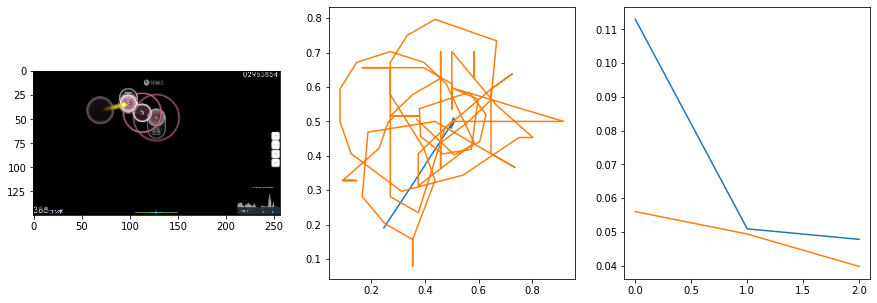

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:19<00:00:00  0.65it/s  0.0123                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

3 of 64
pred: 0.20244699716567993 0.25378552079200745
gt: 0.419348806142807 0.7423902153968811
(113, 104)


<Figure size 1080x360 with 0 Axes>

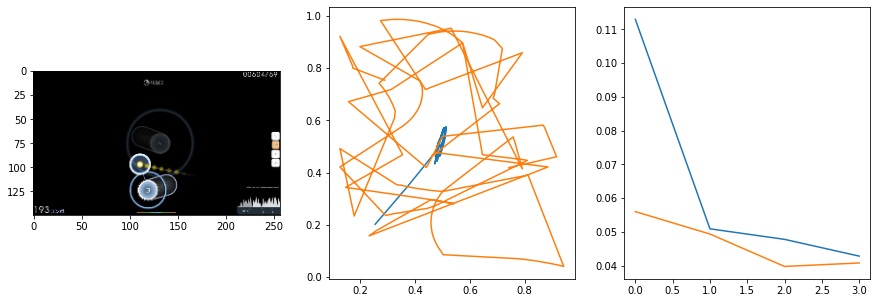

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:19<00:00:00  0.68it/s  0.0281                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

4 of 64
pred: 0.1088458001613617 0.21775487065315247
gt: 0.184815913438797 0.4848403036594391
(76, 74)


<Figure size 1080x360 with 0 Axes>

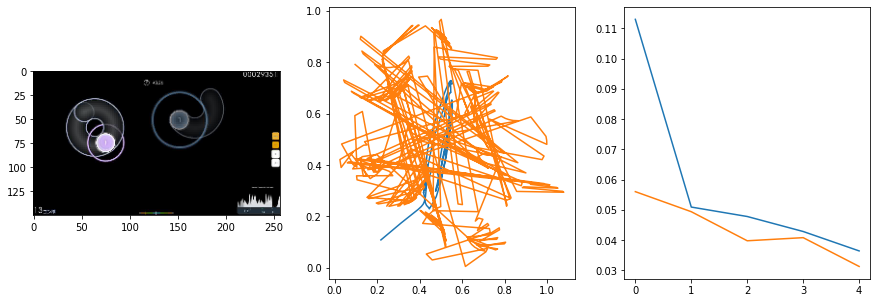

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:19<00:00:00  0.67it/s  0.0196                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

5 of 64
pred: 0.17376726865768433 0.22208160161972046
gt: 0.5245254039764404 0.2515867352485657
(129, 47)


<Figure size 1080x360 with 0 Axes>

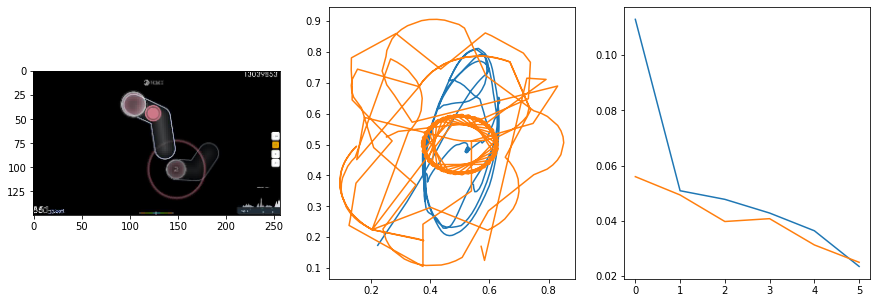

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:18<00:00:00  0.70it/s  0.0090                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

6 of 64
pred: 0.1564527451992035 0.2766638994216919
gt: 0.3125 0.7708333134651184
(96, 107)


<Figure size 1080x360 with 0 Axes>

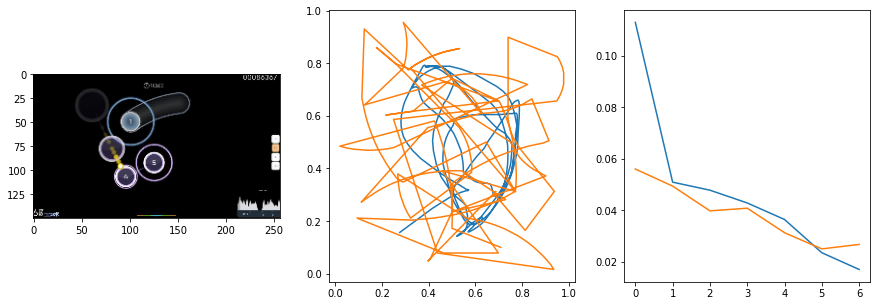

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:18<00:00:00  0.70it/s  0.0189                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

7 of 64
pred: 0.22073526680469513 0.21394288539886475
gt: 0.732421875 0.6927083134651184
(161, 98)


<Figure size 1080x360 with 0 Axes>

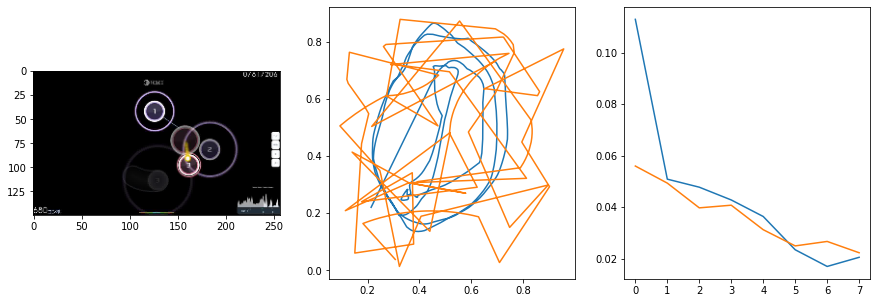

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:17<00:00:00  0.75it/s  0.0248                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

8 of 64
pred: 0.207676500082016 0.20708131790161133
gt: 0.8515625 0.1354166716337204
(180, 33)


<Figure size 1080x360 with 0 Axes>

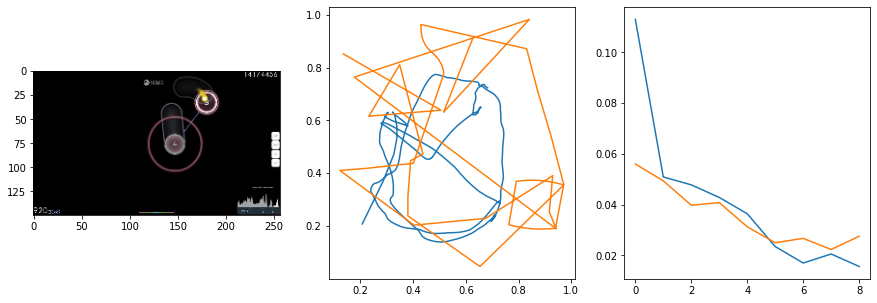

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:17<00:00:00  0.75it/s  0.0052                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

9 of 64
pred: 0.1994331032037735 0.2448495477437973
gt: 0.464829683303833 0.4676953852176666
(120, 72)


<Figure size 1080x360 with 0 Axes>

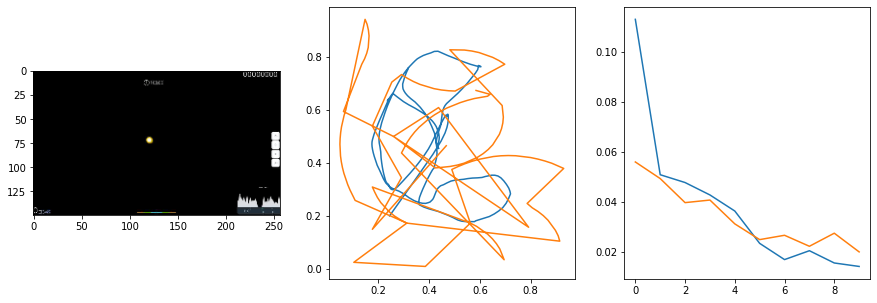

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:17<00:00:00  0.74it/s  0.0132                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

10 of 64
pred: 0.284785658121109 0.3145998418331146
gt: 0.648297131061554 0.6415918469429016
(148, 92)


<Figure size 1080x360 with 0 Axes>

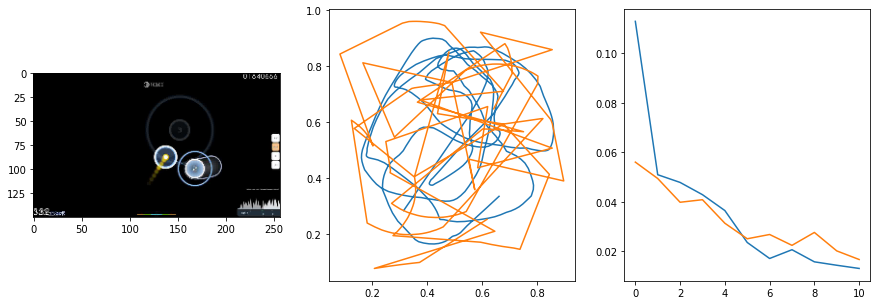

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:17<00:00:00  0.74it/s  0.0116                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

11 of 64
pred: 0.12970927357673645 0.24770215153694153
gt: 0.029296875 0.6197916865348816
(52, 90)


<Figure size 1080x360 with 0 Axes>

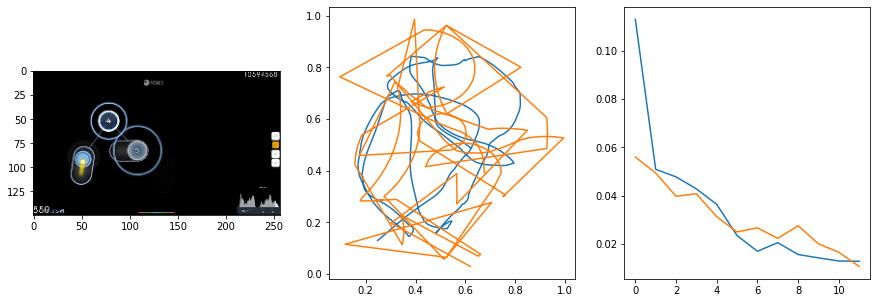

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:17<00:00:00  0.73it/s  0.0139                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

12 of 64
pred: 0.13237400352954865 0.2957477569580078
gt: 0.15715144574642181 0.6430288553237915
(72, 92)


<Figure size 1080x360 with 0 Axes>

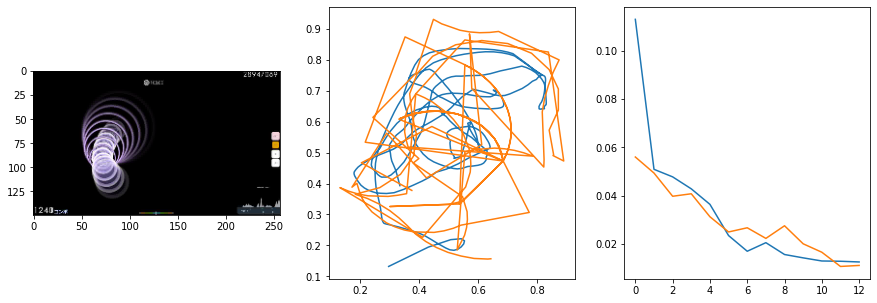

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:19<00:00:00  0.67it/s  0.0235                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

13 of 64
pred: 0.22849862277507782 0.27697286009788513
gt: 0.337890625 0.5703125
(100, 84)


<Figure size 1080x360 with 0 Axes>

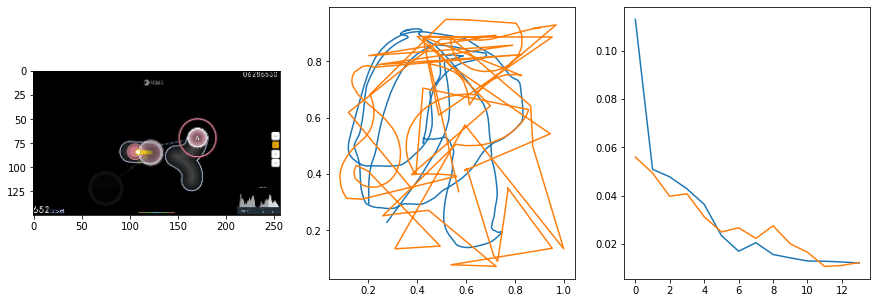

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:19<00:00:00  0.67it/s  0.0086                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

14 of 64
pred: 0.22753332555294037 0.2766439616680145
gt: 0.5 0.5625
(125, 83)


<Figure size 1080x360 with 0 Axes>

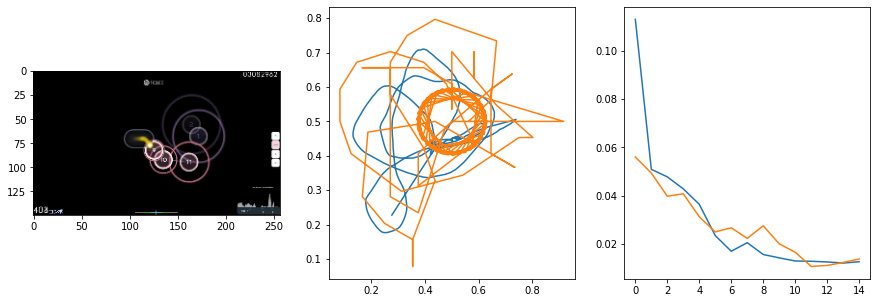

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:18<00:00:00  0.69it/s  0.0164                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

15 of 64
pred: 0.12060348689556122 0.2697174847126007
gt: 0.03719687461853027 0.35736000537872314
(53, 59)


<Figure size 1080x360 with 0 Axes>

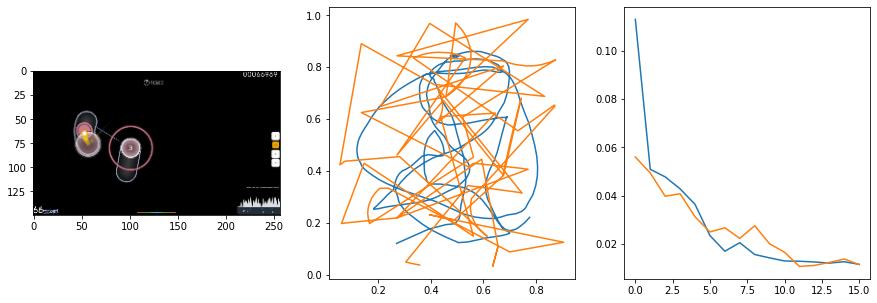

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:19<00:00:00  0.67it/s  0.0103                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

16 of 64
pred: 0.1941845715045929 0.24841195344924927
gt: 0.23454158008098602 0.3185822665691376
(84, 55)


<Figure size 1080x360 with 0 Axes>

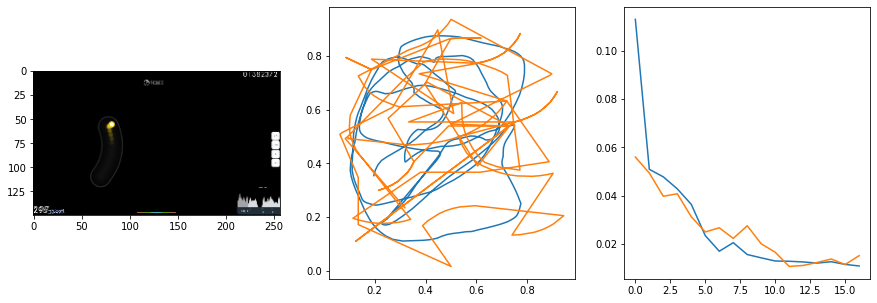

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:19<00:00:00  0.66it/s  0.0040                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

17 of 64
pred: 0.3046363592147827 0.3577873408794403
gt: 0.8172470331192017 0.6794444918632507
(174, 97)


<Figure size 1080x360 with 0 Axes>

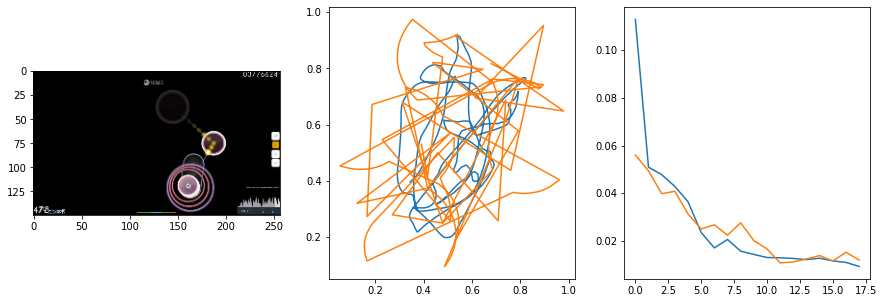

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:19<00:00:00  0.67it/s  0.0032                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

18 of 64
pred: 0.22224591672420502 0.2772892713546753
gt: 0.5899395942687988 0.568661630153656
(139, 84)


<Figure size 1080x360 with 0 Axes>

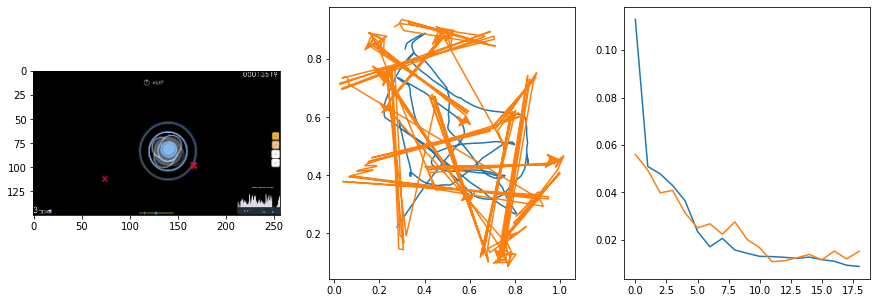

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:19<00:00:00  0.66it/s  0.0083                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

19 of 64
pred: 0.19030117988586426 0.26490676403045654
gt: 0.44118303060531616 0.41495534777641296
(116, 66)


<Figure size 1080x360 with 0 Axes>

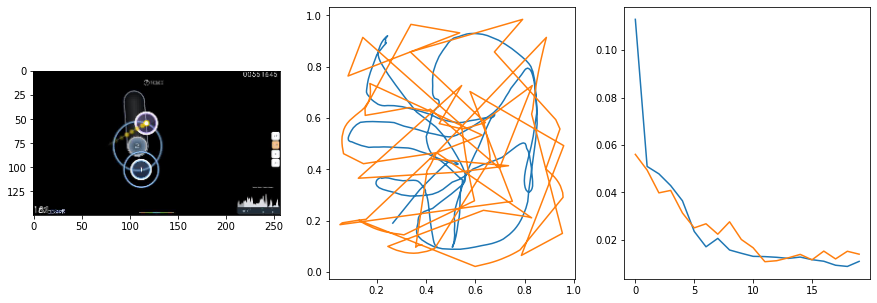

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:19<00:00:00  0.66it/s  0.0143                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

20 of 64
pred: 0.19639520347118378 0.22438238561153412
gt: 0.5207270383834839 0.2997449040412903
(128, 52)


<Figure size 1080x360 with 0 Axes>

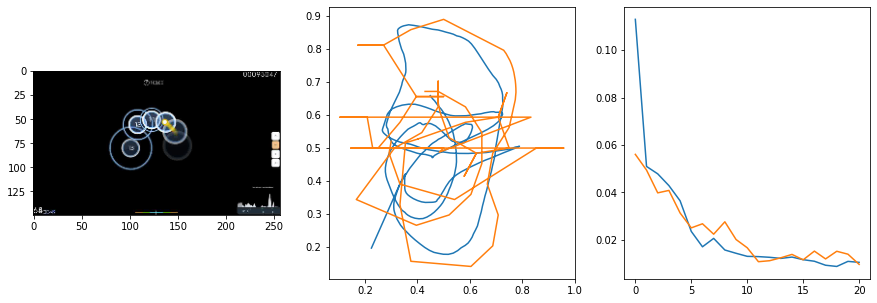

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:19<00:00:00  0.67it/s  0.0069                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

21 of 64
pred: 0.2601131796836853 0.2551681399345398
gt: 0.6422784924507141 0.36266613006591797
(147, 60)


<Figure size 1080x360 with 0 Axes>

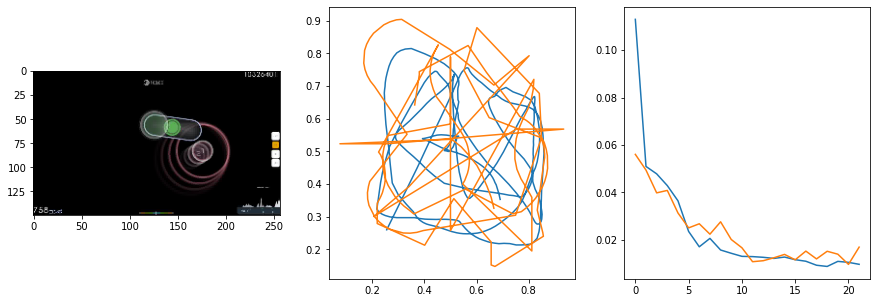

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:19<00:00:00  0.67it/s  0.0035                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

22 of 64
pred: 0.1761496365070343 0.20167002081871033
gt: 0.3156282603740692 0.36687496304512024
(96, 60)


<Figure size 1080x360 with 0 Axes>

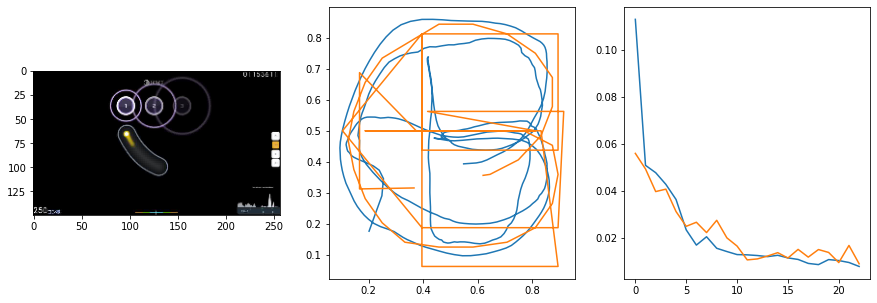

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:18<00:00:00  0.69it/s  0.0075                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

23 of 64
pred: 0.1656402051448822 0.30729690194129944
gt: 0.20398761332035065 0.6027126312255859
(79, 88)


<Figure size 1080x360 with 0 Axes>

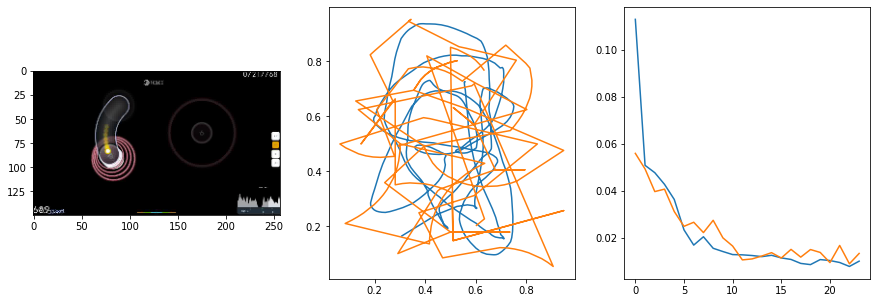

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:18<00:00:00  0.70it/s  0.0128                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

24 of 64
pred: 0.18768326938152313 0.2446858286857605
gt: 0.2789735198020935 0.4601269066333771
(91, 71)


<Figure size 1080x360 with 0 Axes>

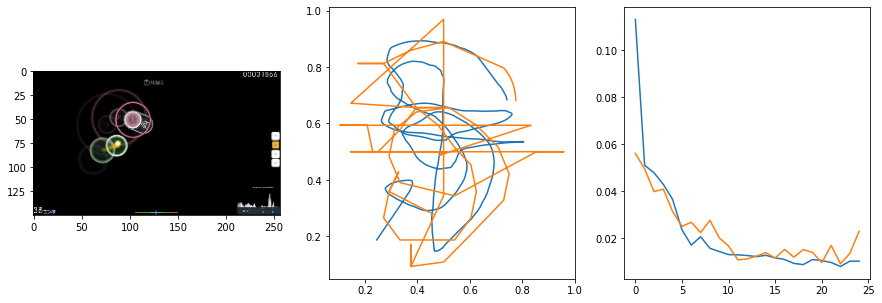

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:18<00:00:00  0.68it/s  0.0062                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

25 of 64
pred: 0.1360706239938736 0.2118760049343109
gt: 0.13277067244052887 0.21961991488933563
(68, 43)


<Figure size 1080x360 with 0 Axes>

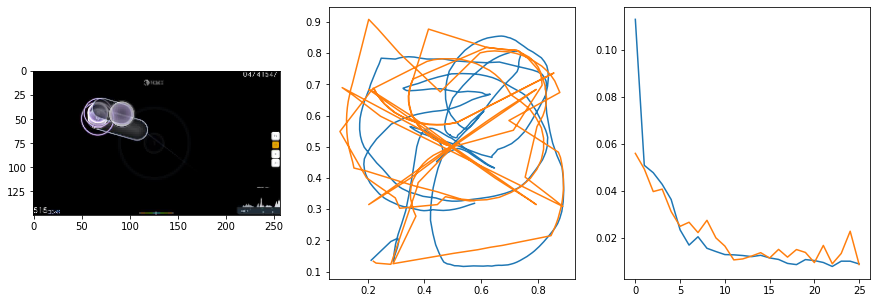

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:18<00:00:00  0.70it/s  0.0069                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

26 of 64
pred: 0.20288053154945374 0.346410870552063
gt: 0.3954866826534271 0.8361017107963562
(109, 115)


<Figure size 1080x360 with 0 Axes>

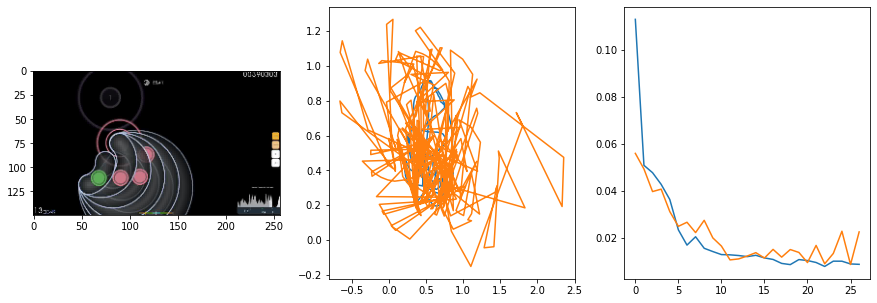

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:17<00:00:00  0.74it/s  0.0101                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

27 of 64
pred: 0.17086419463157654 0.23098577558994293
gt: 0.221730038523674 0.3157326579093933
(82, 54)


<Figure size 1080x360 with 0 Axes>

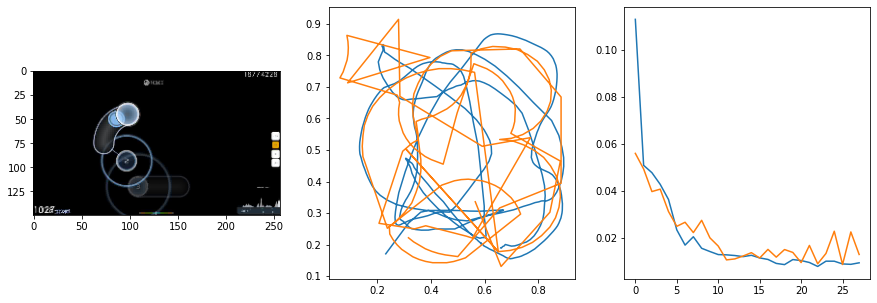

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:17<00:00:00  0.74it/s  0.0131                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

28 of 64
pred: 0.29130247235298157 0.2401845008134842
gt: 0.6995618939399719 0.43045222759246826
(156, 68)


<Figure size 1080x360 with 0 Axes>

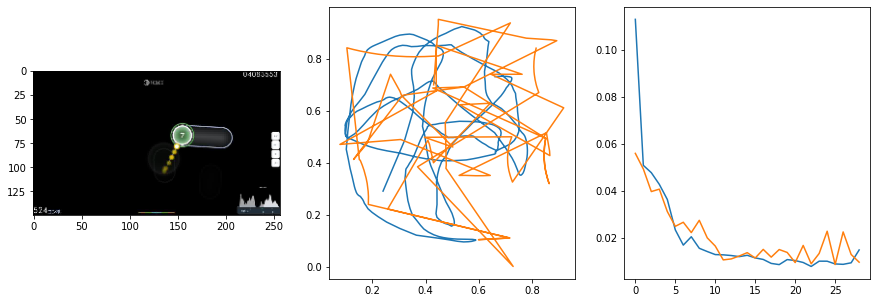

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:18<00:00:00  0.69it/s  0.0100                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

29 of 64
pred: 0.208577498793602 0.20405714213848114
gt: 0.36217889189720154 0.32734689116477966
(104, 56)


<Figure size 1080x360 with 0 Axes>

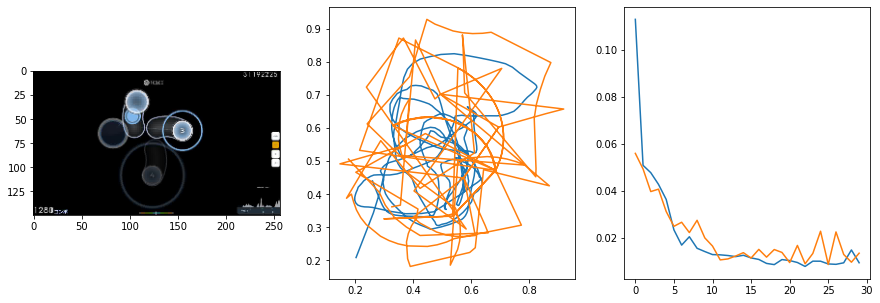

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:18<00:00:00  0.70it/s  0.0077                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

30 of 64
pred: 0.1984339952468872 0.2894974946975708
gt: 0.4957795739173889 0.49324730038642883
(124, 75)


<Figure size 1080x360 with 0 Axes>

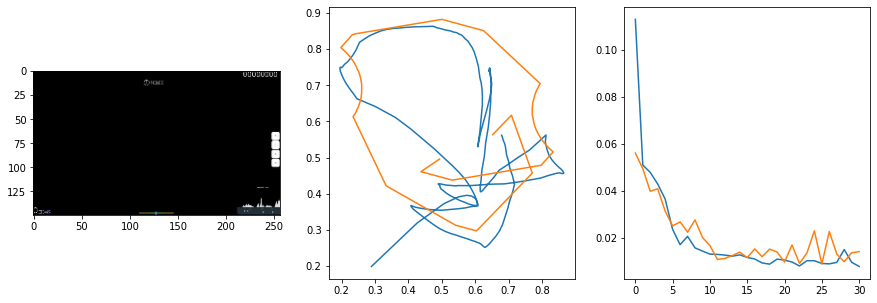

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:18<00:00:00  0.70it/s  0.0036                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

31 of 64
pred: 0.28530043363571167 0.243466317653656
gt: 0.7272499799728394 0.28216665983200073
(160, 50)


<Figure size 1080x360 with 0 Axes>

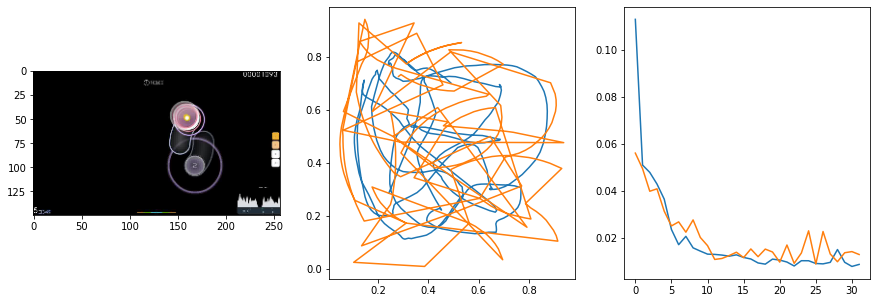

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:17<00:00:00  0.74it/s  0.0059                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

32 of 64
pred: 0.14048784971237183 0.23198306560516357
gt: 0.027982041239738464 0.04224219545722008
(52, 22)


<Figure size 1080x360 with 0 Axes>

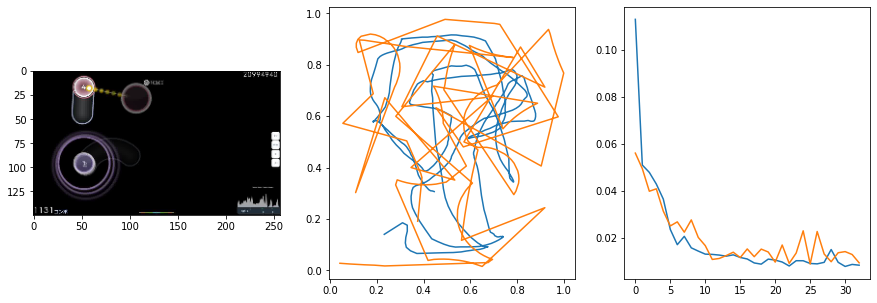

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:18<00:00:00  0.70it/s  0.0078                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

33 of 64
pred: 0.30564555525779724 0.3530954122543335
gt: 0.982421875 0.8411458134651184
(200, 115)


<Figure size 1080x360 with 0 Axes>

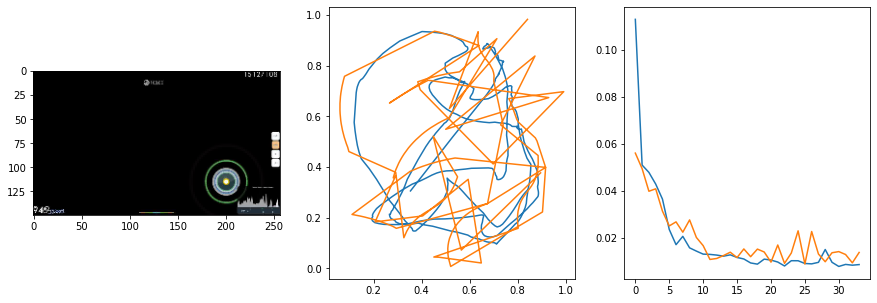

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:18<00:00:00  0.70it/s  0.0055                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

34 of 64
pred: 0.3406193256378174 0.39298170804977417
gt: 0.9378979802131653 0.8367611765861511
(193, 115)


<Figure size 1080x360 with 0 Axes>

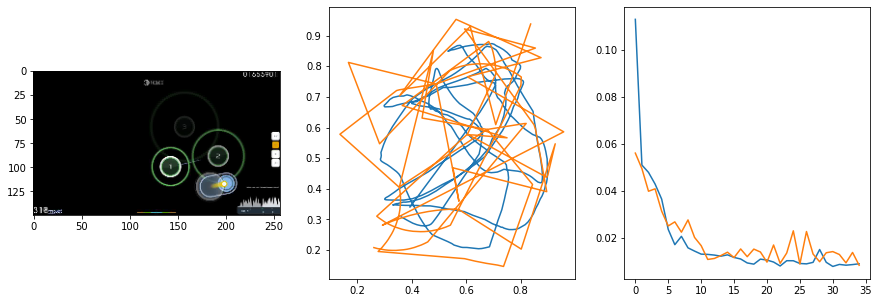

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:18<00:00:00  0.71it/s  0.0085                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

35 of 64
pred: 0.310803085565567 0.30455049872398376
gt: 0.7181655764579773 0.6139306426048279
(159, 89)


<Figure size 1080x360 with 0 Axes>

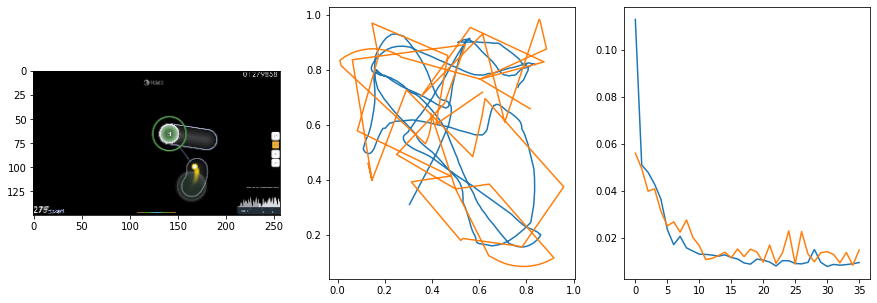

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:18<00:00:00  0.70it/s  0.0111                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

36 of 64
pred: 0.300843209028244 0.27852892875671387
gt: 0.779600203037262 0.34375
(168, 57)


<Figure size 1080x360 with 0 Axes>

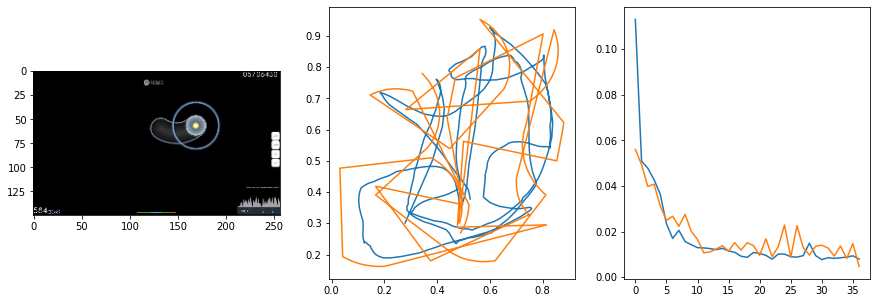

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:18<00:00:00  0.71it/s  0.0036                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

37 of 64
pred: 0.20541831851005554 0.24145078659057617
gt: 0.37919744849205017 0.24496932327747345
(106, 46)


<Figure size 1080x360 with 0 Axes>

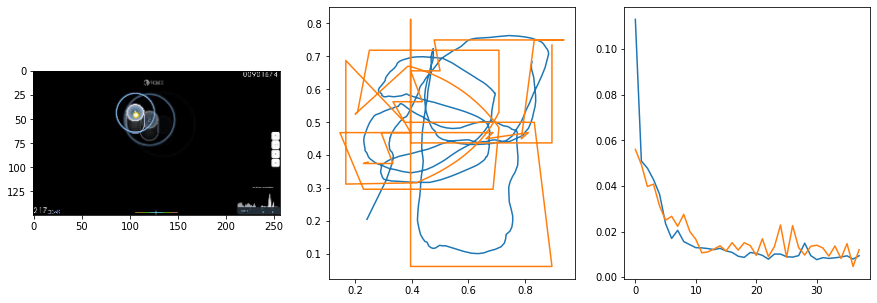

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:18<00:00:00  0.71it/s  0.0068                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

38 of 64
pred: 0.14753669500350952 0.20772330462932587
gt: 0.10688304901123047 0.1795511692762375
(64, 38)


<Figure size 1080x360 with 0 Axes>

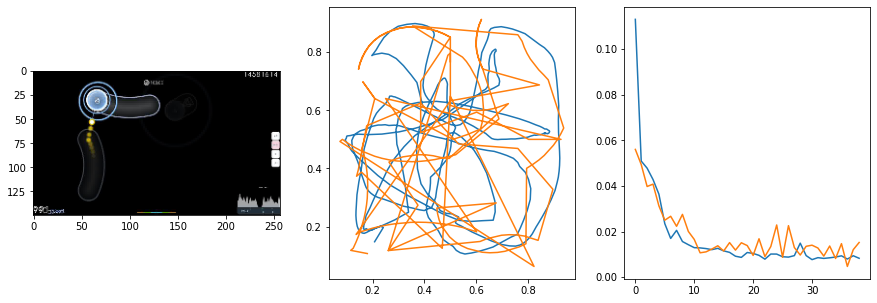

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:18<00:00:00  0.71it/s  0.0095                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

39 of 64
pred: 0.22985318303108215 0.29005366563796997
gt: 0.5 0.5400159955024719
(125, 80)


<Figure size 1080x360 with 0 Axes>

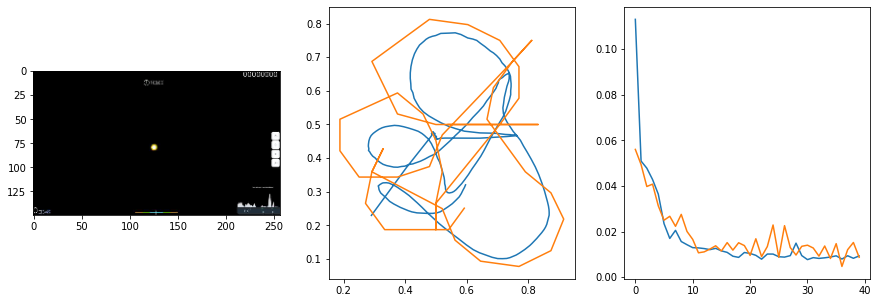

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:18<00:00:00  0.70it/s  0.0088                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

40 of 64
pred: 0.28371483087539673 0.2727278769016266
gt: 0.546875 0.36666667461395264
(132, 60)


<Figure size 1080x360 with 0 Axes>

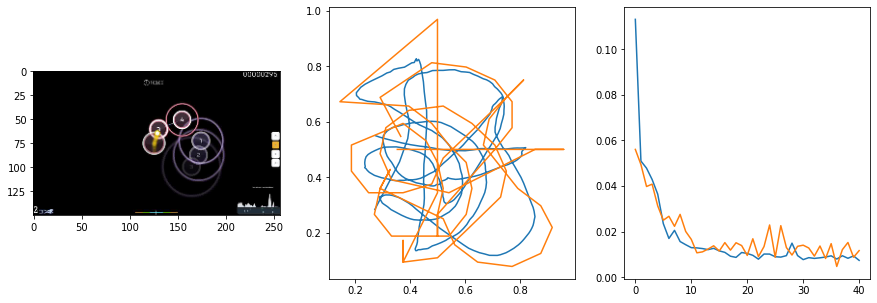

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:17<00:00:00  0.74it/s  0.0088                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

41 of 64
pred: 0.28871652483940125 0.3962332010269165
gt: 0.5181361436843872 0.6716623902320862
(128, 96)


<Figure size 1080x360 with 0 Axes>

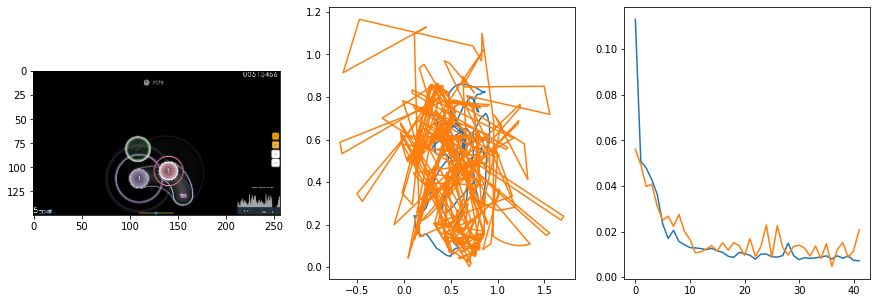

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:18<00:00:00  0.71it/s  0.0045                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

42 of 64
pred: 0.20074889063835144 0.23329493403434753
gt: 0.3639999032020569 0.30188310146331787
(104, 53)


<Figure size 1080x360 with 0 Axes>

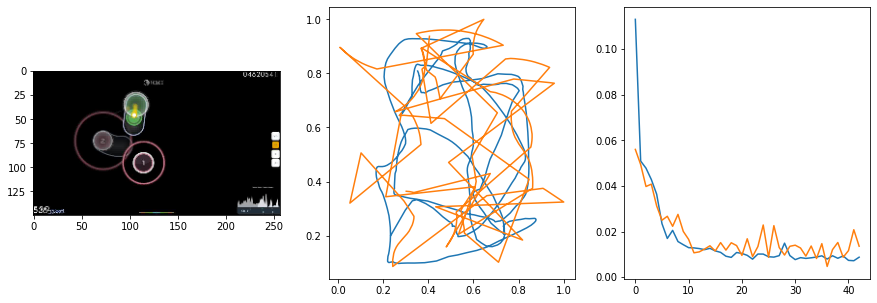

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:18<00:00:00  0.70it/s  0.0111                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

43 of 64
pred: 0.1752707064151764 0.3248085081577301
gt: 0.12960635125637054 0.6878778338432312
(68, 98)


<Figure size 1080x360 with 0 Axes>

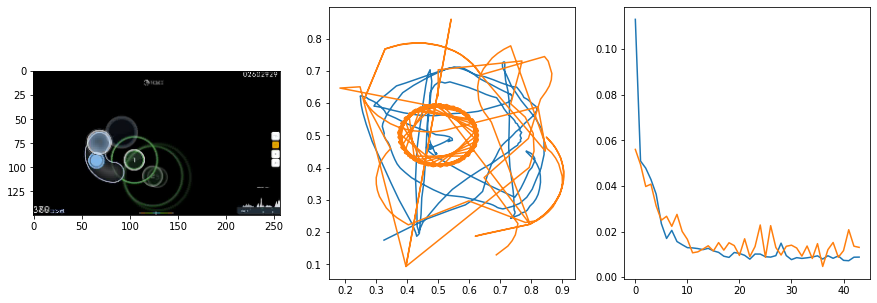

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:18<00:00:00  0.70it/s  0.0019                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

44 of 64
pred: 0.2995930314064026 0.3331656754016876
gt: 0.6010441184043884 0.6282342076301575
(141, 91)


<Figure size 1080x360 with 0 Axes>

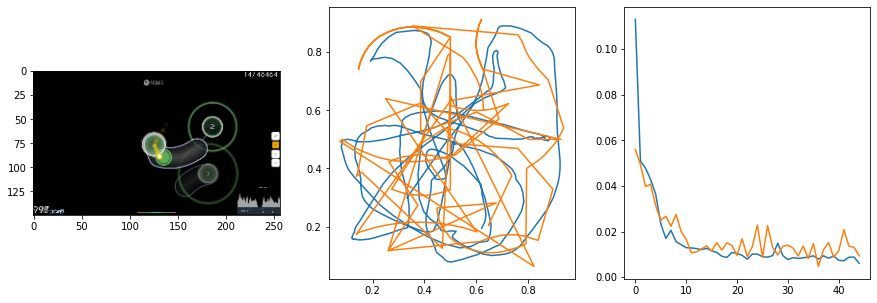

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:18<00:00:00  0.70it/s  0.0092                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

45 of 64
pred: 0.15466898679733276 0.3647841811180115
gt: 0.26361772418022156 0.4037180244922638
(88, 64)


<Figure size 1080x360 with 0 Axes>

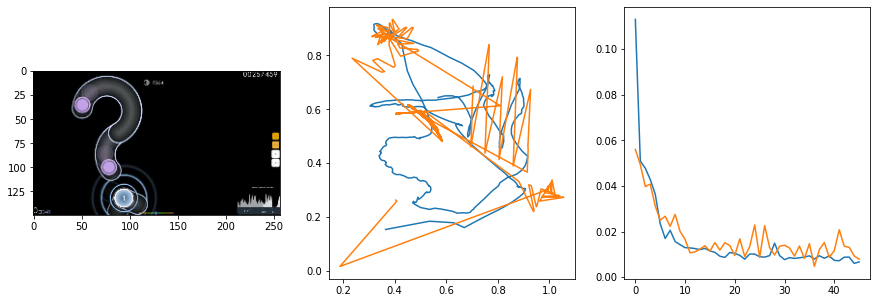

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:18<00:00:00  0.71it/s  0.0072                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

46 of 64
pred: 0.2015089988708496 0.32521992921829224
gt: 0.24686357378959656 0.5919588804244995
(86, 86)


<Figure size 1080x360 with 0 Axes>

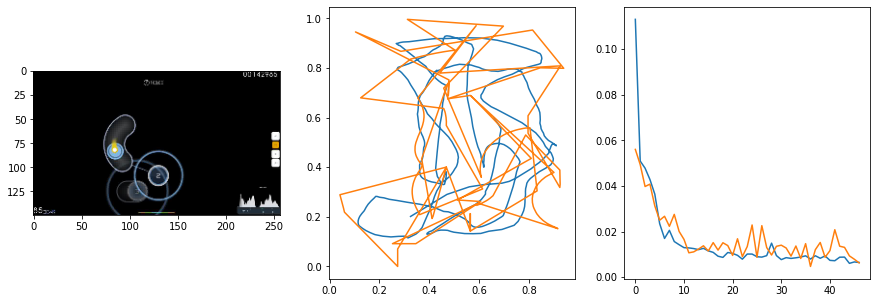

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:17<00:00:00  0.74it/s  0.0059                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

47 of 64
pred: 0.24890407919883728 0.2982080578804016
gt: 0.4024246335029602 0.5052986145019531
(110, 76)


<Figure size 1080x360 with 0 Axes>

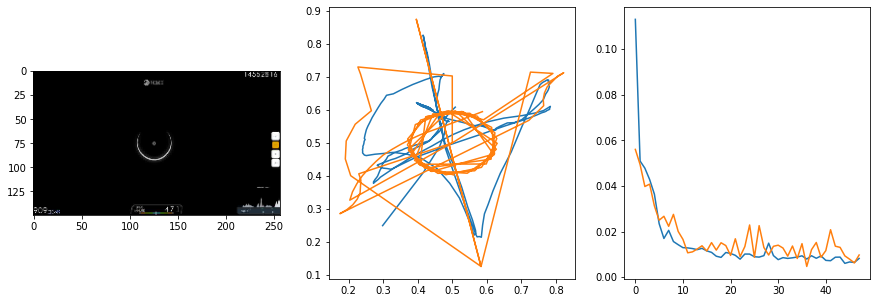

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:18<00:00:00  0.69it/s  0.0057                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

48 of 64
pred: 0.26941025257110596 0.3049026429653168
gt: 0.45915842056274414 0.511344850063324
(119, 77)


<Figure size 1080x360 with 0 Axes>

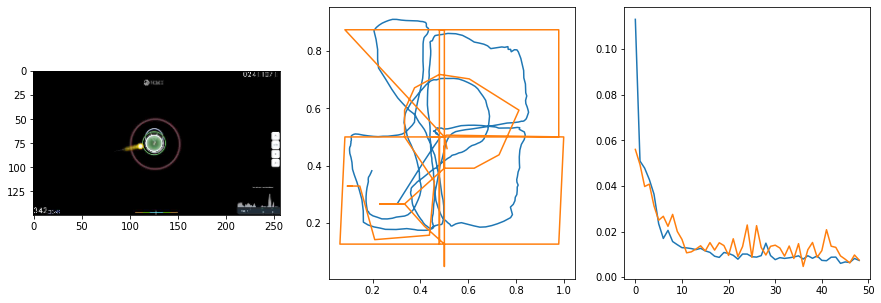

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:18<00:00:00  0.69it/s  0.0107                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

49 of 64
pred: 0.26437002420425415 0.24324128031730652
gt: 0.54204922914505 0.30057960748672485
(132, 52)


<Figure size 1080x360 with 0 Axes>

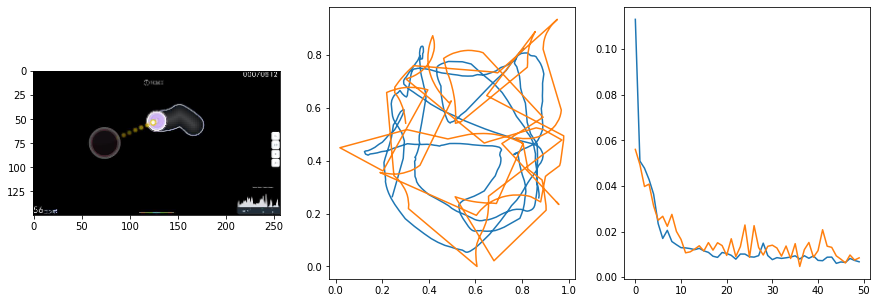

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:18<00:00:00  0.70it/s  0.0037                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

50 of 64
pred: 0.2981237769126892 0.2895142436027527
gt: 0.9591959714889526 0.3500634729862213
(196, 58)


<Figure size 1080x360 with 0 Axes>

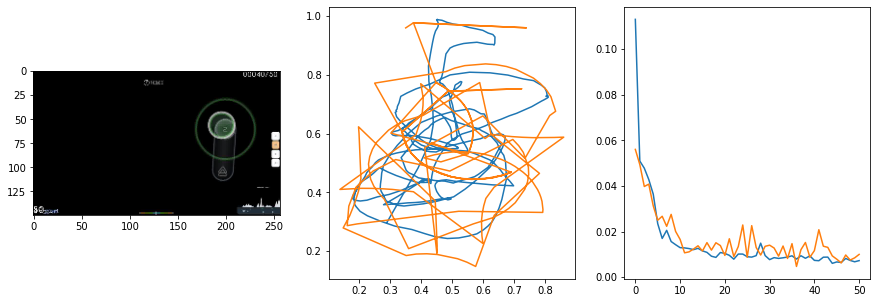

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:18<00:00:00  0.70it/s  0.0068                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

51 of 64
pred: 0.31667017936706543 0.3050517737865448
gt: 0.9714264869689941 0.48532935976982117
(198, 74)


<Figure size 1080x360 with 0 Axes>

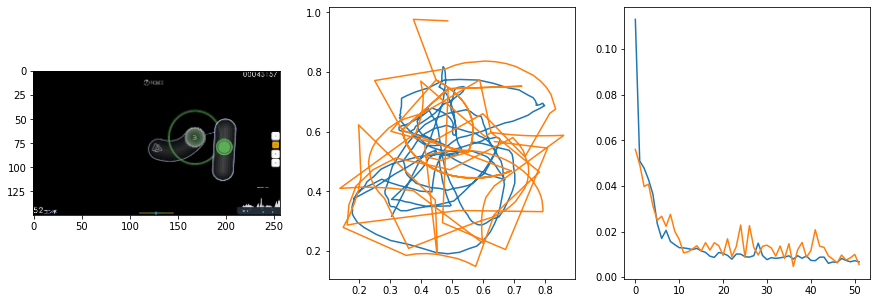

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:18<00:00:00  0.70it/s  0.0069                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

52 of 64
pred: 0.20070111751556396 0.27040672302246094
gt: 0.2491714060306549 0.3534564673900604
(86, 59)


<Figure size 1080x360 with 0 Axes>

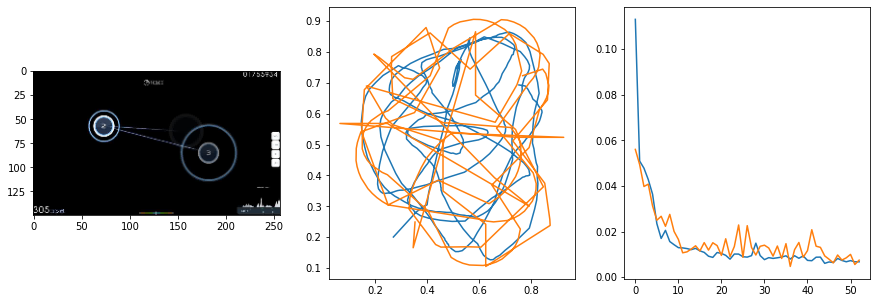

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:18<00:00:00  0.70it/s  0.0096                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

53 of 64
pred: 0.30366650223731995 0.231020987033844
gt: 0.537109375 0.2942708432674408
(131, 52)


<Figure size 1080x360 with 0 Axes>

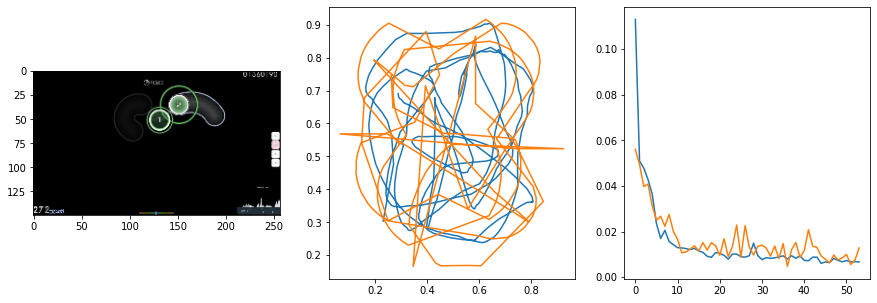

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:18<00:00:00  0.69it/s  0.0043                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

54 of 64
pred: 0.25211101770401 0.24623623490333557
gt: 0.4242314100265503 0.19806139171123505
(113, 41)


<Figure size 1080x360 with 0 Axes>

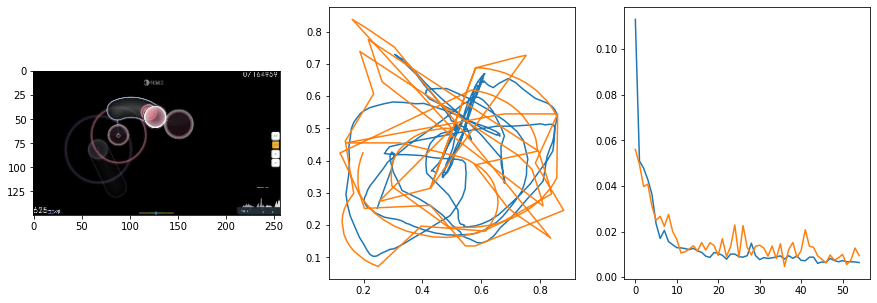

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:18<00:00:00  0.69it/s  0.0029                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

55 of 64
pred: 0.2405501753091812 0.32695966958999634
gt: 0.3671875 0.59375
(104, 87)


<Figure size 1080x360 with 0 Axes>

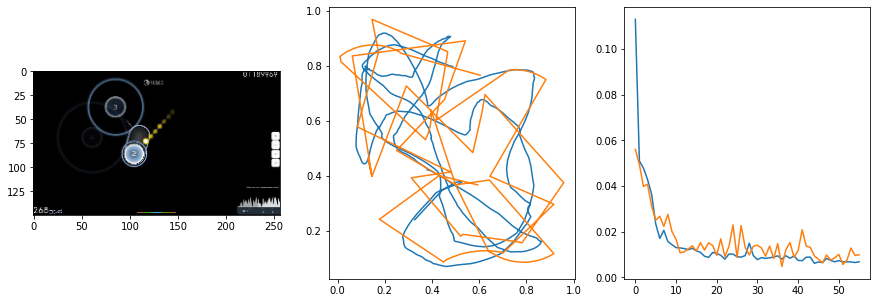

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:17<00:00:00  0.73it/s  0.0080                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

56 of 64
pred: 0.277986079454422 0.3732330799102783
gt: 0.46875 0.6666666865348816
(120, 95)


<Figure size 1080x360 with 0 Axes>

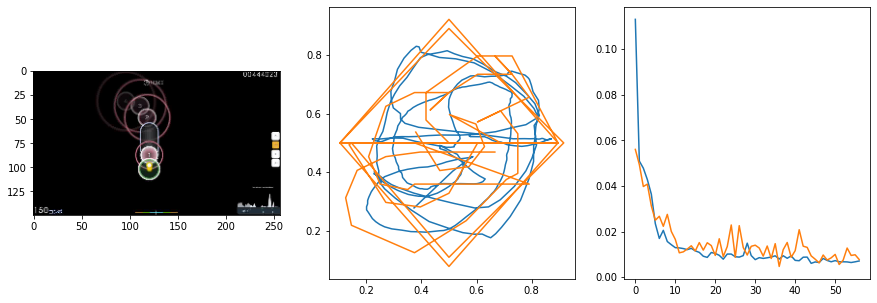

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:18<00:00:00  0.71it/s  0.0045                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

57 of 64
pred: 0.3256767690181732 0.45930880308151245
gt: 0.5669001340866089 0.9416307806968689
(135, 127)


<Figure size 1080x360 with 0 Axes>

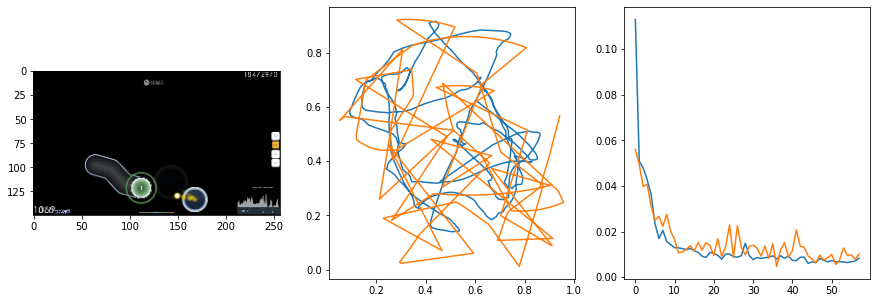

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:18<00:00:00  0.69it/s  0.0083                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

58 of 64
pred: 0.2901992201805115 0.2767888307571411
gt: 0.5184659361839294 0.35353532433509827
(128, 59)


<Figure size 1080x360 with 0 Axes>

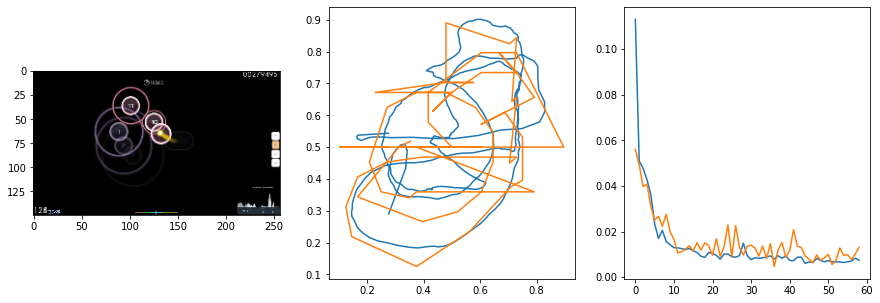

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:18<00:00:00  0.69it/s  0.0036                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

59 of 64
pred: 0.2771299183368683 0.3213585913181305
gt: 0.45842087268829346 0.4722805917263031
(119, 72)


<Figure size 1080x360 with 0 Axes>

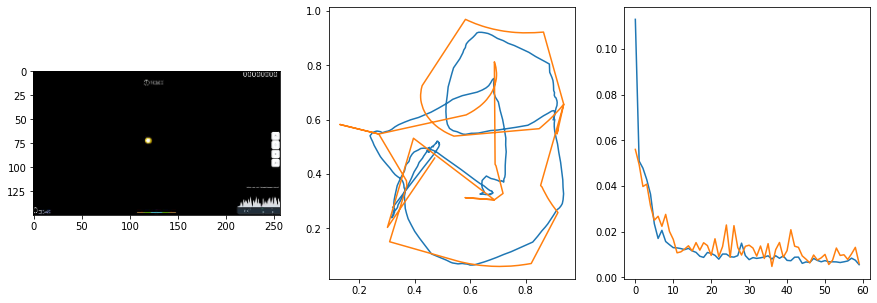

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:18<00:00:00  0.70it/s  0.0039                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

60 of 64
pred: 0.2680445909500122 0.3494075536727905
gt: 0.5789449214935303 0.6134019494056702
(137, 89)


<Figure size 1080x360 with 0 Axes>

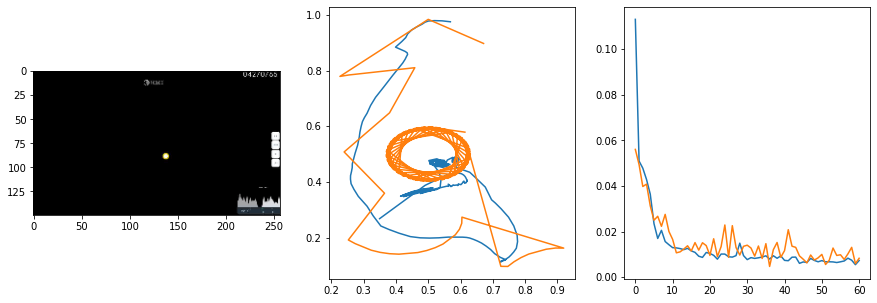

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:18<00:00:00  0.70it/s  0.0061                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

61 of 64
pred: 0.1953681856393814 0.20804576575756073
gt: 0.109375 0.2291666716337204
(64, 44)


<Figure size 1080x360 with 0 Axes>

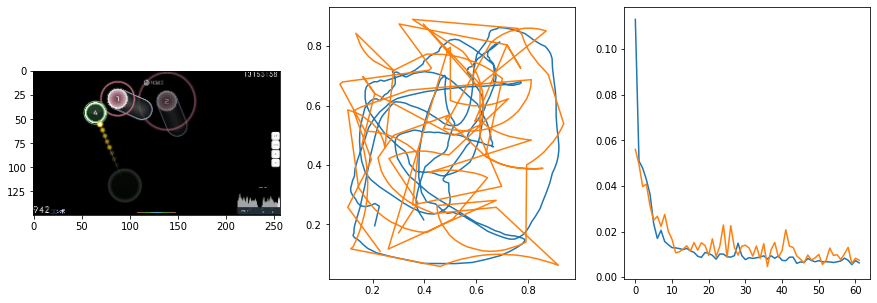

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:18<00:00:00  0.70it/s  0.0059                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

62 of 64
pred: 0.16529580950737 0.43209731578826904
gt: 0.226606085896492 0.7610117793083191
(83, 106)


<Figure size 1080x360 with 0 Axes>

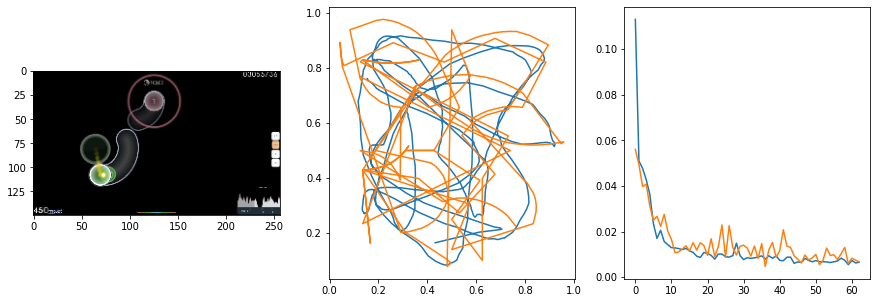

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:18<00:00:00  0.70it/s  0.0054                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

63 of 64
pred: 0.23245814442634583 0.31654852628707886
gt: 0.35499998927116394 0.36916664242744446
(103, 60)


<Figure size 1080x360 with 0 Axes>

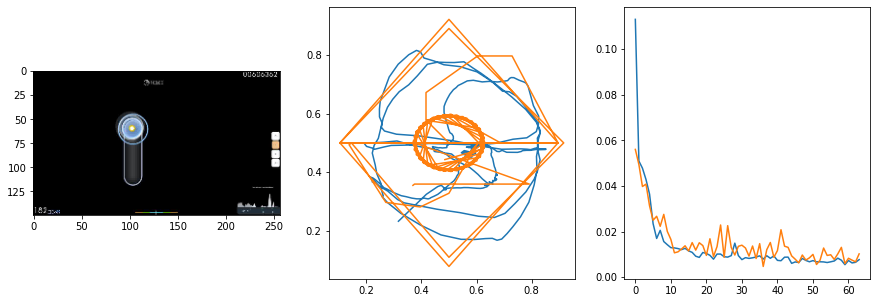

1549.1537792682648 secs


In [ ]:
start = time.time()

epochs = 64
trainVN()

end = time.time()
print(end - start, 'secs')

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.67it/s  0.0041                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

64 of 128
pred: 0.3088185489177704 0.2995181679725647
gt: -0.5151781439781189 -0.4966548979282379
(-31, -39)


<Figure size 1080x360 with 0 Axes>

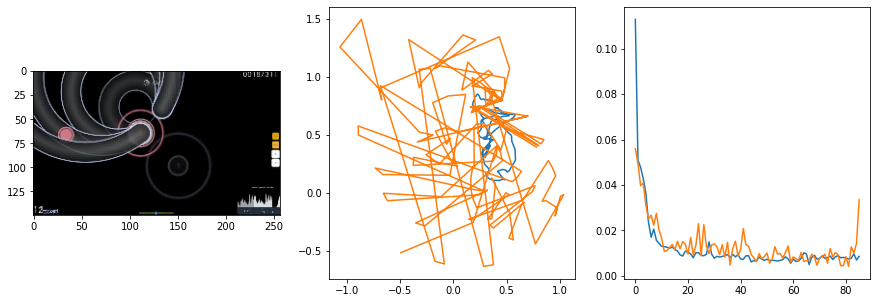

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.70it/s  0.0194                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

65 of 128
pred: 0.2999785840511322 0.29284435510635376
gt: 0.3662327826023102 0.26078128814697266
(104, 48)


<Figure size 1080x360 with 0 Axes>

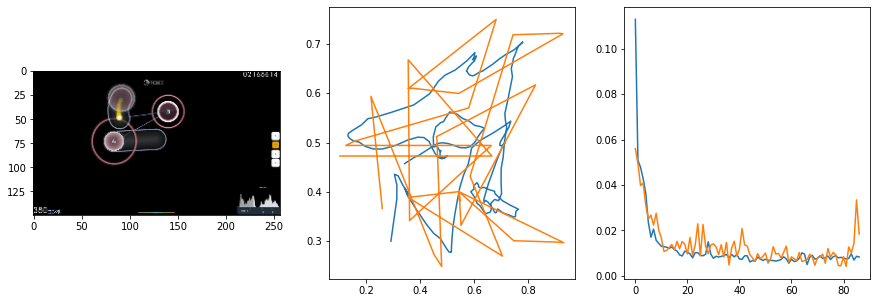

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.73it/s  0.0073                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

66 of 128
pred: 0.29048895835876465 0.33460819721221924
gt: 0.8011220693588257 0.22529220581054688
(172, 44)


<Figure size 1080x360 with 0 Axes>

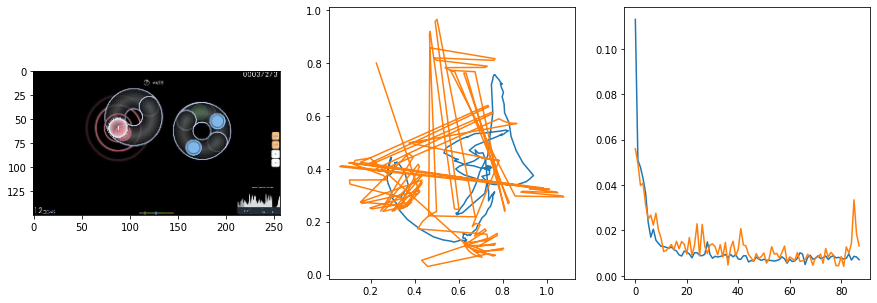

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.74it/s  0.0054                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

67 of 128
pred: 0.39961832761764526 0.38673675060272217
gt: 0.8102021813392639 0.41924893856048584
(173, 66)


<Figure size 1080x360 with 0 Axes>

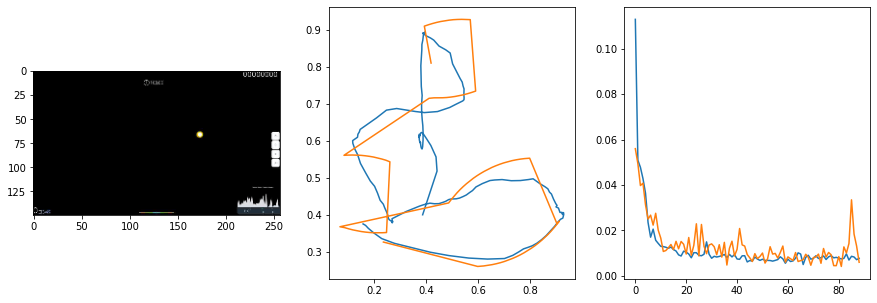

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.74it/s  0.0105                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

68 of 128
pred: 0.4892868995666504 0.482524037361145
gt: 0.5807291865348816 0.7135416865348816
(138, 100)


<Figure size 1080x360 with 0 Axes>

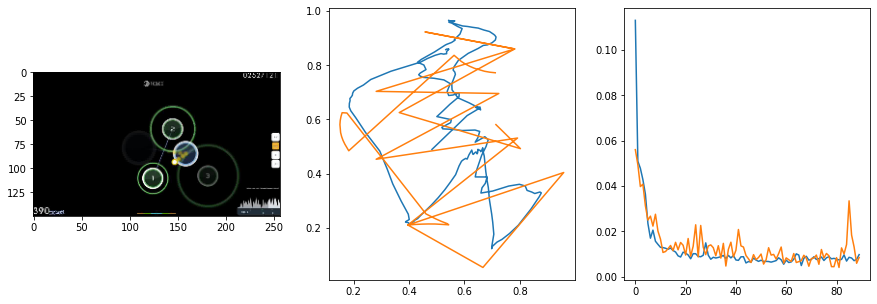

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.72it/s  0.0089                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

69 of 128
pred: 0.3935817778110504 0.41840022802352905
gt: 0.5726581811904907 0.6515035629272461
(136, 93)


<Figure size 1080x360 with 0 Axes>

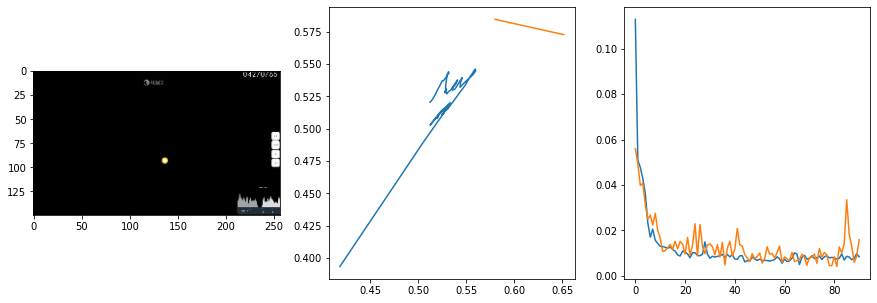

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.67it/s  0.0046                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

70 of 128
pred: 0.5555711984634399 0.3478422164916992
gt: 0.755859375 0.4036458432674408
(165, 64)


<Figure size 1080x360 with 0 Axes>

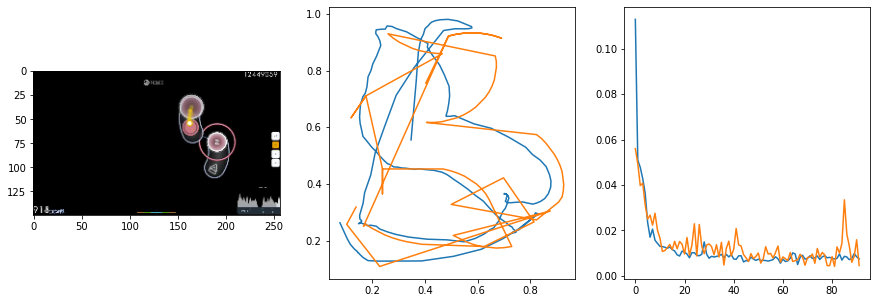

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.66it/s  0.0109                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

71 of 128
pred: 0.400679349899292 0.33791613578796387
gt: 0.37771740555763245 0.39598652720451355
(106, 64)


<Figure size 1080x360 with 0 Axes>

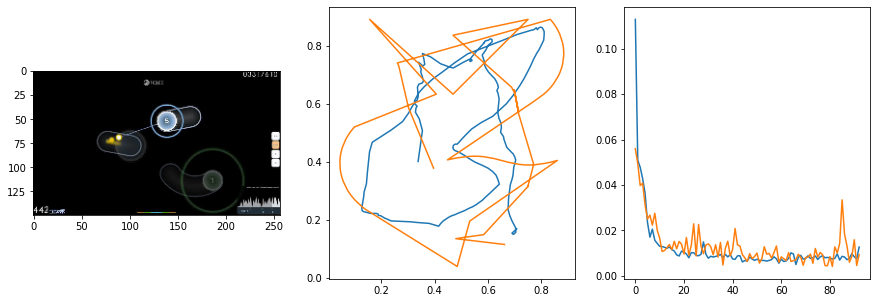

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.71it/s  0.0060                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

72 of 128
pred: 0.33146703243255615 0.2593434453010559
gt: 0.7328763604164124 0.40033718943595886
(161, 64)


<Figure size 1080x360 with 0 Axes>

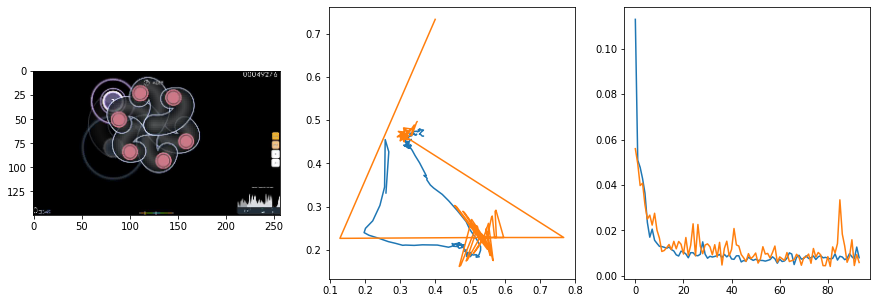

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.71it/s  0.0077                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

73 of 128
pred: 0.5537045001983643 0.33747148513793945
gt: 0.749602735042572 0.3792742192745209
(164, 62)


<Figure size 1080x360 with 0 Axes>

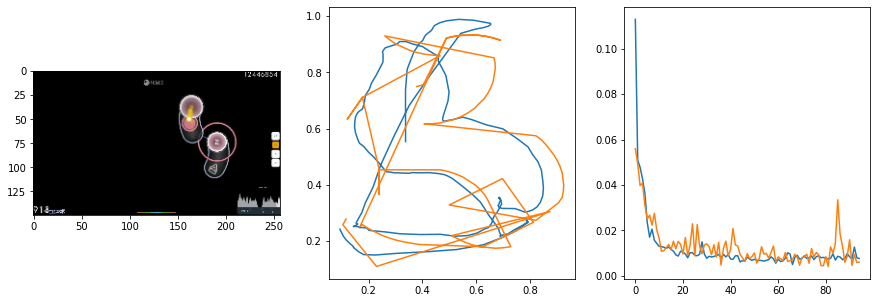

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.73it/s  0.0054                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

74 of 128
pred: 0.29141533374786377 0.6080482006072998
gt: 0.15346534550189972 0.882838249206543
(71, 120)


<Figure size 1080x360 with 0 Axes>

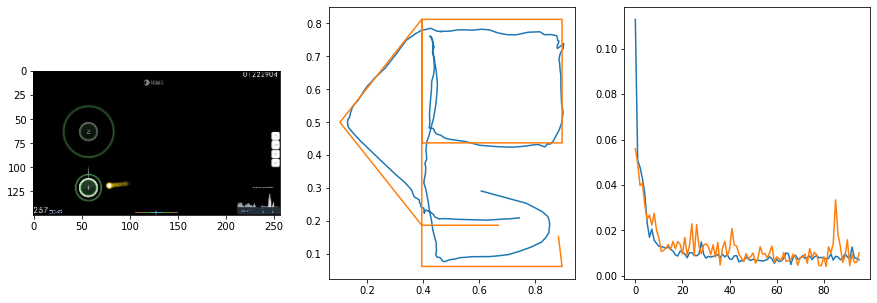

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.65it/s  0.0176                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

75 of 128
pred: 0.6416997909545898 0.5229389071464539
gt: 0.6654974222183228 0.7211415767669678
(151, 101)


<Figure size 1080x360 with 0 Axes>

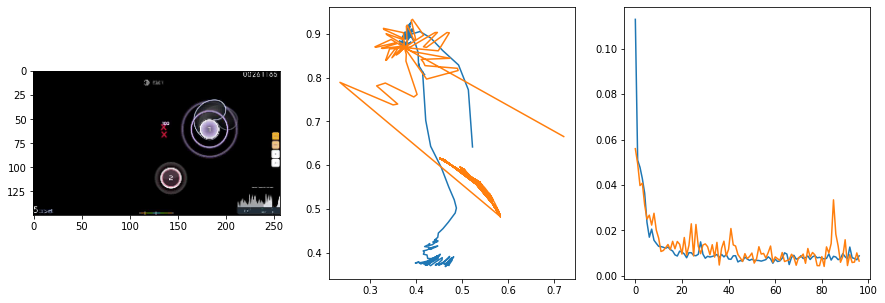

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.70it/s  0.0148                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

76 of 128
pred: 0.2950674295425415 0.5117974877357483
gt: 0.2666778266429901 0.5698282718658447
(89, 84)


<Figure size 1080x360 with 0 Axes>

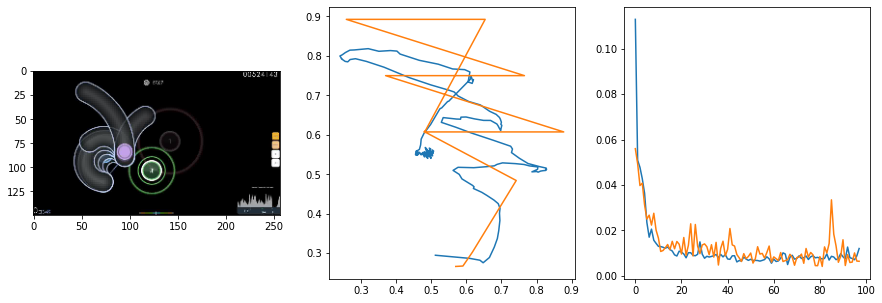

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.64it/s  0.0120                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

77 of 128
pred: 0.37662678956985474 0.3362846076488495
gt: 0.4935624897480011 0.3645833432674408
(124, 60)


<Figure size 1080x360 with 0 Axes>

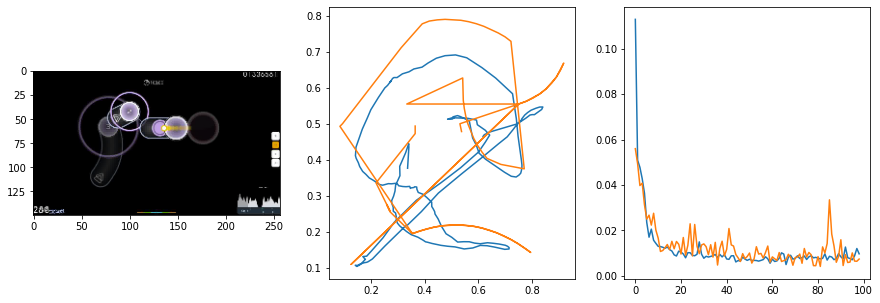

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.66it/s  0.0077                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

78 of 128
pred: 0.553575873374939 0.3341295123100281
gt: 0.87890625 0.2786458432674408
(184, 50)


<Figure size 1080x360 with 0 Axes>

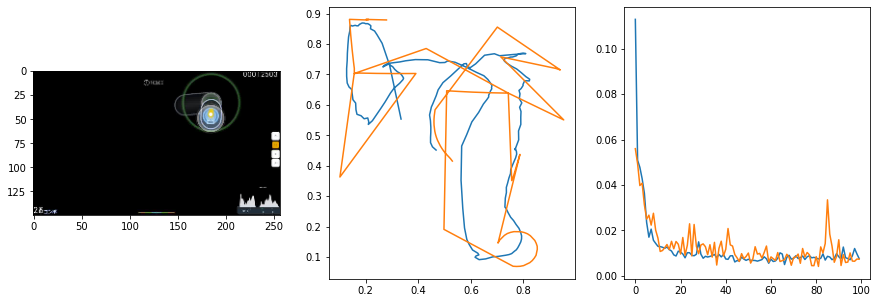

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.70it/s  0.0042                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

79 of 128
pred: 0.5668043494224548 0.5495009422302246
gt: 0.7947472333908081 0.6768504977226257
(171, 96)


<Figure size 1080x360 with 0 Axes>

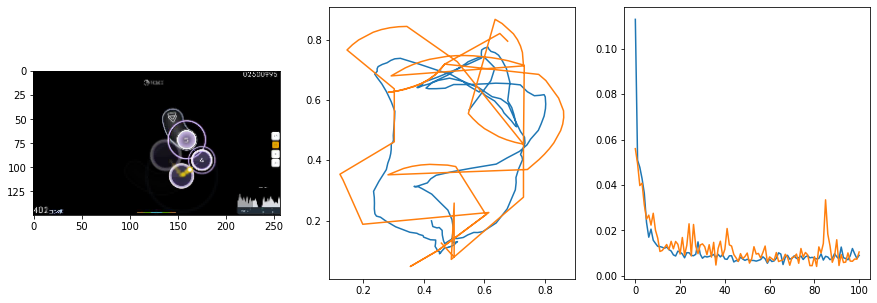

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.73it/s  0.0079                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

80 of 128
pred: 0.4704394042491913 0.4156833291053772
gt: 0.7937101125717163 0.5663608908653259
(171, 83)


<Figure size 1080x360 with 0 Axes>

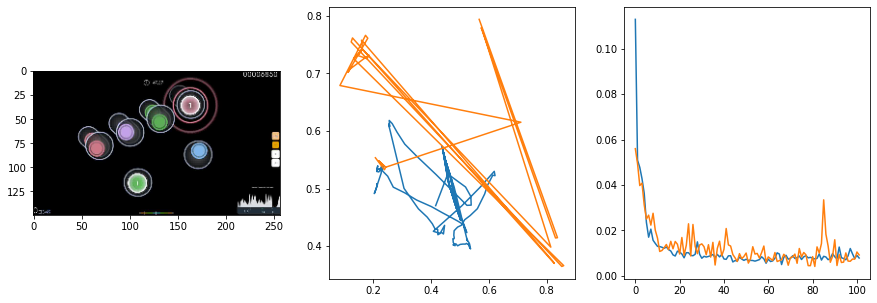

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.72it/s  0.0112                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

81 of 128
pred: 0.4215642511844635 0.40035390853881836
gt: 0.46875 0.41726765036582947
(120, 66)


<Figure size 1080x360 with 0 Axes>

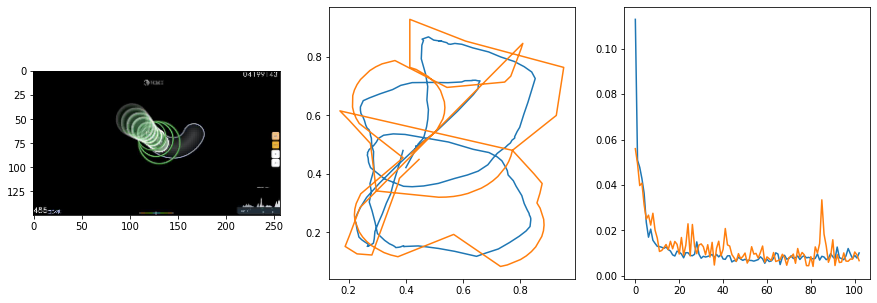

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.71it/s  0.0084                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

82 of 128
pred: 0.4847647547721863 0.630481481552124
gt: 0.691804826259613 0.8107993006706238
(155, 112)


<Figure size 1080x360 with 0 Axes>

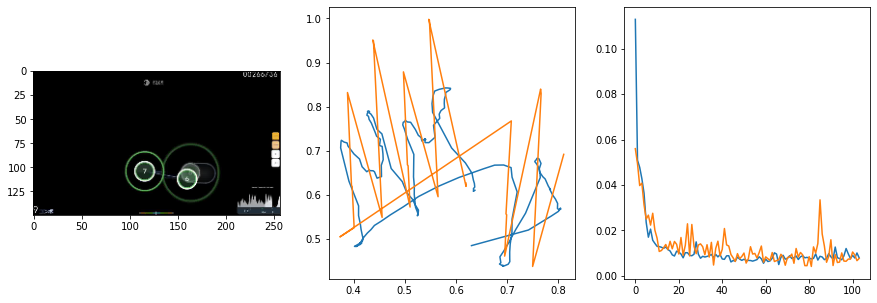

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.72it/s  0.0052                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

83 of 128
pred: 0.5337754487991333 0.4620088040828705
gt: 0.7612393498420715 1.2460300922393799
(166, 162)


<Figure size 1080x360 with 0 Axes>

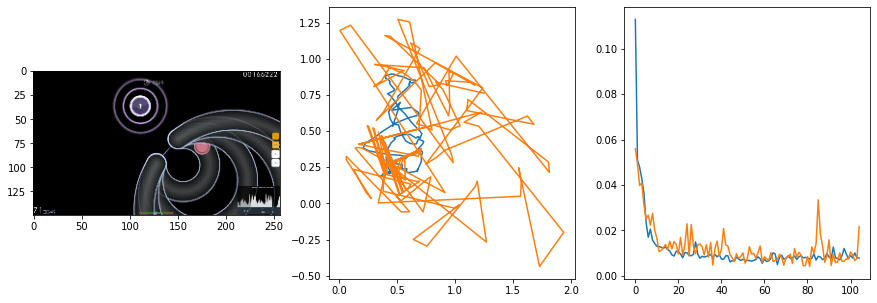

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.73it/s  0.0143                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

84 of 128
pred: 0.37253767251968384 0.4096629321575165
gt: 0.441101610660553 0.33178040385246277
(116, 56)


<Figure size 1080x360 with 0 Axes>

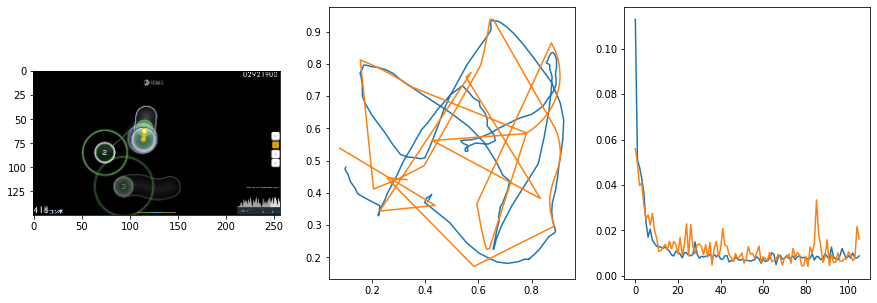

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.75it/s  0.0081                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

85 of 128
pred: 0.604136049747467 0.5170837044715881
gt: 0.899756133556366 0.7642216086387634
(187, 106)


<Figure size 1080x360 with 0 Axes>

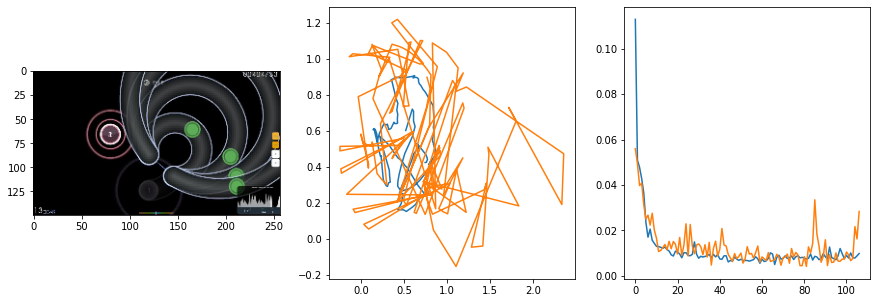

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.74it/s  0.0037                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

86 of 128
pred: 0.5299389958381653 0.4445250630378723
gt: 0.6293332576751709 0.3107118606567383
(145, 54)


<Figure size 1080x360 with 0 Axes>

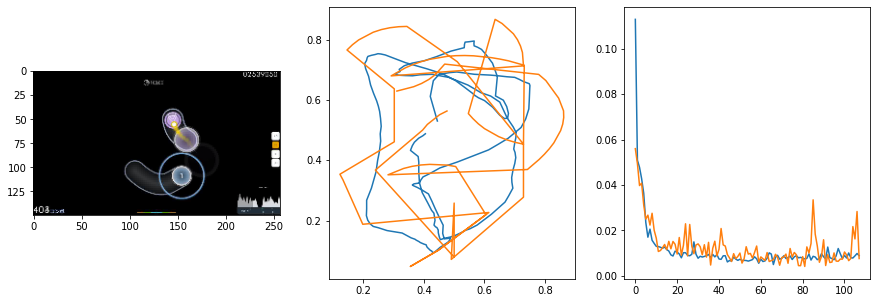

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.75it/s  0.0050                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

87 of 128
pred: 0.34577545523643494 0.5745339393615723
gt: 0.3272031843662262 0.75
(98, 105)


<Figure size 1080x360 with 0 Axes>

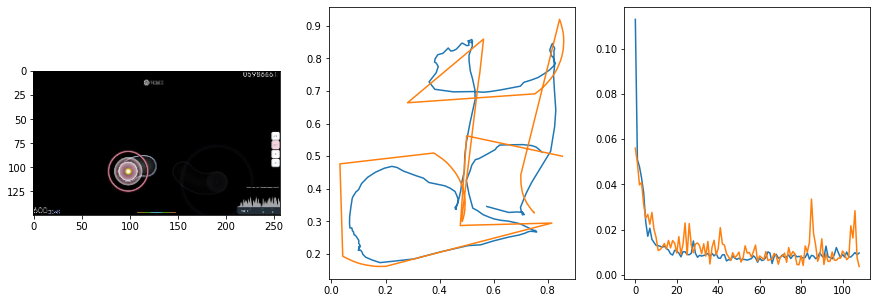

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.76it/s  0.0039                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

88 of 128
pred: 0.3325642943382263 0.3462279438972473
gt: 0.6061691045761108 0.17500048875808716
(142, 38)


<Figure size 1080x360 with 0 Axes>

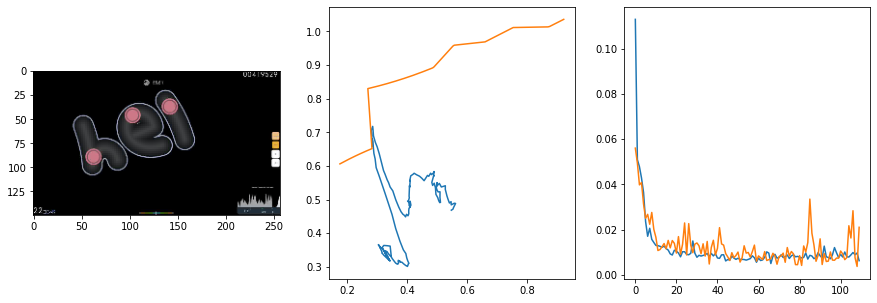

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.74it/s  0.0066                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

89 of 128
pred: 0.21998485922813416 0.29827621579170227
gt: 0.16085714101791382 0.23530952632427216
(72, 45)


<Figure size 1080x360 with 0 Axes>

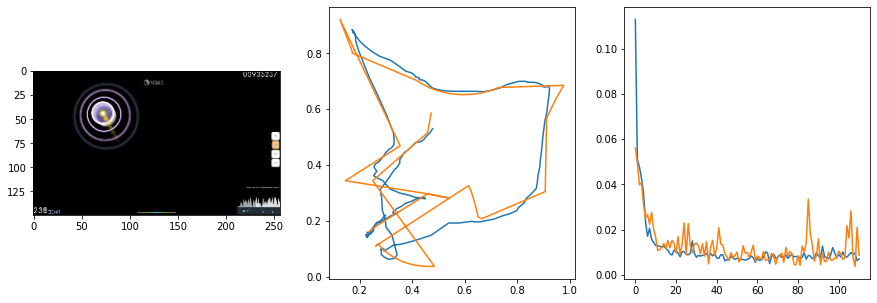

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.77it/s  0.0047                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

90 of 128
pred: 0.4687812030315399 0.5393009781837463
gt: 0.4329525828361511 0.663520097732544
(115, 95)


<Figure size 1080x360 with 0 Axes>

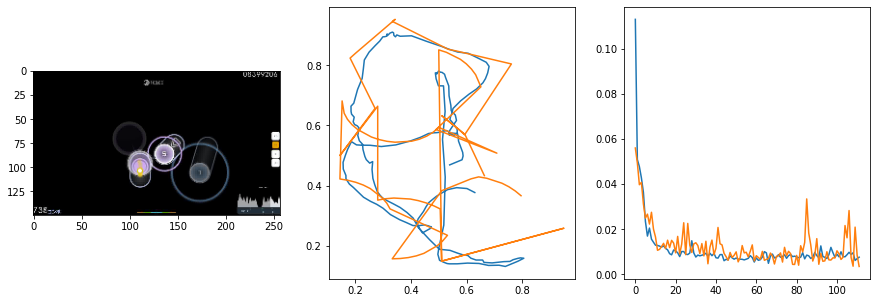

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.75it/s  0.0142                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

91 of 128
pred: 0.5223985314369202 0.33810824155807495
gt: 0.699999988079071 0.24583333730697632
(156, 46)


<Figure size 1080x360 with 0 Axes>

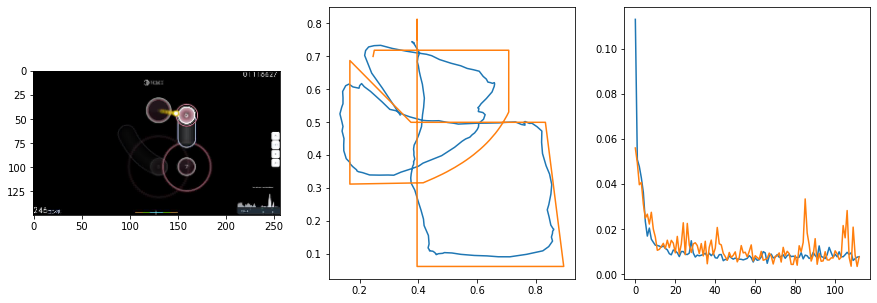

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.74it/s  0.0059                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

92 of 128
pred: 0.7548606991767883 0.6518042087554932
gt: 0.925218403339386 0.7223991751670837
(191, 102)


<Figure size 1080x360 with 0 Axes>

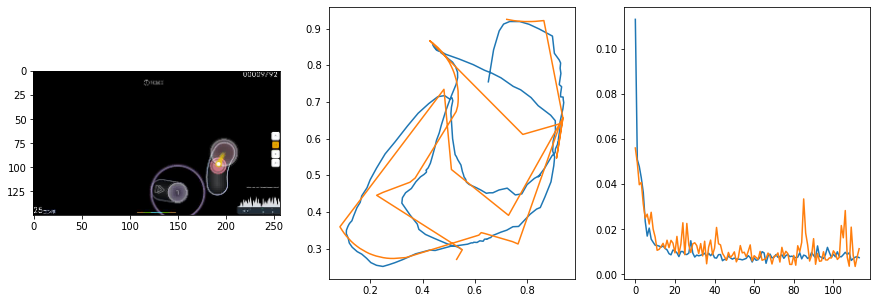

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.66it/s  0.0047                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

93 of 128
pred: 0.5490288734436035 0.45296597480773926
gt: 0.61998051404953 0.3969794809818268
(144, 64)


<Figure size 1080x360 with 0 Axes>

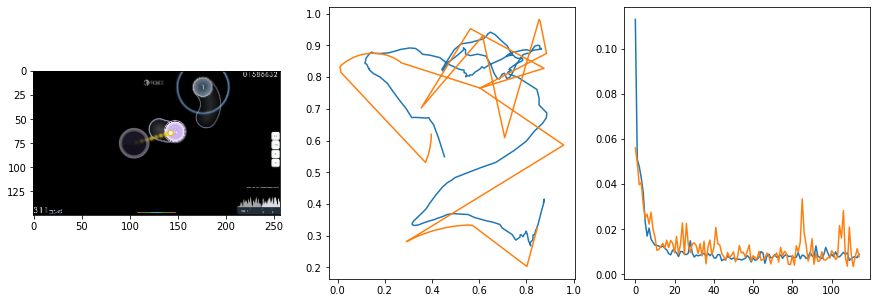

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.71it/s  0.0127                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

94 of 128
pred: 0.3214337229728699 0.6540124416351318
gt: 0.27027904987335205 0.7949067950248718
(89, 110)


<Figure size 1080x360 with 0 Axes>

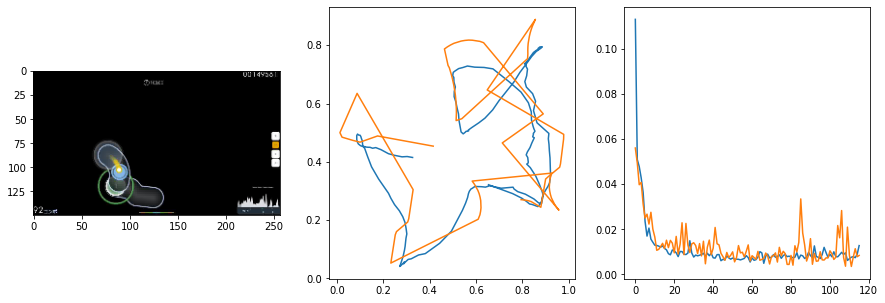

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.67it/s  0.0135                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

95 of 128
pred: 0.3544684648513794 0.4187653660774231
gt: 0.40236714482307434 0.4296407401561737
(110, 67)


<Figure size 1080x360 with 0 Axes>

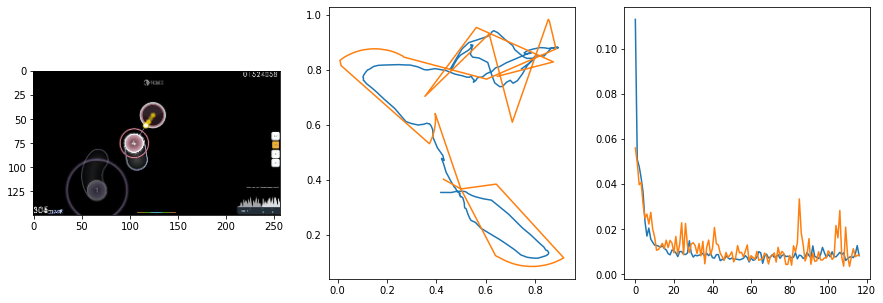

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.71it/s  0.0162                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

96 of 128
pred: 0.6455230712890625 0.7878626585006714
gt: 0.5350638031959534 0.9462161660194397
(130, 128)


<Figure size 1080x360 with 0 Axes>

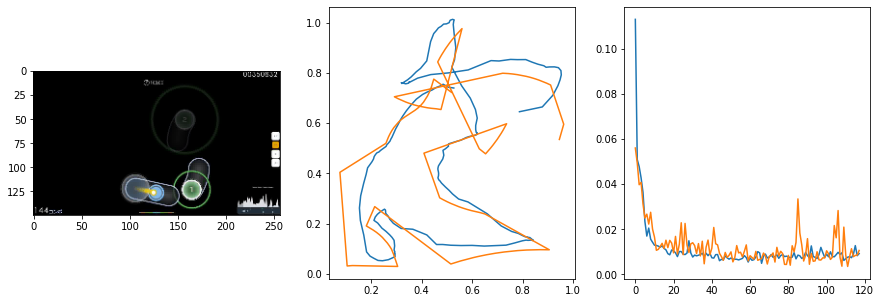

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.71it/s  0.0070                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

97 of 128
pred: 0.4523168206214905 0.4926234483718872
gt: 0.6939338445663452 0.5
(155, 76)


<Figure size 1080x360 with 0 Axes>

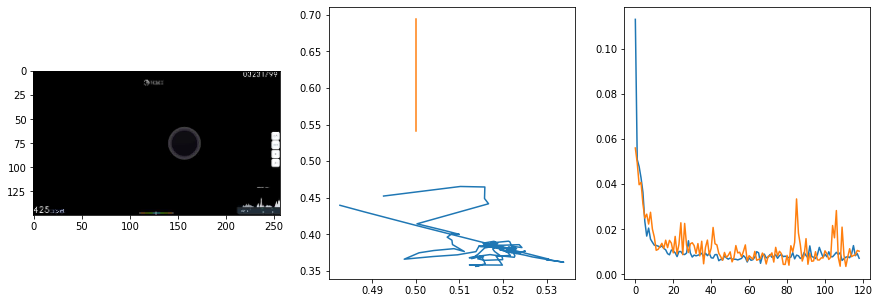

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.71it/s  0.0066                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

98 of 128
pred: 0.4691118597984314 0.46814846992492676
gt: 0.4636884331703186 0.6208724975585938
(119, 90)


<Figure size 1080x360 with 0 Axes>

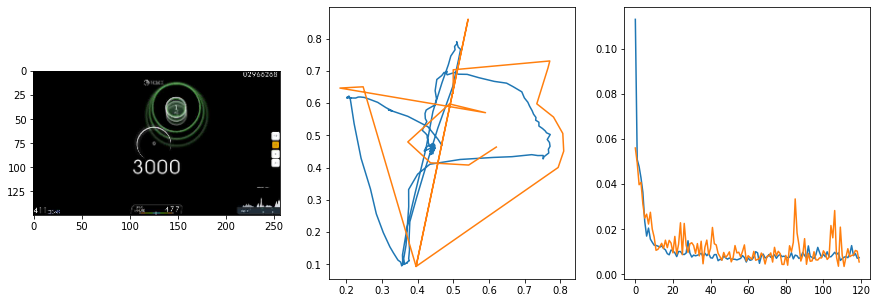

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.70it/s  0.0185                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

99 of 128
pred: 0.40026605129241943 0.3779125213623047
gt: 0.48750001192092896 0.3375000059604645
(123, 57)


<Figure size 1080x360 with 0 Axes>

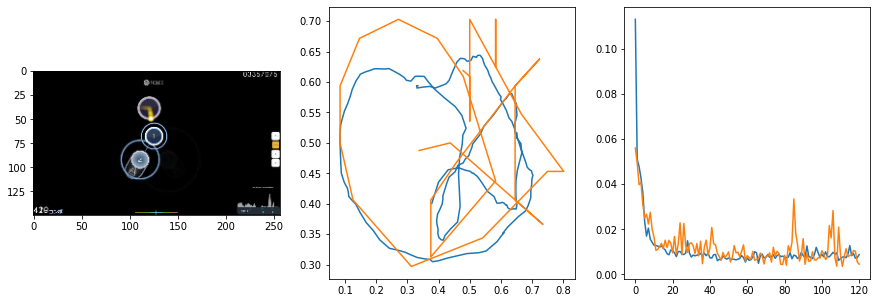

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.71it/s  0.0089                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

100 of 128
pred: 0.34905052185058594 0.4935001730918884
gt: 0.32976973056793213 0.5087719559669495
(99, 77)


<Figure size 1080x360 with 0 Axes>

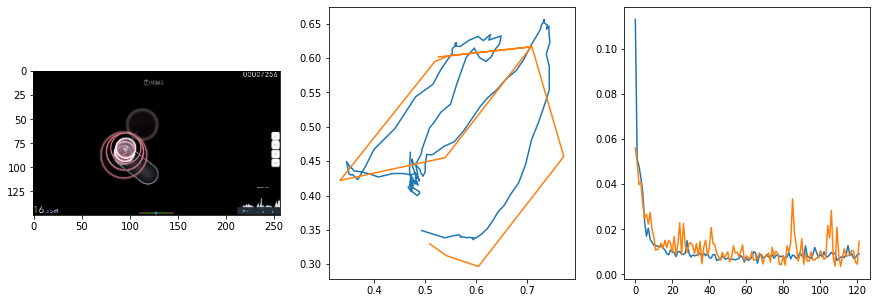

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.67it/s  0.0077                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

101 of 128
pred: 0.6053230166435242 0.46250492334365845
gt: 0.623046875 0.375
(144, 61)


<Figure size 1080x360 with 0 Axes>

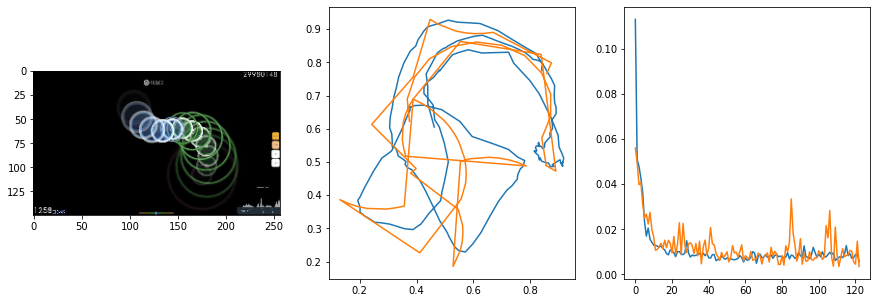

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.72it/s  0.0033                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

102 of 128
pred: 0.38877370953559875 0.328022837638855
gt: 0.4060329794883728 0.39265045523643494
(110, 63)


<Figure size 1080x360 with 0 Axes>

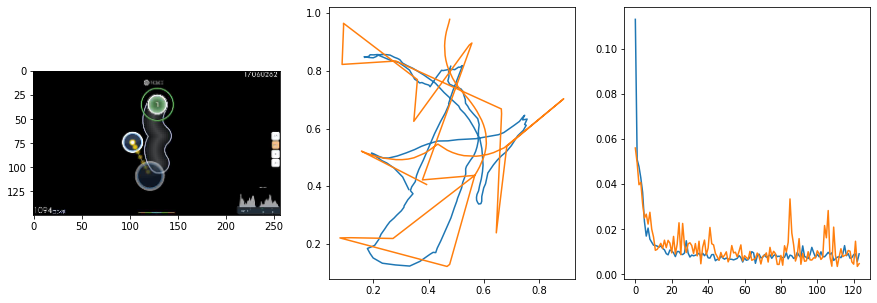

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.71it/s  0.0066                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

103 of 128
pred: 0.688096284866333 0.6913229823112488
gt: 0.6439828872680664 0.8571816086769104
(147, 117)


<Figure size 1080x360 with 0 Axes>

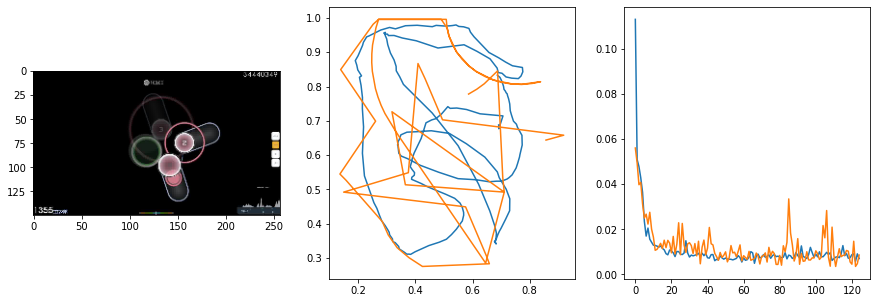

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.69it/s  0.0033                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

104 of 128
pred: 0.34049317240715027 0.5802761912345886
gt: 0.2578125 0.7265625
(87, 102)


<Figure size 1080x360 with 0 Axes>

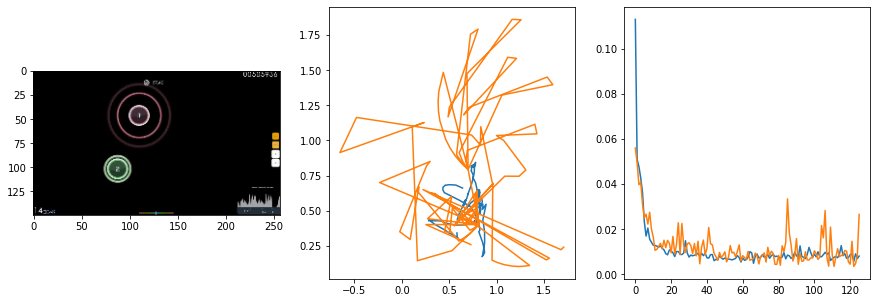

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.68it/s  0.0036                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

105 of 128
pred: 0.5886253118515015 0.5331018567085266
gt: 0.529739260673523 0.5871595740318298
(130, 86)


<Figure size 1080x360 with 0 Axes>

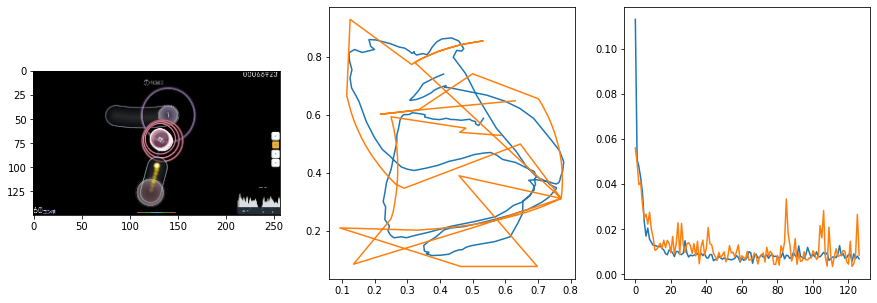

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.68it/s  0.0092                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

106 of 128
pred: 0.577949047088623 0.5575728416442871
gt: 0.5625 0.5989583134651184
(135, 87)


<Figure size 1080x360 with 0 Axes>

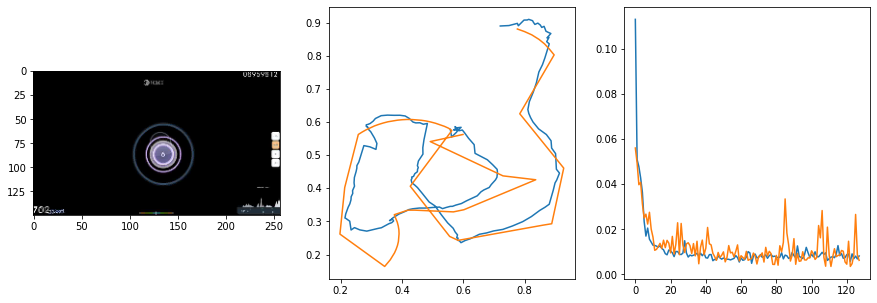

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.69it/s  0.0080                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

107 of 128
pred: 0.7130699753761292 0.5338837504386902
gt: 0.8803048133850098 0.5918056964874268
(184, 86)


<Figure size 1080x360 with 0 Axes>

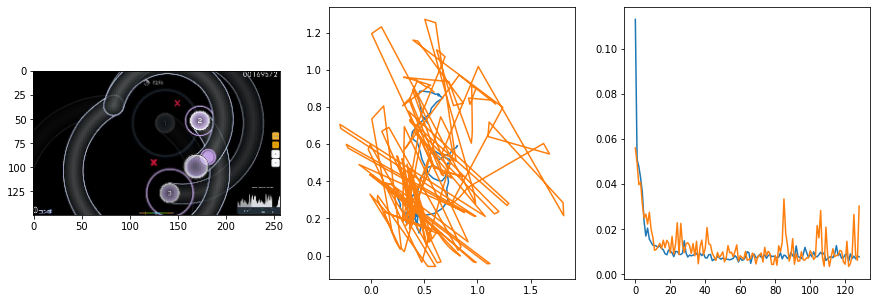

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.68it/s  0.0054                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

108 of 128
pred: 0.6841344833374023 0.4118776321411133
gt: 0.8828125 0.1458333283662796
(184, 34)


<Figure size 1080x360 with 0 Axes>

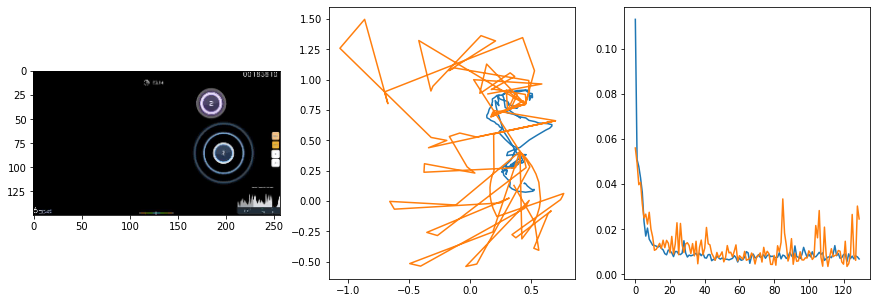

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.69it/s  0.0086                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

109 of 128
pred: 0.4833008646965027 0.5302743911743164
gt: 0.5783362984657288 0.68875652551651
(137, 98)


<Figure size 1080x360 with 0 Axes>

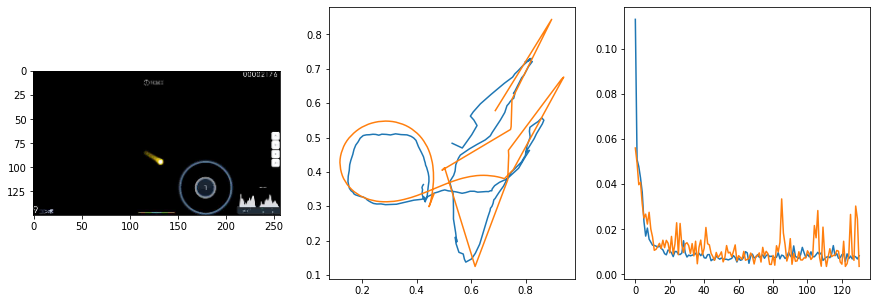

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.70it/s  0.0424                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

110 of 128
pred: 0.3288938105106354 0.6527484059333801
gt: 0.2527613043785095 0.8497664928436279
(87, 116)


<Figure size 1080x360 with 0 Axes>

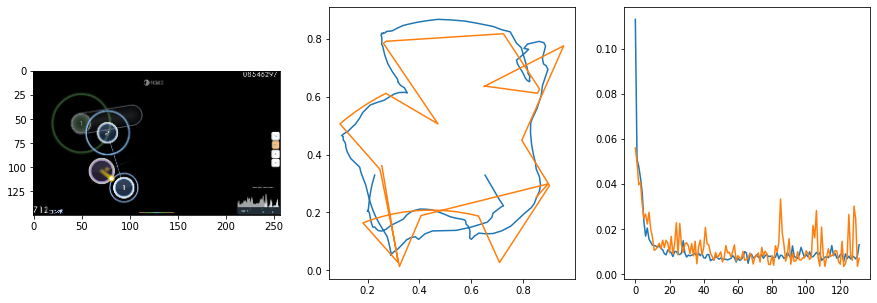

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.78it/s  0.0142                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

111 of 128
pred: 0.3542901873588562 0.39603471755981445
gt: 0.4139769375324249 0.7298269867897034
(112, 102)


<Figure size 1080x360 with 0 Axes>

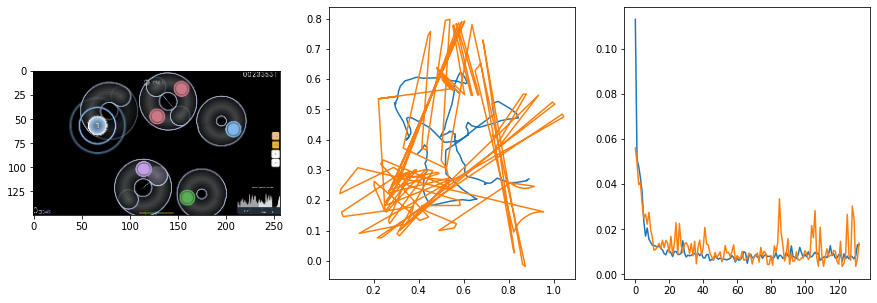

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.76it/s  0.0040                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

112 of 128
pred: 0.3701316714286804 0.30147022008895874
gt: 0.4859693944454193 0.2708333432674408
(123, 49)


<Figure size 1080x360 with 0 Axes>

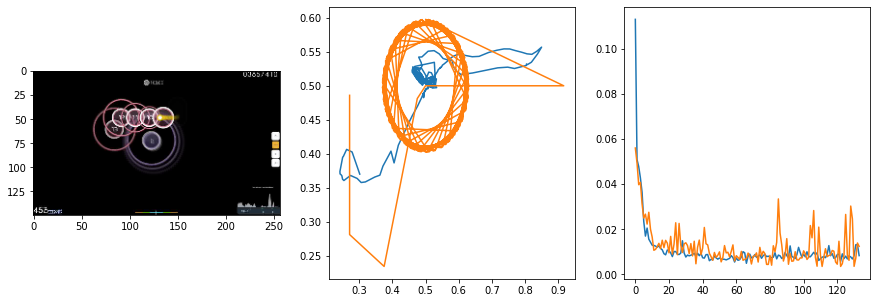

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.70it/s  0.0102                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

113 of 128
pred: 0.5210919976234436 0.45265835523605347
gt: 0.7252683639526367 0.35985442996025085
(160, 59)


<Figure size 1080x360 with 0 Axes>

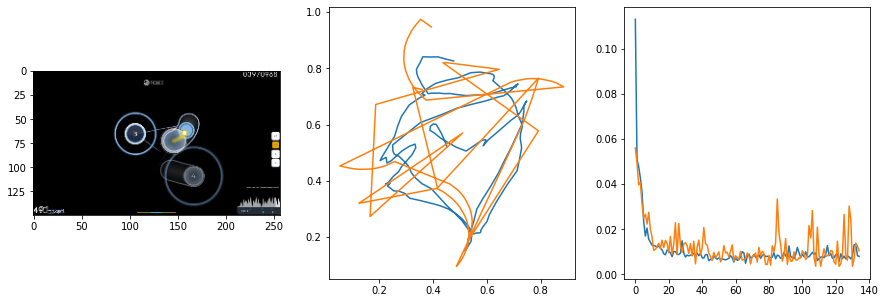

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.67it/s  0.0033                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

114 of 128
pred: 0.570686936378479 0.3073195219039917
gt: 0.7708724737167358 0.13199667632579803
(167, 33)


<Figure size 1080x360 with 0 Axes>

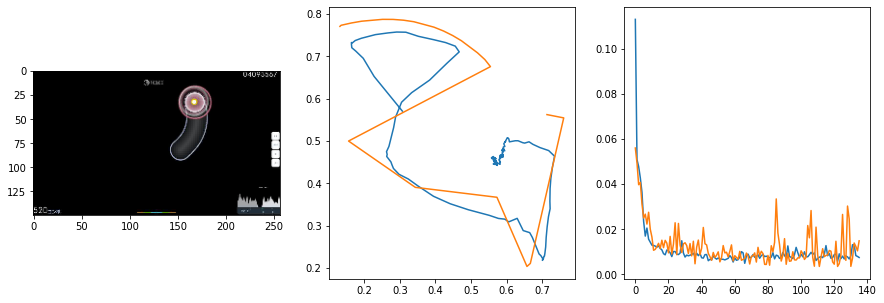

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.77it/s  0.0161                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

115 of 128
pred: 0.389772891998291 0.2967548370361328
gt: 0.41796875 0.1901041716337204
(112, 40)


<Figure size 1080x360 with 0 Axes>

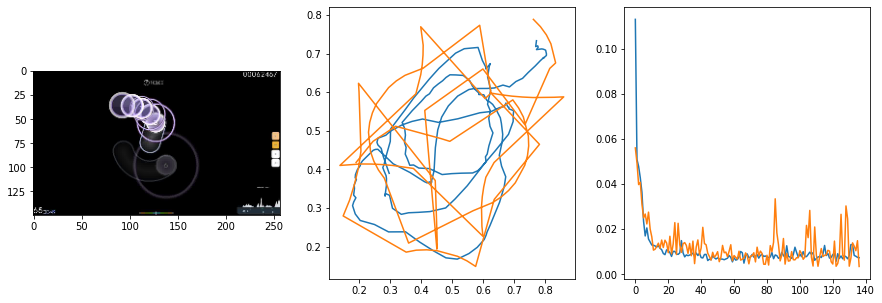

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.77it/s  0.0042                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

116 of 128
pred: 0.6605386734008789 0.371565580368042
gt: 0.9453125 0.1041666641831398
(194, 30)


<Figure size 1080x360 with 0 Axes>

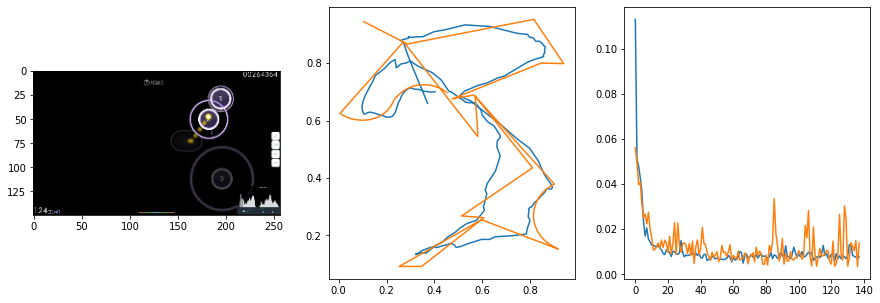

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.76it/s  0.0053                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

117 of 128
pred: 0.4273012578487396 0.418795108795166
gt: 0.30515390634536743 0.2545303702354431
(95, 47)


<Figure size 1080x360 with 0 Axes>

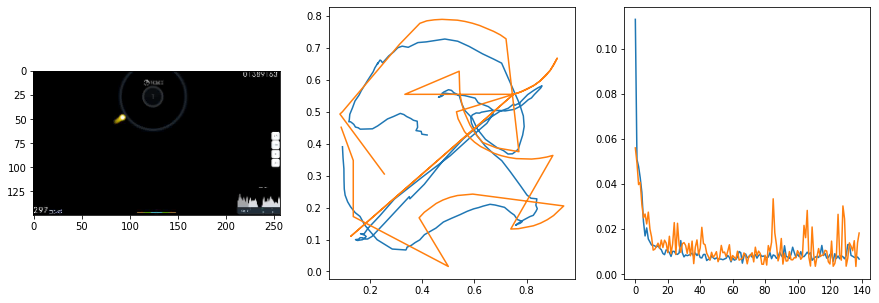

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.75it/s  0.0085                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

118 of 128
pred: 0.5334835648536682 0.4461708664894104
gt: 0.583078920841217 0.39462611079216003
(138, 63)


<Figure size 1080x360 with 0 Axes>

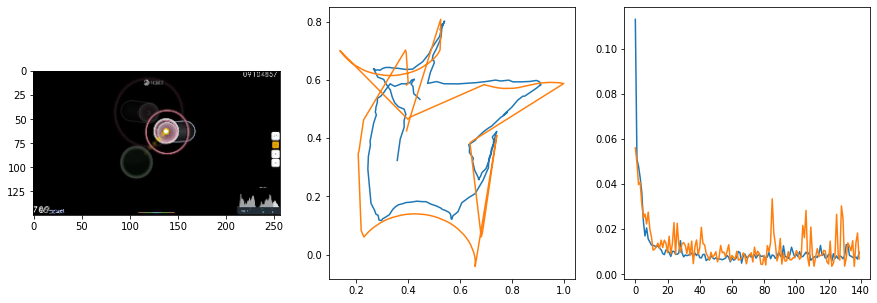

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.75it/s  0.0073                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

119 of 128
pred: 0.6186971068382263 0.5174803137779236
gt: 0.709148645401001 0.4495229721069336
(157, 70)


<Figure size 1080x360 with 0 Axes>

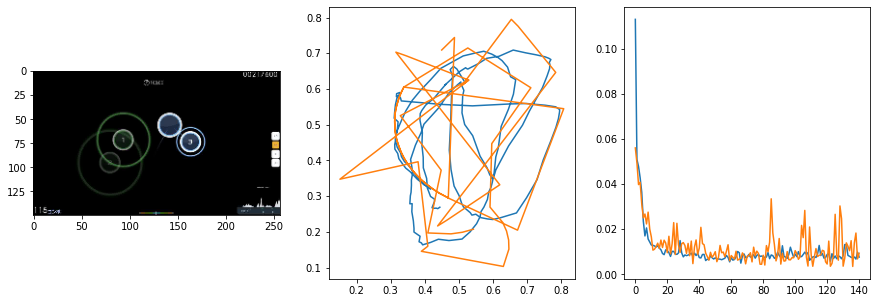

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.74it/s  0.0043                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

120 of 128
pred: 0.41746872663497925 0.46294450759887695
gt: 0.5672925710678101 0.48248258233070374
(135, 74)


<Figure size 1080x360 with 0 Axes>

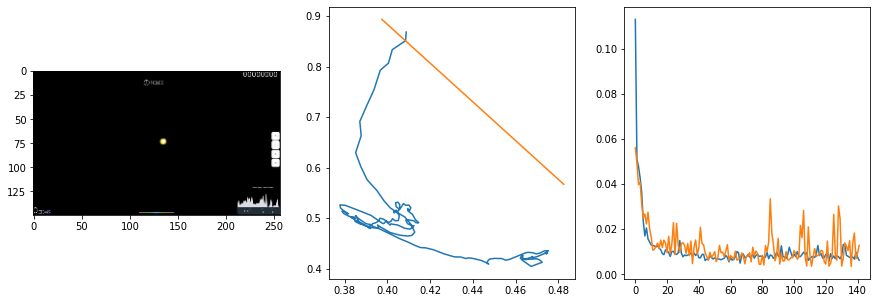

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.69it/s  0.0037                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

121 of 128
pred: 0.516802966594696 0.4290008544921875
gt: 0.6402449607849121 0.37576690316200256
(147, 61)


<Figure size 1080x360 with 0 Axes>

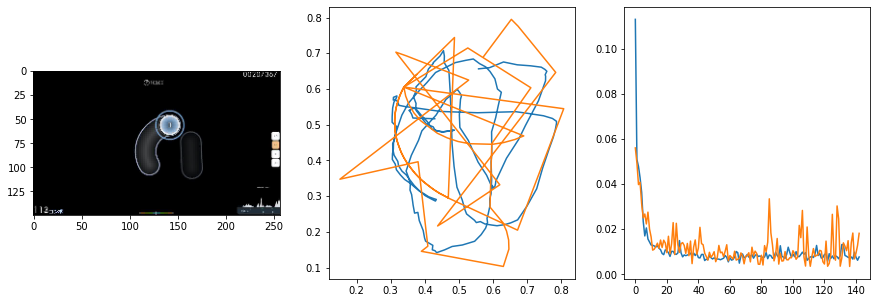

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.76it/s  0.0074                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

122 of 128
pred: 0.28041526675224304 0.5623731017112732
gt: 0.2078993022441864 0.6189236044883728
(80, 89)


<Figure size 1080x360 with 0 Axes>

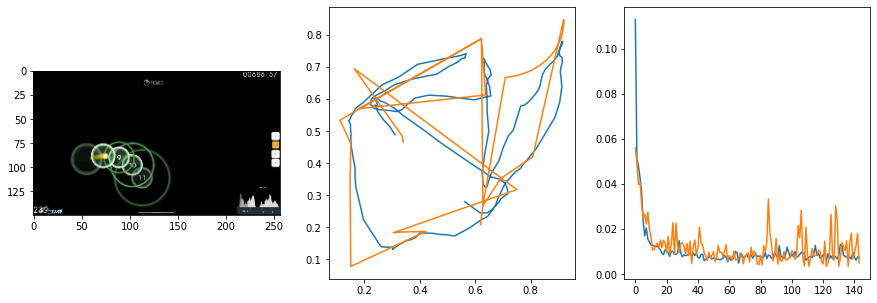

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.74it/s  0.0044                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

123 of 128
pred: 0.3101905882358551 0.5021792054176331
gt: 0.23904050886631012 0.8469637036323547
(85, 116)


<Figure size 1080x360 with 0 Axes>

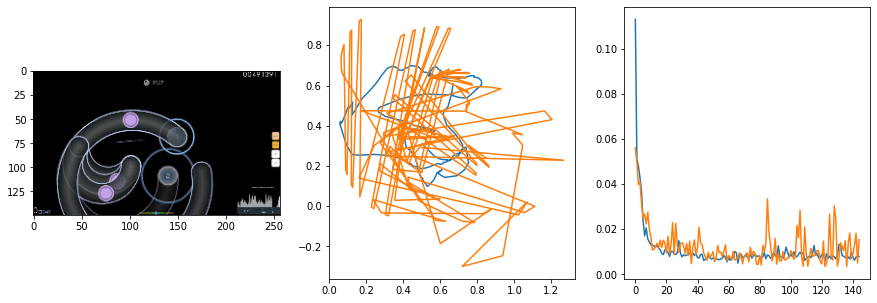

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.74it/s  0.0027                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

124 of 128
pred: 0.227397620677948 0.438423752784729
gt: 0.1013760194182396 0.49204471707344055
(63, 75)


<Figure size 1080x360 with 0 Axes>

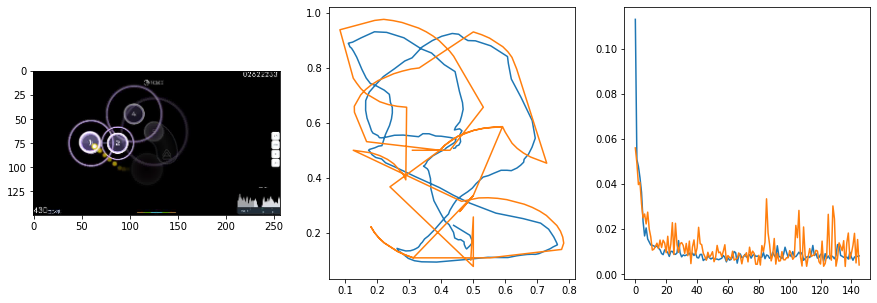

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.75it/s  0.0093                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

125 of 128
pred: 0.7146873474121094 0.7290093898773193
gt: 0.5950294733047485 0.6257792711257935
(140, 90)


<Figure size 1080x360 with 0 Axes>

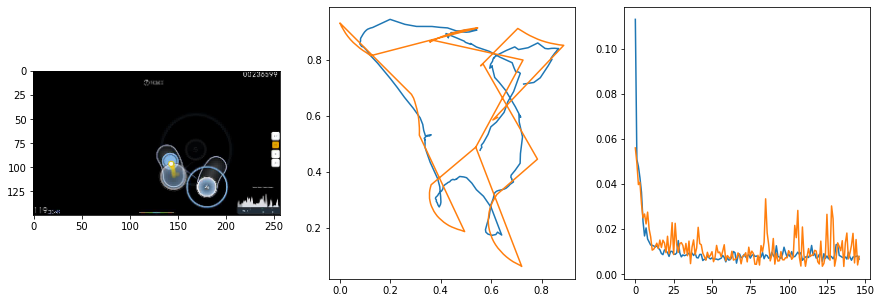

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.73it/s  0.0081                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

126 of 128
pred: 0.5450035333633423 0.5372530817985535
gt: 0.5131739974021912 0.5
(127, 76)


<Figure size 1080x360 with 0 Axes>

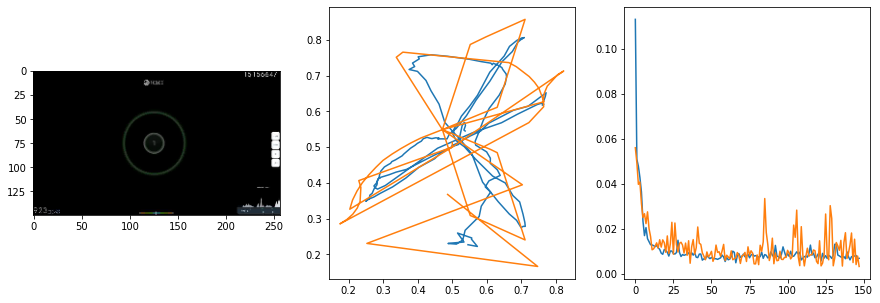

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.75it/s  0.0060                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

127 of 128
pred: 0.7318520545959473 0.8144773244857788
gt: 0.6068160533905029 0.7892434597015381
(142, 109)


<Figure size 1080x360 with 0 Axes>

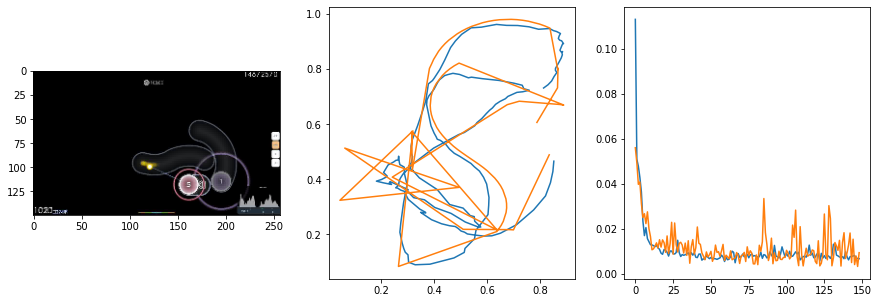

647.3966066837311 secs


In [ ]:
start = time.time()

lamb = 1
epochs = 64
trainVN()

end = time.time()
print(end - start, 'secs')

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.73it/s  0.0116                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

0 of 64
pred: 0.7858656644821167 0.5746828317642212
gt: 0.875 0.23866666853427887
(183, 45)


<Figure size 1080x360 with 0 Axes>

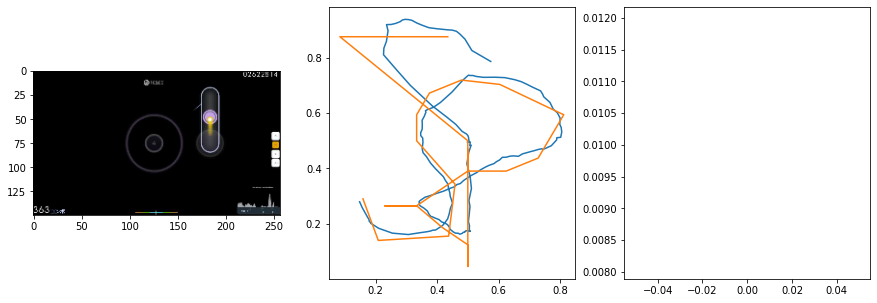

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.71it/s  0.0130                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

1 of 64
pred: 0.418514609336853 0.3419286012649536
gt: 0.515625 0.32600000500679016
(127, 55)


<Figure size 1080x360 with 0 Axes>

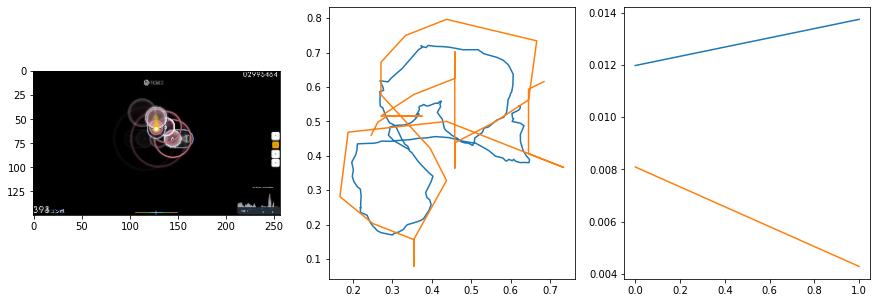

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.73it/s  0.0161                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

2 of 64
pred: 0.6792581081390381 0.6397849917411804
gt: 0.5053117871284485 0.576932430267334
(126, 85)


<Figure size 1080x360 with 0 Axes>

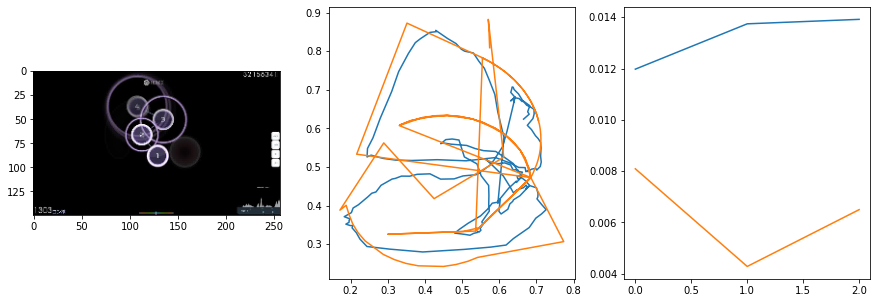

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.74it/s  0.0097                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

3 of 64
pred: 0.25537171959877014 0.4659011960029602
gt: 0.33282068371772766 0.7133352756500244
(99, 100)


<Figure size 1080x360 with 0 Axes>

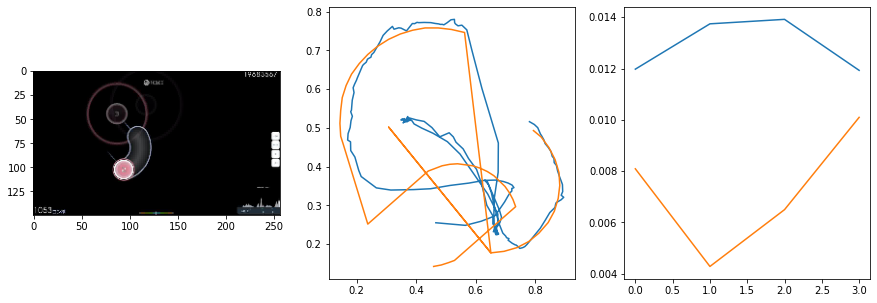

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.76it/s  0.0049                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

4 of 64
pred: 0.45496368408203125 0.45685914158821106
gt: 0.66015625 0.4609375
(150, 71)


<Figure size 1080x360 with 0 Axes>

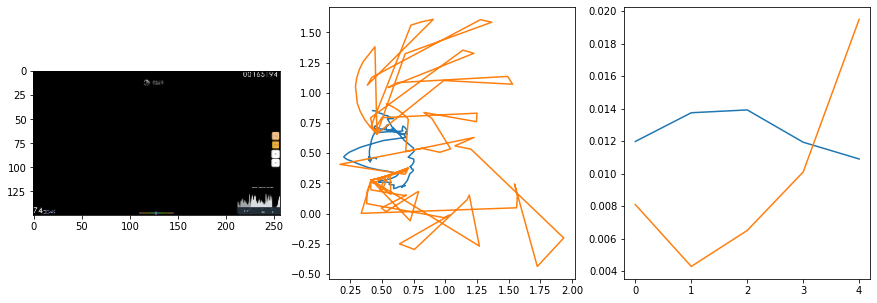

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.70it/s  0.0139                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

5 of 64
pred: 0.6553051471710205 0.7395967245101929
gt: 0.5528242588043213 0.6107361912727356
(133, 89)


<Figure size 1080x360 with 0 Axes>

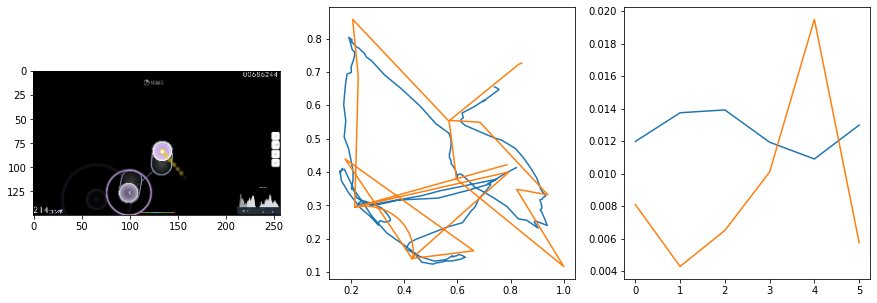

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.80it/s  0.0041                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

6 of 64
pred: 0.4409373104572296 0.44009333848953247
gt: 0.7005208134651184 0.7291666865348816
(156, 102)


<Figure size 1080x360 with 0 Axes>

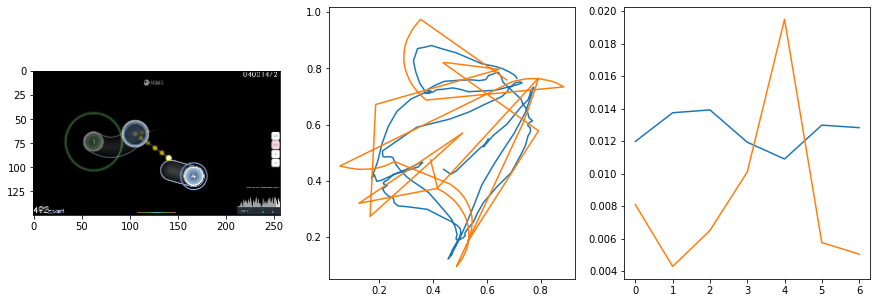

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.78it/s  0.0040                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

7 of 64
pred: 0.6524638533592224 0.5628281831741333
gt: 0.5150168538093567 0.8340818285942078
(127, 115)


<Figure size 1080x360 with 0 Axes>

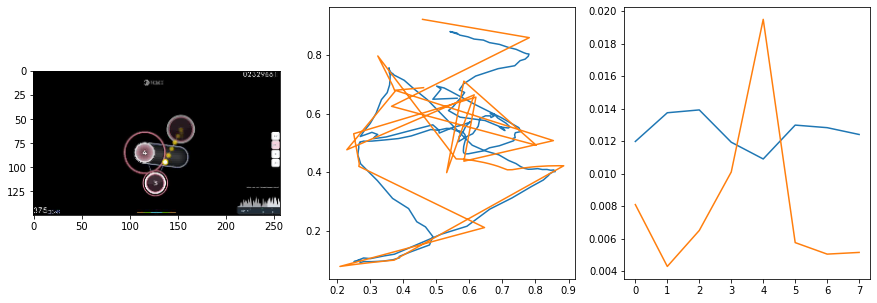

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.76it/s  0.0100                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

8 of 64
pred: 0.6936568021774292 0.29471147060394287
gt: 0.8076030611991882 0.4280634820461273
(173, 67)


<Figure size 1080x360 with 0 Axes>

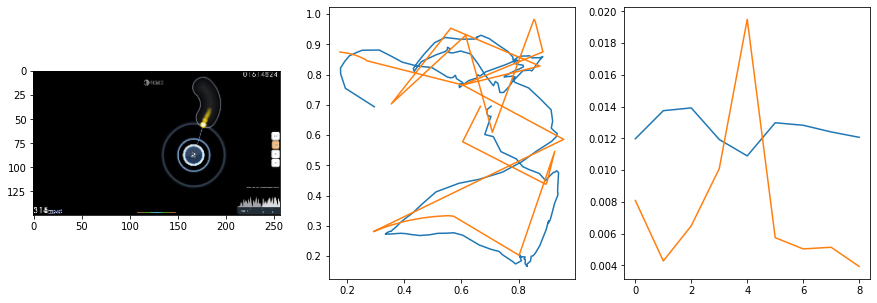

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.73it/s  0.0107                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

9 of 64
pred: 0.6179993152618408 0.5101401805877686
gt: 0.6096088886260986 0.303143709897995
(142, 53)


<Figure size 1080x360 with 0 Axes>

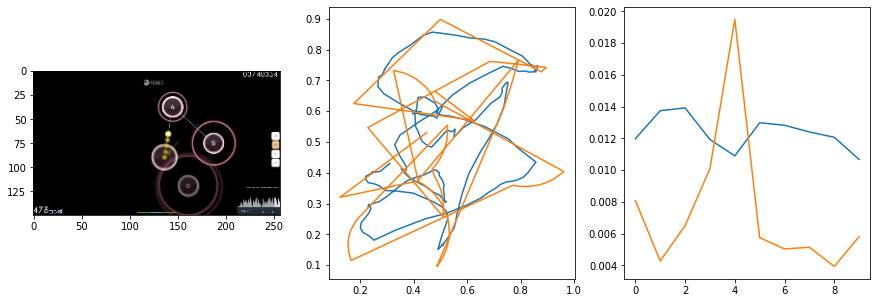

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.75it/s  0.0232                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

10 of 64
pred: 0.5101990103721619 0.2972411513328552
gt: 0.793628454208374 0.20967429876327515
(171, 42)


<Figure size 1080x360 with 0 Axes>

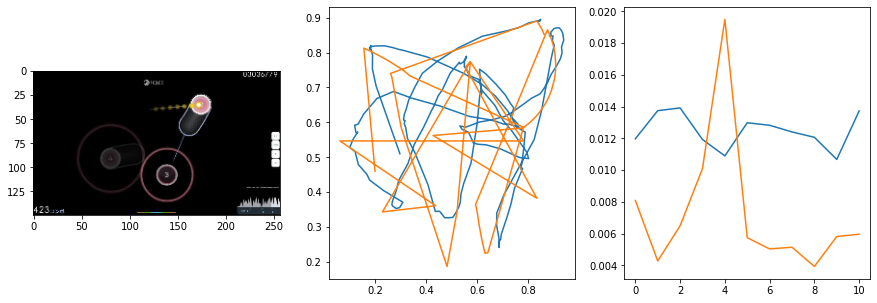

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.70it/s  0.0101                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

11 of 64
pred: 0.25520825386047363 0.25382256507873535
gt: 0.14778228104114532 0.2896956503391266
(70, 51)


<Figure size 1080x360 with 0 Axes>

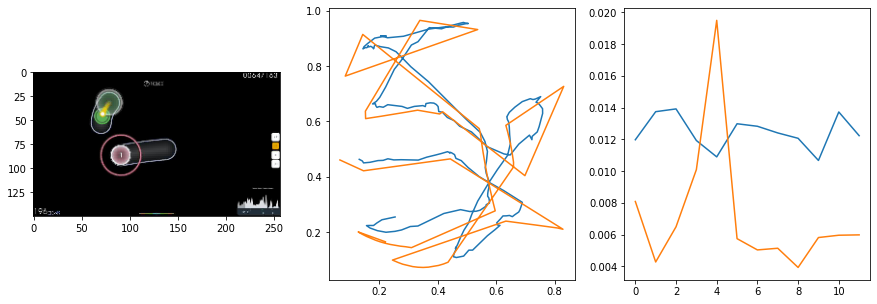

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.74it/s  0.0107                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

12 of 64
pred: 0.7264918684959412 0.5825929641723633
gt: 0.6219785213470459 0.4948361814022064
(144, 75)


<Figure size 1080x360 with 0 Axes>

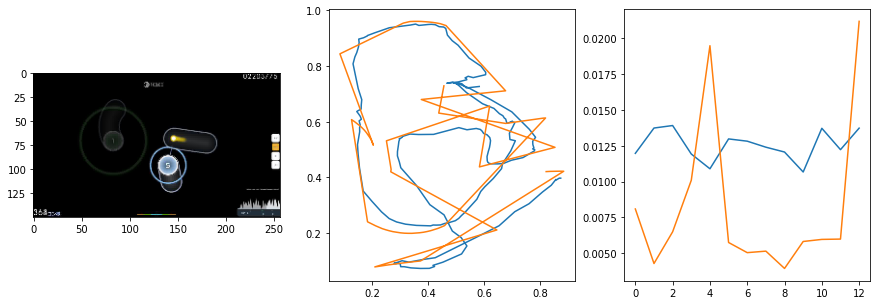

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.74it/s  0.0185                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

13 of 64
pred: 0.44640499353408813 0.5090669989585876
gt: 0.8068886399269104 0.6276074051856995
(173, 90)


<Figure size 1080x360 with 0 Axes>

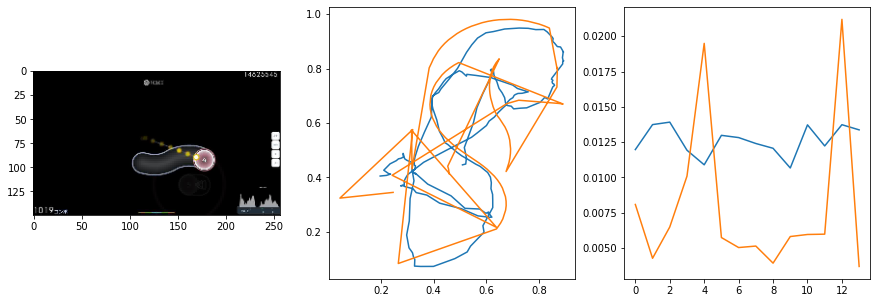

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.73it/s  0.0082                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

14 of 64
pred: 0.29341819882392883 0.6147027611732483
gt: 0.21227961778640747 0.46913233399391174
(80, 72)


<Figure size 1080x360 with 0 Axes>

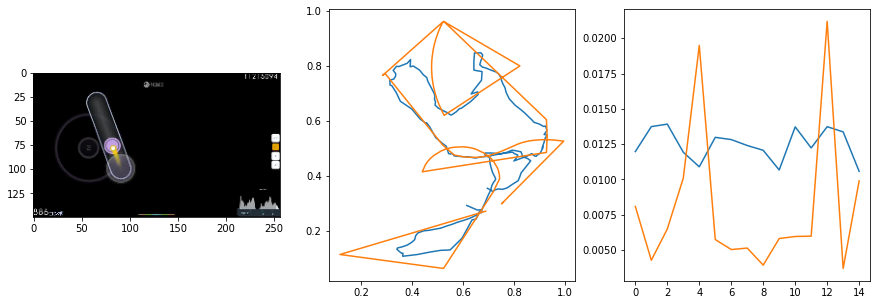

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.80it/s  0.0201                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

15 of 64
pred: 0.7008026242256165 0.4300870895385742
gt: 0.760732889175415 0.3631947338581085
(165, 60)


<Figure size 1080x360 with 0 Axes>

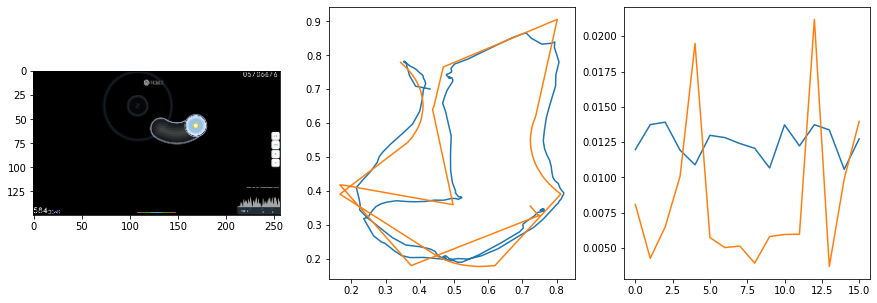

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.74it/s  0.0061                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

16 of 64
pred: 0.4534875750541687 0.5654898881912231
gt: 0.42753350734710693 0.4516890048980713
(114, 70)


<Figure size 1080x360 with 0 Axes>

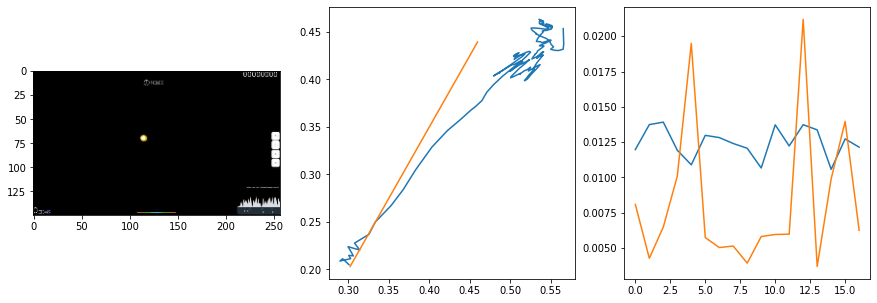

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.73it/s  0.0107                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

17 of 64
pred: 0.39696669578552246 0.4142304062843323
gt: 0.5340051054954529 0.5595927834510803
(130, 83)


<Figure size 1080x360 with 0 Axes>

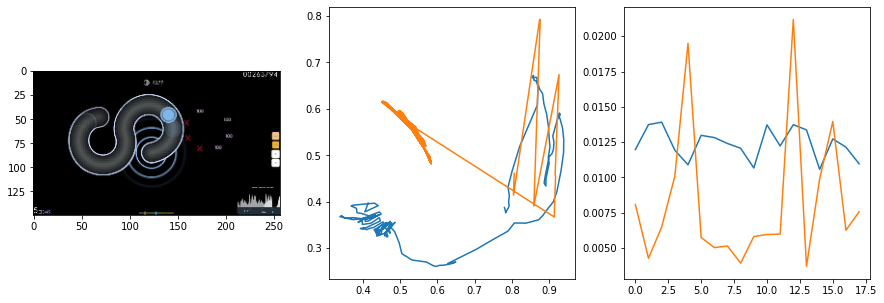

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.74it/s  0.0159                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

18 of 64
pred: 0.7091608643531799 0.662878692150116
gt: 0.6965082883834839 0.7909226417541504
(156, 109)


<Figure size 1080x360 with 0 Axes>

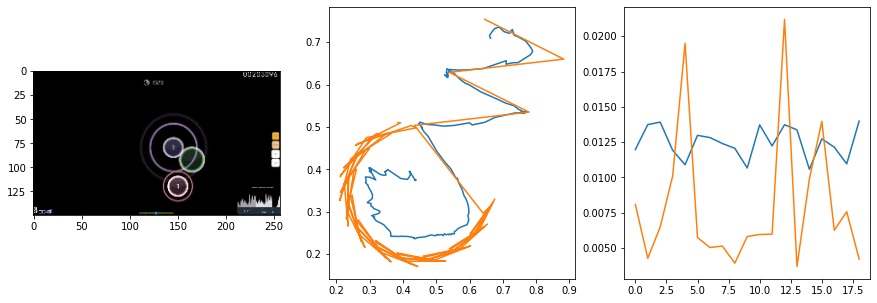

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.74it/s  0.0072                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

19 of 64
pred: 0.41419467329978943 0.7775933742523193
gt: 0.30181244015693665 0.7574915289878845
(94, 106)


<Figure size 1080x360 with 0 Axes>

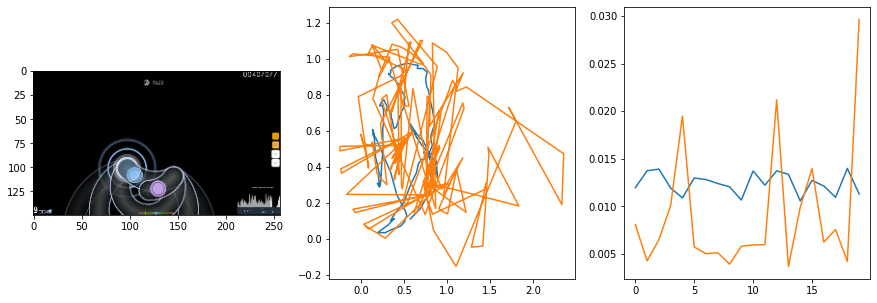

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.74it/s  0.0162                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

20 of 64
pred: 0.6150287985801697 0.5106251239776611
gt: 0.841463029384613 0.5018696188926697
(178, 76)


<Figure size 1080x360 with 0 Axes>

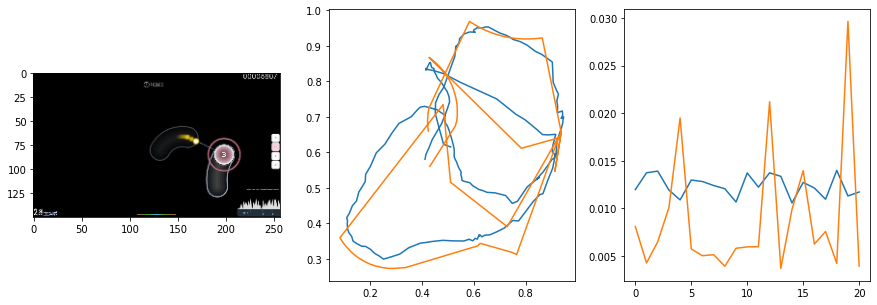

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.74it/s  0.0222                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

21 of 64
pred: 0.5382916331291199 0.4597327709197998
gt: 1.0519939661026 1.0066391229629517
(211, 135)


<Figure size 1080x360 with 0 Axes>

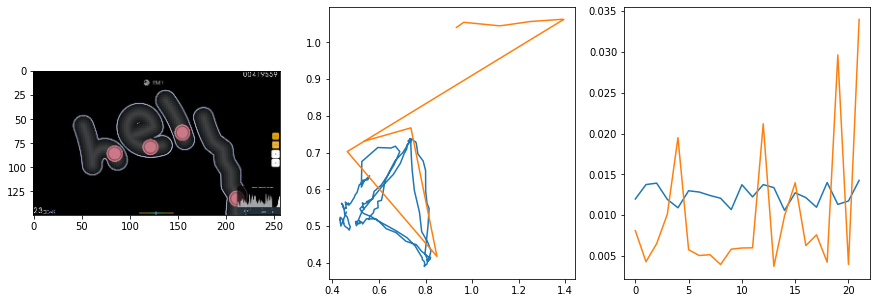

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.74it/s  0.0373                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

22 of 64
pred: 0.6029874086380005 0.6867774724960327
gt: 0.8569155335426331 0.7509644627571106
(180, 105)


<Figure size 1080x360 with 0 Axes>

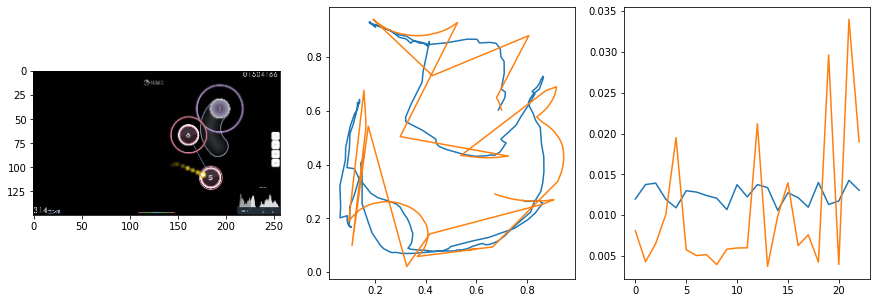

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.72it/s  0.0191                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

23 of 64
pred: 0.6937936544418335 0.4768754839897156
gt: 0.7752190232276917 0.6044138669967651
(168, 88)


<Figure size 1080x360 with 0 Axes>

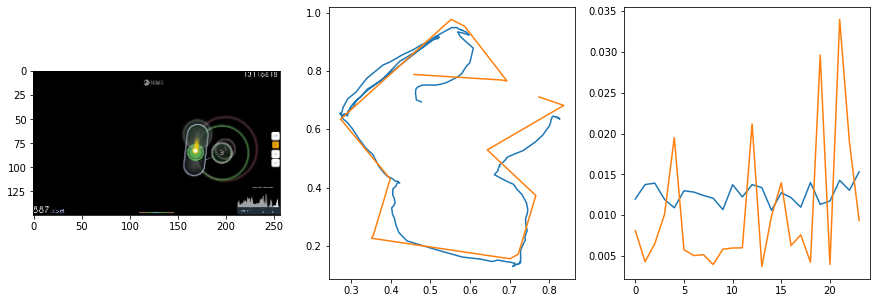

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.78it/s  0.0058                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

24 of 64
pred: 0.2891293168067932 0.6067258715629578
gt: 0.5360804200172424 0.7553420066833496
(131, 105)


<Figure size 1080x360 with 0 Axes>

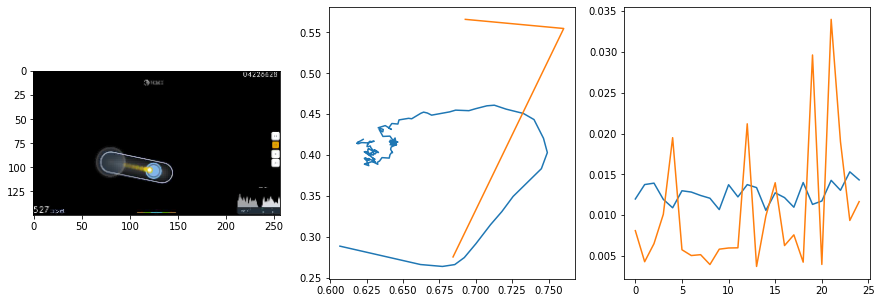

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.77it/s  0.0050                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

25 of 64
pred: 0.22299546003341675 0.6623783707618713
gt: 0.2300889790058136 0.5109230279922485
(83, 77)


<Figure size 1080x360 with 0 Axes>

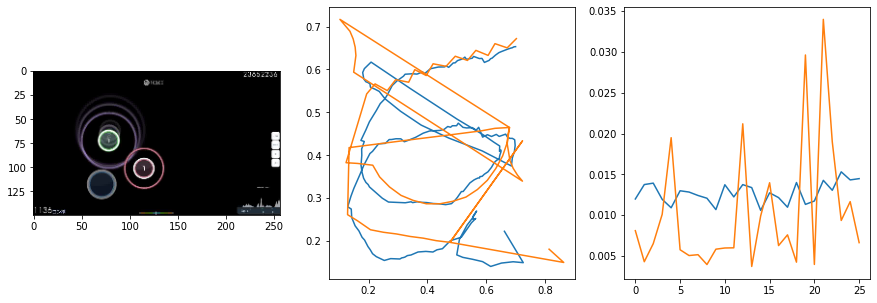

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.72it/s  0.0054                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

26 of 64
pred: 0.3719758093357086 0.27435290813446045
gt: 0.46484375 0.4427083432674408
(120, 69)


<Figure size 1080x360 with 0 Axes>

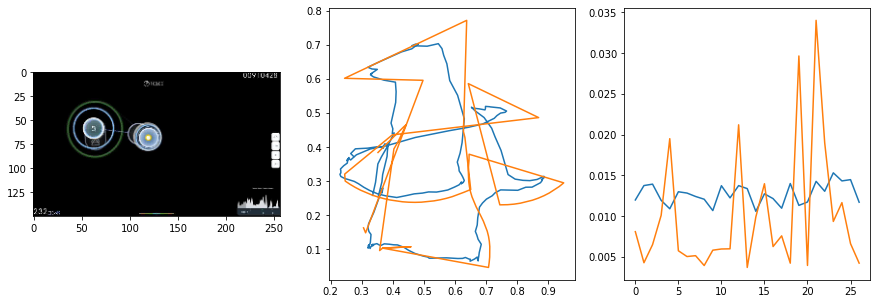

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.69it/s  0.0131                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

27 of 64
pred: 0.21833834052085876 0.34907931089401245
gt: 0.17539860308170319 0.3116142153739929
(75, 54)


<Figure size 1080x360 with 0 Axes>

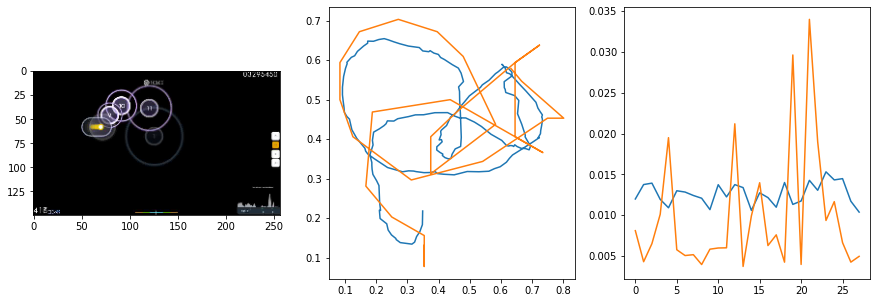

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.80it/s  0.0131                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

28 of 64
pred: 0.6494077444076538 0.6913268566131592
gt: 0.692187488079071 0.625
(155, 90)


<Figure size 1080x360 with 0 Axes>

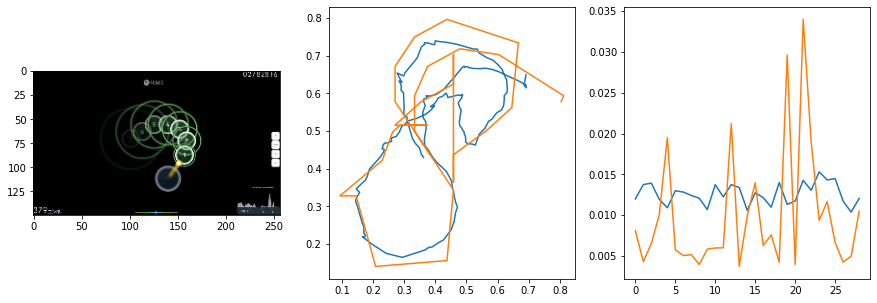

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.79it/s  0.0447                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

29 of 64
pred: 0.45706963539123535 0.26830005645751953
gt: 0.42331966757774353 0.3365860879421234
(113, 57)


<Figure size 1080x360 with 0 Axes>

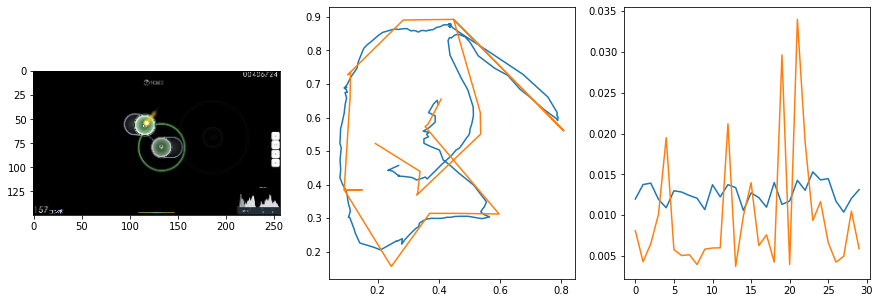

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.74it/s  0.0088                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

30 of 64
pred: 0.8422309160232544 0.5133215188980103
gt: 0.8548309803009033 0.5914646983146667
(180, 86)


<Figure size 1080x360 with 0 Axes>

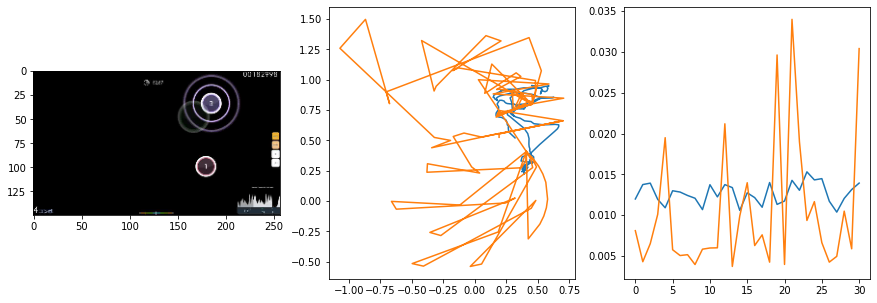

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.81it/s  0.0093                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

31 of 64
pred: 0.5420480370521545 0.2017243206501007
gt: 0.515625 0.203125
(127, 41)


<Figure size 1080x360 with 0 Axes>

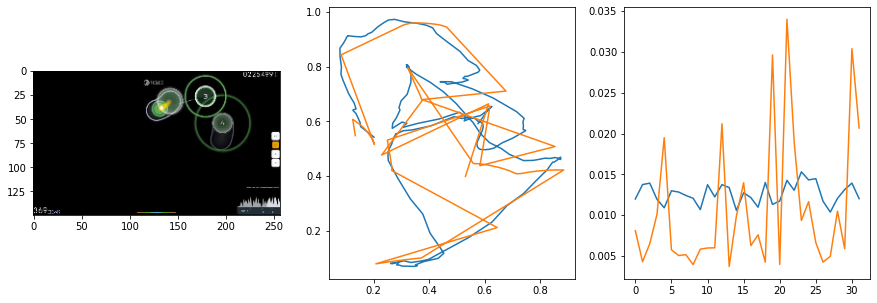

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.70it/s  0.0109                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

32 of 64
pred: 0.5704692006111145 0.6474412679672241
gt: 0.5625 0.4711221158504486
(135, 72)


<Figure size 1080x360 with 0 Axes>

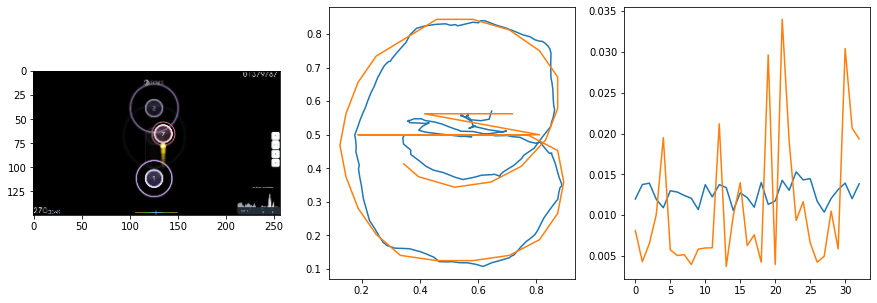

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.73it/s  0.0055                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

33 of 64
pred: 0.5952980518341064 0.6755094528198242
gt: 0.4565354585647583 0.7031917572021484
(118, 99)


<Figure size 1080x360 with 0 Axes>

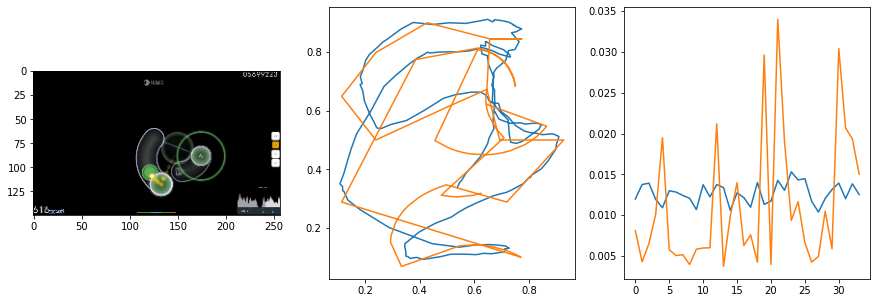

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.74it/s  0.0111                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

34 of 64
pred: 0.4372290074825287 0.5184914469718933
gt: 0.4016069173812866 0.6684431433677673
(110, 95)


<Figure size 1080x360 with 0 Axes>

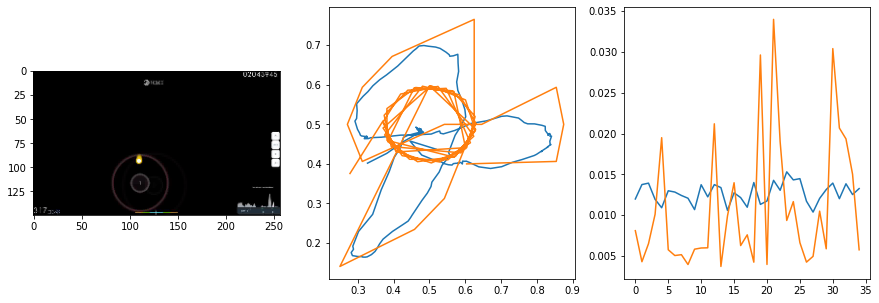

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.73it/s  0.0296                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

35 of 64
pred: 0.4948985278606415 0.786787748336792
gt: 0.58203125 0.765625
(138, 107)


<Figure size 1080x360 with 0 Axes>

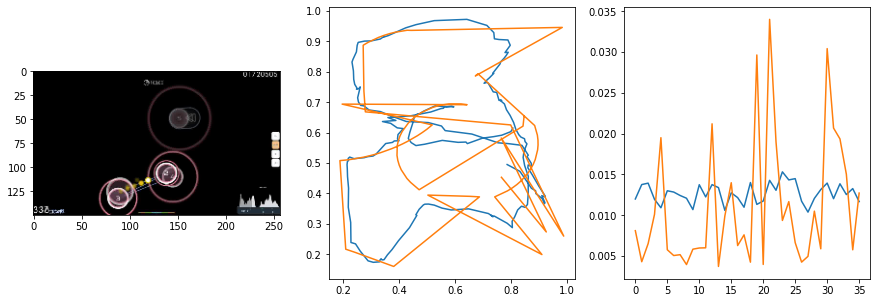

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.71it/s  0.0122                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

36 of 64
pred: 0.4804583787918091 0.46901795268058777
gt: 0.5609742403030396 0.7223150730133057
(134, 102)


<Figure size 1080x360 with 0 Axes>

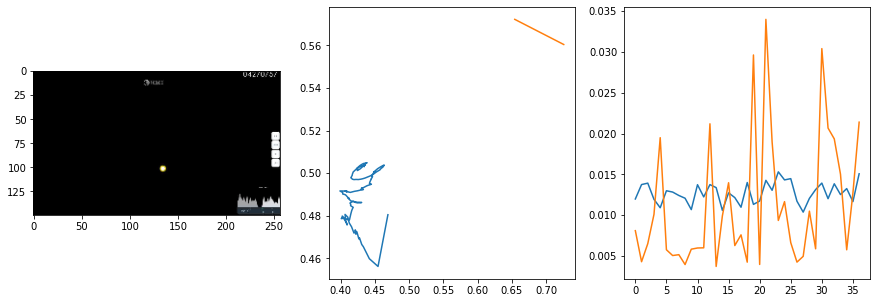

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.73it/s  0.0114                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

37 of 64
pred: 0.32051315903663635 0.6500382423400879
gt: 0.27236127853393555 0.6781993508338928
(90, 96)


<Figure size 1080x360 with 0 Axes>

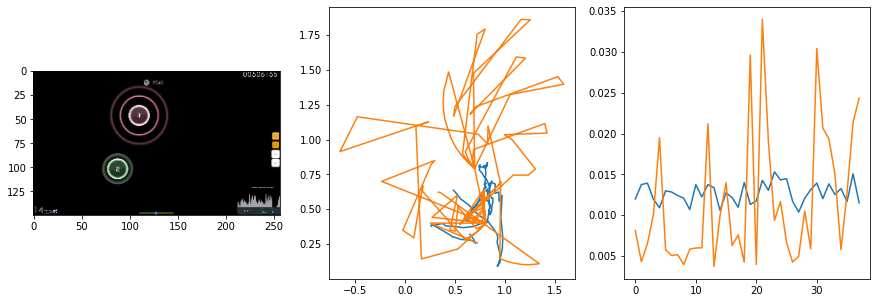

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.74it/s  0.0067                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

38 of 64
pred: 0.6499230861663818 0.49873489141464233
gt: 0.5017321705818176 0.39368000626564026
(125, 63)


<Figure size 1080x360 with 0 Axes>

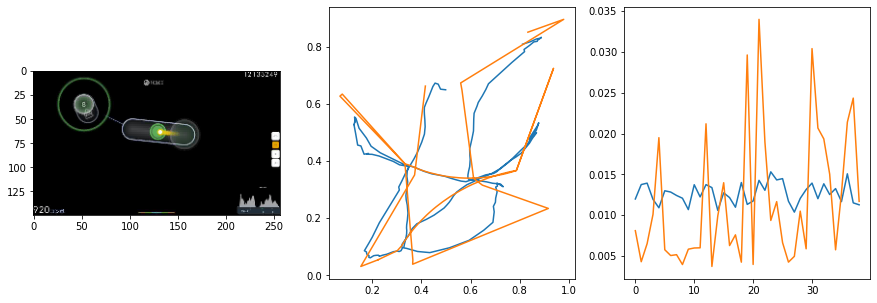

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.79it/s  0.0079                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

39 of 64
pred: 0.2179456204175949 0.36722850799560547
gt: 0.1038752943277359 0.375340074300766
(64, 61)


<Figure size 1080x360 with 0 Axes>

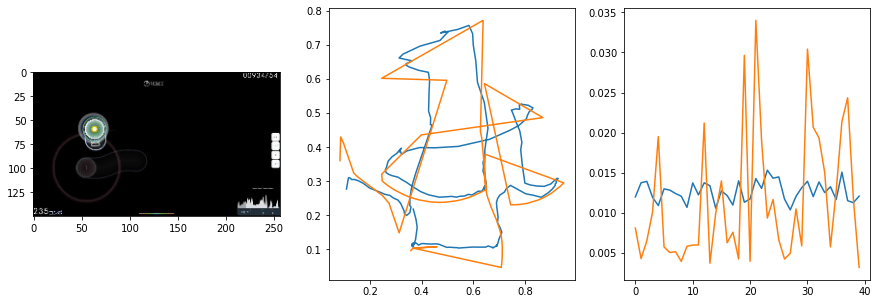

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.79it/s  0.0072                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

40 of 64
pred: 0.527450680732727 0.5828492045402527
gt: 0.5885955095291138 0.7820441722869873
(139, 108)


<Figure size 1080x360 with 0 Axes>

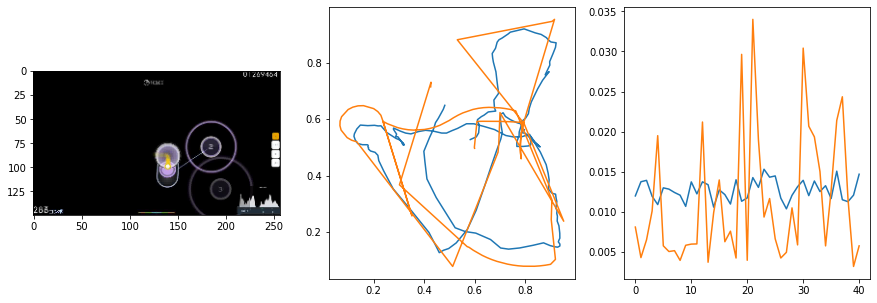

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.74it/s  0.0047                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

41 of 64
pred: 0.5900622606277466 0.5118553042411804
gt: 0.73046875 0.4791666567325592
(161, 73)


<Figure size 1080x360 with 0 Axes>

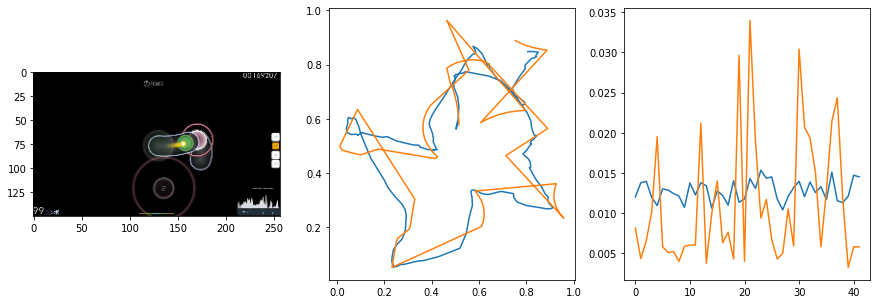

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.72it/s  0.0058                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

42 of 64
pred: 0.5136182308197021 0.6572681665420532
gt: 0.3643818795681 0.6835810542106628
(104, 97)


<Figure size 1080x360 with 0 Axes>

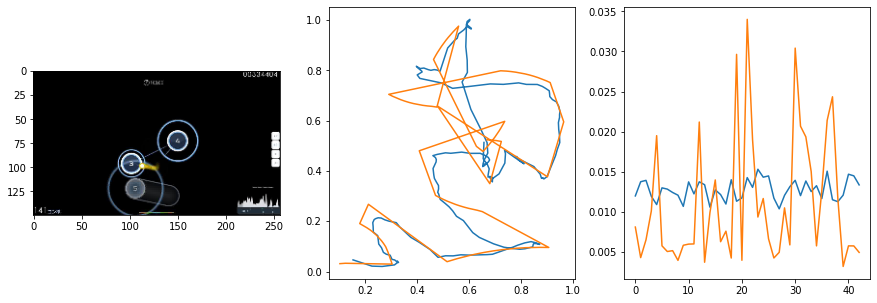

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.69it/s  0.0131                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

43 of 64
pred: 0.17441463470458984 0.6198161244392395
gt: 0.08756732940673828 0.29210570454597473
(61, 51)


<Figure size 1080x360 with 0 Axes>

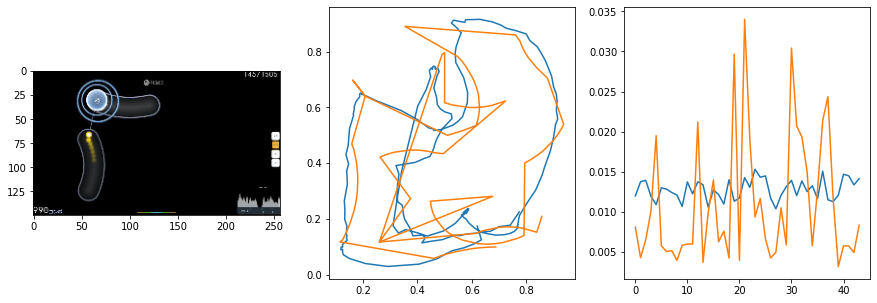

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.69it/s  0.0173                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

44 of 64
pred: 0.7533209919929504 0.3606121838092804
gt: 0.8786430954933167 0.4529878795146942
(184, 70)


<Figure size 1080x360 with 0 Axes>

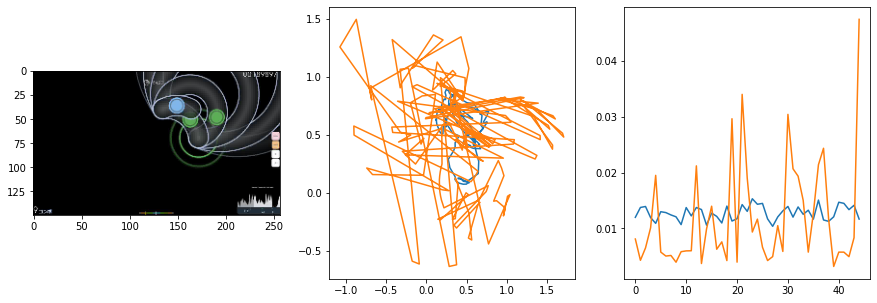

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.70it/s  0.0041                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

45 of 64
pred: 0.42781180143356323 0.5198431015014648
gt: 0.42784029245376587 0.5600370764732361
(114, 83)


<Figure size 1080x360 with 0 Axes>

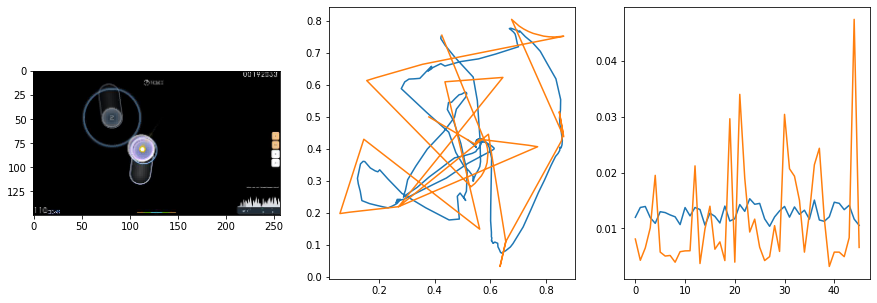

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.74it/s  0.0057                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

46 of 64
pred: 0.7934852838516235 0.5265990495681763
gt: 0.3865581750869751 0.23276685178279877
(107, 45)


<Figure size 1080x360 with 0 Axes>

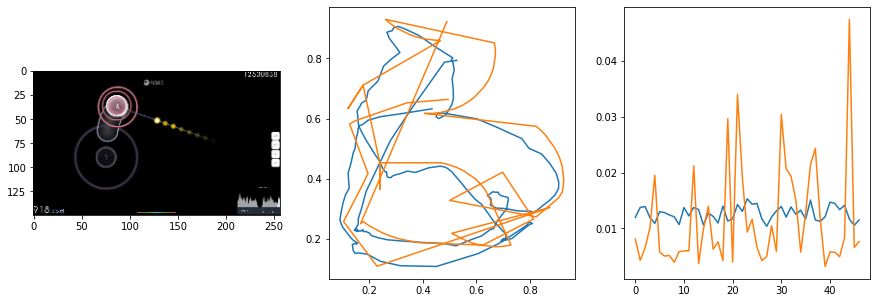

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.72it/s  0.0066                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

47 of 64
pred: 0.7877473831176758 0.5020902752876282
gt: 0.8659244775772095 0.3720439374446869
(182, 61)


<Figure size 1080x360 with 0 Axes>

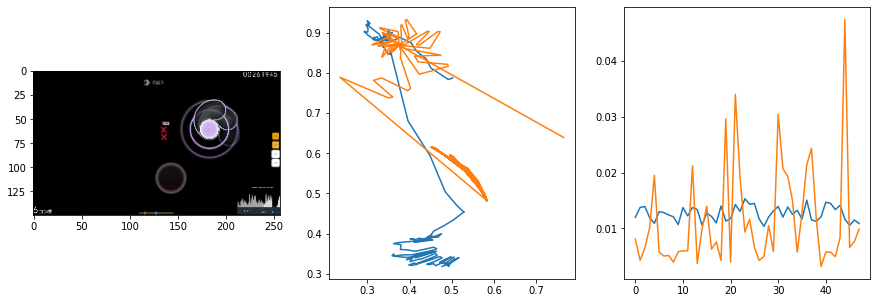

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.73it/s  0.0123                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

48 of 64
pred: 0.49270889163017273 0.284259557723999
gt: 0.5940688848495483 0.3460884392261505
(140, 58)


<Figure size 1080x360 with 0 Axes>

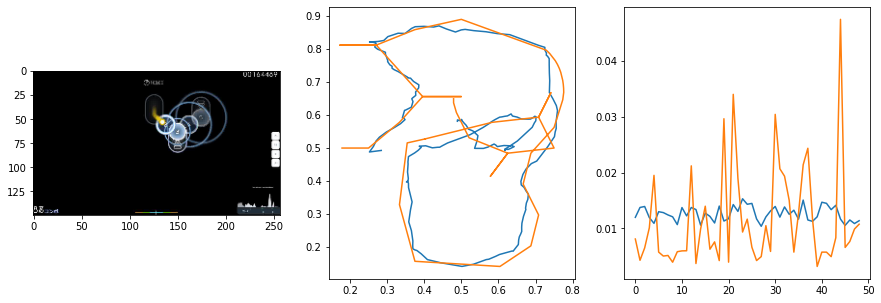

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.74it/s  0.0219                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

49 of 64
pred: 0.5285220146179199 0.6273118853569031
gt: 0.32018786668777466 0.25141727924346924
(97, 47)


<Figure size 1080x360 with 0 Axes>

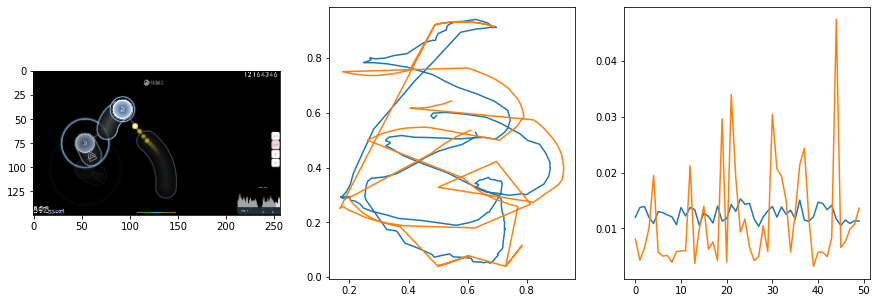

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.74it/s  0.0311                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

50 of 64
pred: 0.24559229612350464 0.7665376663208008
gt: 0.373046875 0.6666666865348816
(105, 95)


<Figure size 1080x360 with 0 Axes>

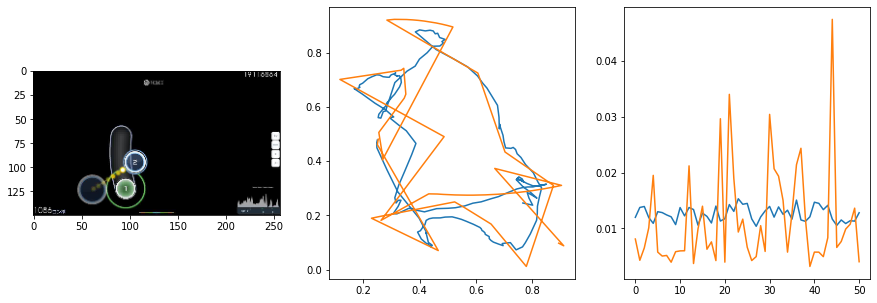

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.73it/s  0.0062                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

51 of 64
pred: 0.5342057943344116 0.5939587354660034
gt: 0.46249234676361084 0.44998130202293396
(119, 70)


<Figure size 1080x360 with 0 Axes>

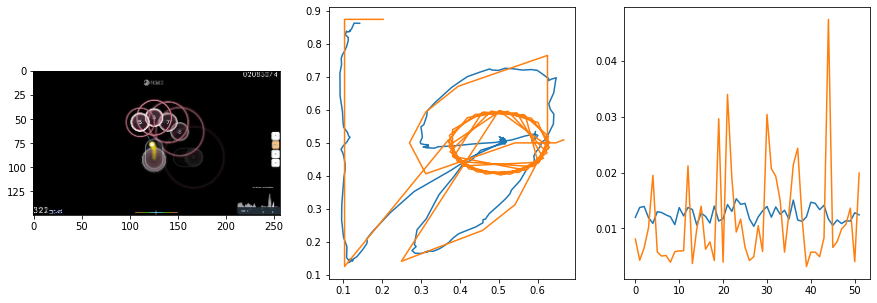

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.74it/s  0.0197                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

52 of 64
pred: 0.43681180477142334 0.7792885303497314
gt: 0.4576602280139923 0.9560381770133972
(118, 129)


<Figure size 1080x360 with 0 Axes>

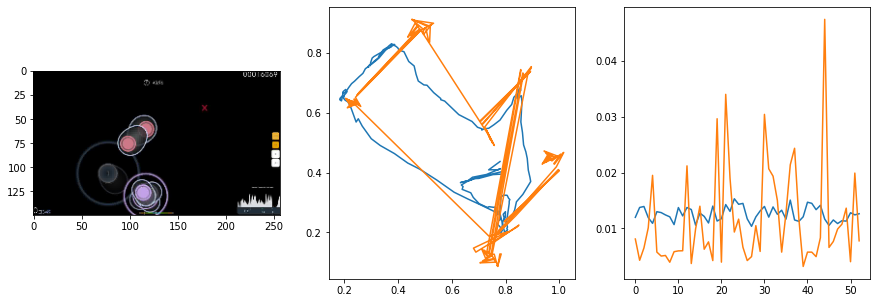

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.72it/s  0.0136                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

53 of 64
pred: 0.6888565421104431 0.6975066065788269
gt: 0.783203125 0.7057291865348816
(169, 100)


<Figure size 1080x360 with 0 Axes>

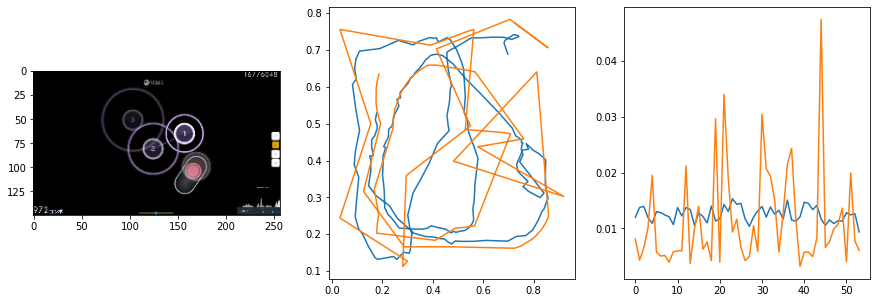

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.72it/s  0.0154                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

54 of 64
pred: 0.719258189201355 0.5718047618865967
gt: 0.662109375 0.5520833134651184
(150, 82)


<Figure size 1080x360 with 0 Axes>

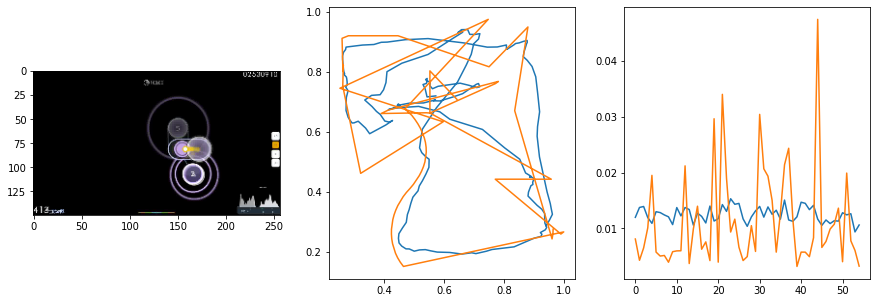

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.72it/s  0.0059                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

55 of 64
pred: 0.826295793056488 0.5374429225921631
gt: 0.8420758843421936 0.6121917366981506
(178, 89)


<Figure size 1080x360 with 0 Axes>

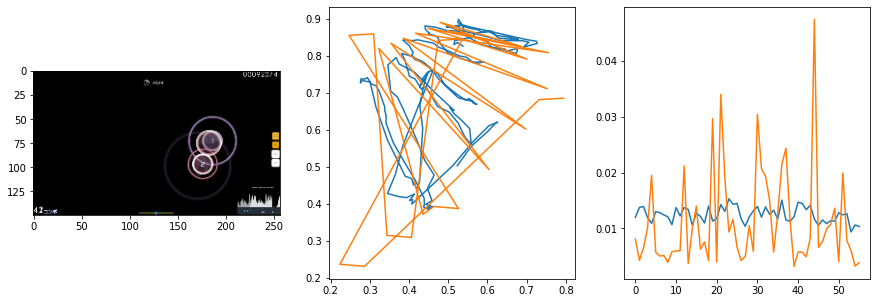

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.71it/s  0.0114                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

56 of 64
pred: 0.4793463945388794 0.47131988406181335
gt: 0.3953767716884613 0.3058813810348511
(109, 53)


<Figure size 1080x360 with 0 Axes>

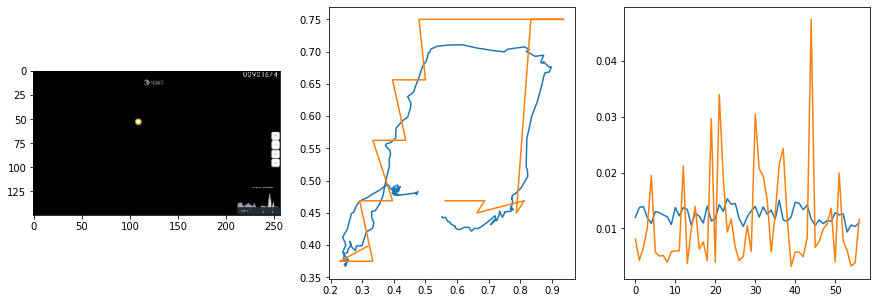

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.71it/s  0.0038                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

57 of 64
pred: 0.37228962779045105 0.6147527098655701
gt: 0.296875 0.9322916865348816
(94, 126)


<Figure size 1080x360 with 0 Axes>

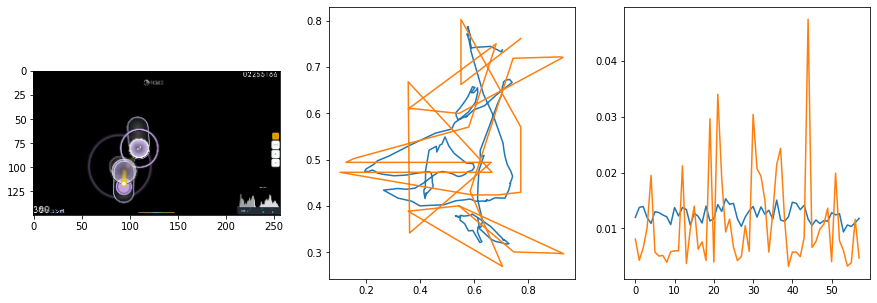

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.74it/s  0.0049                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

58 of 64
pred: 0.2534048855304718 0.6369115710258484
gt: 0.5573863983154297 0.8696280121803284
(134, 119)


<Figure size 1080x360 with 0 Axes>

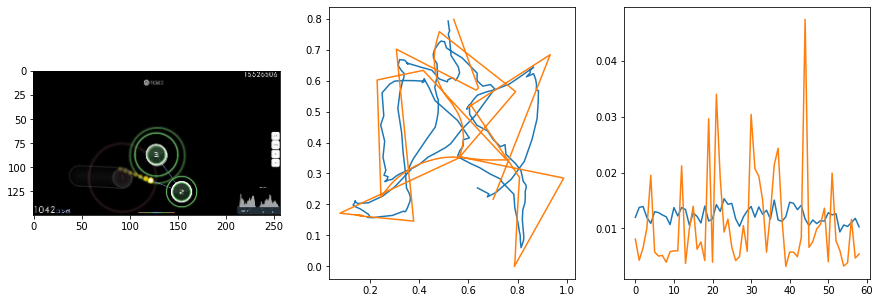

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.74it/s  0.0036                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

59 of 64
pred: 0.6542839407920837 0.506130576133728
gt: 0.7500989437103271 0.31987234950065613
(164, 55)


<Figure size 1080x360 with 0 Axes>

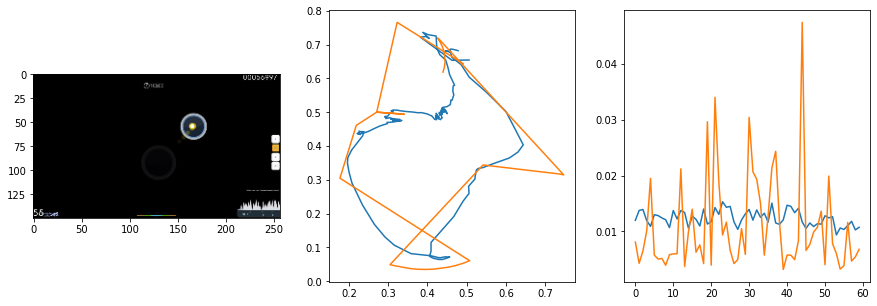

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.73it/s  0.0112                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

60 of 64
pred: 0.9216159582138062 0.3309316039085388
gt: 0.7214796543121338 0.2930499315261841
(159, 52)


<Figure size 1080x360 with 0 Axes>

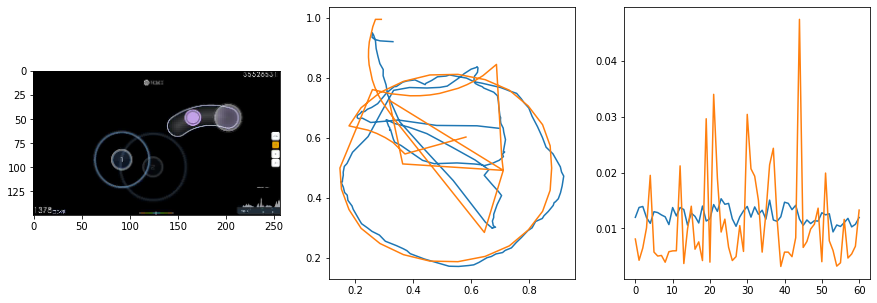

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.73it/s  0.0093                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

61 of 64
pred: 0.4234778583049774 0.5178879499435425
gt: 0.6755514740943909 0.5
(152, 76)


<Figure size 1080x360 with 0 Axes>

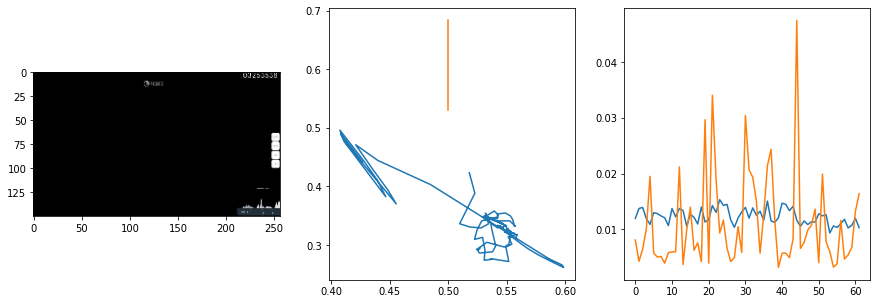

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.75it/s  0.0044                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

62 of 64
pred: 0.583215594291687 0.4097803235054016
gt: 0.755859375 0.3932291567325592
(165, 63)


<Figure size 1080x360 with 0 Axes>

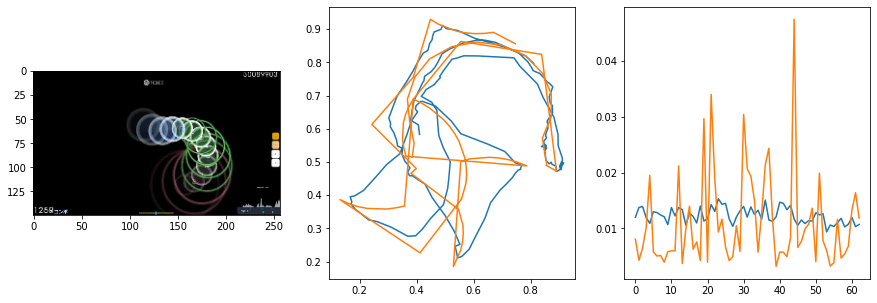

 Iters    Elapsed Time      Speed     loss                                      
 13/13  00:00:07<00:00:00  1.79it/s  0.0086                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

63 of 64
pred: 0.6923715472221375 0.6855506896972656
gt: 0.6471151113510132 0.7181524634361267
(148, 101)


<Figure size 1080x360 with 0 Axes>

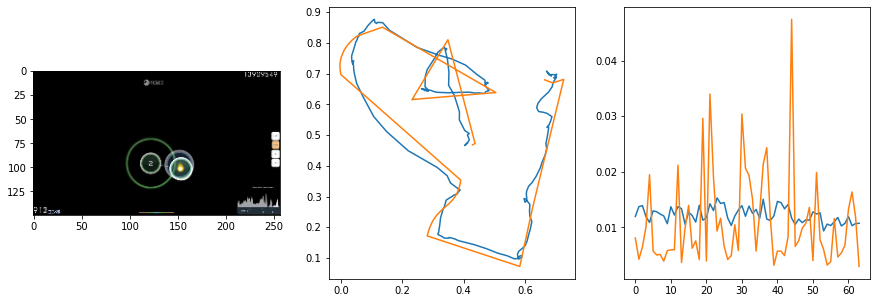

633.4024229049683 secs


In [ ]:
start = time.time()

lamb = 4
epochs = 64
trainVN()

end = time.time()
print(end - start, 'secs')

In [ ]:
torch.save(vn.state_dict(), model_path + str(epoch_cum) + '.pt')

# Test Model

In [ ]:
import os
import cv2
import torch
import torchvision.transforms as transforms

In [ ]:
vn.load_state_dict(torch.load(model_path + str(128) + '.pt'))

<All keys matched successfully>

In [ ]:
#osud = '../ex/beatmaps/567301 LamazeP - Spam Jack'
#osuf = 'LamazeP - Spam Jack (OsuToothbrush) [SPAM].osu'
#osud = '../ex/beatmaps/252981 DJ Okawari - Flower Dance (Short Ver)'
#osuf = 'DJ Okawari - Flower Dance (Short Ver.) (-Hanayuki-) [Relax].osu'
#osud = '../ex/beatmaps/348381 sasakureUK - Spider Thread Monopoly feat Hatsune Miku'
#osuf = 'sasakure.UK - Spider Thread Monopoly feat. Hatsune Miku (Mishima Yurara) [Milan-\'s Hard].osu'
#osud = '../demo/beatmaps/835194 Mili - Vulnerability'
#osuf = 'Mili_-_Vulnerability_IceKalt_Saturnalizes_Insane.osu'
#osud = '../demo/beatmaps/653534 Panda Eyes - ILY'
#osuf = 'Panda Eyes - ILY (M a r v o l l o) [Light Insane].osu'
osud = '../demo/beatmaps/388036 Akiyama Uni - Kanpan Tasogare Shinbun'
osuf = 'Akiyama Uni - Kanpan Tasogare Shinbun (09kami) [Insane].osu'

In [ ]:
osr = OSR(osud, osuf, sample_rate=sample_rate, hop_size=hop_size, skin='./skin_hidden', vtmp='../demo/vids/')

In [ ]:
osr.create_vid()

***********************************************************
['ffmpeg', '-y', '-loglevel', 'info', '-thread_queue_size', '24', '-f', 'rawvideo', '-vcodec', 'rawvideo', '-s', '1024x600', '-pix_fmt', 'yuv420p', '-r', '50.00', '-an', '-i', '-', '-i', '/tmp/06243aac-b4d3-11ec-b0b0-a85e4554c351temp/audio.mp3', '-acodec', 'aac', '-vcodec', 'mjpeg', '-preset', 'fast', '-crf', '18', '-ab', '320k', '-threads', '0', '../demo/vids/Akiyama Uni - Kanpan Tasogare Shinbun (09kami) [Insane].osu.avi']
***********************************************************


In [ ]:
video_path = os.path.join('../demo/vids/', osuf + '.avi')

In [ ]:
vn.to(device)
vn.init_hidden(1)
vn.eval()

VN(
  (convA): Conv2d(3, 1, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (convB): Conv2d(1, 1, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (linear1): Linear(in_features=2368, out_features=592, bias=True)
  (lstmA): LSTM(592, 64, num_layers=2, batch_first=True)
  (linearA): Linear(in_features=64, out_features=32, bias=True)
  (linearB): Linear(in_features=32, out_features=2, bias=True)
)

In [ ]:
transform = transforms.ToTensor()
frames = []
vc = cv2.VideoCapture(video_path)
p = []
while True:
    r, f = vc.read()
    if r is False:
        break
    f = cv2.resize(f, (0,0), fx=scale, fy=scale)
    F = transform(f).to(device)
    with torch.no_grad():
        P = vn(F.unsqueeze(0).unsqueeze(0))
    p.append(P.squeeze(0).squeeze(0).cpu().detach().numpy())

# Create Replay Video

In [ ]:
from IPython.display import Video

In [ ]:
np.save('predVN.npy', p)

In [ ]:
eosud = osud.replace('/', '\/')

In [ ]:
!sed -i "s/Beatmap path.*/Beatmap path\": \"$eosud\/$osuf\",/" data.json
!sed -i "s/Output path.*/Output path\": \"videoVN.mp4\",/" data.json

In [ ]:
!python create_replayVN.py predVN.npy 50

2022-04-05 07:25:26,872:INFO:osr2mp4.Osr2mp4:__init__:test
2022-04-05 07:25:26,873:TRACE:osr2mp4.Utils.Setup:setupglobals:CALL *({'osu! path': '', 'Skin path': 'skin/', 'Beatmap path': '../demo/beatmaps/388036 Akiyama Uni - Kanpan Tasogare Shinbun/Akiyama Uni - Kanpan Tasogare Shinbun (09kami) [Insane].osu', '.osr path': 'auto', 'Default skin path': 'skin/', 'Output path': 'videoVN.mp4', 'Width': 1024, 'Height': 600, 'FPS': 30, 'Start time': 0, 'End time': -1, 'Video codec': 'mjpeg', 'Process': 0, 'ffmpeg path': 'ffmpeg'}, {'Show score meter': True, 'Always show key overlay': True, 'Song volume': 100, 'Effect volume': 100, 'Enable PP counter': True, 'Enable Strain Graph': True, 'FFmpeg codec': 'libx264', 'FFmpeg custom commands': '', 'Audio bitrate': 320, 'api key': None, 'Use FFmpeg video writer': True, 'Custom mods': ''}, [], <osr2mp4.global_var.Settings object at 0x7f3404db3550>) **{'ppsettings': {'x': 1220, 'y': 690, 'text_x': 1140, 'text_y': 748, 'Font Size': 20, 'Size': 10, 'Rgb'

In [ ]:
Video("videoVN.mp4")

In [ ]:
!sed -i "s/Output path.*/Output path\": \"video.mp4\",/" data.json

In [ ]:
!python create_replay.py predHN.npy predVN.npy 50 0.5

2022-04-05 01:28:27,439:INFO:osr2mp4.Osr2mp4:__init__:test
2022-04-05 01:28:27,439:TRACE:osr2mp4.Utils.Setup:setupglobals:CALL *({'osu! path': '', 'Skin path': 'skin/', 'Beatmap path': "../ex/beatmaps/348381 sasakureUK - Spider Thread Monopoly feat Hatsune Miku/sasakure.UK - Spider Thread Monopoly feat. Hatsune Miku (Mishima Yurara) [Milan-'s Hard].osu", '.osr path': 'auto', 'Default skin path': 'skin/', 'Output path': 'video.mp4', 'Width': 1024, 'Height': 600, 'FPS': 30, 'Start time': 0, 'End time': -1, 'Video codec': 'mjpeg', 'Process': 0, 'ffmpeg path': 'ffmpeg'}, {'Show score meter': True, 'Always show key overlay': True, 'Song volume': 100, 'Effect volume': 100, 'Enable PP counter': True, 'Enable Strain Graph': True, 'FFmpeg codec': 'libx264', 'FFmpeg custom commands': '', 'Audio bitrate': 320, 'api key': None, 'Use FFmpeg video writer': True, 'Custom mods': ''}, [], <osr2mp4.global_var.Settings object at 0x7f5a2cedf580>) **{'ppsettings': {'x': 1220, 'y': 690, 'text_x': 1140, 'tex

In [ ]:
Video("video.mp4")